## Regression Problem: House Prices Prediction
In this exercise, we will solve a regression problem with a neural network.

**Objective:** The goal is to predict the house selling prices .

**Dataset:**  A csv file with 1460 samples is provided (on the course webpage). Each example contains four input features. We will use 1000 examples as training set, 200 as validation set and the rest as test set.   
   * **Feature names**: OverallQual, YearBuilt, TotalBsmtSF, GrLivArea
   * **Target**: SalePrice

**NB:** new required libraries: `pandas`, `seaborn`.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn

import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
import seaborn as sns

%matplotlib inline

In [ ]:
# Load data:
df = pd.read_csv("house_prices.csv")

In [ ]:
df.info() # get more information

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   OverallQual  1460 non-null   int64
 1   YearBuilt    1460 non-null   int64
 2   TotalBsmtSF  1460 non-null   int64
 3   GrLivArea    1460 non-null   int64
 4   SalePrice    1460 non-null   int64
dtypes: int64(5)
memory usage: 57.2 KB


### Data Analysis
Before training, we need first to analyze the dataset, to know its properties better.

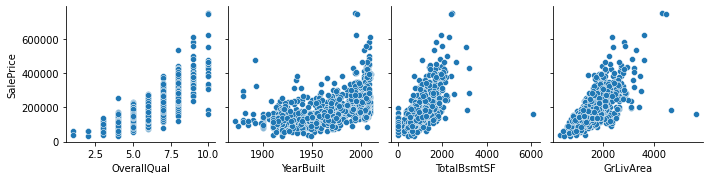

In [ ]:
sns.pairplot(df, x_vars=['OverallQual', 'YearBuilt', 'TotalBsmtSF', 'GrLivArea'], 
             y_vars=['SalePrice'])

### House prices prediction

Here is a skeleton of a neural network with a single layer (thus: a linear classifier). This is the model you'll start with and improve during this exercise.

Look at the code and run it to see its structure, then follow the questions below to iteratively improve the model.

In [ ]:
X = df[['OverallQual', 'YearBuilt', 'TotalBsmtSF', 'GrLivArea']] # get the four features from the dataframe
y = df['SalePrice'] # get the target values


In [ ]:
maxx = np.max(X.iloc[:1000])
minx = np.min(X.iloc[:1000])
scalex = maxx - minx
scaley = 1e5

X_train = (X.iloc[:1000]-minx)/scalex
y_train = y.iloc[:1000]/scaley

X_val = (X.iloc[1000:1200]-minx)/scalex
y_val = y.iloc[1000:1200]/scaley

X_test = (X.iloc[1200:]-minx)/scalex
y_test = y.iloc[1200:]/scaley

In [ ]:
# Construct a model with one layer
class Model(nn.Module):
    
    def __init__(self):
        super(Model, self).__init__()
        self.l1 = nn.Linear(4, 1)
        
    def forward(self, inputs):
        outputs = (self.l1(inputs))
        return outputs

In [ ]:
# Define hyper-parameters:
model = Model()

# Choose the hyperparameters for training: 
num_epochs = 10
batch_size = 10

# Training criterion. This one is a mean squared error (MSE) loss between the output
# of the network and the target label
criterion = nn.MSELoss()

# Use SGD optimizer with a learning rate of 0.01
# It is initialized on our model
optimizer = torch.optim.SGD(model.parameters(), lr=0.01)

In [ ]:
train_set = TensorDataset(torch.from_numpy(np.array(X_train)).float(), 
                          torch.from_numpy(np.array(y_train)).float()) # creat the dataset.

In [ ]:
def train(num_epochs, batch_size, criterion, optimizer, model, dataset, verbose=1):
    dataloader = DataLoader(dataset, batch_size, shuffle=True)
    model.train()
    train_l = []
    val_l = []
    for epoch in range(num_epochs):
        epoch_average_loss = 0.0
        for (X, y) in (dataloader):
            #print(model(X))
            y_pre = model(X).view(-1)
            loss = criterion(y_pre, y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            epoch_average_loss += loss.item() * batch_size / len(train_set)
            
        if ((epoch+1)%1 == 0):
                with torch.no_grad():
                    y_pre_val = model(torch.from_numpy(np.array(X_val)).float()).view(-1)
                error = criterion(y_pre_val, torch.tensor(np.array(y_val)).float()).item()
                train_l.append(epoch_average_loss)
                val_l.append(error)
                if verbose:
                  print('Epoch [{}/{}], Loss_error: {:.4f}, Val error : {}'
                        .format(epoch+1, num_epochs,  epoch_average_loss, error))
    plt.plot(train_l, label='Train loss')
    plt.plot(val_l, label='Validation loss')
    plt.legend()
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.show()


def eval(model, X_val, y_val):
  with torch.no_grad():
      y_pre_val = model(torch.from_numpy(np.array(X_val)).float()).view(-1)
  error = criterion(y_pre_val, torch.tensor(np.array(y_val)).float()).item()
  print('The loss on validation set is:', error)

  y_pre_val = y_pre_val.numpy()


  plt.scatter(y_val,y_pre_val, s=5)

  m =  min(np.min(y_val), np.min(y_pre_val))
  M = max(np.max(y_val), np.max(y_pre_val))
  plt.plot(
      [m,M],
      [m,M],
      color = 'r',
      alpha=0.1
      )
  plt.xlim(m,M)
  plt.ylim(m,M)
  plt.xlabel('True Value')
  plt.ylabel('Predicted value')
  plt.show()

  return error

Epoch [1/10], Loss_error: 1.2687, Val error : 0.4265410900115967
Epoch [2/10], Loss_error: 0.3542, Val error : 0.40437960624694824
Epoch [3/10], Loss_error: 0.3334, Val error : 0.38112303614616394
Epoch [4/10], Loss_error: 0.3152, Val error : 0.3618564307689667
Epoch [5/10], Loss_error: 0.2975, Val error : 0.34417206048965454
Epoch [6/10], Loss_error: 0.2835, Val error : 0.3291843831539154
Epoch [7/10], Loss_error: 0.2686, Val error : 0.3165038526058197
Epoch [8/10], Loss_error: 0.2574, Val error : 0.3010880649089813
Epoch [9/10], Loss_error: 0.2460, Val error : 0.2892860770225525
Epoch [10/10], Loss_error: 0.2360, Val error : 0.28023582696914673


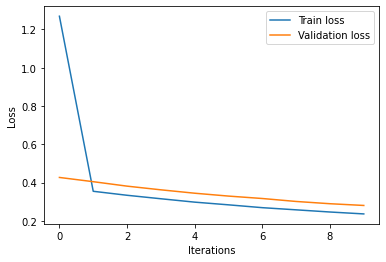

The loss on validation set is: 0.28023582696914673


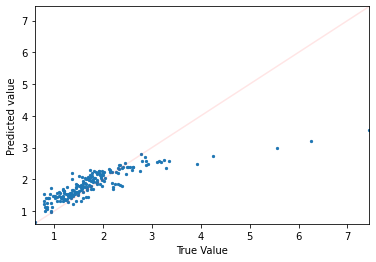

0.28023582696914673

In [ ]:
train(num_epochs, batch_size, criterion, optimizer, model, train_set)

eval(model, X_val, y_val)

### Exercise 1: Impact of the architecture of the model

The class `Model` is the definition of your model. You can now modify it to try out different architectures and
see the impact of the following factors:

* Try to add more layers (1, 2, 3, more ?)
* Try different activation functions ([sigmoid](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.sigmoid), [tanh](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.tanh), [relu](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.relu), etc.)
* Try to change the number of neurons in each layer (5, 10, 20, more ?)

In [ ]:
class Model(nn.Module):
    
    def __init__(self,n_neurons, act=F.relu):
        super(Model, self).__init__()
        self.act = act
        self.linears = nn.ModuleList([nn.Linear(4, n_neurons[0])])
        self.linears.extend([nn.Linear(n_neurons[i-1], n_neurons[i]) for i in range(1,len(n_neurons))])
        
    def forward(self, inputs):
        h = inputs
        for i in range(len(self.linears)-1):
          h = self.act(self.linears[i](h))
        h = (self.linears[-1](h))
        return h

In [ ]:
neurons_list = [
          [4,1],[4,4,1],[4,4,4,1],[4,4,4,4,1],
          [10,1],[4,10,1],[4,10,4,1],[4,10,10,4,1],
          [30,1],[10,30,1],[10,30,30,1],[10,30,30,30,1],
          [10,4,1],[10,30,4,1],[10,30,30,4,1],
        ]*2

TRAINING WITH [4, 1] and activation : relu


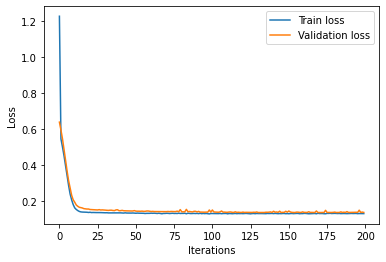

The loss on validation set is: 0.13556239008903503


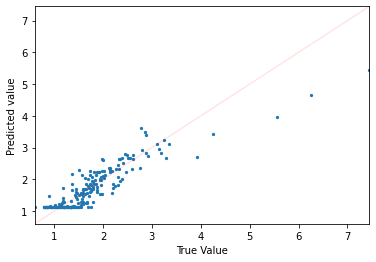

TRAINING WITH [4, 1] and activation : sigmoid


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


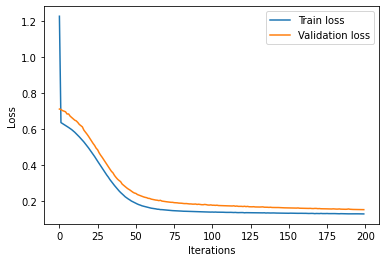

The loss on validation set is: 0.15126405656337738


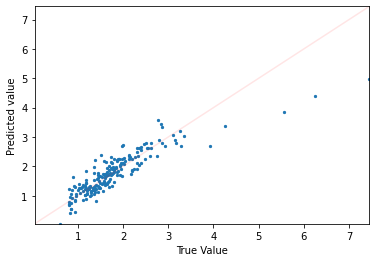

TRAINING WITH [4, 1] and activation : tanh


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1795: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


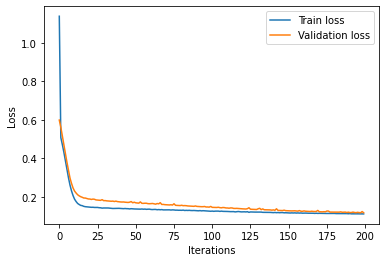

The loss on validation set is: 0.11716806143522263


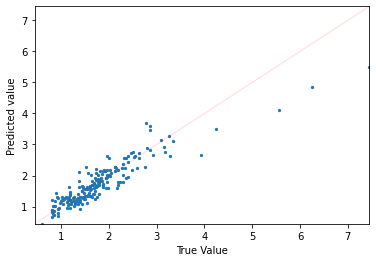

TRAINING WITH [4, 4, 1] and activation : relu


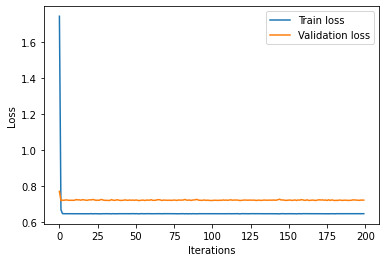

The loss on validation set is: 0.7207251191139221


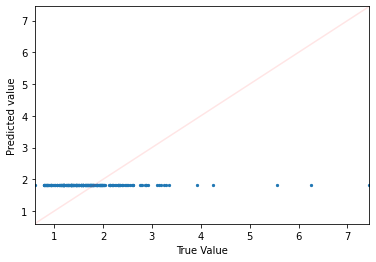

TRAINING WITH [4, 4, 1] and activation : sigmoid


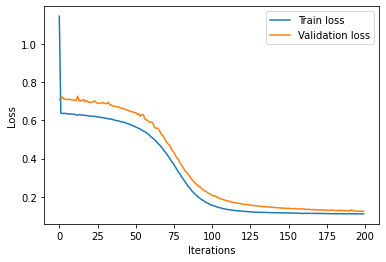

The loss on validation set is: 0.12351390719413757


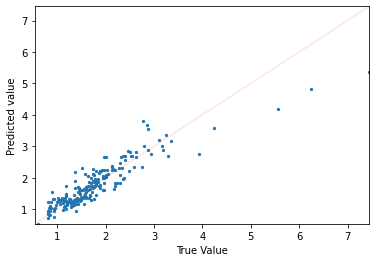

TRAINING WITH [4, 4, 1] and activation : tanh


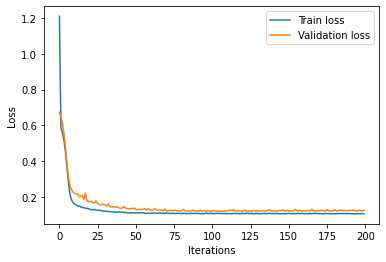

The loss on validation set is: 0.1239723414182663


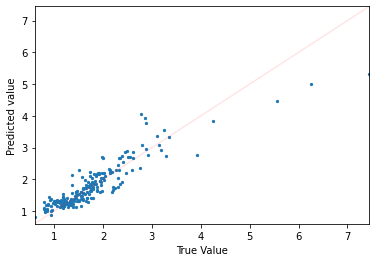

TRAINING WITH [4, 4, 4, 1] and activation : relu


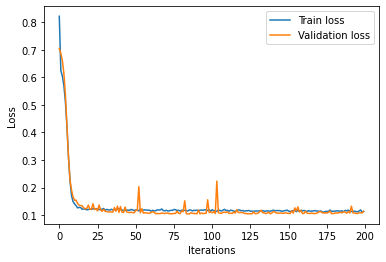

The loss on validation set is: 0.11411548405885696


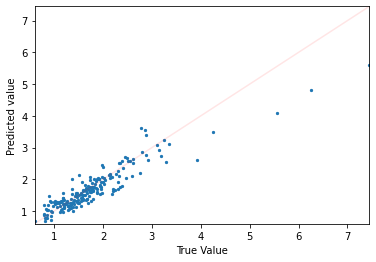

TRAINING WITH [4, 4, 4, 1] and activation : sigmoid


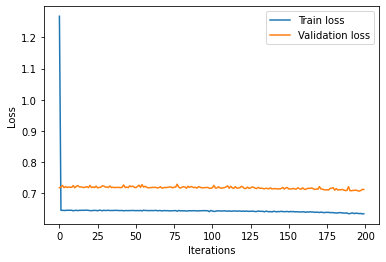

The loss on validation set is: 0.7123039960861206


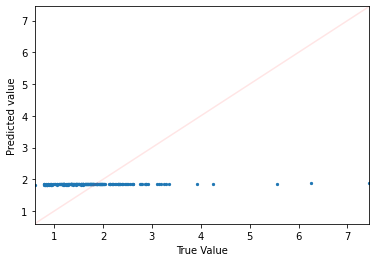

TRAINING WITH [4, 4, 4, 1] and activation : tanh


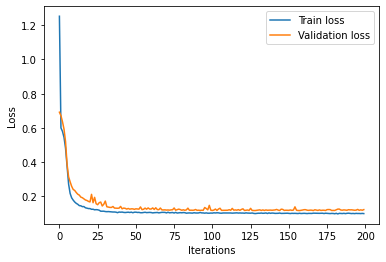

The loss on validation set is: 0.12313994765281677


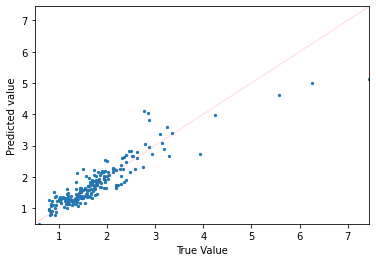

TRAINING WITH [4, 4, 4, 4, 1] and activation : relu


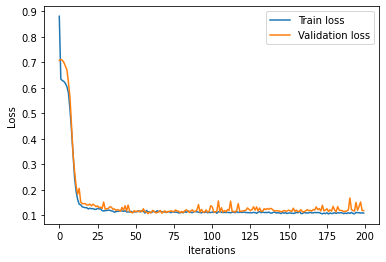

The loss on validation set is: 0.11896245926618576


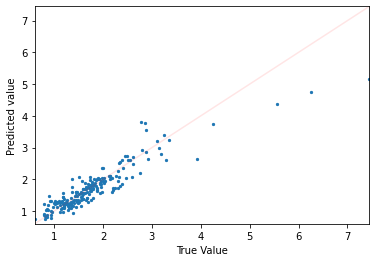

TRAINING WITH [4, 4, 4, 4, 1] and activation : sigmoid


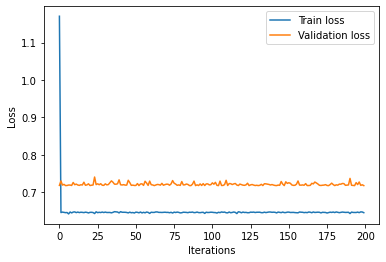

The loss on validation set is: 0.717842161655426


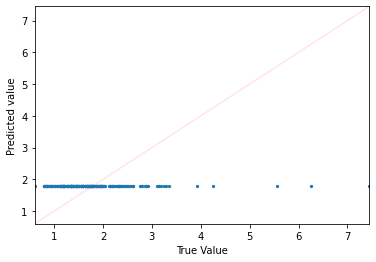

TRAINING WITH [4, 4, 4, 4, 1] and activation : tanh


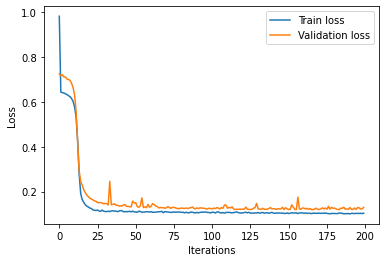

The loss on validation set is: 0.1297043263912201


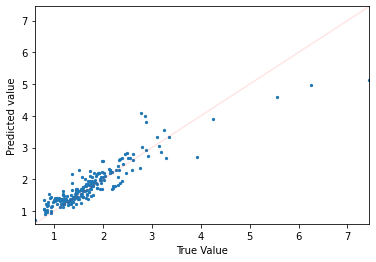

TRAINING WITH [10, 1] and activation : relu


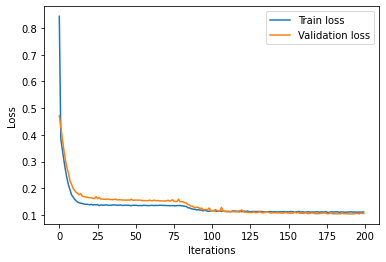

The loss on validation set is: 0.10538218170404434


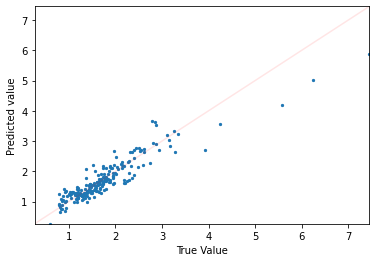

TRAINING WITH [10, 1] and activation : sigmoid


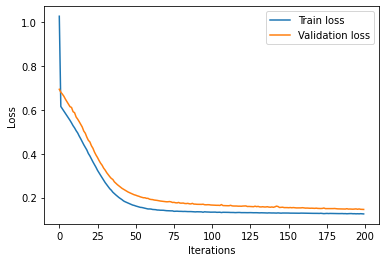

The loss on validation set is: 0.1462232619524002


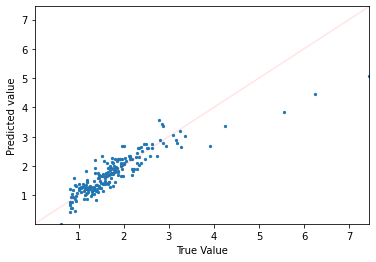

TRAINING WITH [10, 1] and activation : tanh


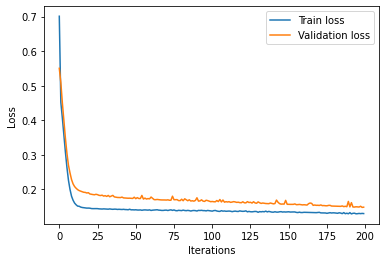

The loss on validation set is: 0.14873036742210388


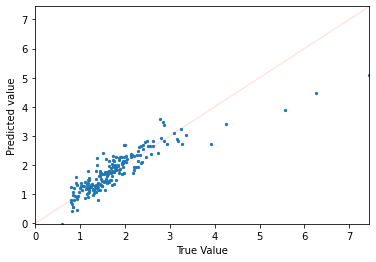

TRAINING WITH [4, 10, 1] and activation : relu


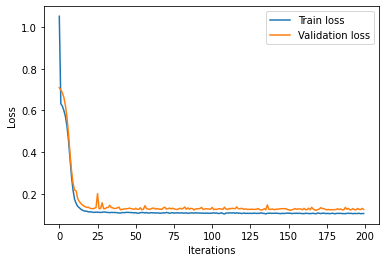

The loss on validation set is: 0.12435905635356903


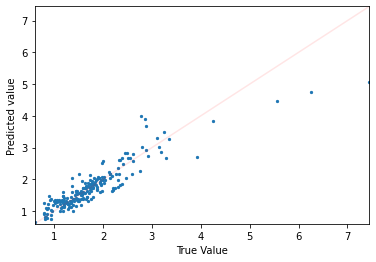

TRAINING WITH [4, 10, 1] and activation : sigmoid


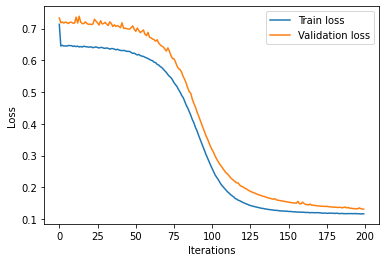

The loss on validation set is: 0.131388857960701


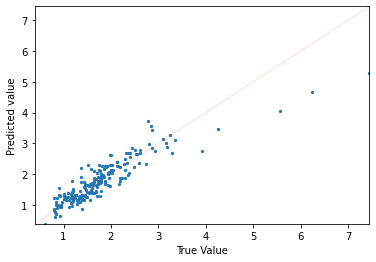

TRAINING WITH [4, 10, 1] and activation : tanh


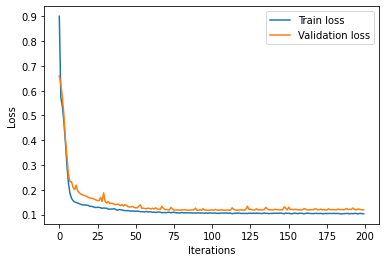

The loss on validation set is: 0.11917033791542053


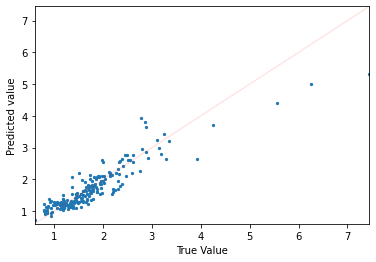

TRAINING WITH [4, 10, 4, 1] and activation : relu


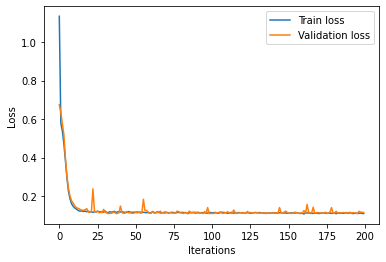

The loss on validation set is: 0.1152297705411911


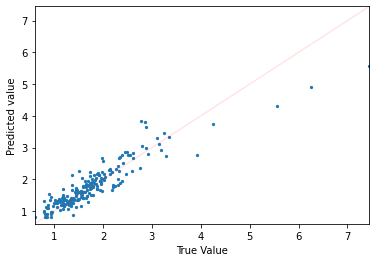

TRAINING WITH [4, 10, 4, 1] and activation : sigmoid


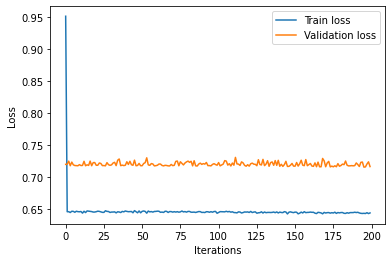

The loss on validation set is: 0.7164837121963501


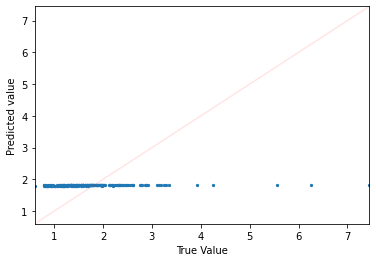

TRAINING WITH [4, 10, 4, 1] and activation : tanh


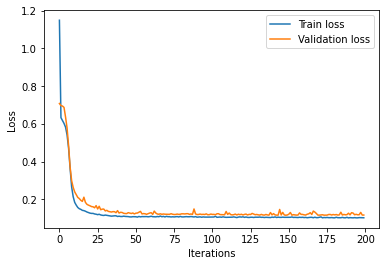

The loss on validation set is: 0.11634834110736847


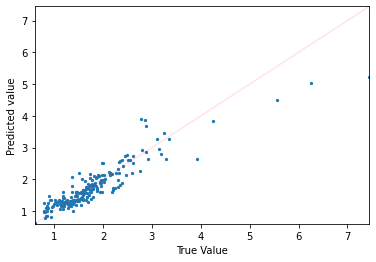

TRAINING WITH [4, 10, 10, 4, 1] and activation : relu


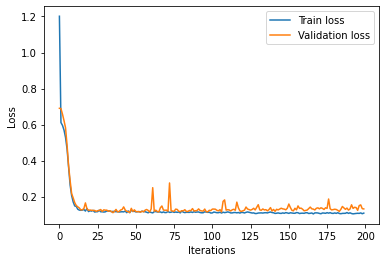

The loss on validation set is: 0.13171234726905823


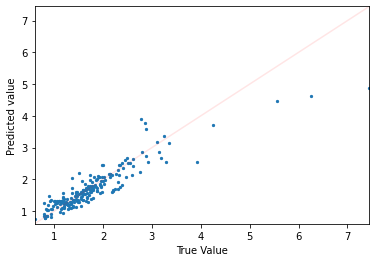

TRAINING WITH [4, 10, 10, 4, 1] and activation : sigmoid


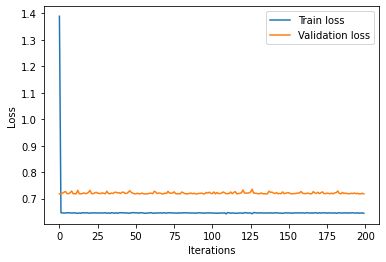

The loss on validation set is: 0.7178308963775635


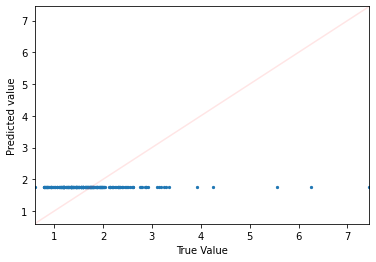

TRAINING WITH [4, 10, 10, 4, 1] and activation : tanh


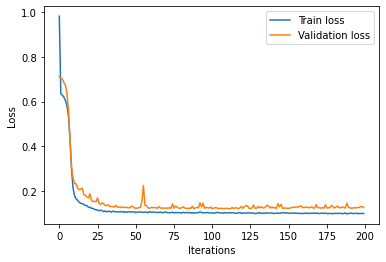

The loss on validation set is: 0.12800586223602295


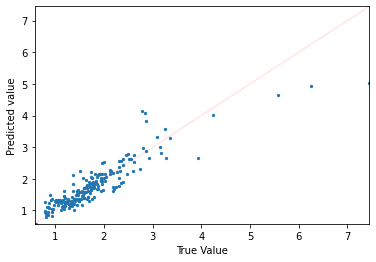

TRAINING WITH [30, 1] and activation : relu


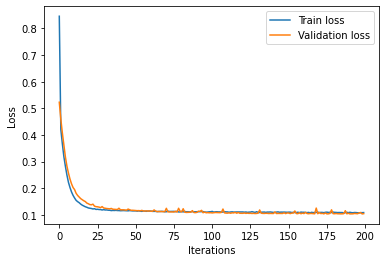

The loss on validation set is: 0.1040380597114563


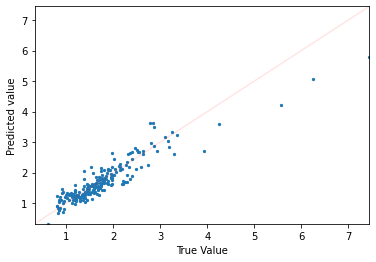

TRAINING WITH [30, 1] and activation : sigmoid


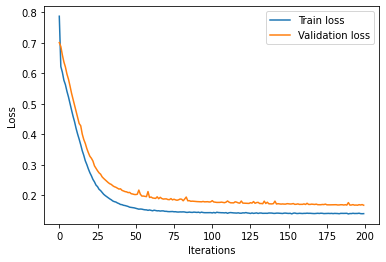

The loss on validation set is: 0.1668551117181778


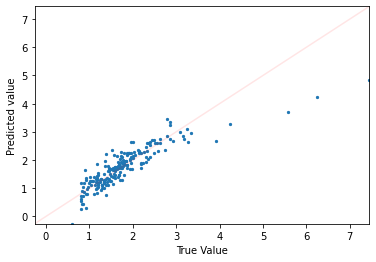

TRAINING WITH [30, 1] and activation : tanh


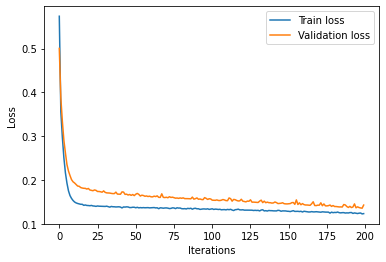

The loss on validation set is: 0.1426744908094406


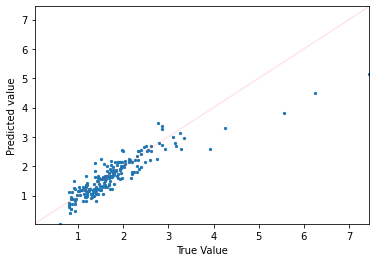

TRAINING WITH [10, 30, 1] and activation : relu


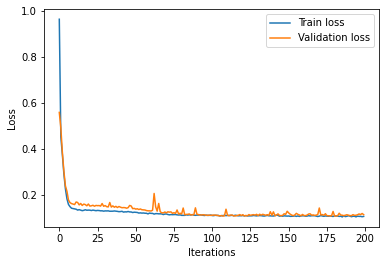

The loss on validation set is: 0.11556074768304825


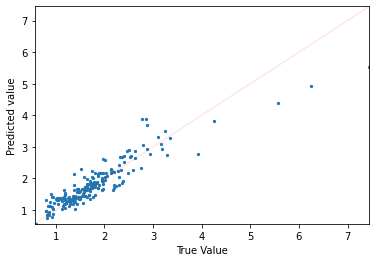

TRAINING WITH [10, 30, 1] and activation : sigmoid


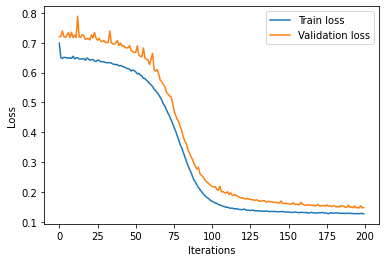

The loss on validation set is: 0.14740142226219177


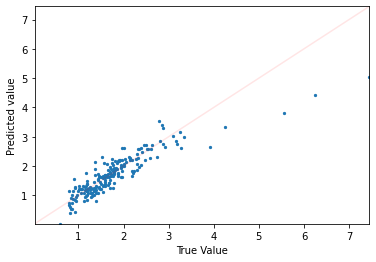

TRAINING WITH [10, 30, 1] and activation : tanh


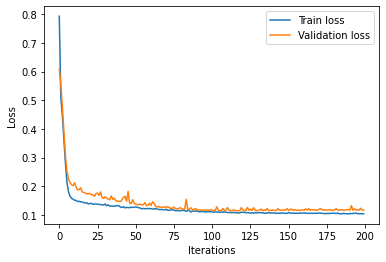

The loss on validation set is: 0.1163150891661644


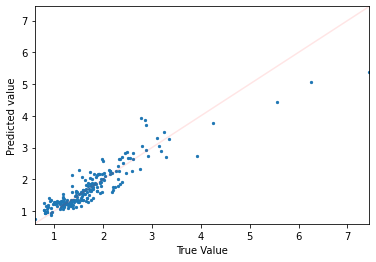

TRAINING WITH [10, 30, 30, 1] and activation : relu


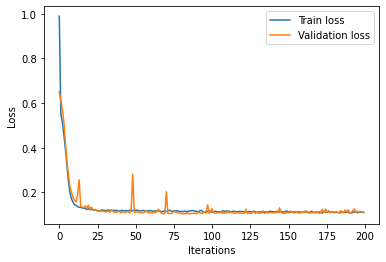

The loss on validation set is: 0.11230305582284927


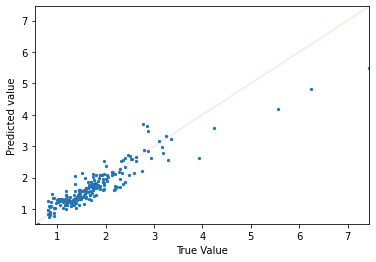

TRAINING WITH [10, 30, 30, 1] and activation : sigmoid


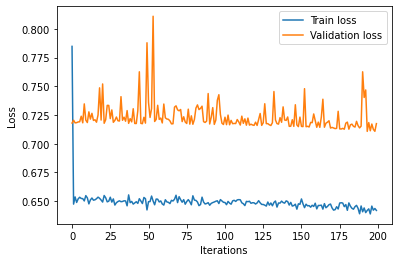

The loss on validation set is: 0.717509925365448


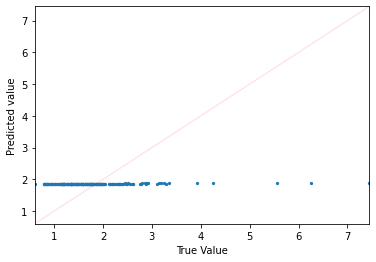

TRAINING WITH [10, 30, 30, 1] and activation : tanh


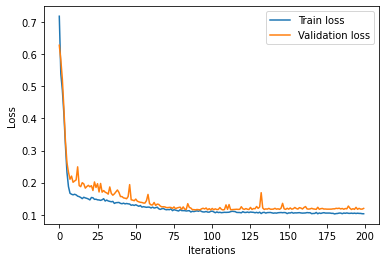

The loss on validation set is: 0.11971122771501541


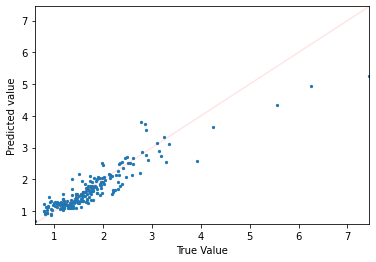

TRAINING WITH [10, 30, 30, 30, 1] and activation : relu


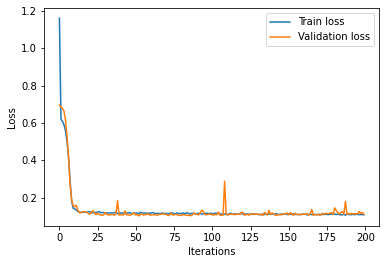

The loss on validation set is: 0.11090195924043655


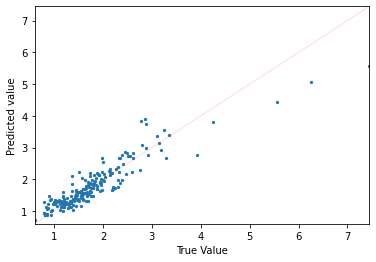

TRAINING WITH [10, 30, 30, 30, 1] and activation : sigmoid


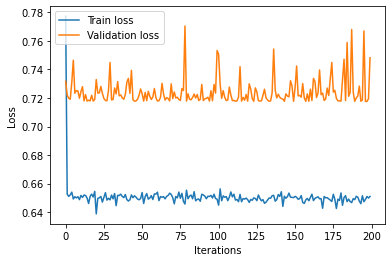

The loss on validation set is: 0.7482162714004517


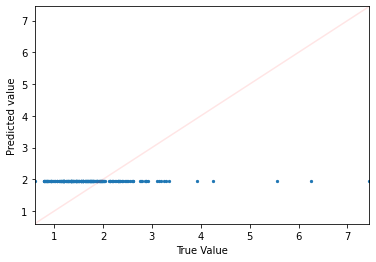

TRAINING WITH [10, 30, 30, 30, 1] and activation : tanh


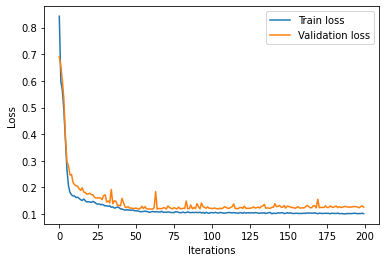

The loss on validation set is: 0.12582209706306458


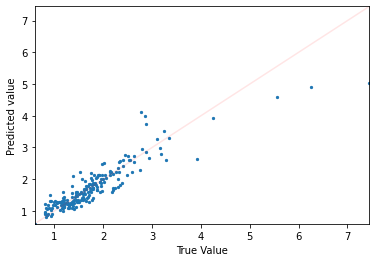

TRAINING WITH [10, 4, 1] and activation : relu


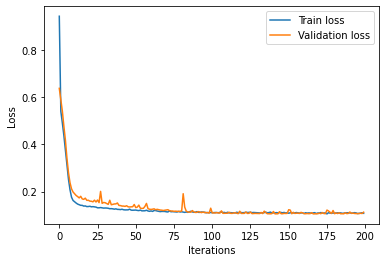

The loss on validation set is: 0.11275794357061386


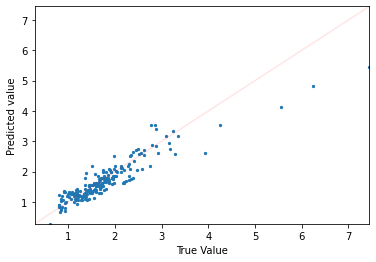

TRAINING WITH [10, 4, 1] and activation : sigmoid


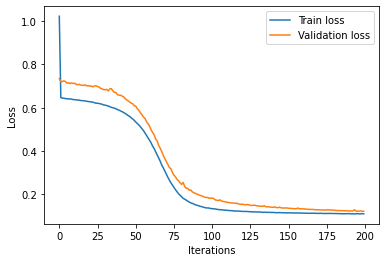

The loss on validation set is: 0.12139381468296051


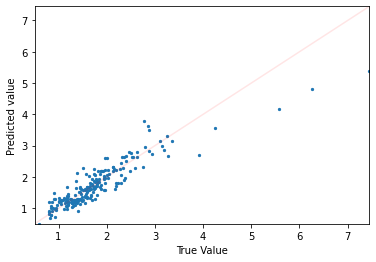

TRAINING WITH [10, 4, 1] and activation : tanh


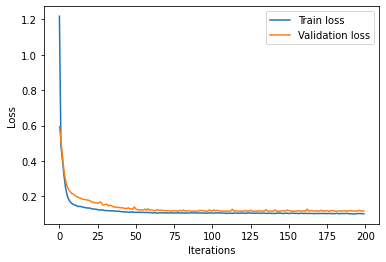

The loss on validation set is: 0.1169186681509018


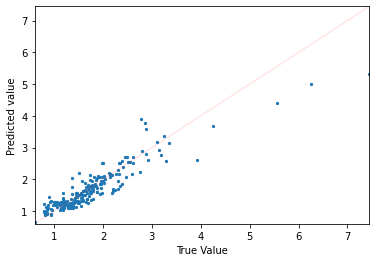

TRAINING WITH [10, 30, 4, 1] and activation : relu


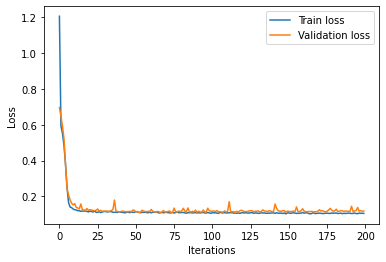

The loss on validation set is: 0.11813300102949142


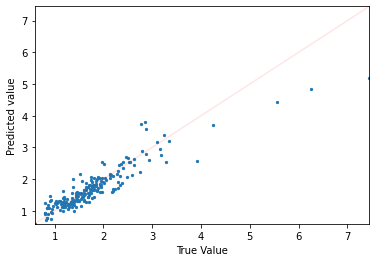

TRAINING WITH [10, 30, 4, 1] and activation : sigmoid


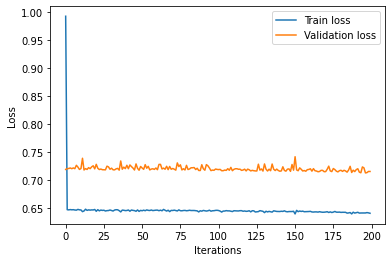

The loss on validation set is: 0.7156491279602051


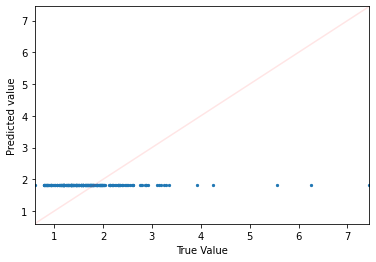

TRAINING WITH [10, 30, 4, 1] and activation : tanh


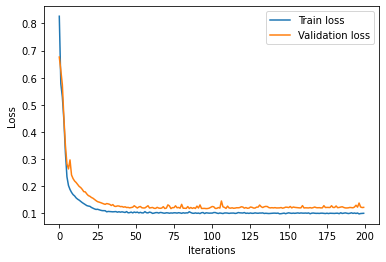

The loss on validation set is: 0.12238520383834839


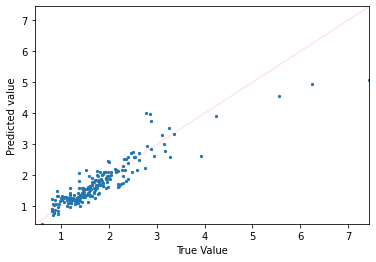

TRAINING WITH [10, 30, 30, 4, 1] and activation : relu


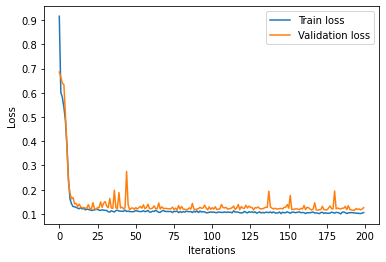

The loss on validation set is: 0.12591874599456787


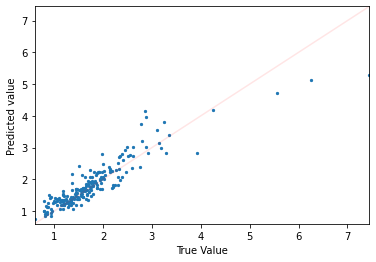

TRAINING WITH [10, 30, 30, 4, 1] and activation : sigmoid


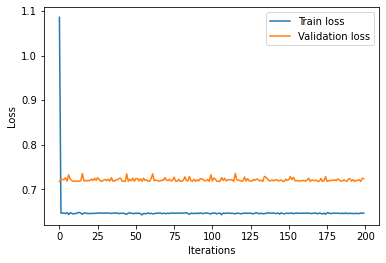

The loss on validation set is: 0.724243700504303


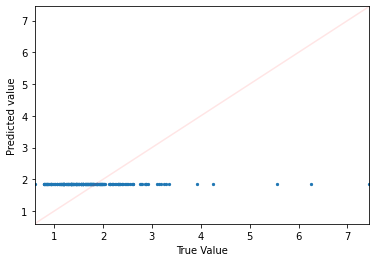

TRAINING WITH [10, 30, 30, 4, 1] and activation : tanh


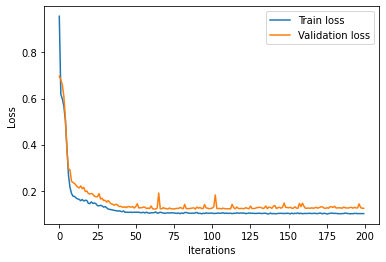

The loss on validation set is: 0.12389466911554337


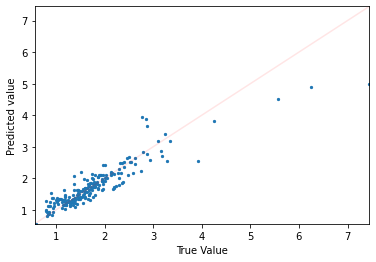

TRAINING WITH [4, 1] and activation : relu


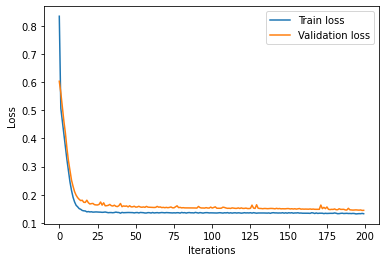

The loss on validation set is: 0.14452485740184784


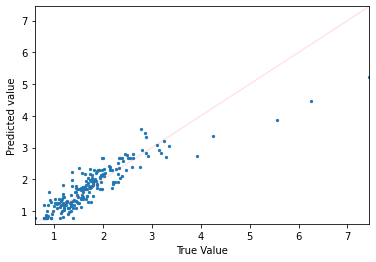

TRAINING WITH [4, 1] and activation : sigmoid


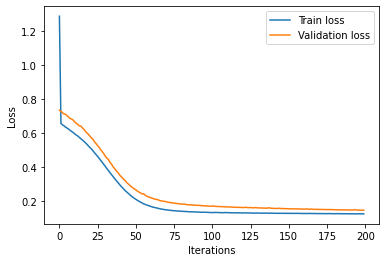

The loss on validation set is: 0.14758935570716858


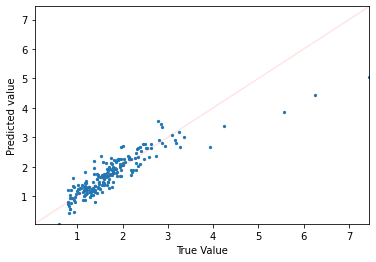

TRAINING WITH [4, 1] and activation : tanh


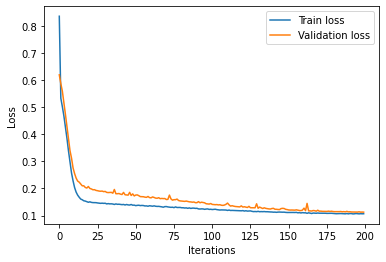

The loss on validation set is: 0.11250871419906616


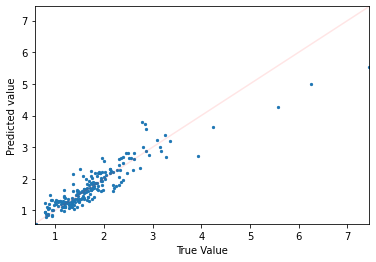

TRAINING WITH [4, 4, 1] and activation : relu


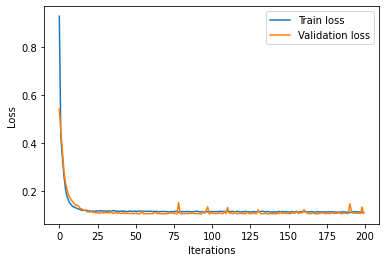

The loss on validation set is: 0.10608464479446411


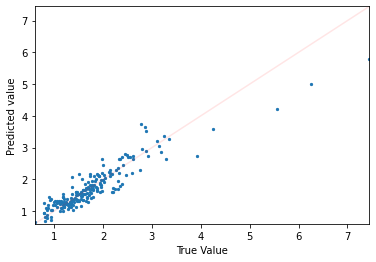

TRAINING WITH [4, 4, 1] and activation : sigmoid


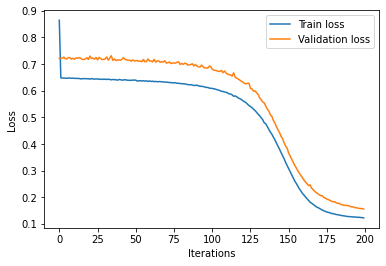

The loss on validation set is: 0.155931755900383


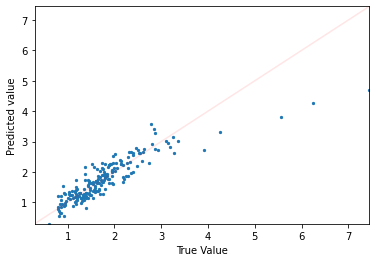

TRAINING WITH [4, 4, 1] and activation : tanh


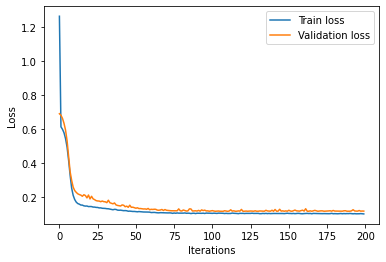

The loss on validation set is: 0.11659795790910721


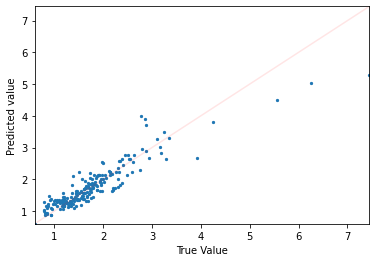

TRAINING WITH [4, 4, 4, 1] and activation : relu


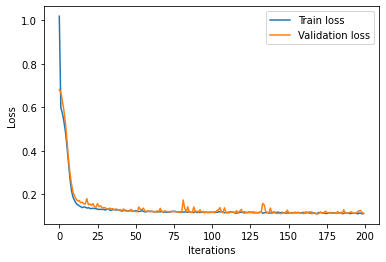

The loss on validation set is: 0.11168947070837021


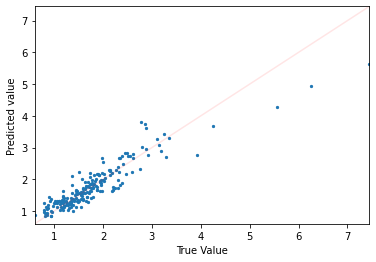

TRAINING WITH [4, 4, 4, 1] and activation : sigmoid


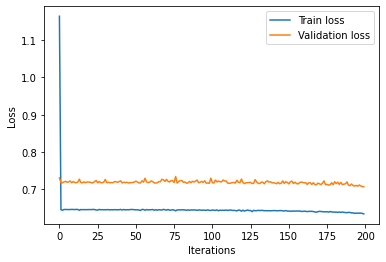

The loss on validation set is: 0.7070034742355347


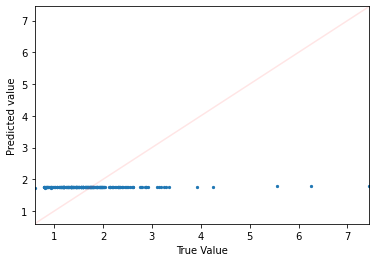

TRAINING WITH [4, 4, 4, 1] and activation : tanh


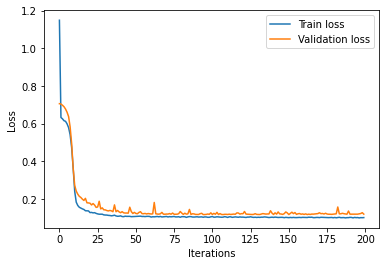

The loss on validation set is: 0.11999626457691193


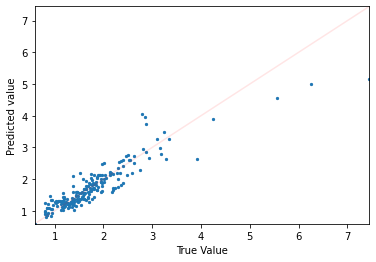

TRAINING WITH [4, 4, 4, 4, 1] and activation : relu


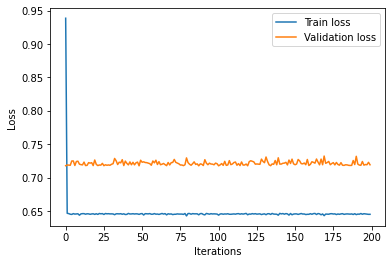

The loss on validation set is: 0.7193293571472168


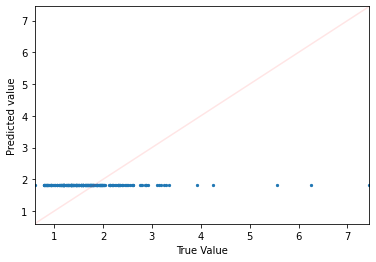

TRAINING WITH [4, 4, 4, 4, 1] and activation : sigmoid


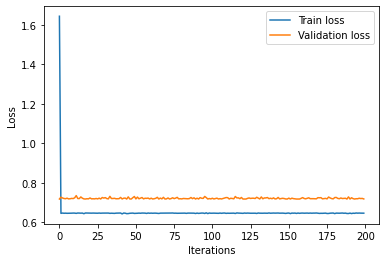

The loss on validation set is: 0.7182077169418335


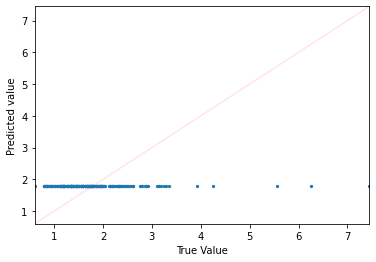

TRAINING WITH [4, 4, 4, 4, 1] and activation : tanh


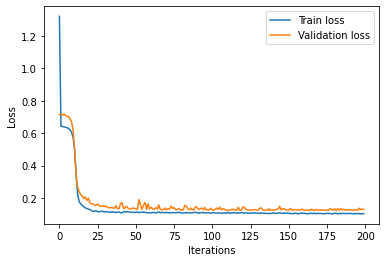

The loss on validation set is: 0.12913382053375244


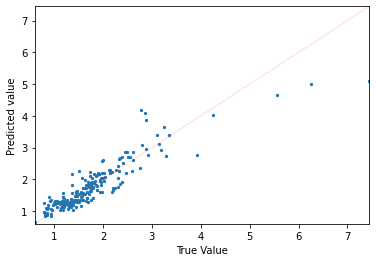

TRAINING WITH [10, 1] and activation : relu


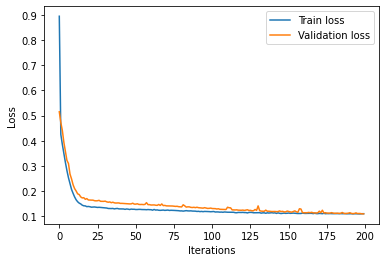

The loss on validation set is: 0.10998371243476868


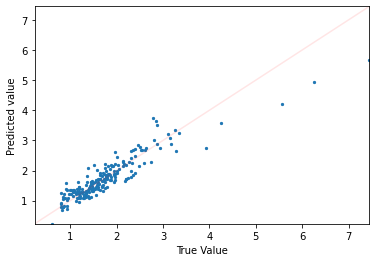

TRAINING WITH [10, 1] and activation : sigmoid


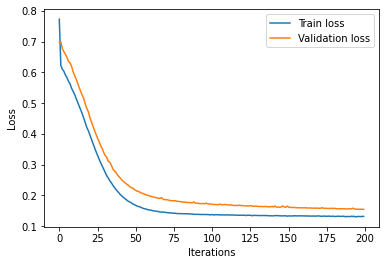

The loss on validation set is: 0.15506255626678467


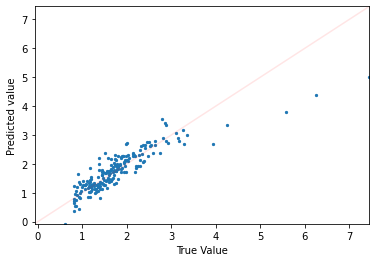

TRAINING WITH [10, 1] and activation : tanh


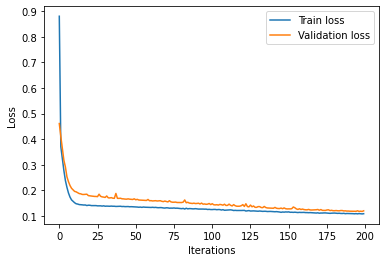

The loss on validation set is: 0.12034974992275238


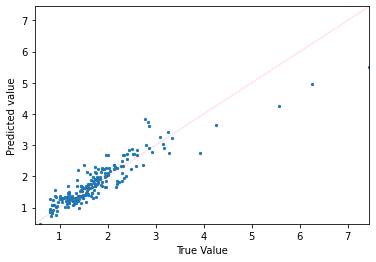

TRAINING WITH [4, 10, 1] and activation : relu


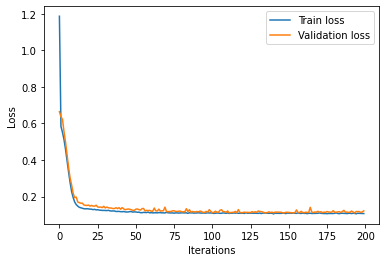

The loss on validation set is: 0.12177236378192902


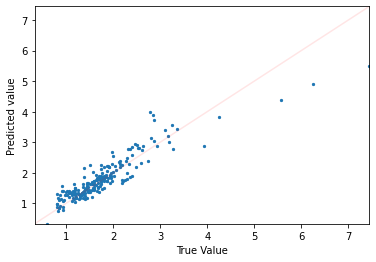

TRAINING WITH [4, 10, 1] and activation : sigmoid


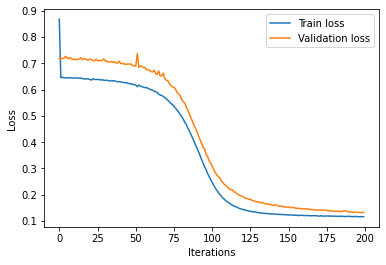

The loss on validation set is: 0.13196855783462524


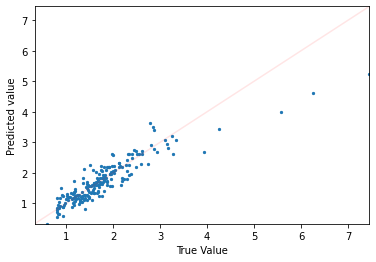

TRAINING WITH [4, 10, 1] and activation : tanh


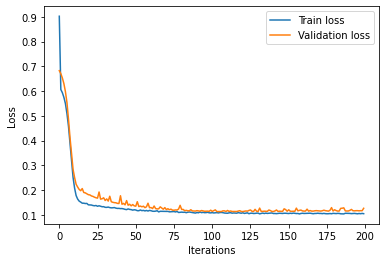

The loss on validation set is: 0.1265583336353302


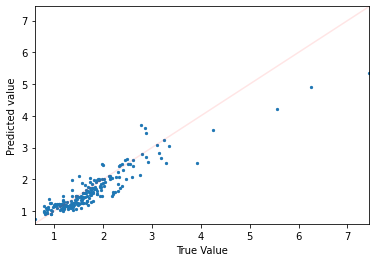

TRAINING WITH [4, 10, 4, 1] and activation : relu


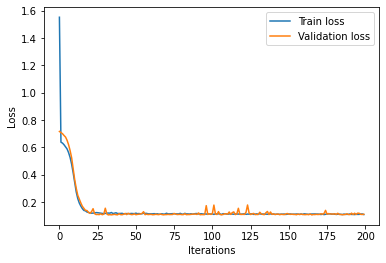

The loss on validation set is: 0.11098399013280869


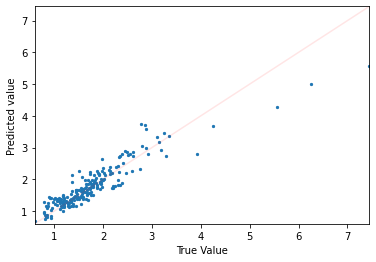

TRAINING WITH [4, 10, 4, 1] and activation : sigmoid


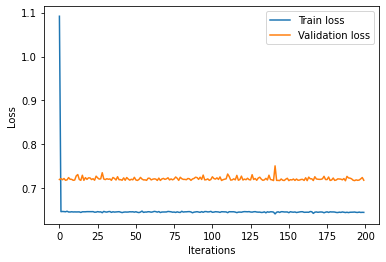

The loss on validation set is: 0.718200147151947


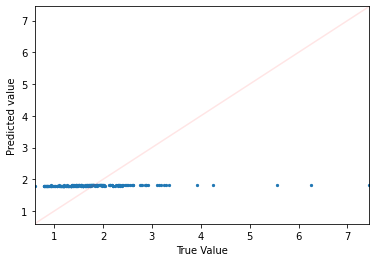

TRAINING WITH [4, 10, 4, 1] and activation : tanh


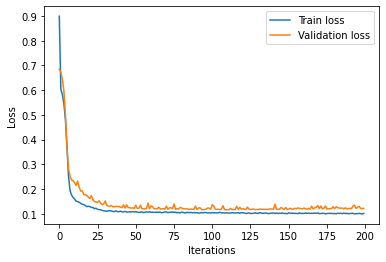

The loss on validation set is: 0.12168138474225998


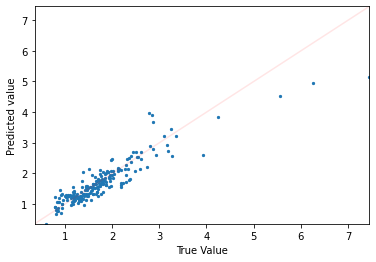

TRAINING WITH [4, 10, 10, 4, 1] and activation : relu


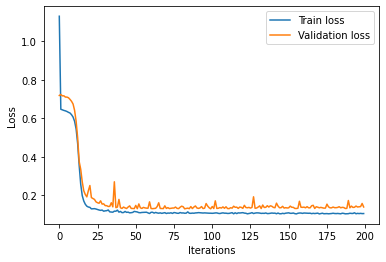

The loss on validation set is: 0.13875840604305267


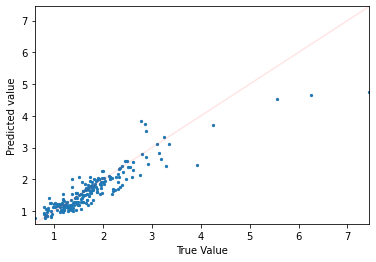

TRAINING WITH [4, 10, 10, 4, 1] and activation : sigmoid


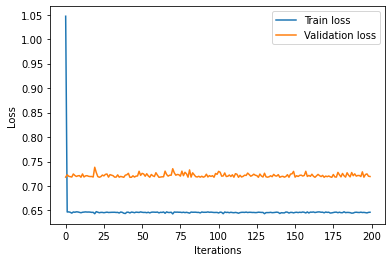

The loss on validation set is: 0.7193869948387146


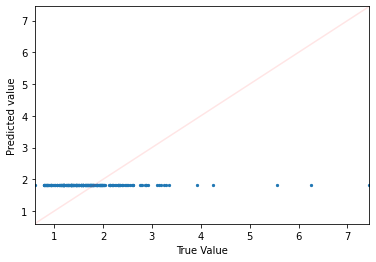

TRAINING WITH [4, 10, 10, 4, 1] and activation : tanh


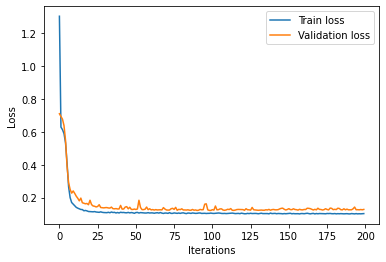

The loss on validation set is: 0.12753185629844666


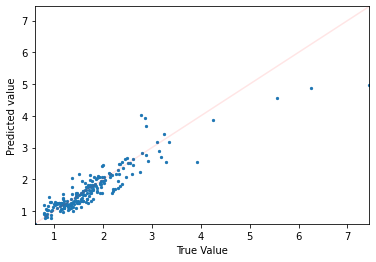

TRAINING WITH [30, 1] and activation : relu


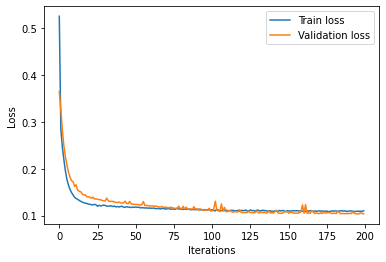

The loss on validation set is: 0.10358751565217972


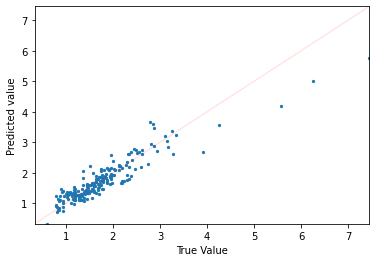

TRAINING WITH [30, 1] and activation : sigmoid


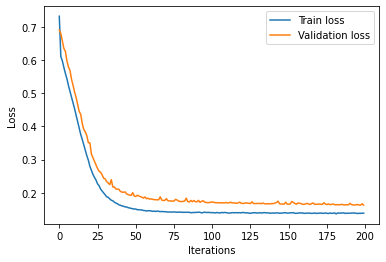

The loss on validation set is: 0.16279561817646027


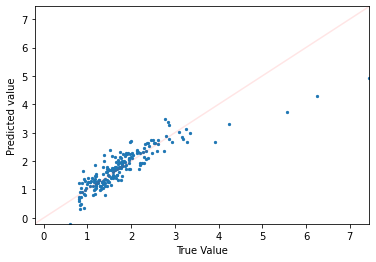

TRAINING WITH [30, 1] and activation : tanh


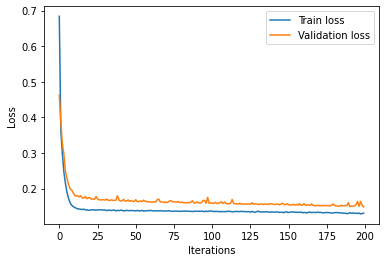

The loss on validation set is: 0.1486278921365738


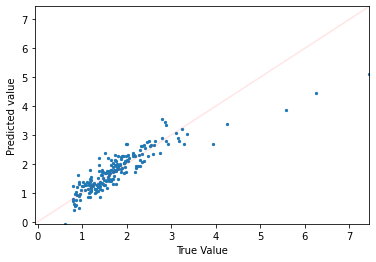

TRAINING WITH [10, 30, 1] and activation : relu


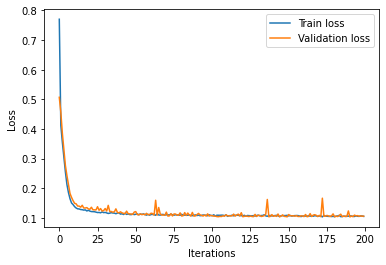

The loss on validation set is: 0.10669324547052383


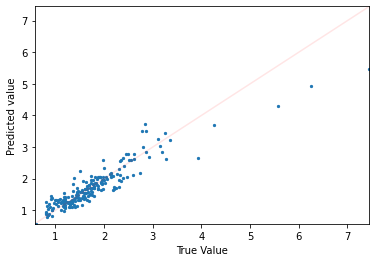

TRAINING WITH [10, 30, 1] and activation : sigmoid


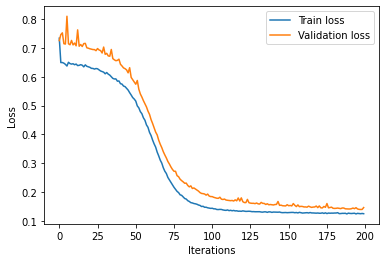

The loss on validation set is: 0.14618173241615295


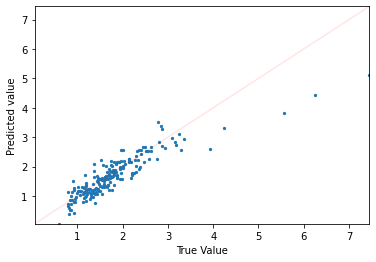

TRAINING WITH [10, 30, 1] and activation : tanh


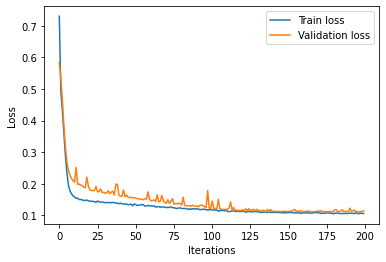

The loss on validation set is: 0.114252470433712


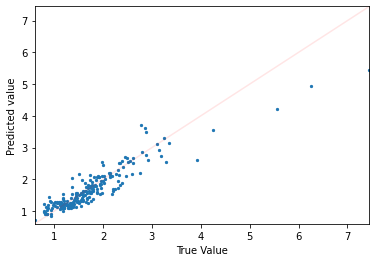

TRAINING WITH [10, 30, 30, 1] and activation : relu


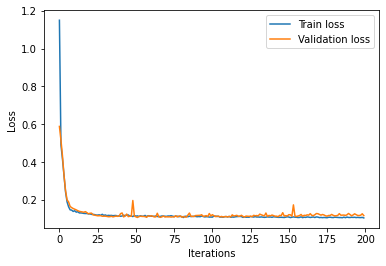

The loss on validation set is: 0.11689350754022598


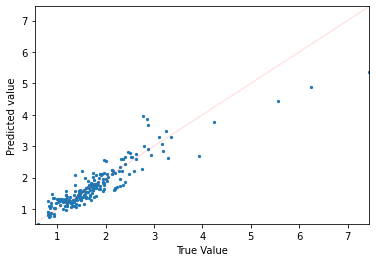

TRAINING WITH [10, 30, 30, 1] and activation : sigmoid


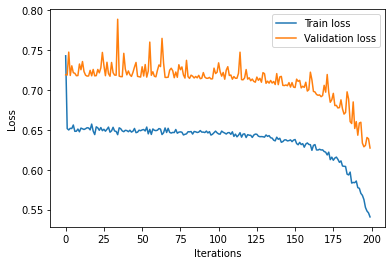

The loss on validation set is: 0.6272900700569153


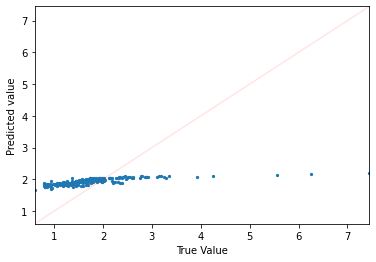

TRAINING WITH [10, 30, 30, 1] and activation : tanh


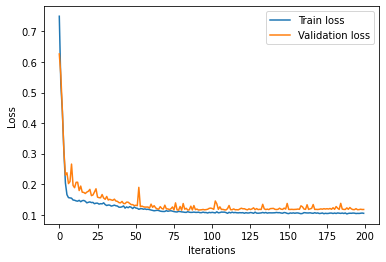

The loss on validation set is: 0.11702810972929001


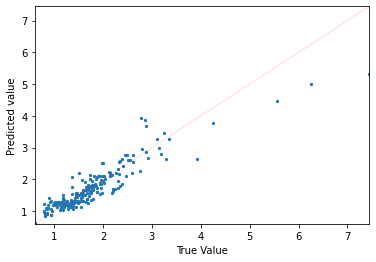

TRAINING WITH [10, 30, 30, 30, 1] and activation : relu


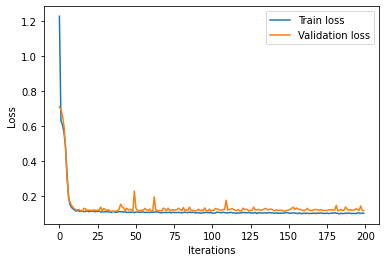

The loss on validation set is: 0.11777833849191666


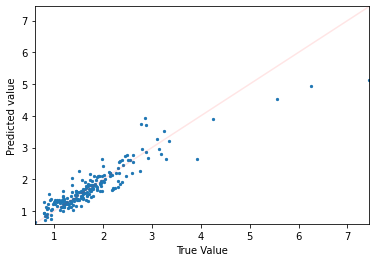

TRAINING WITH [10, 30, 30, 30, 1] and activation : sigmoid


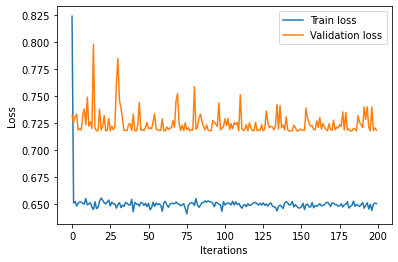

The loss on validation set is: 0.718478262424469


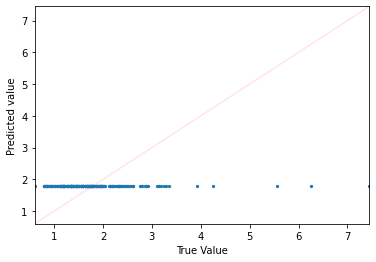

TRAINING WITH [10, 30, 30, 30, 1] and activation : tanh


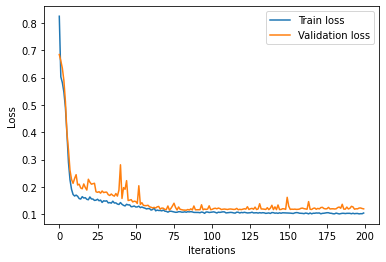

The loss on validation set is: 0.11970450729131699


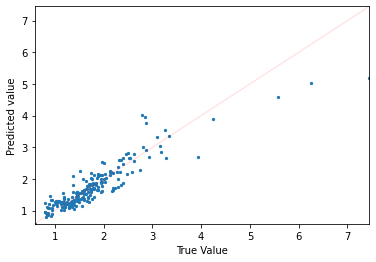

TRAINING WITH [10, 4, 1] and activation : relu


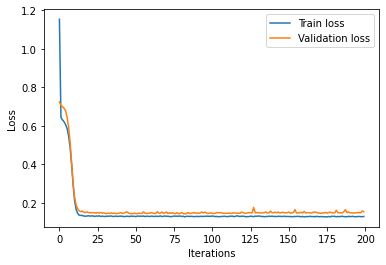

The loss on validation set is: 0.15223245322704315


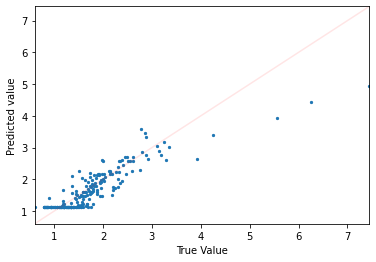

TRAINING WITH [10, 4, 1] and activation : sigmoid


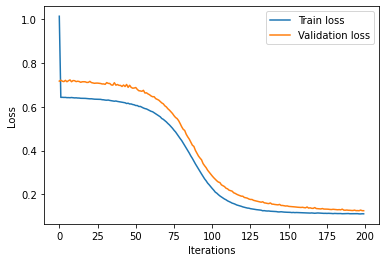

The loss on validation set is: 0.124918632209301


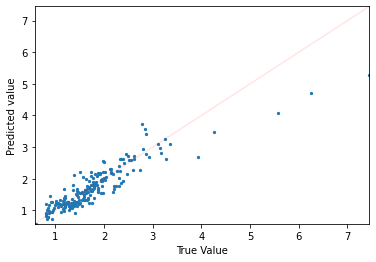

TRAINING WITH [10, 4, 1] and activation : tanh


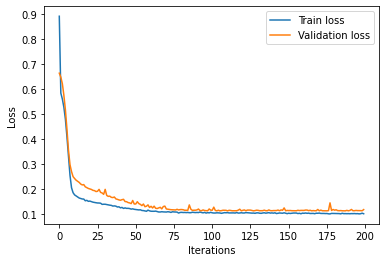

The loss on validation set is: 0.11849911510944366


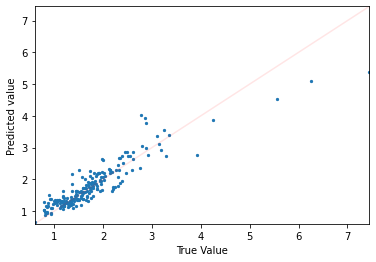

TRAINING WITH [10, 30, 4, 1] and activation : relu


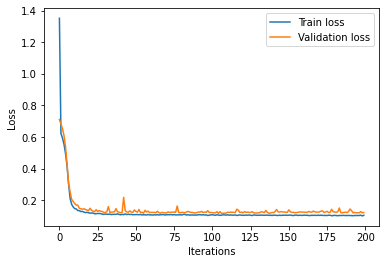

The loss on validation set is: 0.12190787494182587


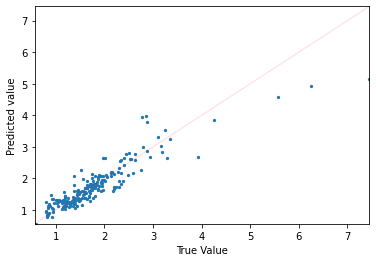

TRAINING WITH [10, 30, 4, 1] and activation : sigmoid


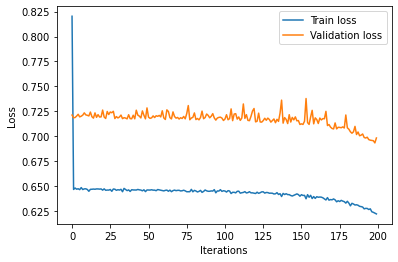

The loss on validation set is: 0.6981377601623535


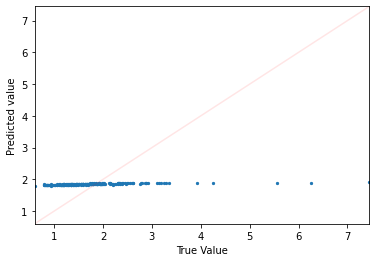

TRAINING WITH [10, 30, 4, 1] and activation : tanh


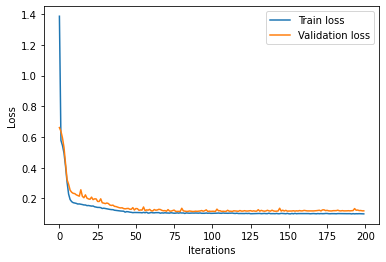

The loss on validation set is: 0.11925773322582245


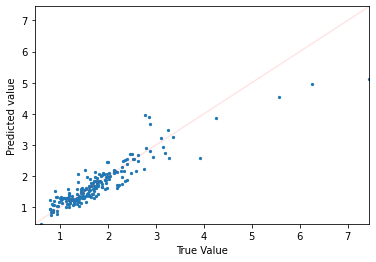

TRAINING WITH [10, 30, 30, 4, 1] and activation : relu


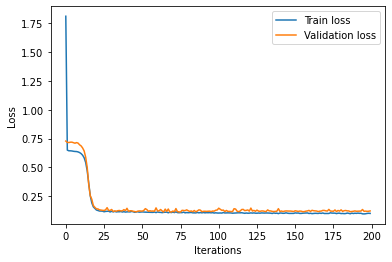

The loss on validation set is: 0.12167415767908096


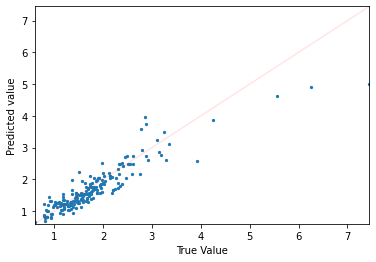

TRAINING WITH [10, 30, 30, 4, 1] and activation : sigmoid


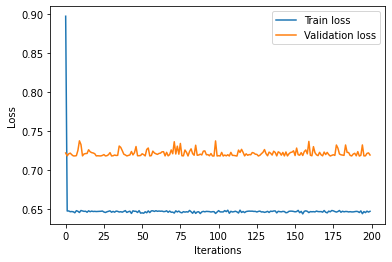

The loss on validation set is: 0.7189701795578003


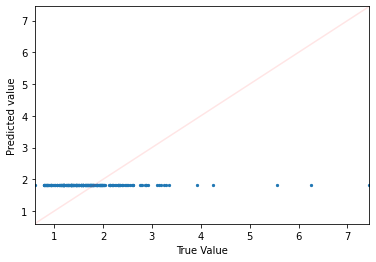

TRAINING WITH [10, 30, 30, 4, 1] and activation : tanh


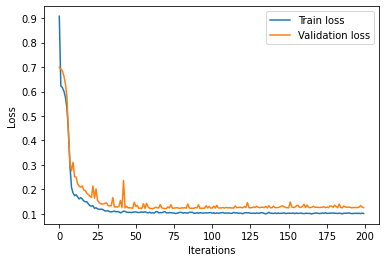

The loss on validation set is: 0.12498030066490173


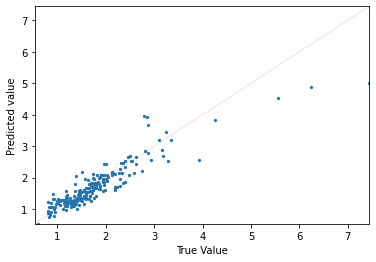

In [ ]:
# Define hyper-parameters:

acts = [F.relu, F.sigmoid, F.tanh]
df = {
        'n_neurons': [],
        'n_layers': [],
        'activation' : [],
        'Val_loss': []
     }

for n_neurons in neurons_list:
  for act,n in zip(acts,['relu','sigmoid','tanh']):
    print(f'TRAINING WITH {str(n_neurons)} and activation : {n}')
    model = Model(n_neurons, act)

    # Choose the hyperparameters for training: 
    num_epochs = 200
    batch_size = 10

    # Training criterion. This one is a mean squared error (MSE) loss between the output
    # of the network and the target label
    criterion = nn.MSELoss()

    # Use SGD optimizer with a learning rate of 0.01
    # It is initialized on our model
    optimizer = torch.optim.SGD(model.parameters(), lr=0.01)

    train(num_epochs, batch_size, criterion, optimizer, model, train_set, verbose=0)

    e = eval(model, X_val, y_val)

    df['n_neurons'].append(str(n_neurons))
    df['n_layers'].append(len(n_neurons))
    df['activation'].append(n)
    df['Val_loss'].append(e)

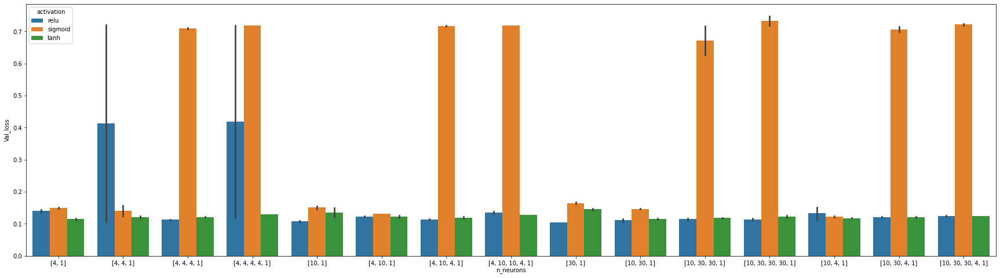

In [ ]:
df = pd.DataFrame(df)
df.sort_values(by = ['Val_loss'])
fig = plt.figure(figsize=(30,8))
sns.barplot(data = df, x='n_neurons',y='Val_loss', hue='activation')

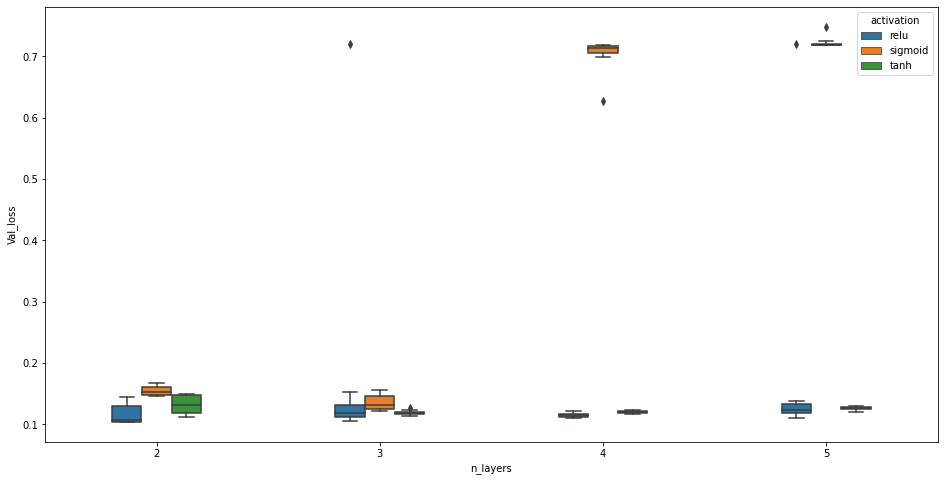

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df, x='n_layers',y='Val_loss', hue='activation', width=.4)


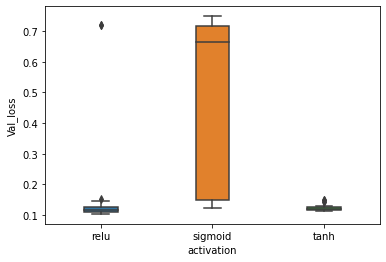

In [ ]:
 sns.boxplot(data = df, x='activation',y='Val_loss',width=.3)

In [ ]:
df[df.Val_loss <= np.min(df.Val_loss) * 1.03]

,n_neurons,n_layers,activation,Val_loss
12,"[10, 1]",2,relu,0.105382
24,"[30, 1]",2,relu,0.104038
48,"[4, 4, 1]",3,relu,0.106085
69,"[30, 1]",2,relu,0.103588
72,"[10, 30, 1]",3,relu,0.106693


### Exercise 2: Impact of the optimizer

Retrain the model with different parameters of the optimizer; you can change then in the cell initializing the optimizer, after the definition of your model.

* Use different batch sizes, from 10 to 400 e.g.
* Try different values of the learning rate (between 0.001 and 10), and see how they impact the training process. Do all network architectures react the same way to different learning rates?
* Change the duration of the training by increasing the number of epochs
* Try other optimizers, such as [Adam](https://pytorch.org/docs/stable/optim.html?highlight=adam#torch.optim.Adam) or [RMSprop](https://pytorch.org/docs/stable/optim.html?highlight=rmsprop#torch.optim.RMSprop)

**Note:** These changes may interact with your previous choices of architectures, and you may need to change them as well!

In [ ]:
neurons_list = [
          [2,1],[4,1],[2,2,1],[2,4,1],[4,2,1],[4,2,2,1],[4,2,4,1],[4,2,2,4,1],
          [10,1],[10,10,1],[10,10,1],[10,10,10,1],[10,10,10,10,1],
        ]

  0%|          | 0/13 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1795: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


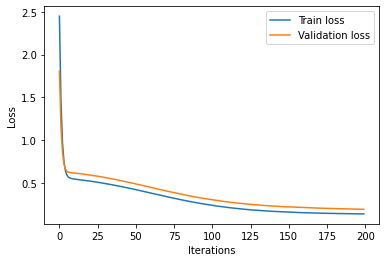

The loss on validation set is: 0.19510257244110107


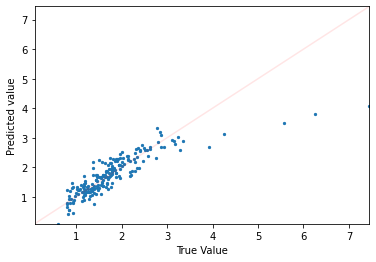

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


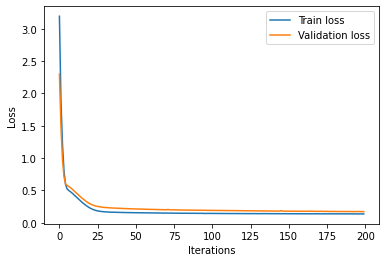

The loss on validation set is: 0.17141608893871307


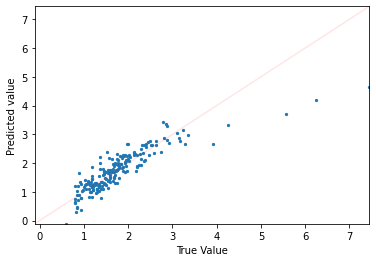

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


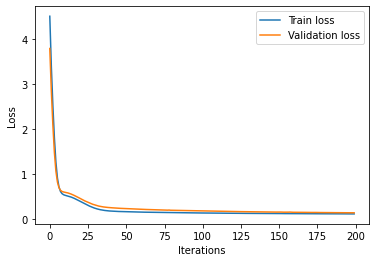

The loss on validation set is: 0.14237655699253082


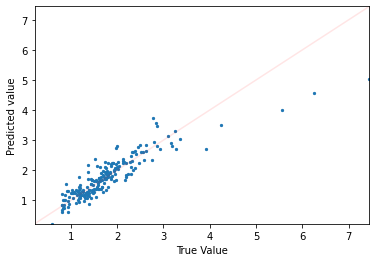

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


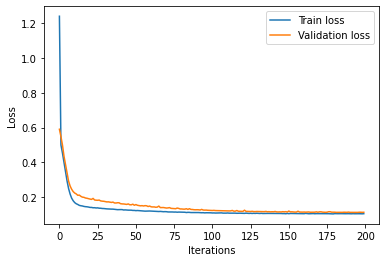

The loss on validation set is: 0.112737275660038


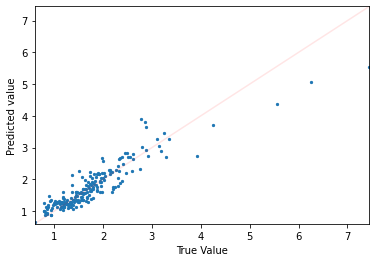

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


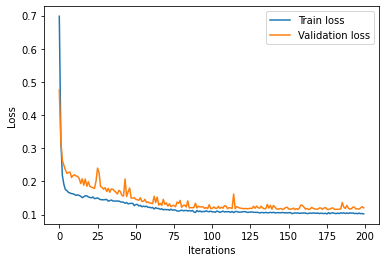

The loss on validation set is: 0.12038540095090866


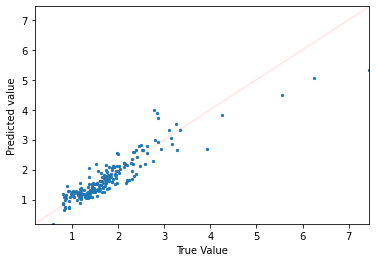

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


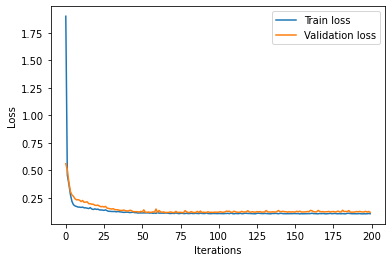

The loss on validation set is: 0.1193254217505455


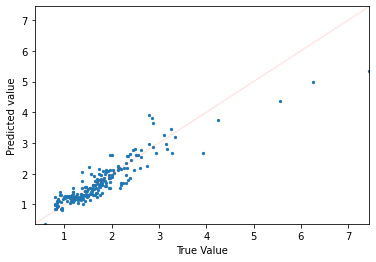

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


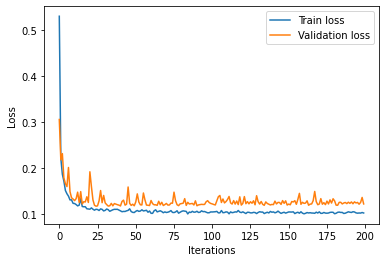

The loss on validation set is: 0.12278394401073456


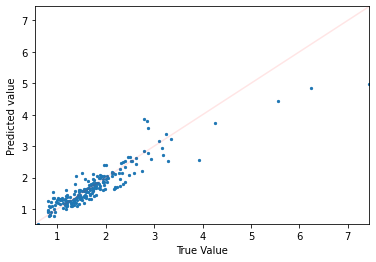

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


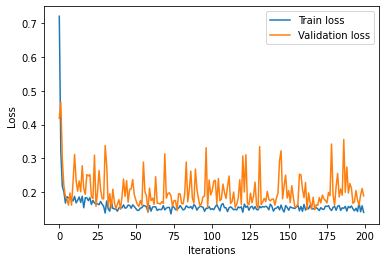

The loss on validation set is: 0.1891821026802063


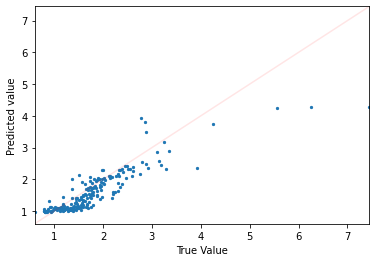

TRAINING WITH [2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


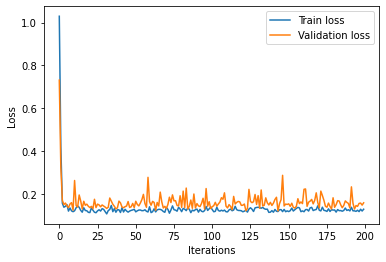

The loss on validation set is: 0.15923762321472168


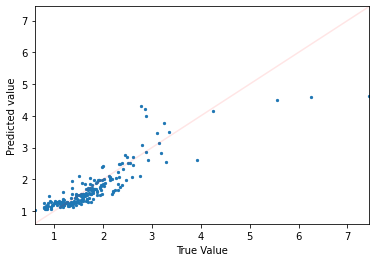

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


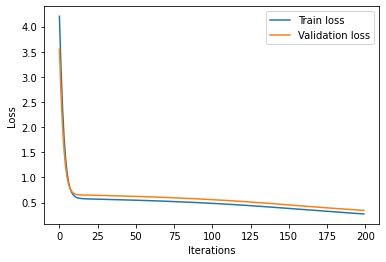

The loss on validation set is: 0.34377825260162354


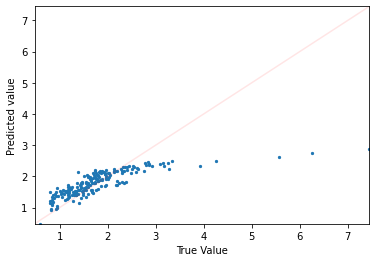

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


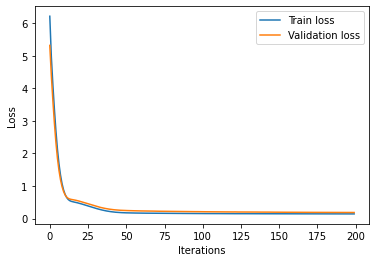

The loss on validation set is: 0.1860085427761078


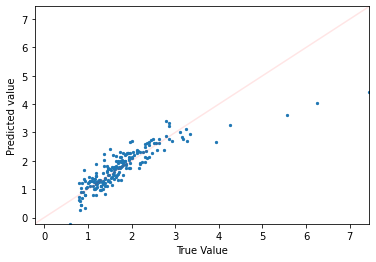

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


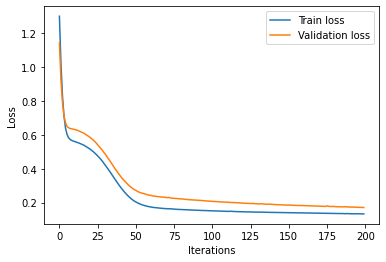

The loss on validation set is: 0.17132797837257385


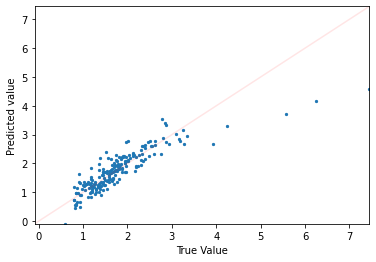

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


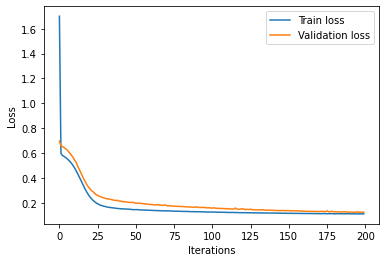

The loss on validation set is: 0.12313907593488693


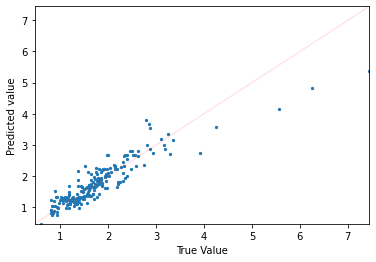

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


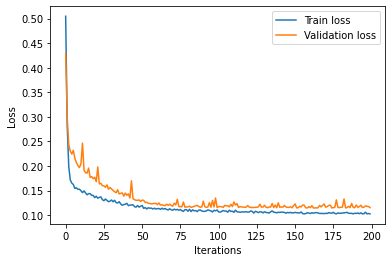

The loss on validation set is: 0.11540117859840393


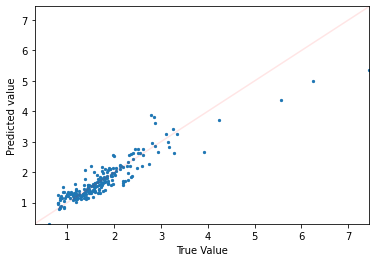

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


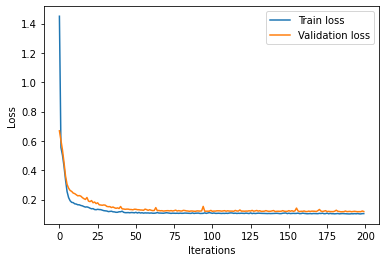

The loss on validation set is: 0.11817015707492828


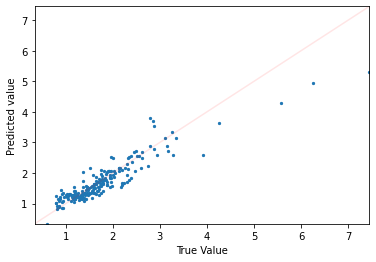

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


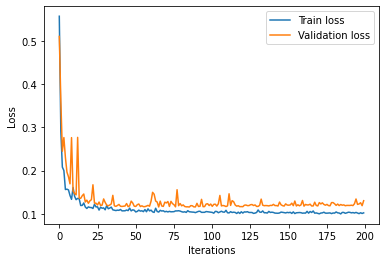

The loss on validation set is: 0.1301855891942978


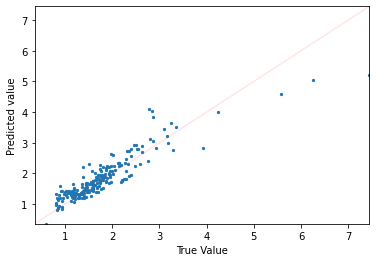

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


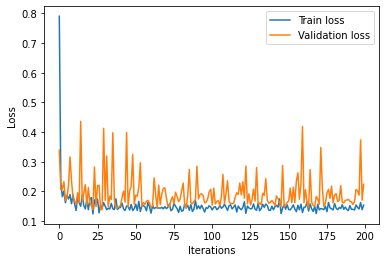

The loss on validation set is: 0.22377581894397736


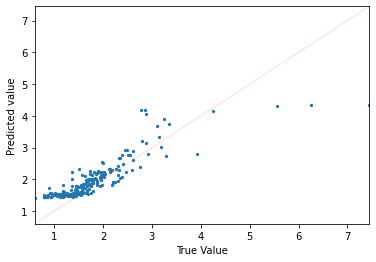

TRAINING WITH [2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


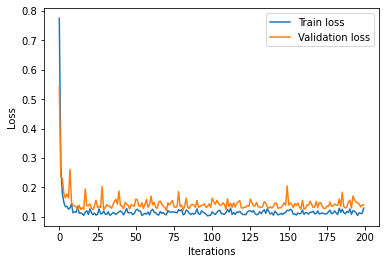

The loss on validation set is: 0.14067140221595764


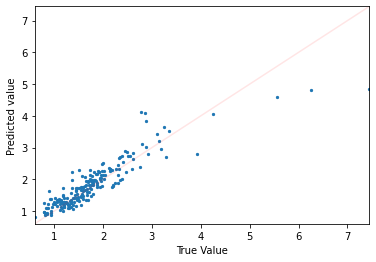

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


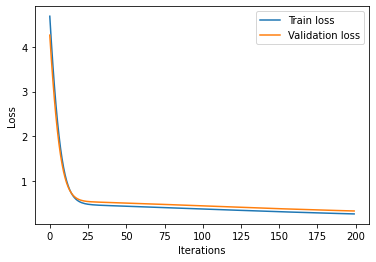

The loss on validation set is: 0.32600128650665283


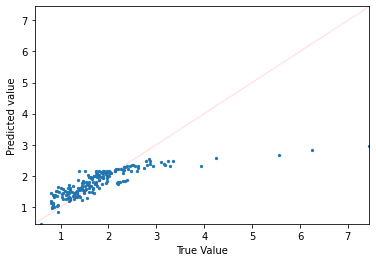

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


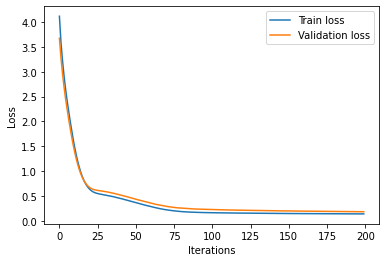

The loss on validation set is: 0.18325769901275635


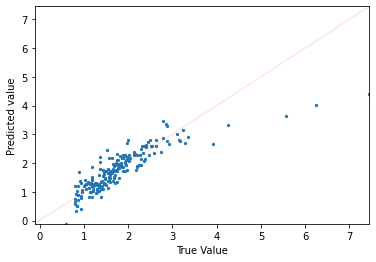

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


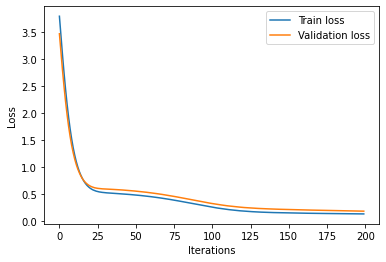

The loss on validation set is: 0.18569375574588776


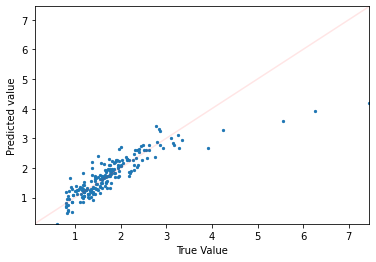

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


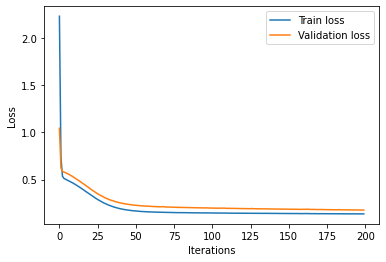

The loss on validation set is: 0.17745214700698853


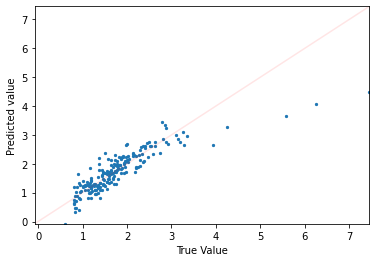

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


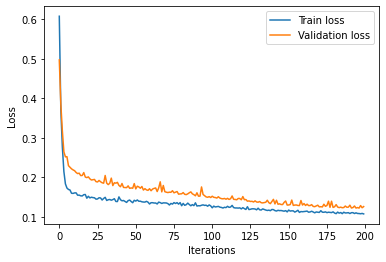

The loss on validation set is: 0.12555737793445587


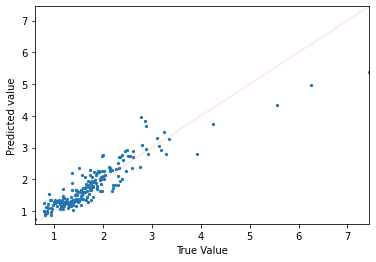

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


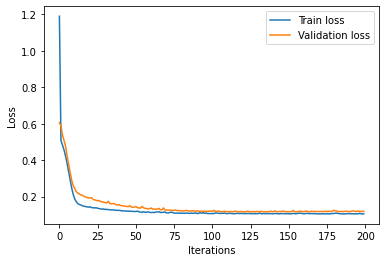

The loss on validation set is: 0.1183648407459259


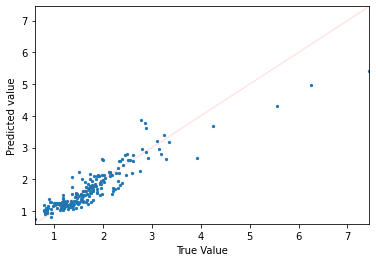

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


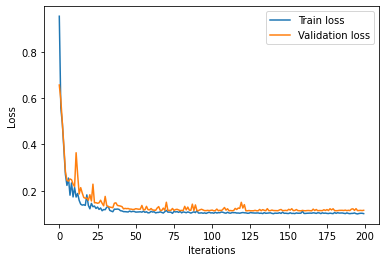

The loss on validation set is: 0.11567690223455429


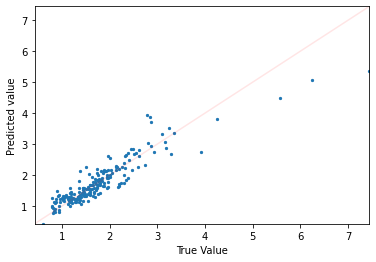

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


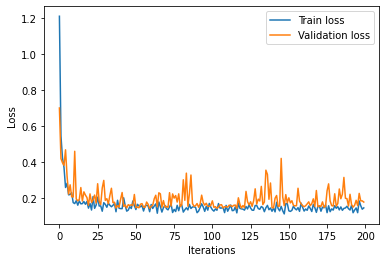

The loss on validation set is: 0.17561925947666168


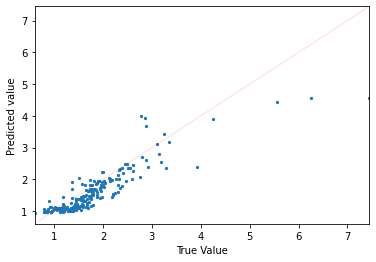

TRAINING WITH [2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


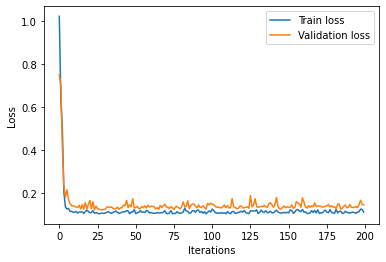

The loss on validation set is: 0.14439040422439575


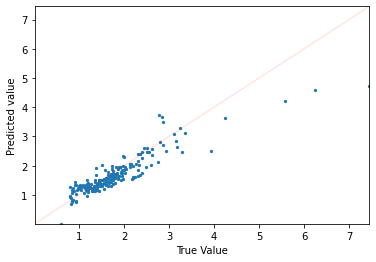

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


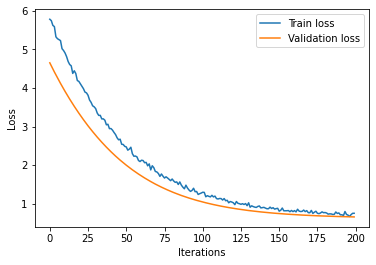

The loss on validation set is: 0.652894914150238


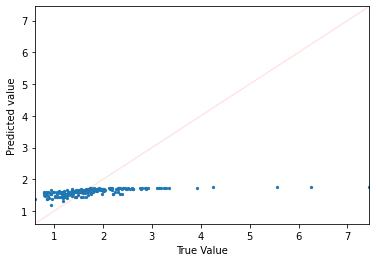

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


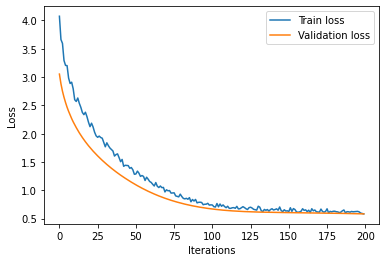

The loss on validation set is: 0.5826743245124817


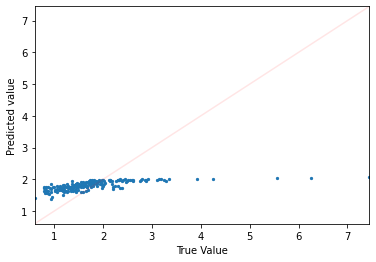

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


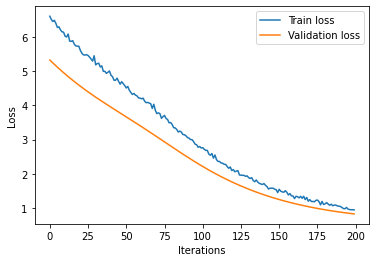

The loss on validation set is: 0.8272976875305176


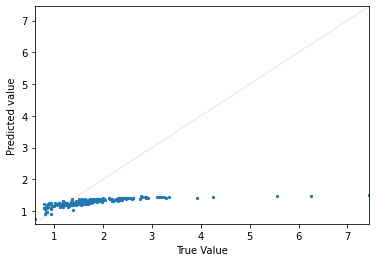

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


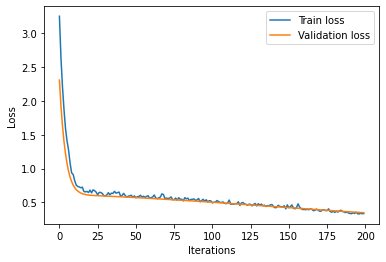

The loss on validation set is: 0.34918344020843506


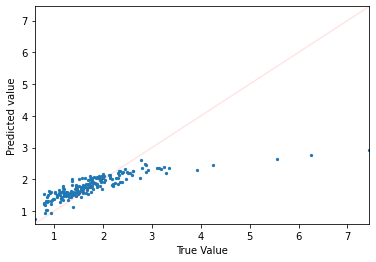

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


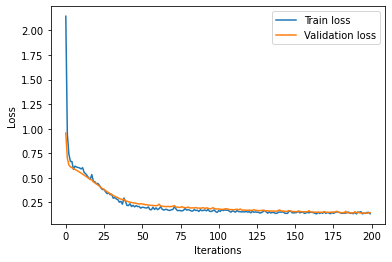

The loss on validation set is: 0.147417351603508


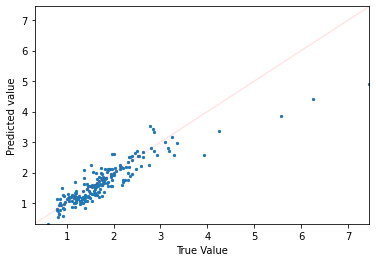

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


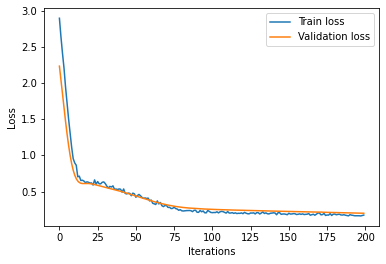

The loss on validation set is: 0.1985059380531311


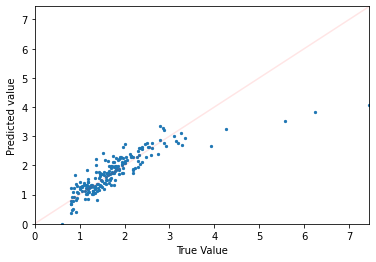

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


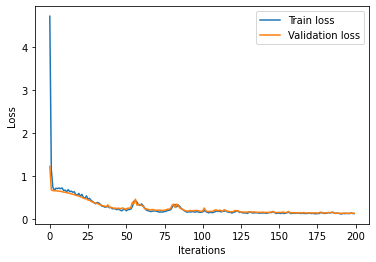

The loss on validation set is: 0.142471581697464


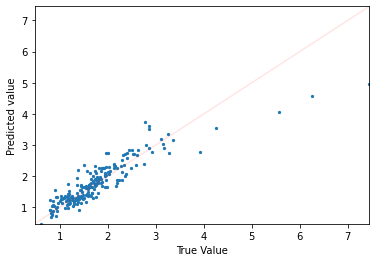

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


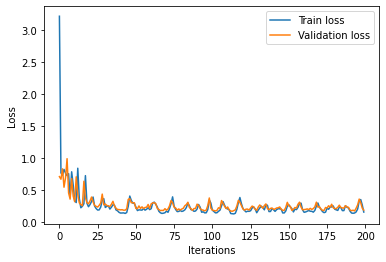

The loss on validation set is: 0.1827978938817978


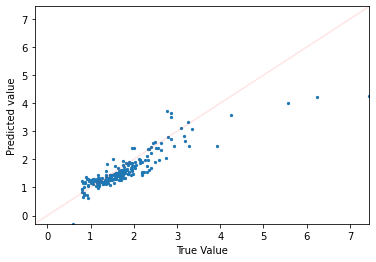

TRAINING WITH [2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


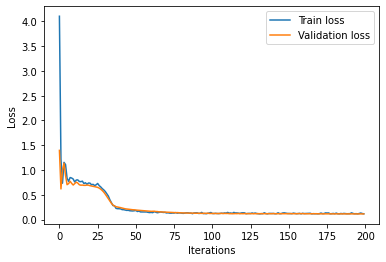

The loss on validation set is: 0.11524143815040588


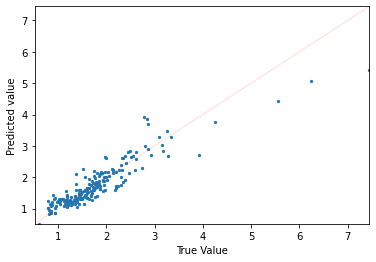

  8%|▊         | 1/13 [04:10<50:04, 250.34s/it]

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


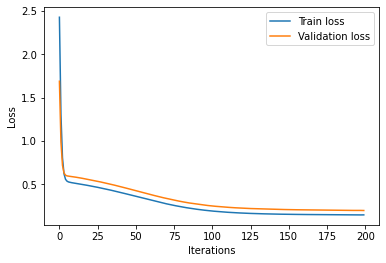

The loss on validation set is: 0.200084388256073


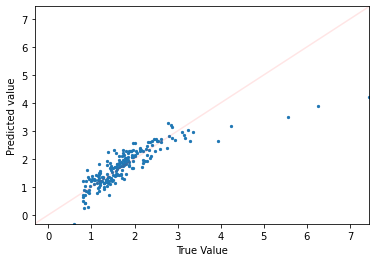

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


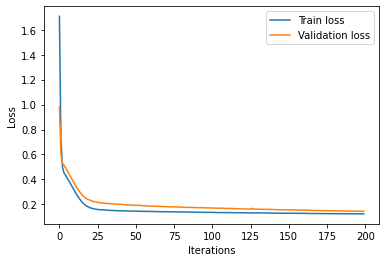

The loss on validation set is: 0.14455734193325043


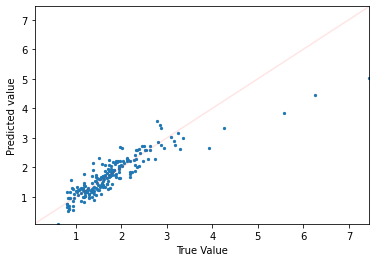

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


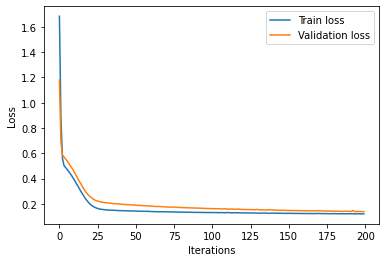

The loss on validation set is: 0.13842329382896423


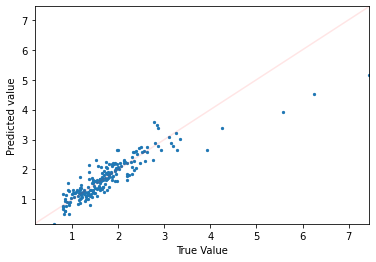

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


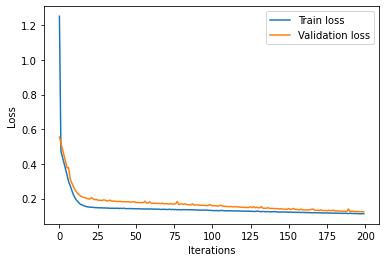

The loss on validation set is: 0.12413690239191055


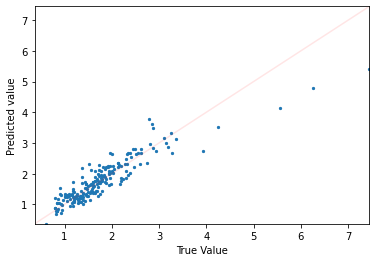

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


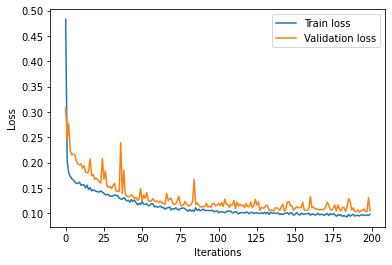

The loss on validation set is: 0.10550733655691147


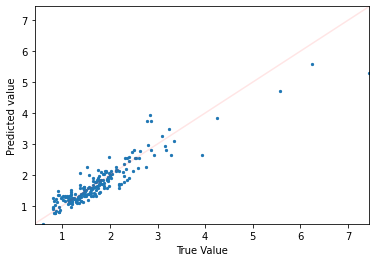

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


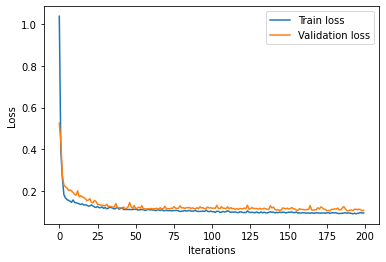

The loss on validation set is: 0.10903529822826385


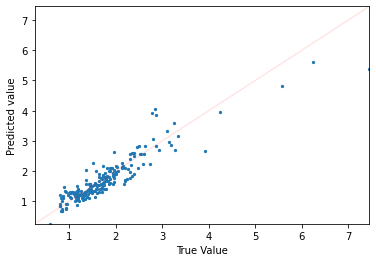

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


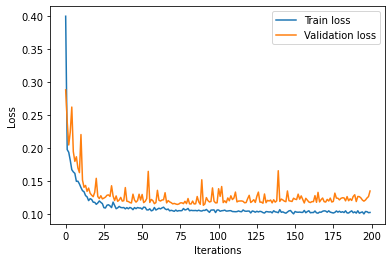

The loss on validation set is: 0.13556621968746185


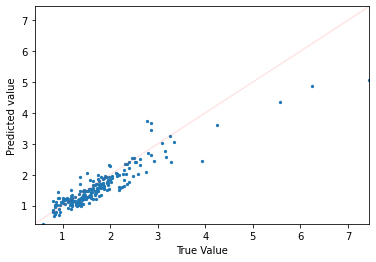

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


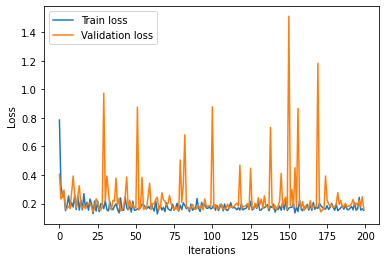

The loss on validation set is: 0.16121728718280792


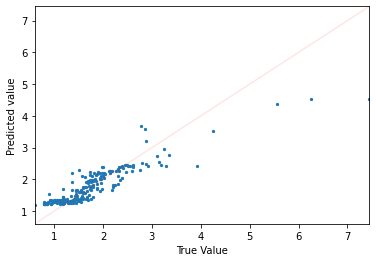

TRAINING WITH [4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


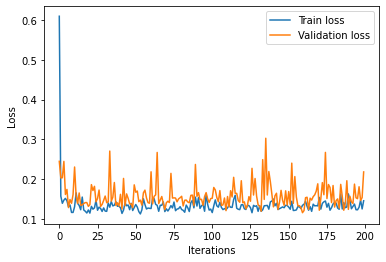

The loss on validation set is: 0.21796521544456482


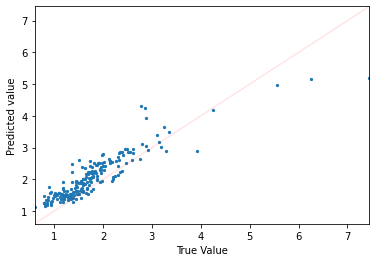

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


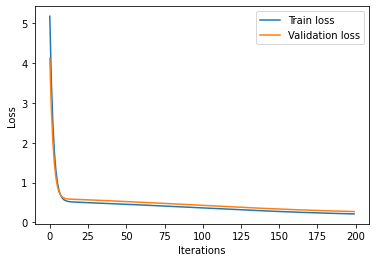

The loss on validation set is: 0.2711762487888336


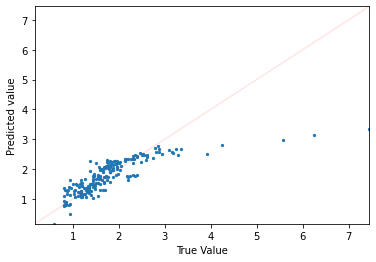

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


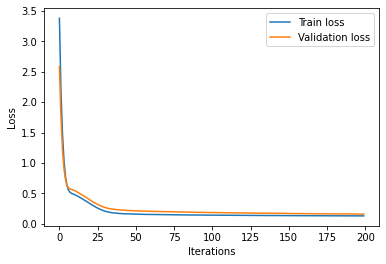

The loss on validation set is: 0.16050289571285248


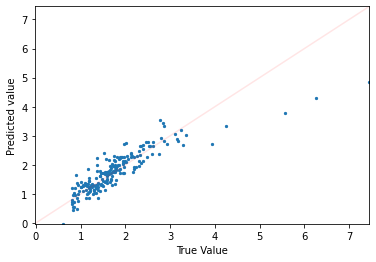

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


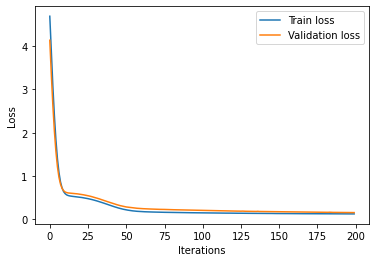

The loss on validation set is: 0.1584794968366623


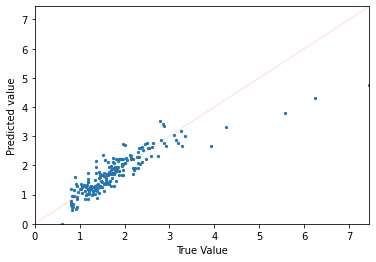

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


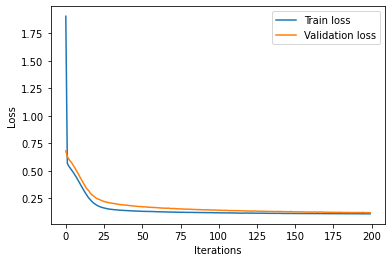

The loss on validation set is: 0.11919976025819778


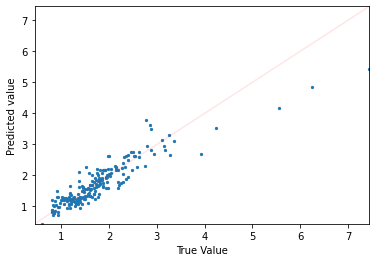

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


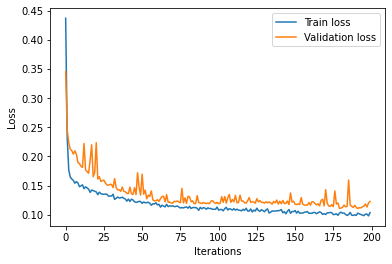

The loss on validation set is: 0.12283731251955032


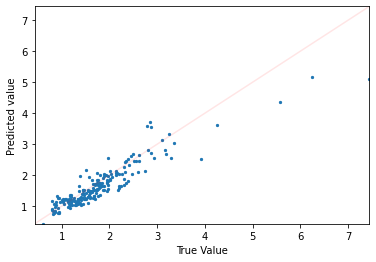

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


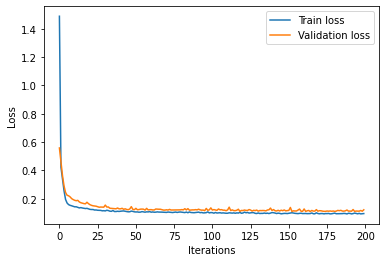

The loss on validation set is: 0.12237391620874405


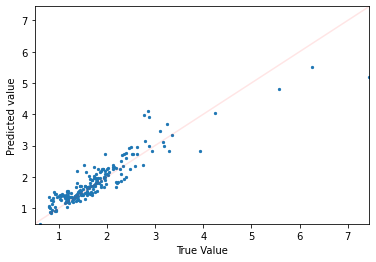

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


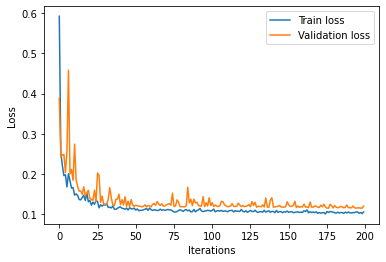

The loss on validation set is: 0.12019550055265427


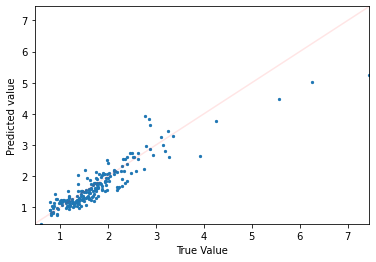

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


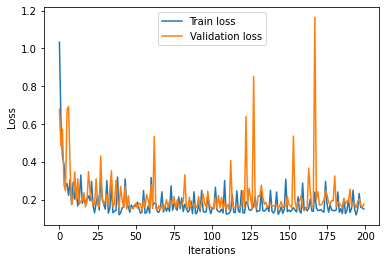

The loss on validation set is: 0.1752595454454422


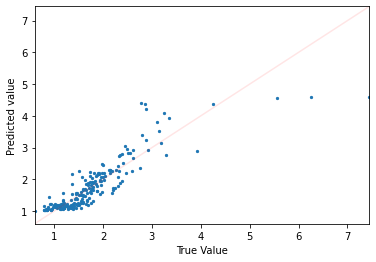

TRAINING WITH [4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


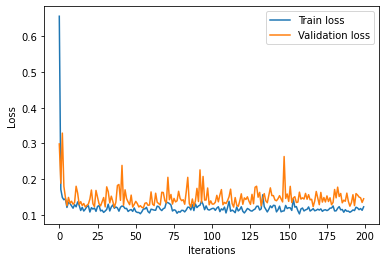

The loss on validation set is: 0.14501823484897614


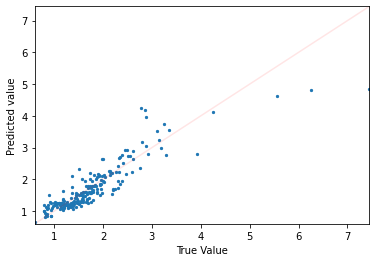

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


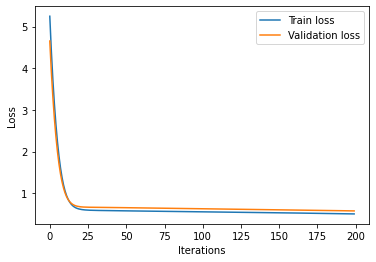

The loss on validation set is: 0.5762639045715332


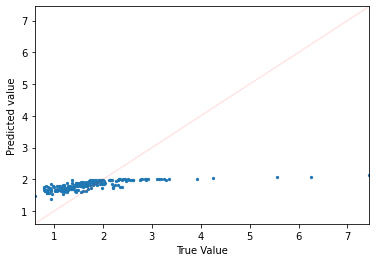

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


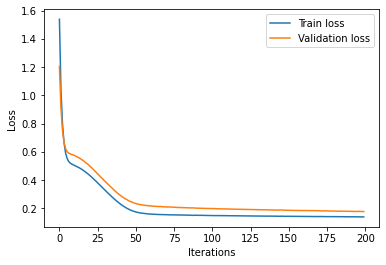

The loss on validation set is: 0.17671321332454681


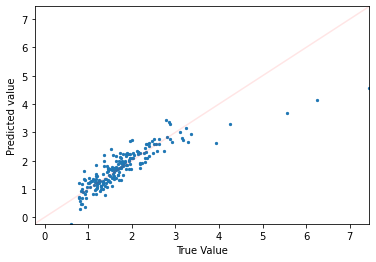

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


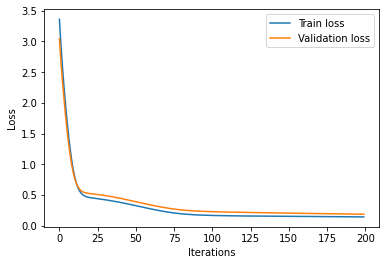

The loss on validation set is: 0.1850637048482895


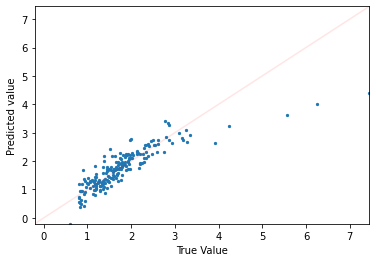

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


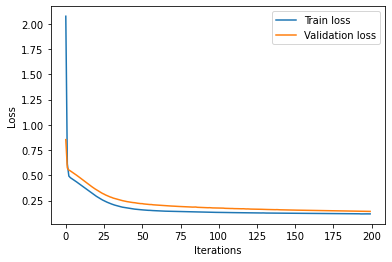

The loss on validation set is: 0.14251095056533813


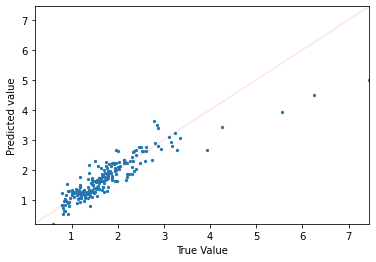

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


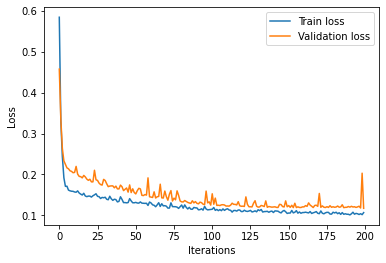

The loss on validation set is: 0.11721938848495483


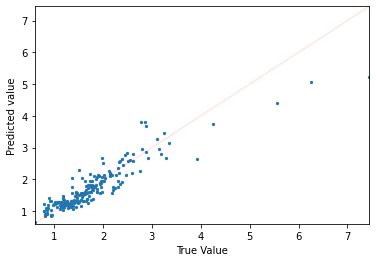

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


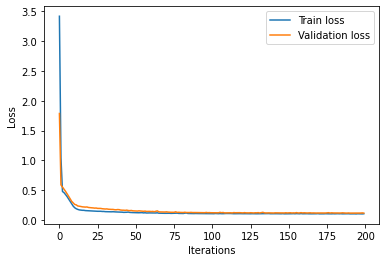

The loss on validation set is: 0.1152237057685852


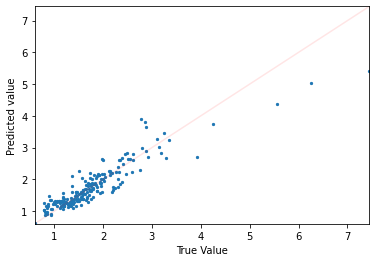

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


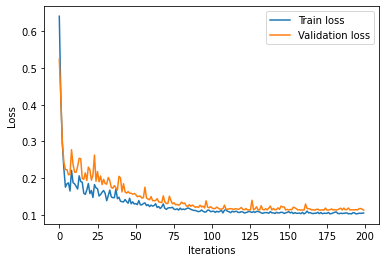

The loss on validation set is: 0.11302289366722107


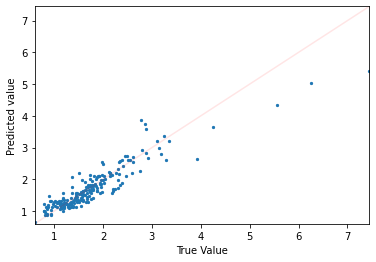

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


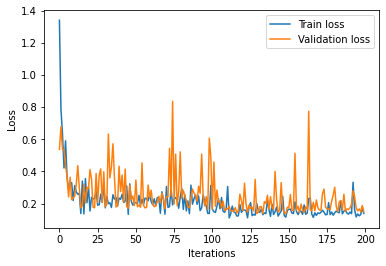

The loss on validation set is: 0.1483708620071411


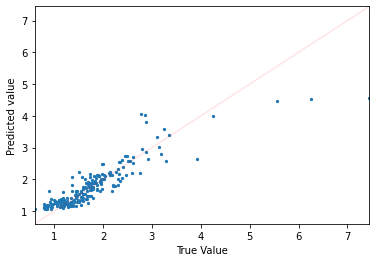

TRAINING WITH [4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


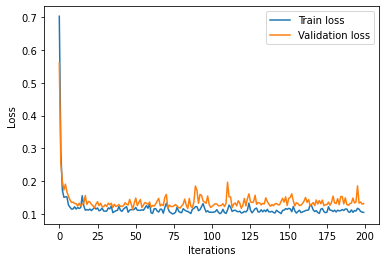

The loss on validation set is: 0.13140100240707397


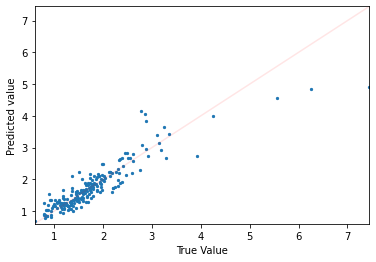

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


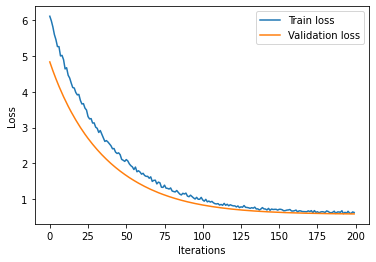

The loss on validation set is: 0.5869258046150208


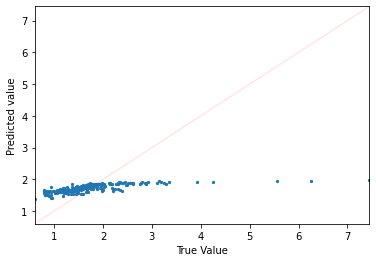

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


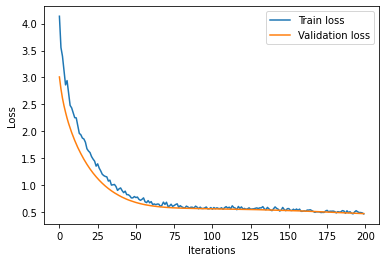

The loss on validation set is: 0.4754010736942291


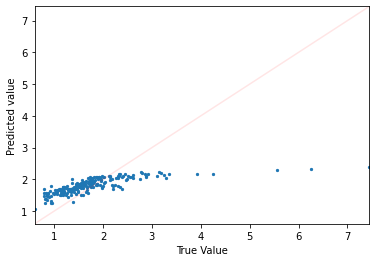

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


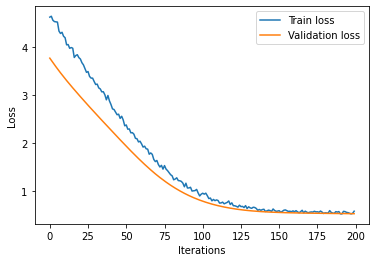

The loss on validation set is: 0.5210366249084473


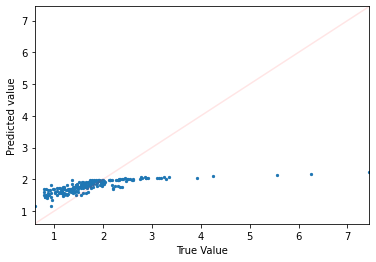

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


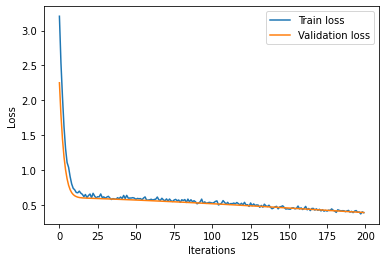

The loss on validation set is: 0.3933161199092865


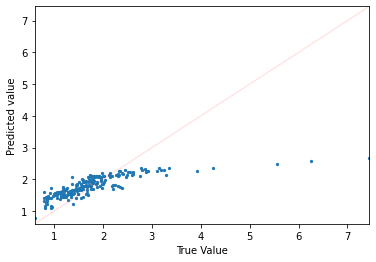

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


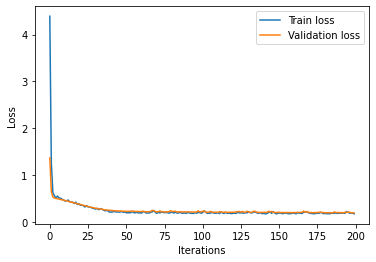

The loss on validation set is: 0.18869422376155853


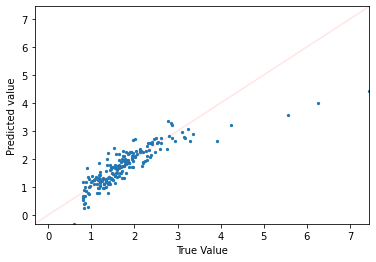

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


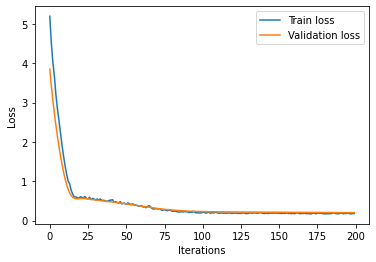

The loss on validation set is: 0.2016213983297348


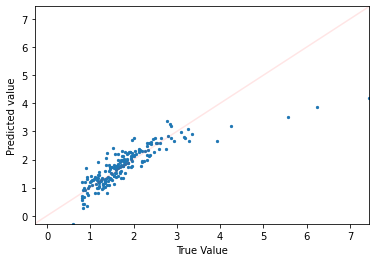

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


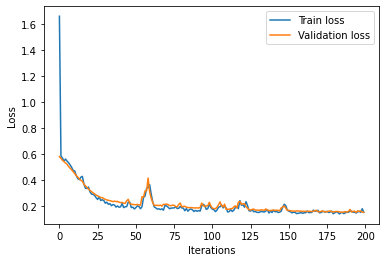

The loss on validation set is: 0.15013553202152252


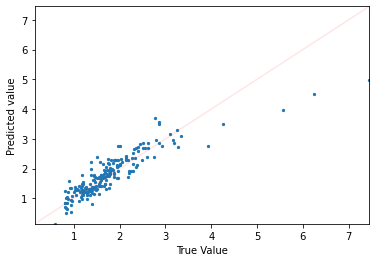

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


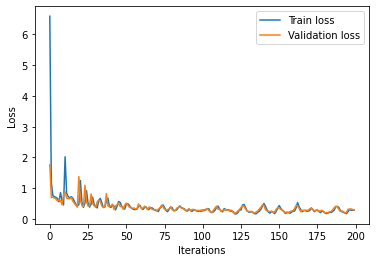

The loss on validation set is: 0.2849247455596924


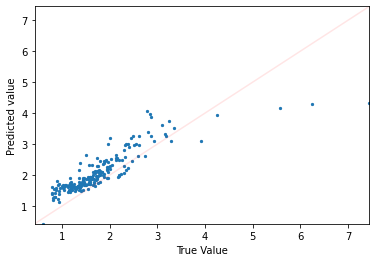

TRAINING WITH [4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


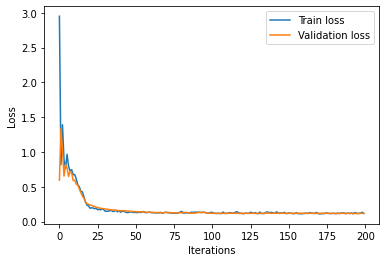

The loss on validation set is: 0.11786980926990509


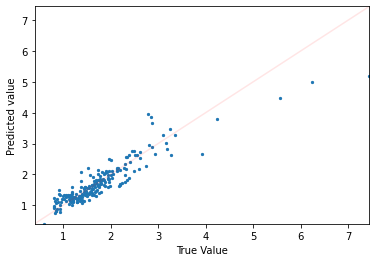

 15%|█▌        | 2/13 [08:22<46:03, 251.25s/it]

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


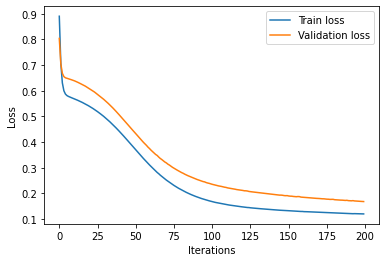

The loss on validation set is: 0.16798189282417297


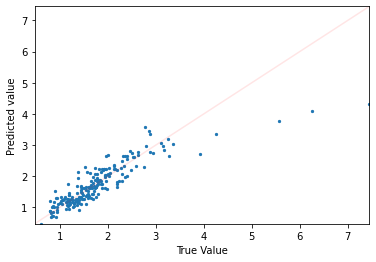

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


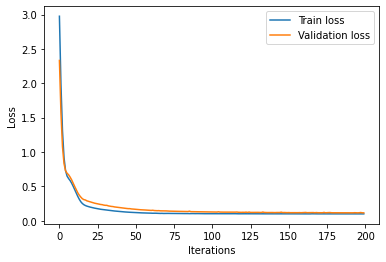

The loss on validation set is: 0.11485949158668518


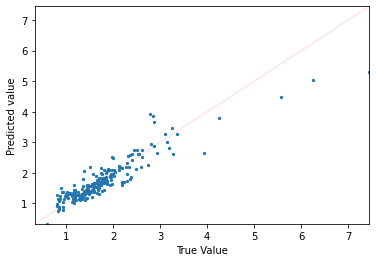

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


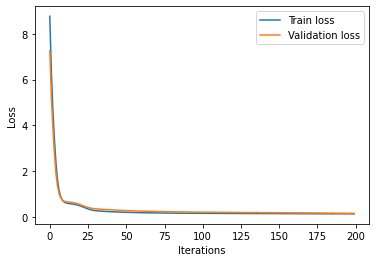

The loss on validation set is: 0.14865240454673767


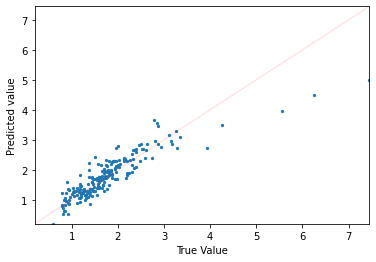

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


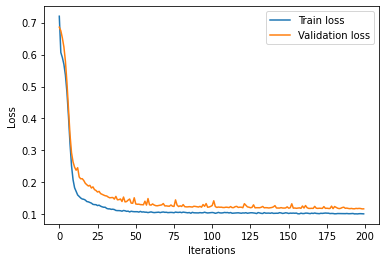

The loss on validation set is: 0.11731702834367752


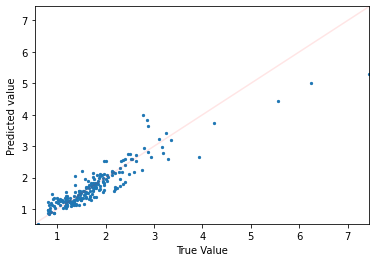

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


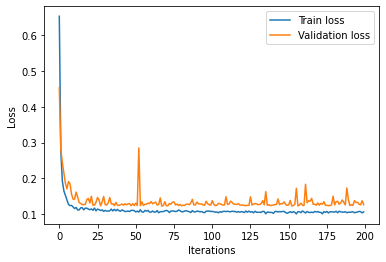

The loss on validation set is: 0.12645351886749268


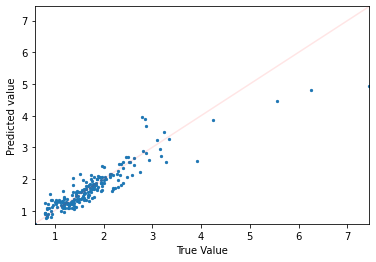

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


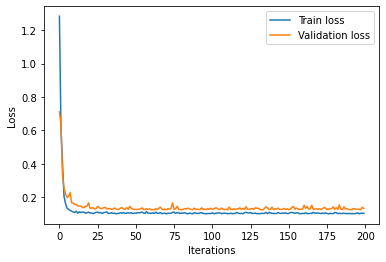

The loss on validation set is: 0.1330673098564148


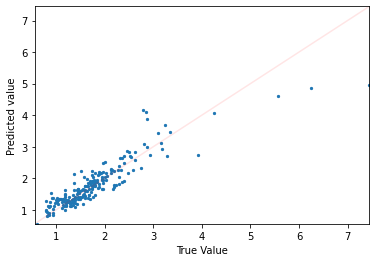

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


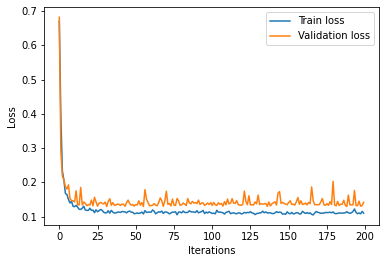

The loss on validation set is: 0.1414865404367447


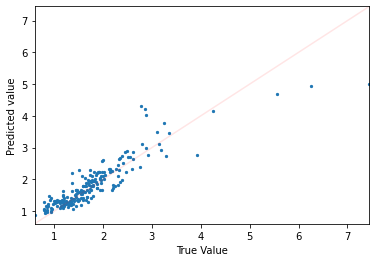

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


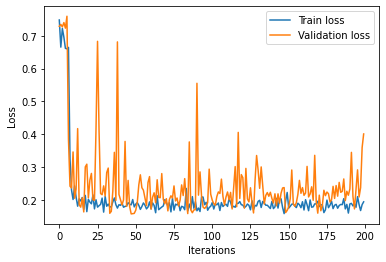

The loss on validation set is: 0.40067484974861145


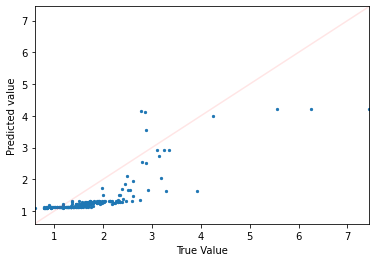

TRAINING WITH [2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


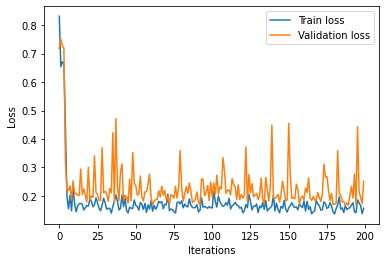

The loss on validation set is: 0.25152847170829773


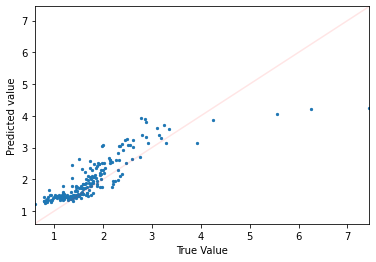

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


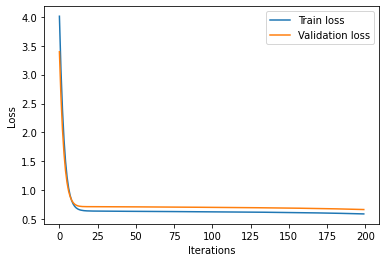

The loss on validation set is: 0.6650771498680115


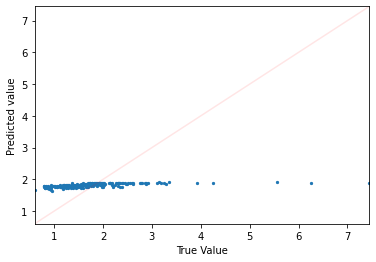

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


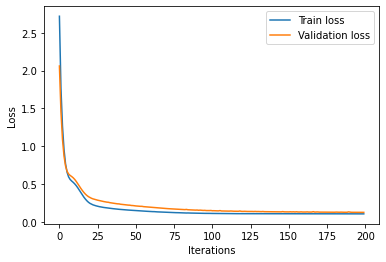

The loss on validation set is: 0.12383235991001129


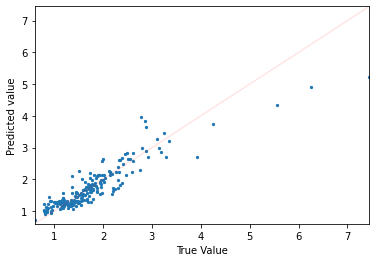

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


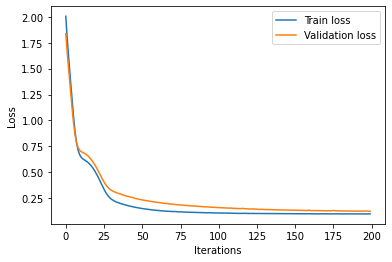

The loss on validation set is: 0.12498734146356583


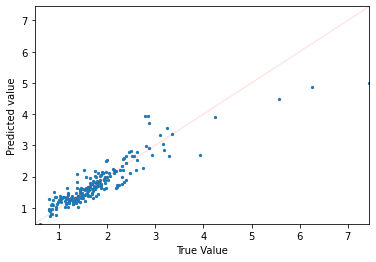

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


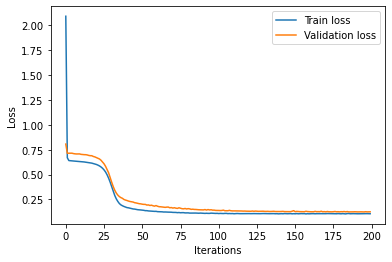

The loss on validation set is: 0.12534862756729126


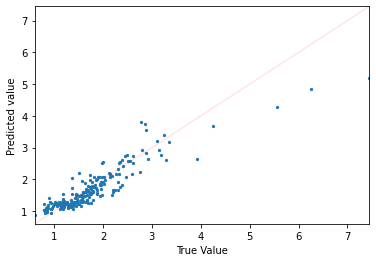

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


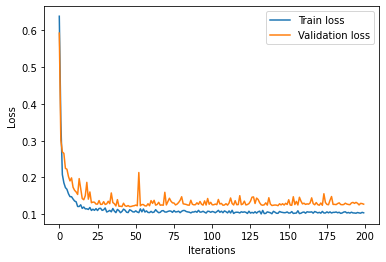

The loss on validation set is: 0.1273033320903778


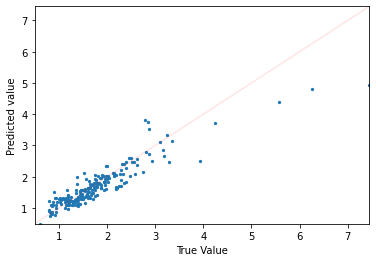

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


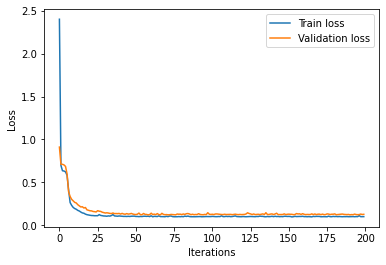

The loss on validation set is: 0.1283799409866333


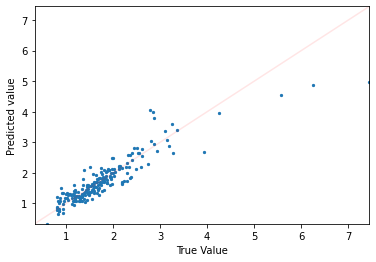

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


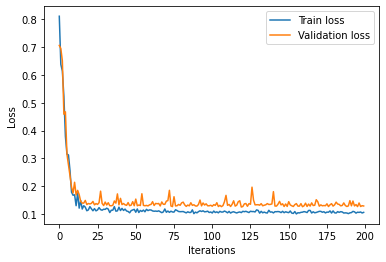

The loss on validation set is: 0.12897084653377533


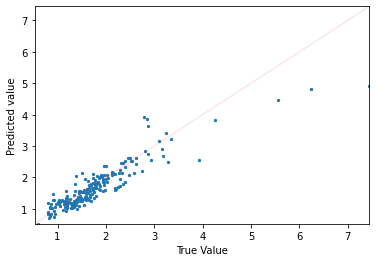

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


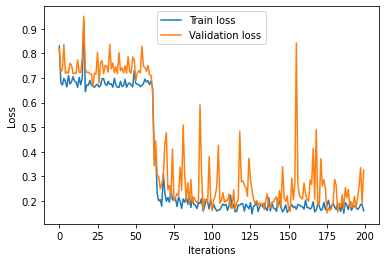

The loss on validation set is: 0.32487380504608154


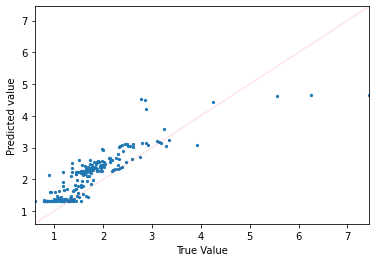

TRAINING WITH [2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


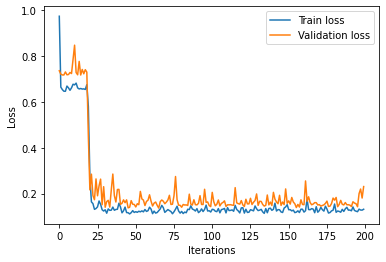

The loss on validation set is: 0.23022516071796417


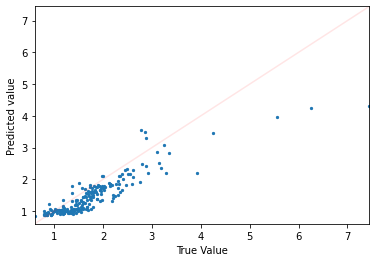

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


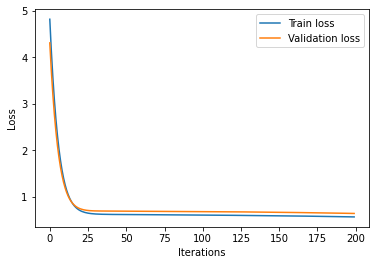

The loss on validation set is: 0.6401271820068359


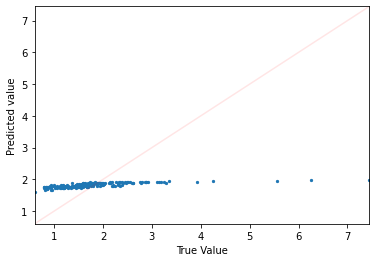

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


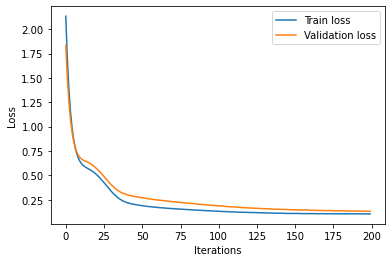

The loss on validation set is: 0.13112975656986237


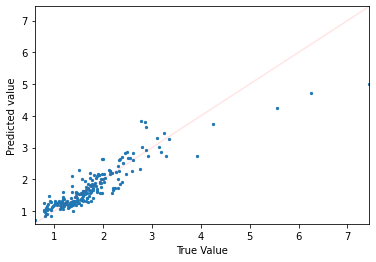

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


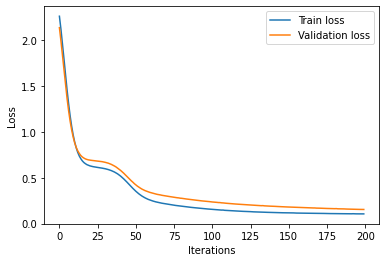

The loss on validation set is: 0.15441614389419556


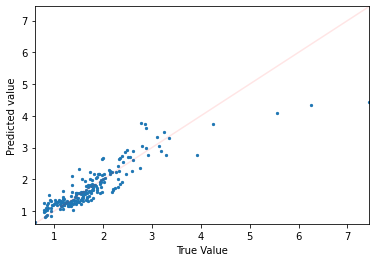

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


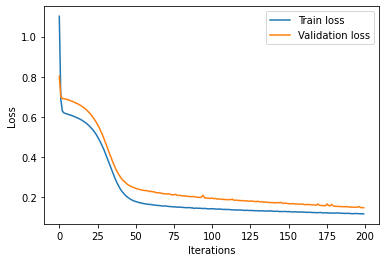

The loss on validation set is: 0.14719486236572266


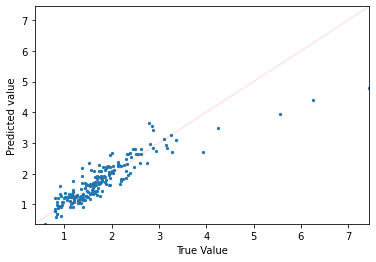

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


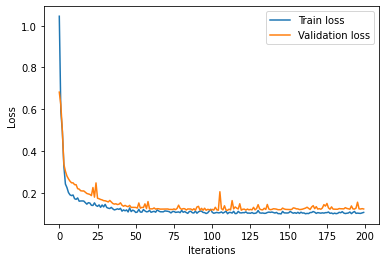

The loss on validation set is: 0.12283872812986374


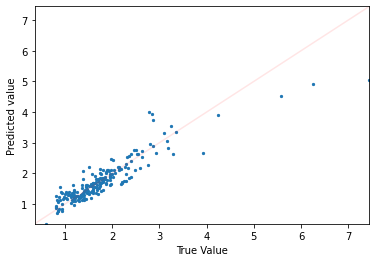

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


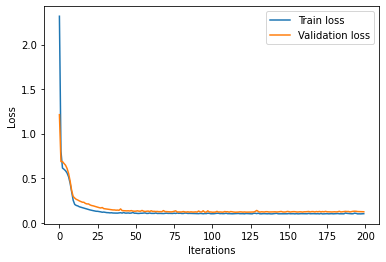

The loss on validation set is: 0.12252345681190491


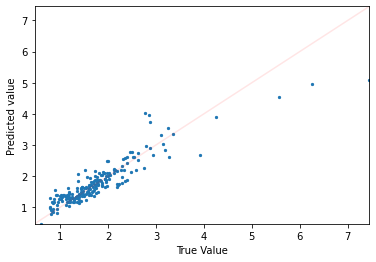

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


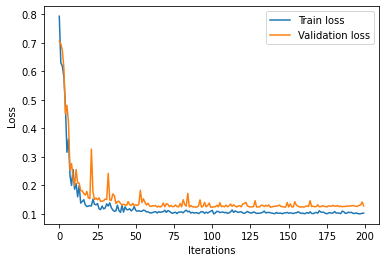

The loss on validation set is: 0.12739719450473785


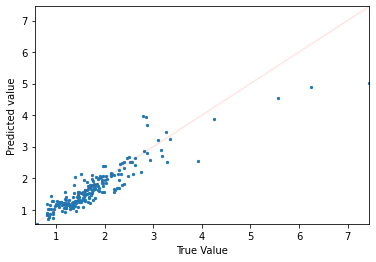

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


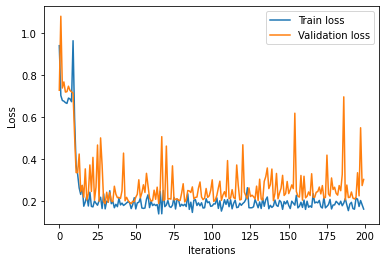

The loss on validation set is: 0.30388501286506653


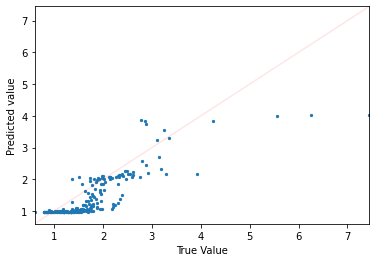

TRAINING WITH [2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


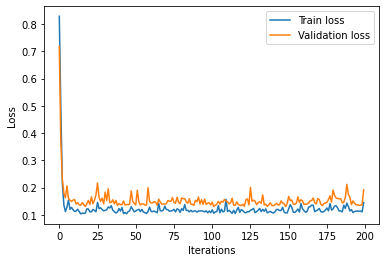

The loss on validation set is: 0.1917986422777176


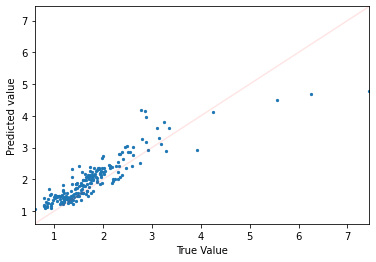

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


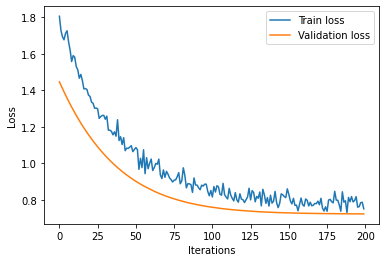

The loss on validation set is: 0.722491443157196


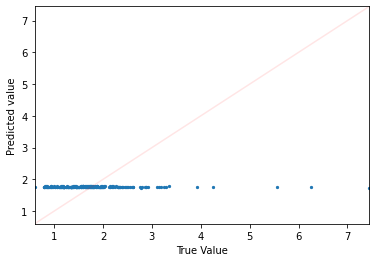

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


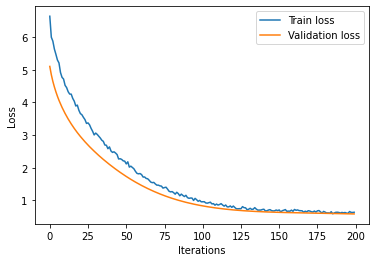

The loss on validation set is: 0.5849059224128723


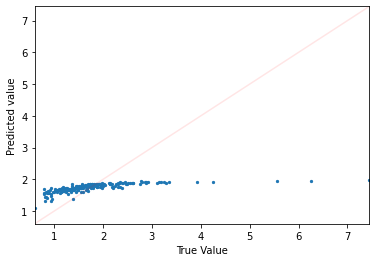

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


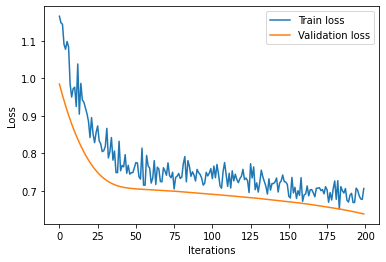

The loss on validation set is: 0.638127326965332


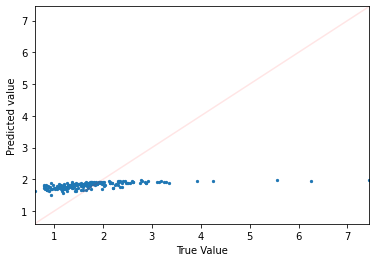

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


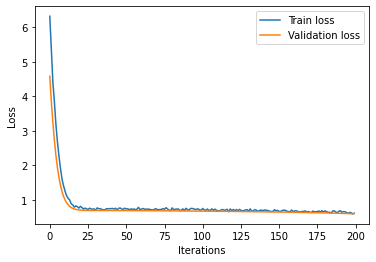

The loss on validation set is: 0.5960056185722351


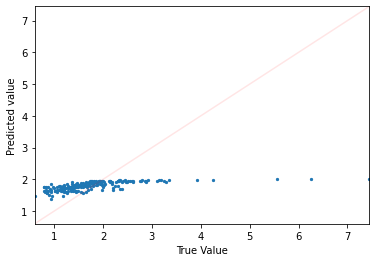

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


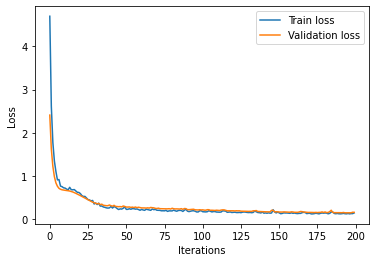

The loss on validation set is: 0.16052168607711792


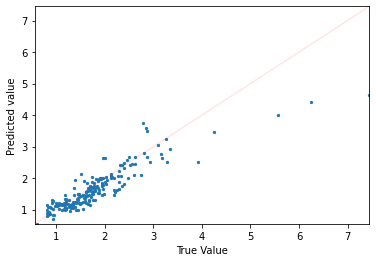

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


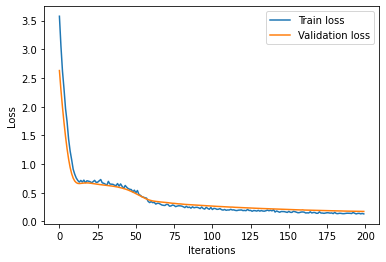

The loss on validation set is: 0.1740664690732956


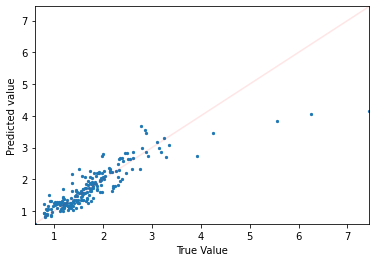

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


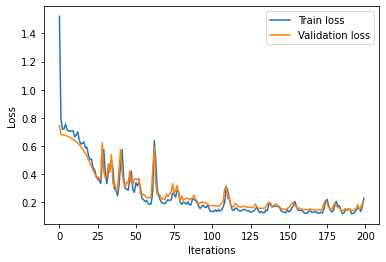

The loss on validation set is: 0.20278166234493256


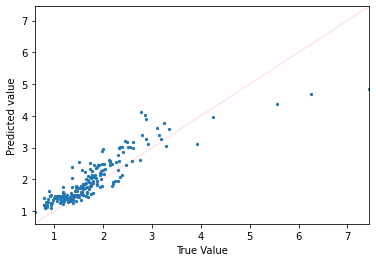

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


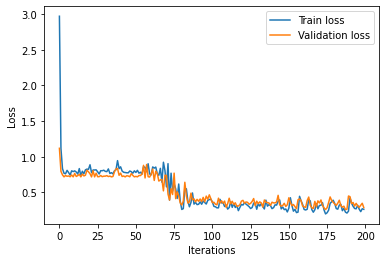

The loss on validation set is: 0.2869819402694702


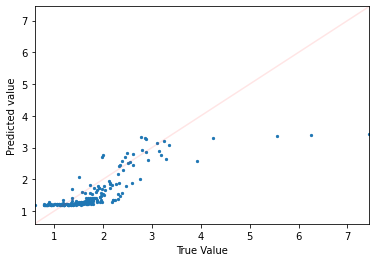

TRAINING WITH [2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


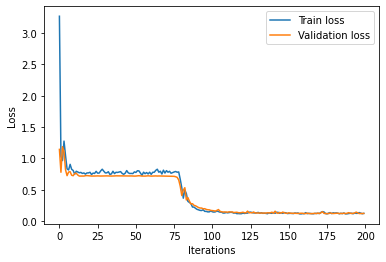

The loss on validation set is: 0.12207642197608948


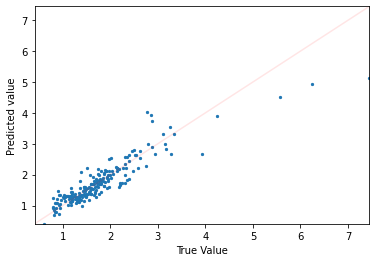

 23%|██▎       | 3/13 [13:19<45:22, 272.29s/it]

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


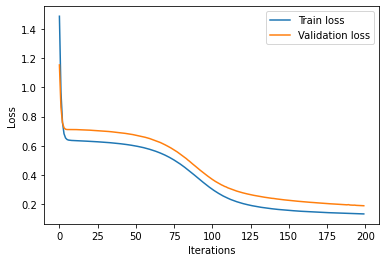

The loss on validation set is: 0.1908070147037506


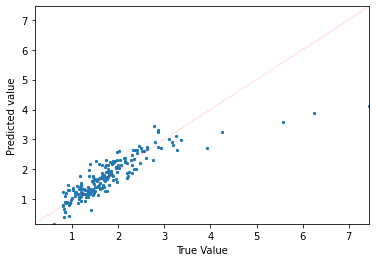

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


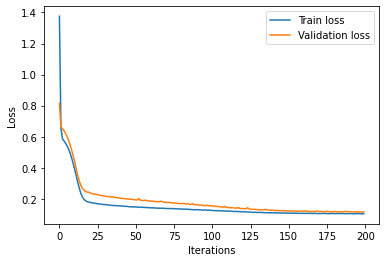

The loss on validation set is: 0.11574768275022507


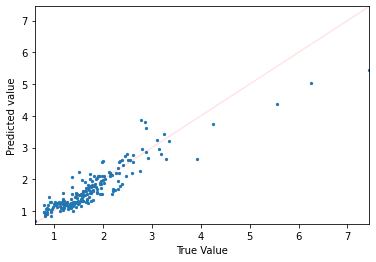

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


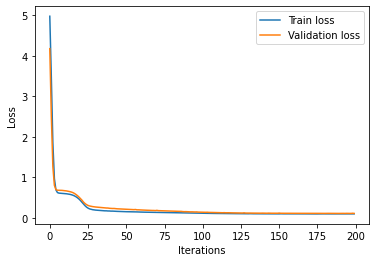

The loss on validation set is: 0.11375942081212997


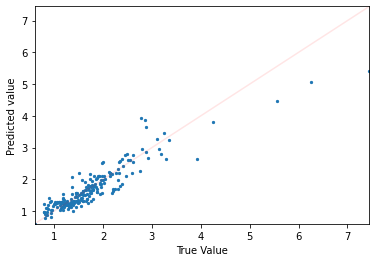

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


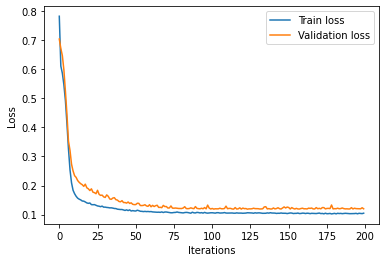

The loss on validation set is: 0.11975543200969696


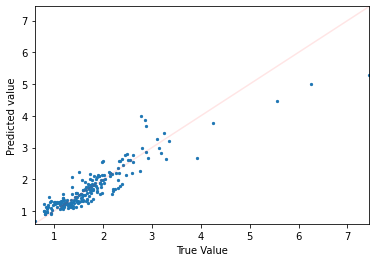

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


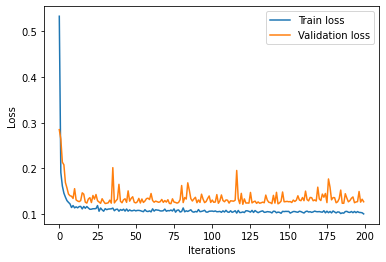

The loss on validation set is: 0.12724225223064423


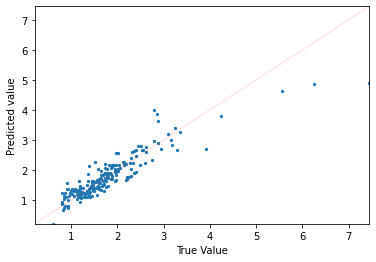

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


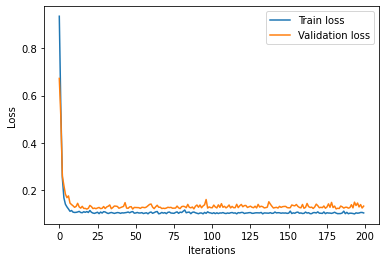

The loss on validation set is: 0.13339968025684357


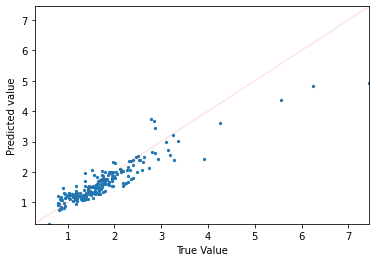

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


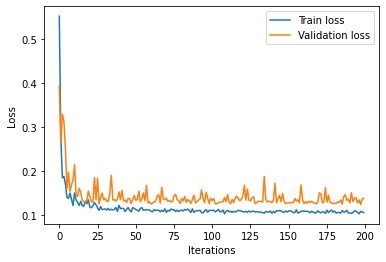

The loss on validation set is: 0.1376017928123474


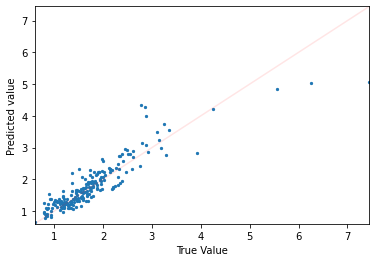

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


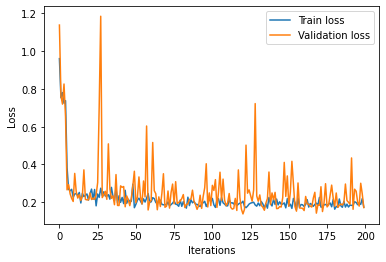

The loss on validation set is: 0.17204032838344574


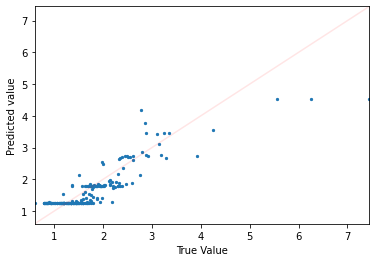

TRAINING WITH [2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


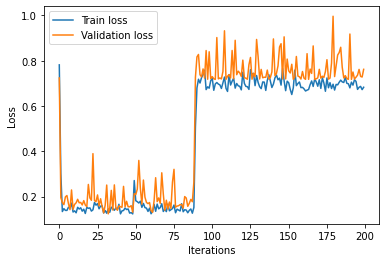

The loss on validation set is: 0.7621150016784668


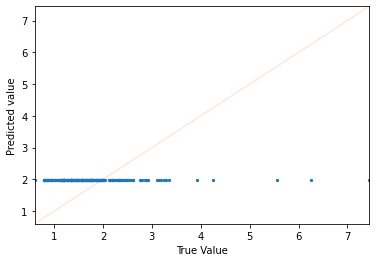

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


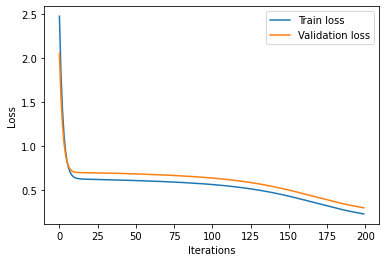

The loss on validation set is: 0.30358076095581055


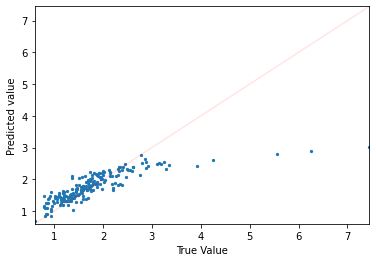

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


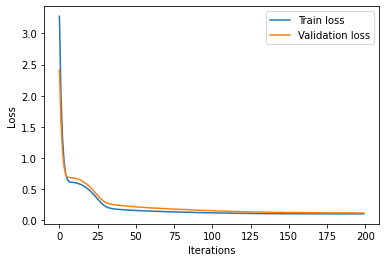

The loss on validation set is: 0.11743266135454178


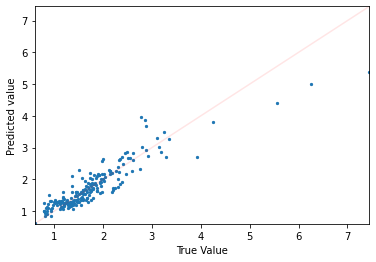

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


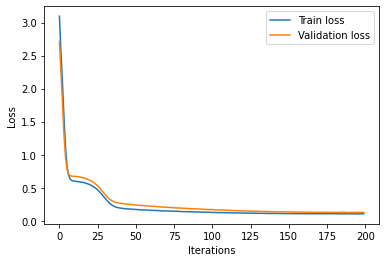

The loss on validation set is: 0.1252516359090805


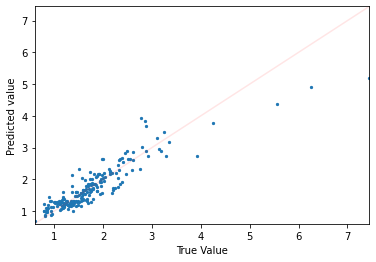

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


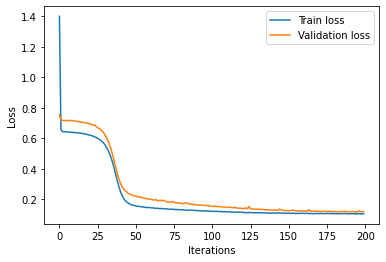

The loss on validation set is: 0.12010202556848526


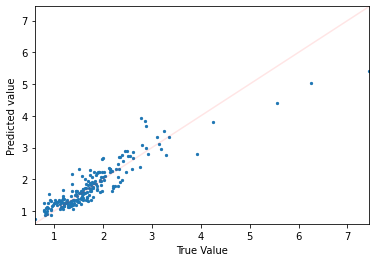

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


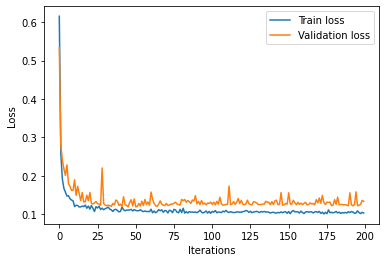

The loss on validation set is: 0.1336992233991623


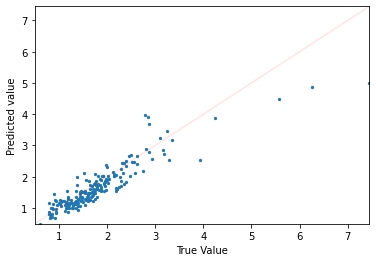

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


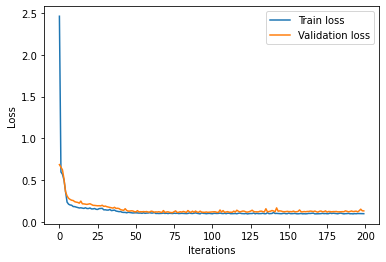

The loss on validation set is: 0.13483092188835144


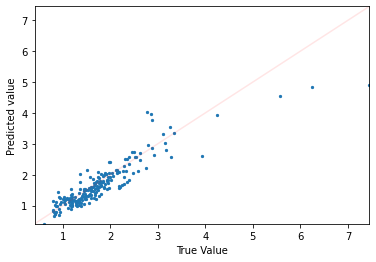

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


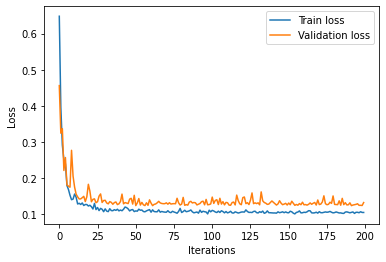

The loss on validation set is: 0.1310918778181076


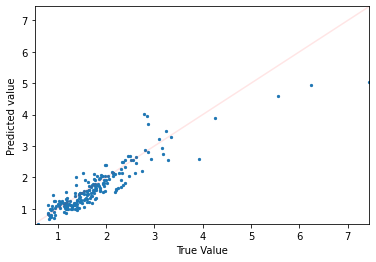

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


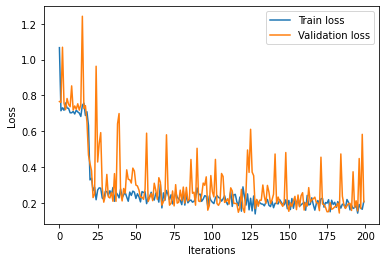

The loss on validation set is: 0.20618833601474762


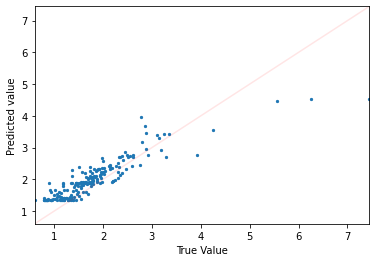

TRAINING WITH [2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


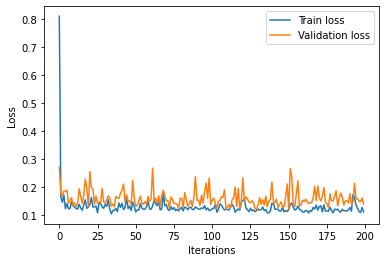

The loss on validation set is: 0.13844984769821167


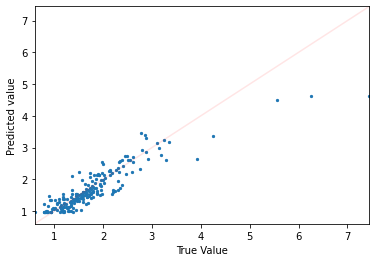

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


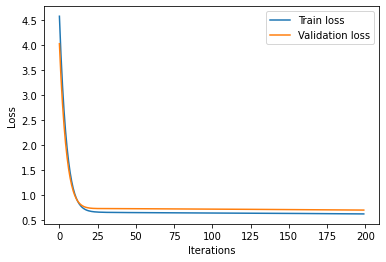

The loss on validation set is: 0.7042232751846313


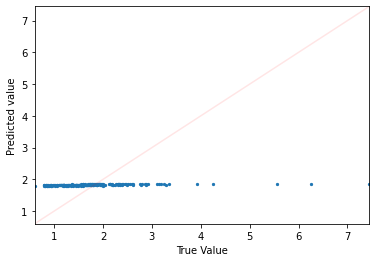

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


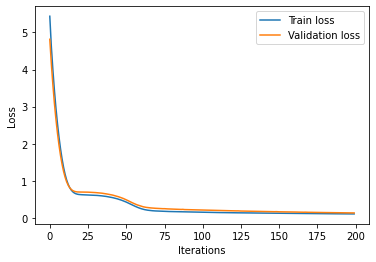

The loss on validation set is: 0.13712400197982788


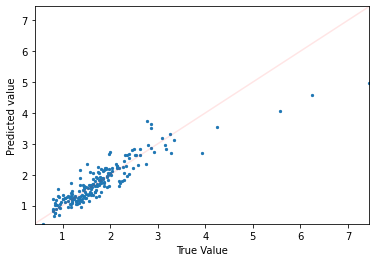

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


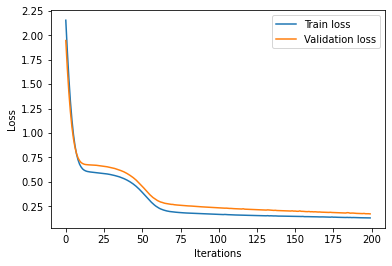

The loss on validation set is: 0.17227375507354736


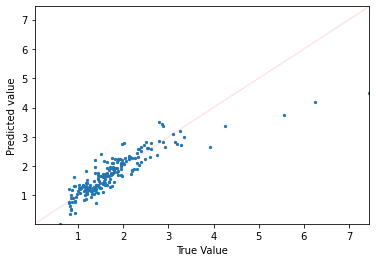

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


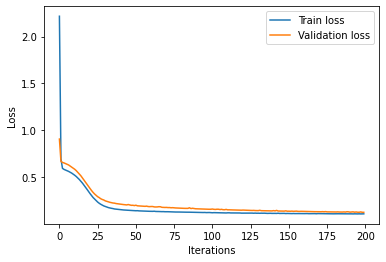

The loss on validation set is: 0.12455449998378754


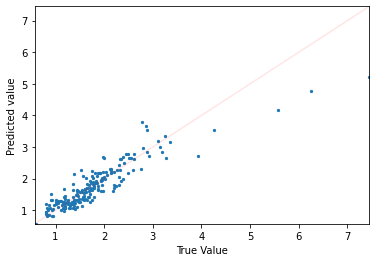

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


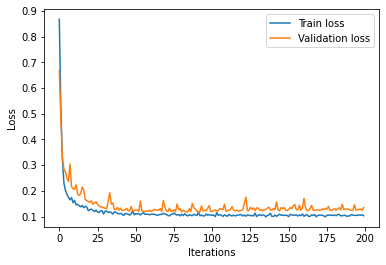

The loss on validation set is: 0.135190948843956


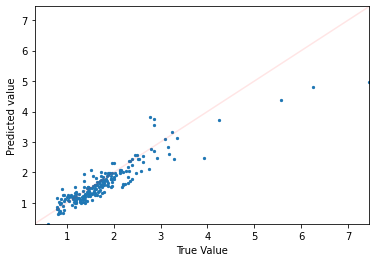

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


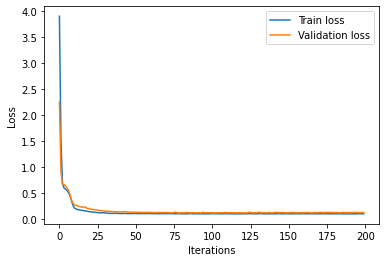

The loss on validation set is: 0.12656792998313904


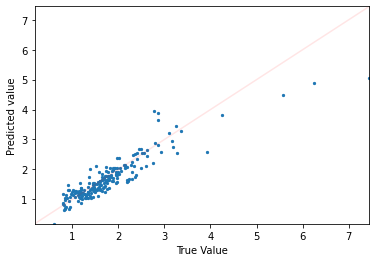

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


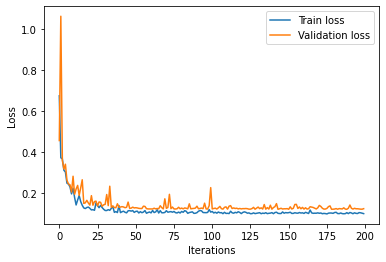

The loss on validation set is: 0.12513214349746704


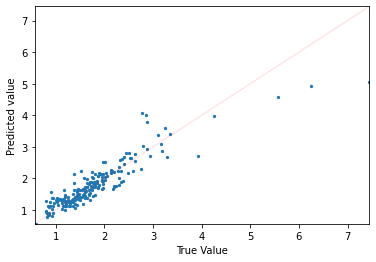

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


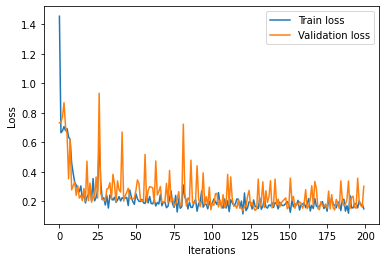

The loss on validation set is: 0.30246487259864807


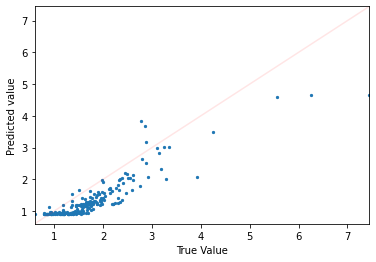

TRAINING WITH [2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


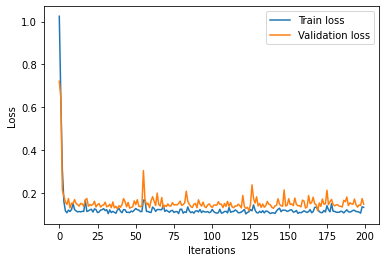

The loss on validation set is: 0.14696519076824188


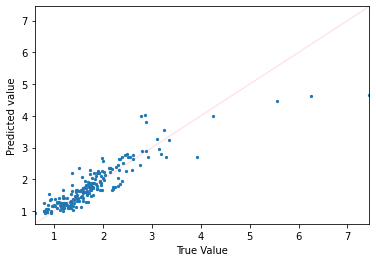

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


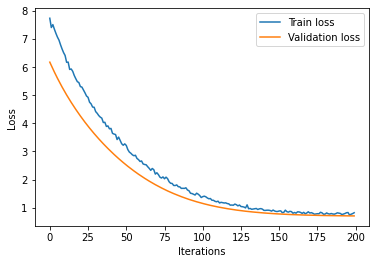

The loss on validation set is: 0.7131369709968567


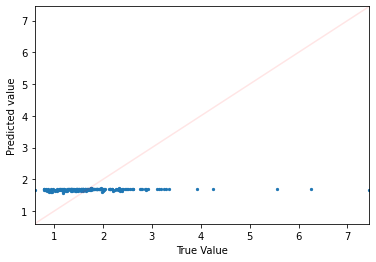

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


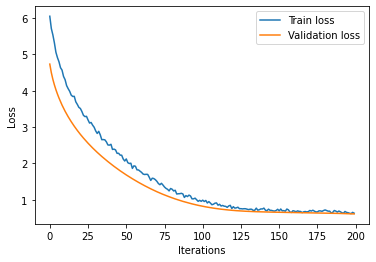

The loss on validation set is: 0.6120316982269287


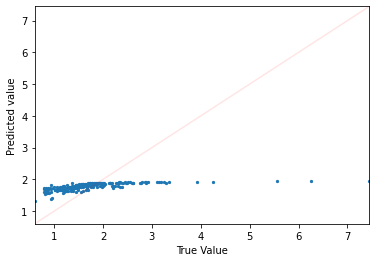

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


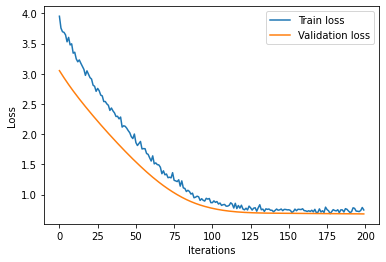

The loss on validation set is: 0.6812480092048645


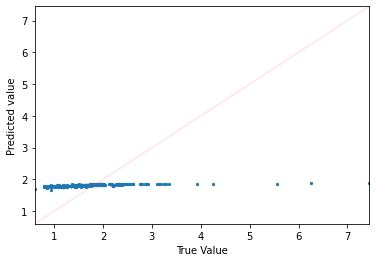

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


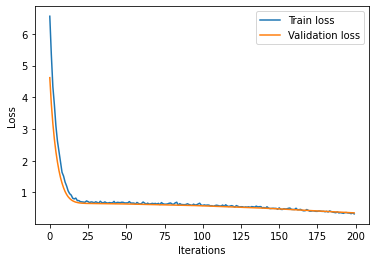

The loss on validation set is: 0.35391250252723694


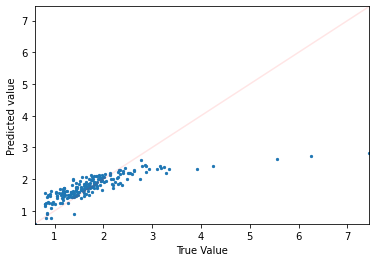

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


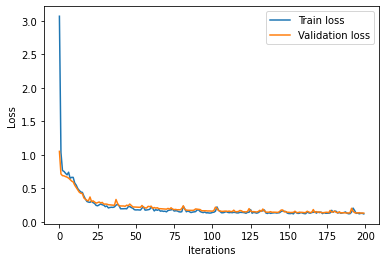

The loss on validation set is: 0.128003790974617


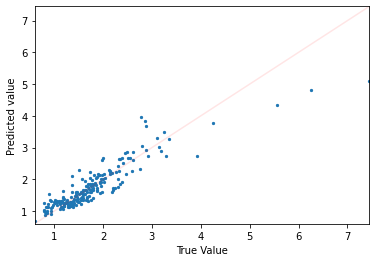

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


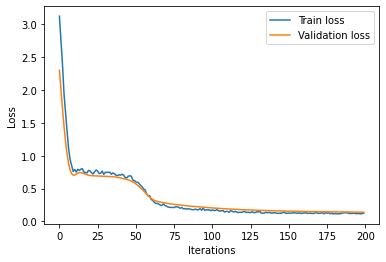

The loss on validation set is: 0.13958510756492615


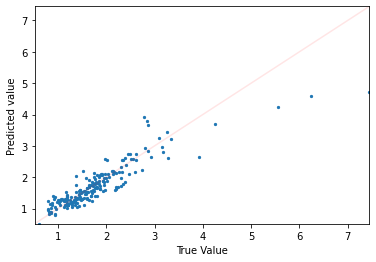

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


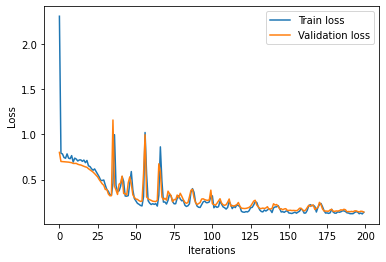

The loss on validation set is: 0.141981303691864


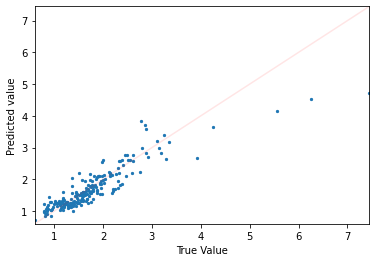

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


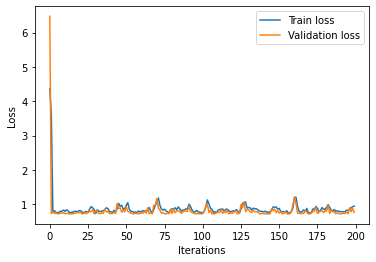

The loss on validation set is: 0.7624631524085999


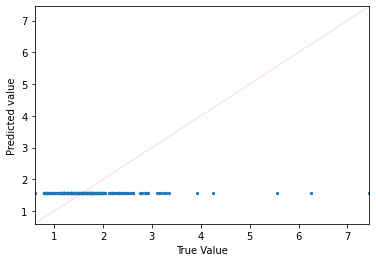

TRAINING WITH [2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


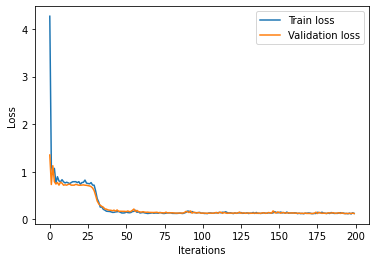

The loss on validation set is: 0.12174651026725769


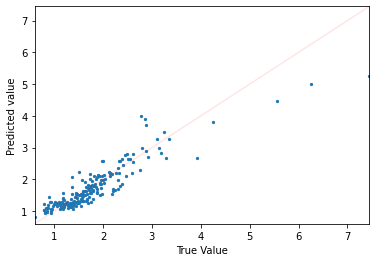

 31%|███       | 4/13 [18:24<42:47, 285.27s/it]

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


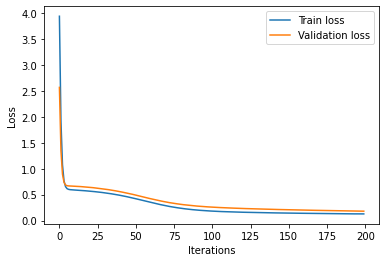

The loss on validation set is: 0.1811465620994568


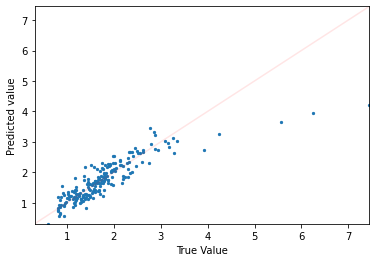

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


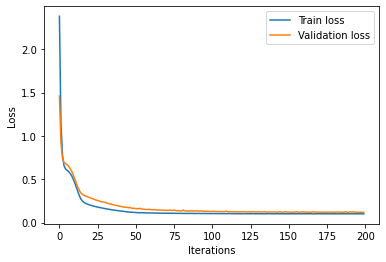

The loss on validation set is: 0.11783721297979355


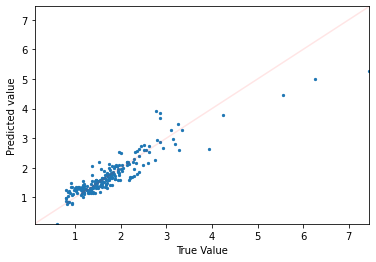

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


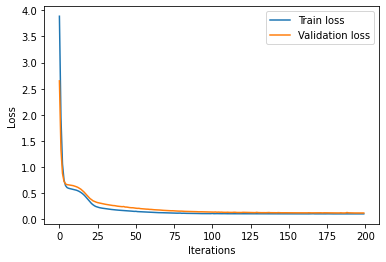

The loss on validation set is: 0.12031520158052444


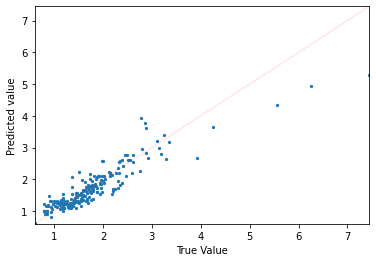

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


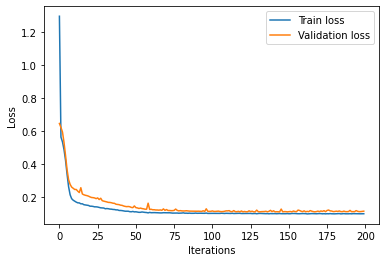

The loss on validation set is: 0.116012342274189


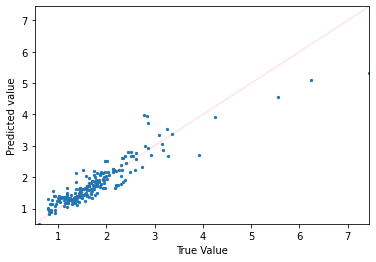

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


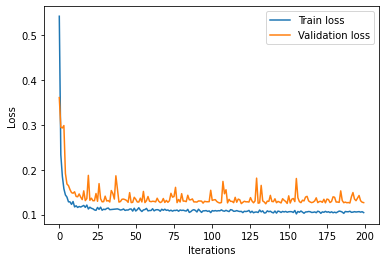

The loss on validation set is: 0.12667419016361237


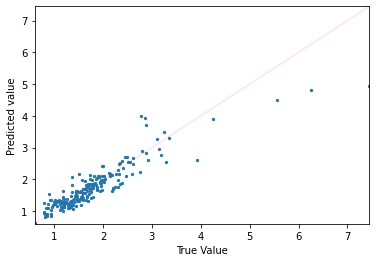

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


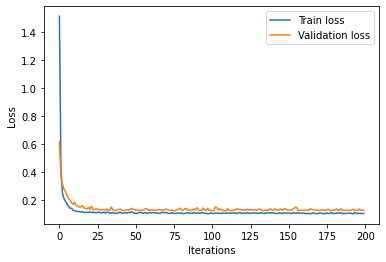

The loss on validation set is: 0.1258523017168045


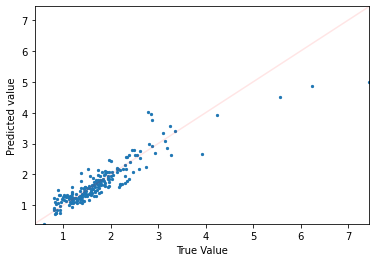

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


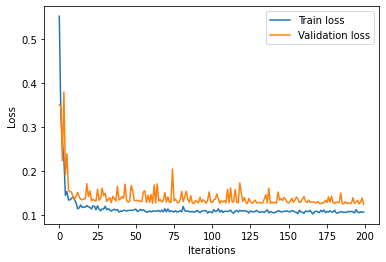

The loss on validation set is: 0.125071182847023


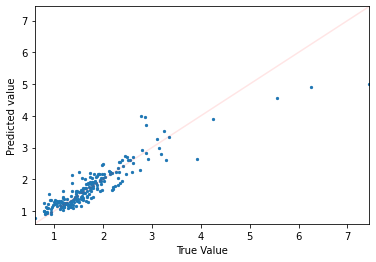

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


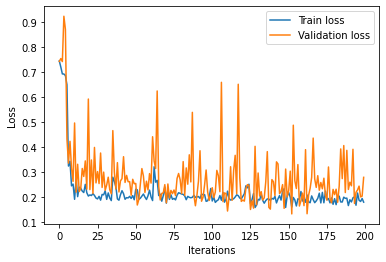

The loss on validation set is: 0.2789405882358551


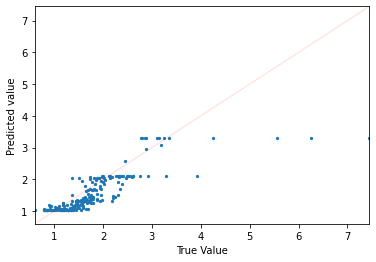

TRAINING WITH [4, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


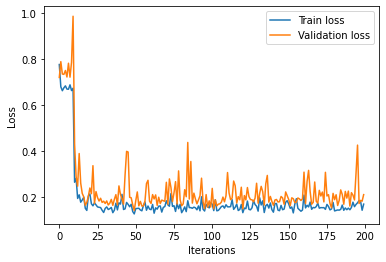

The loss on validation set is: 0.2093508541584015


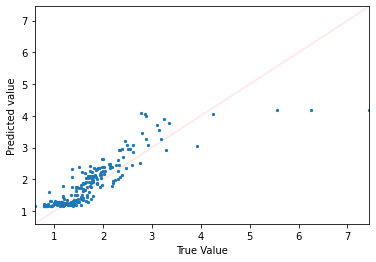

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


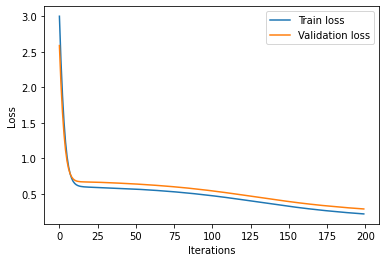

The loss on validation set is: 0.28552910685539246


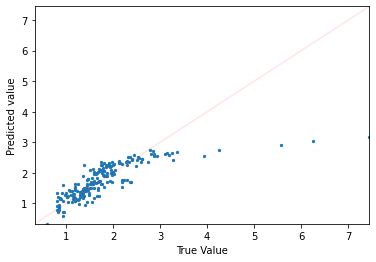

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


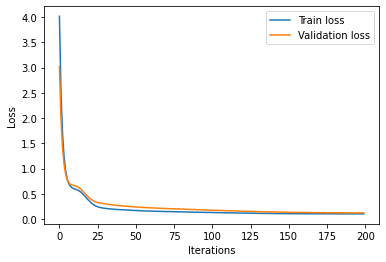

The loss on validation set is: 0.12306725233793259


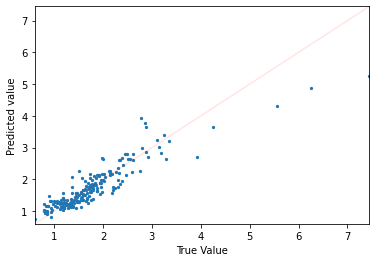

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


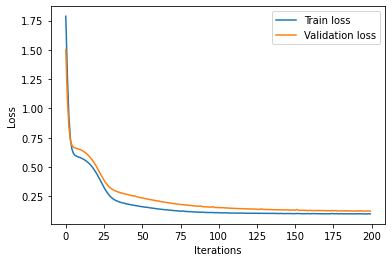

The loss on validation set is: 0.1232297345995903


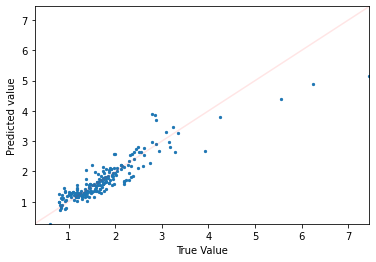

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


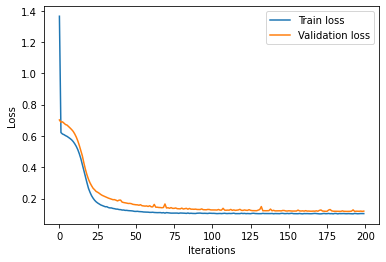

The loss on validation set is: 0.1194768026471138


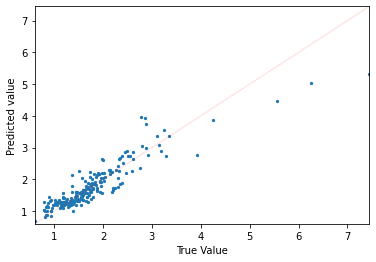

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


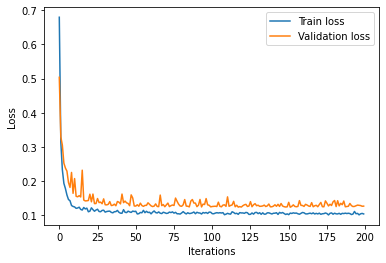

The loss on validation set is: 0.12609510123729706


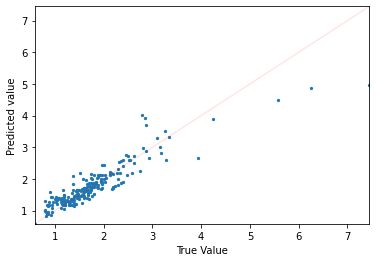

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


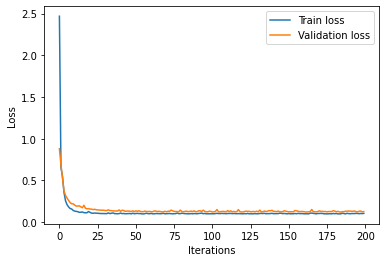

The loss on validation set is: 0.12739714980125427


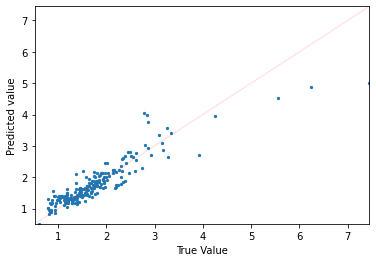

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


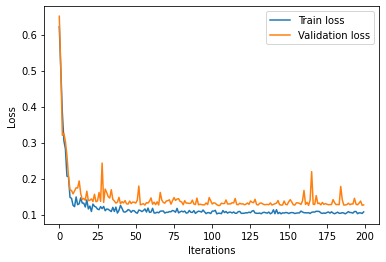

The loss on validation set is: 0.12691521644592285


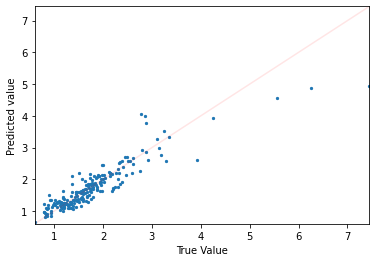

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


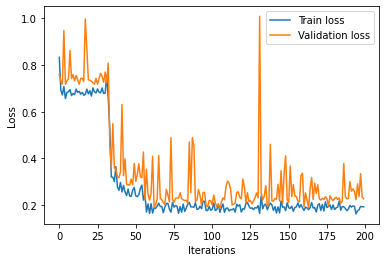

The loss on validation set is: 0.2271822690963745


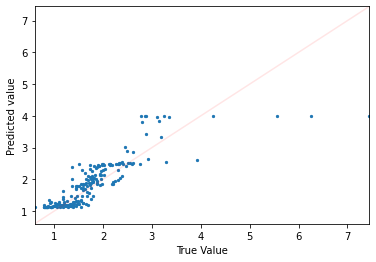

TRAINING WITH [4, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


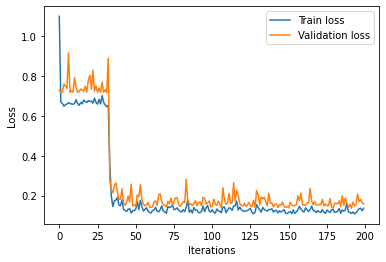

The loss on validation set is: 0.15844343602657318


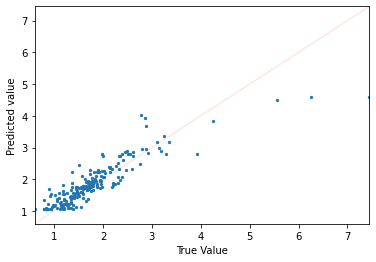

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


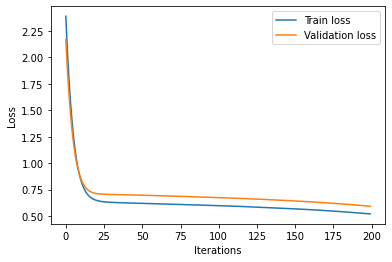

The loss on validation set is: 0.5922238230705261


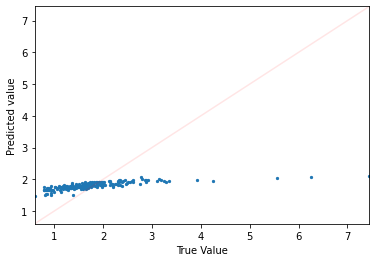

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


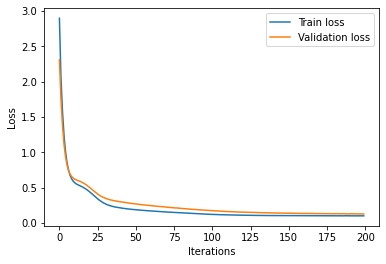

The loss on validation set is: 0.13056360185146332


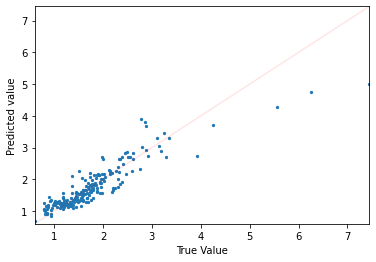

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


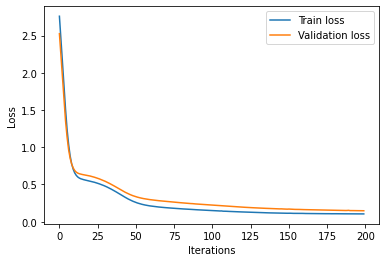

The loss on validation set is: 0.14740824699401855


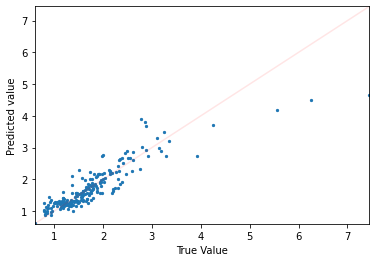

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


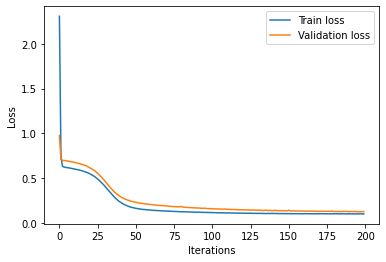

The loss on validation set is: 0.12910135090351105


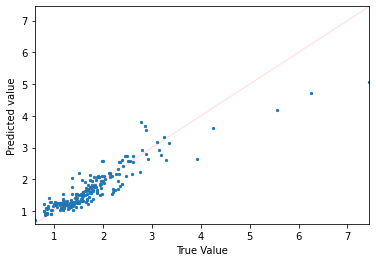

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


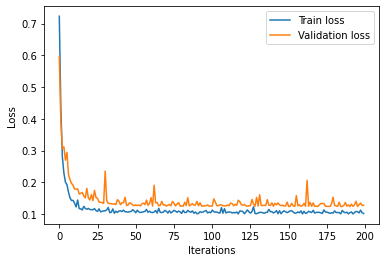

The loss on validation set is: 0.1274326890707016


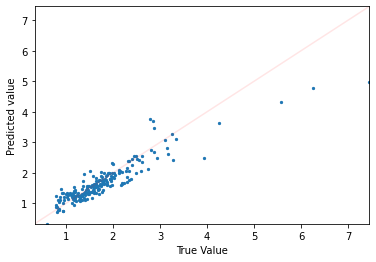

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


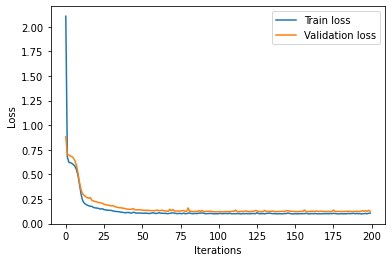

The loss on validation set is: 0.12461087852716446


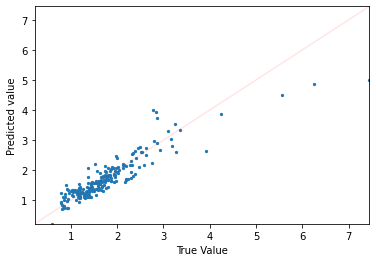

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


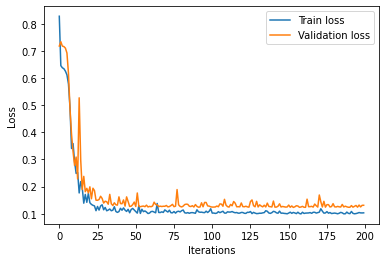

The loss on validation set is: 0.13138708472251892


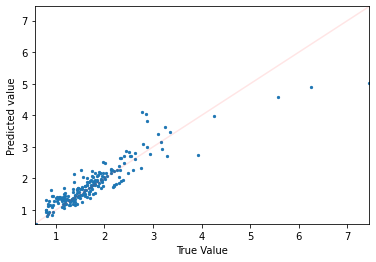

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


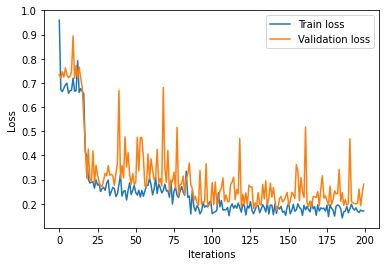

The loss on validation set is: 0.28156670928001404


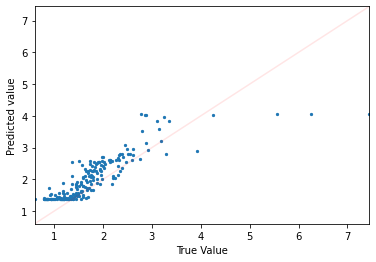

TRAINING WITH [4, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


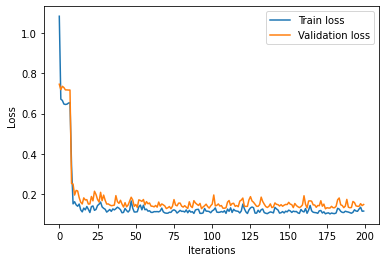

The loss on validation set is: 0.14825284481048584


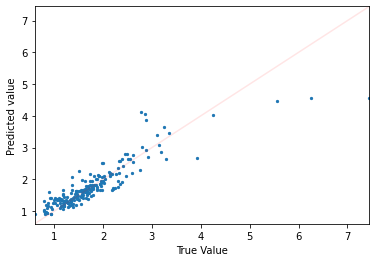

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


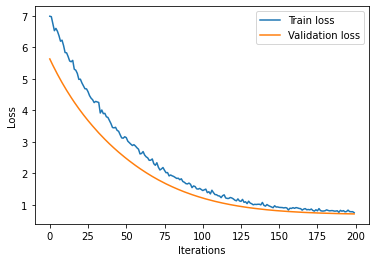

The loss on validation set is: 0.715914249420166


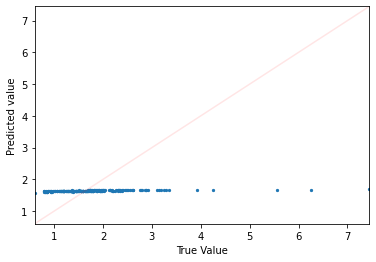

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


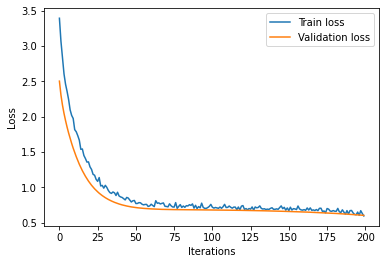

The loss on validation set is: 0.6034201979637146


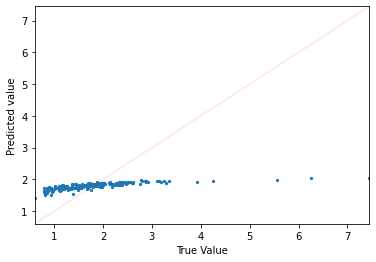

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


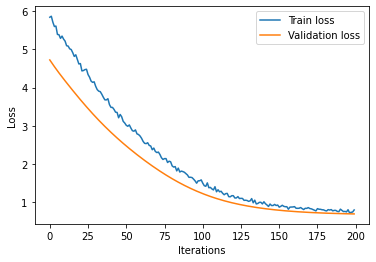

The loss on validation set is: 0.6866543292999268


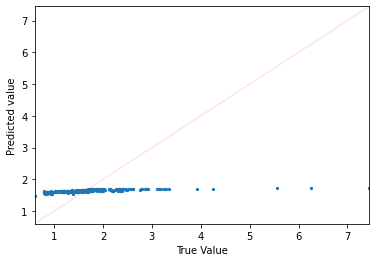

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


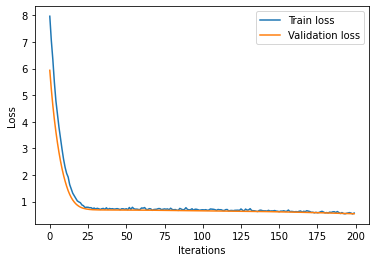

The loss on validation set is: 0.5432400703430176


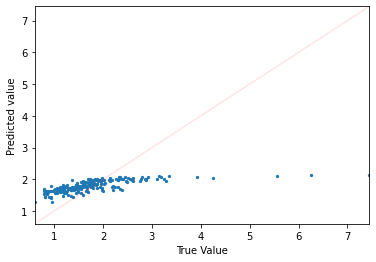

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


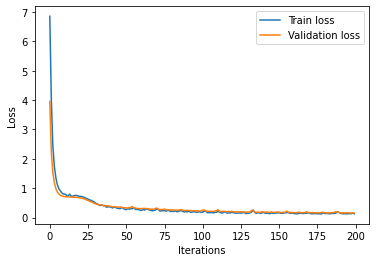

The loss on validation set is: 0.16088145971298218


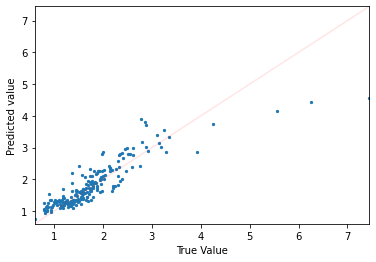

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


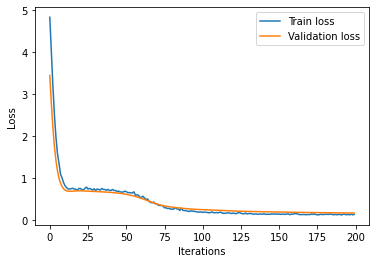

The loss on validation set is: 0.16921228170394897


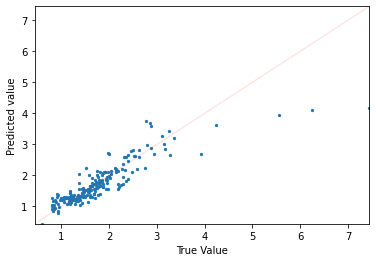

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


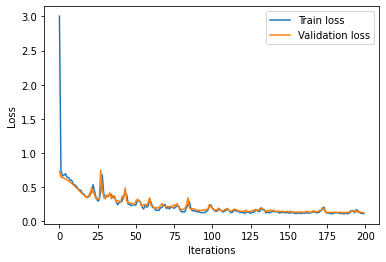

The loss on validation set is: 0.13064350187778473


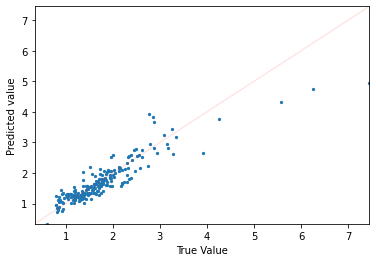

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


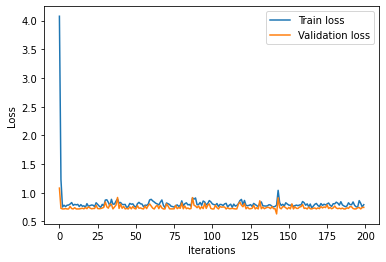

The loss on validation set is: 0.7452051043510437


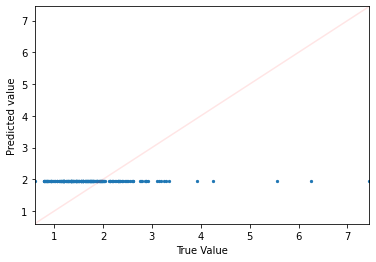

TRAINING WITH [4, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


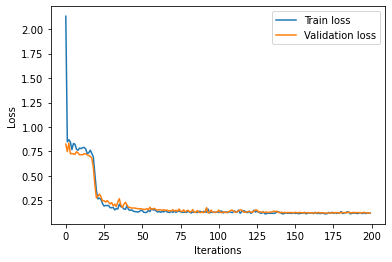

The loss on validation set is: 0.12012733519077301


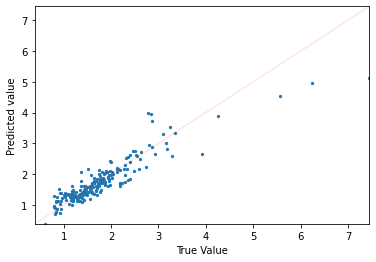

 38%|███▊      | 5/13 [23:30<39:01, 292.68s/it]

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


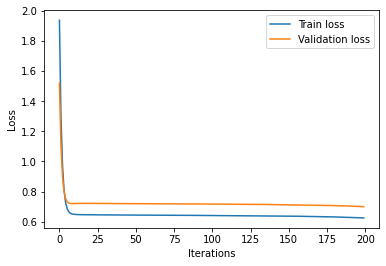

The loss on validation set is: 0.6996925473213196


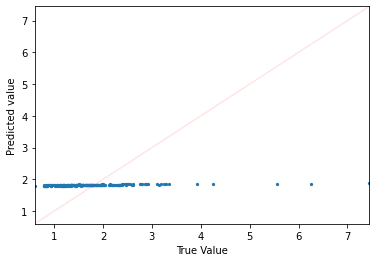

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


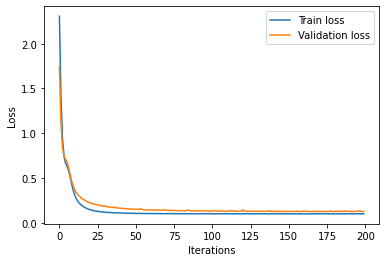

The loss on validation set is: 0.12535430490970612


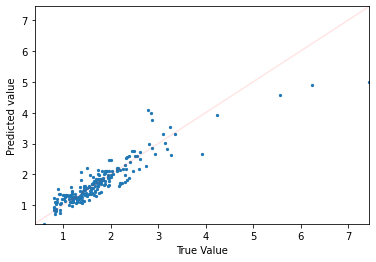

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


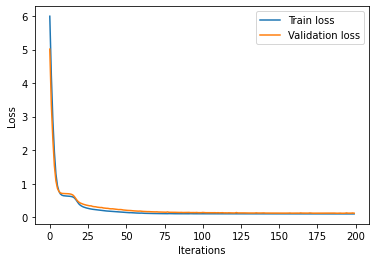

The loss on validation set is: 0.1201619878411293


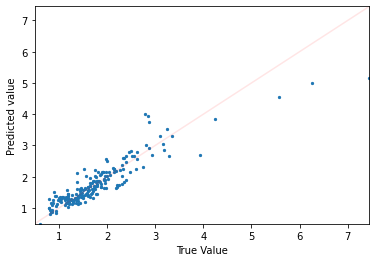

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


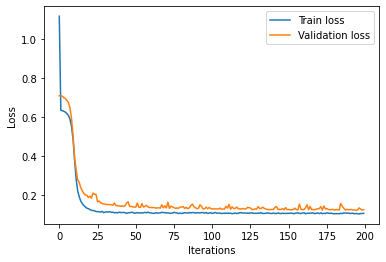

The loss on validation set is: 0.1264466494321823


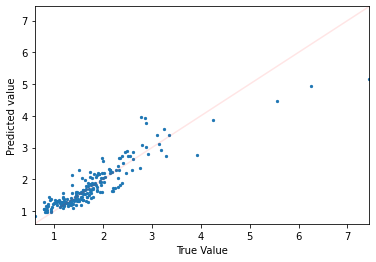

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


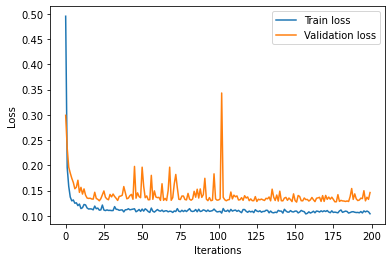

The loss on validation set is: 0.1461130678653717


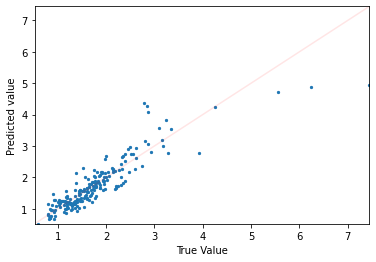

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


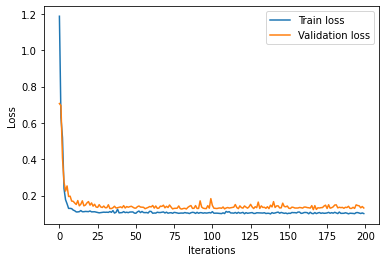

The loss on validation set is: 0.13195830583572388


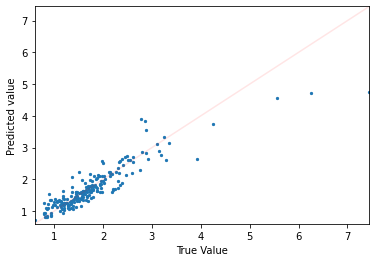

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


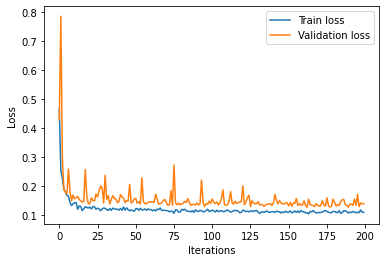

The loss on validation set is: 0.1377757340669632


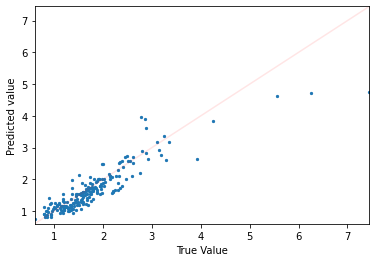

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


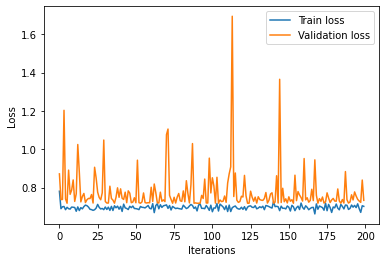

The loss on validation set is: 0.73297119140625


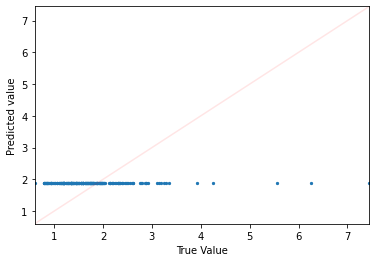

TRAINING WITH [4, 2, 2, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


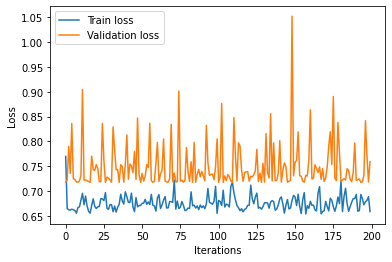

The loss on validation set is: 0.7595350742340088


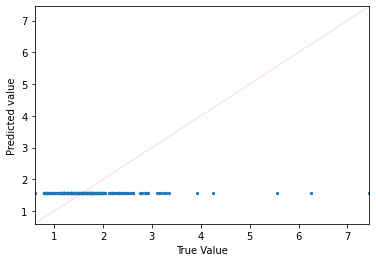

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


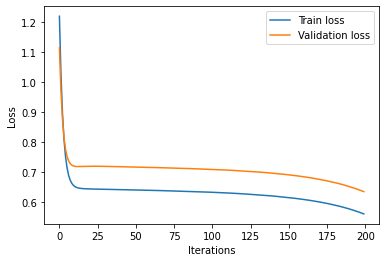

The loss on validation set is: 0.6347916126251221


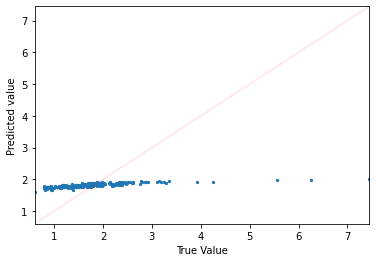

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


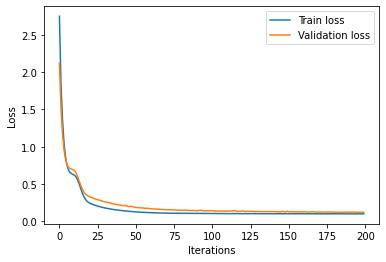

The loss on validation set is: 0.12202295660972595


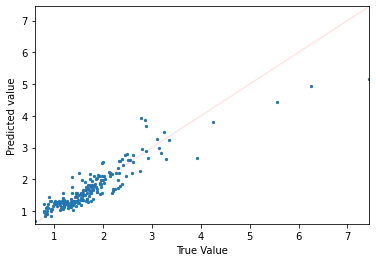

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


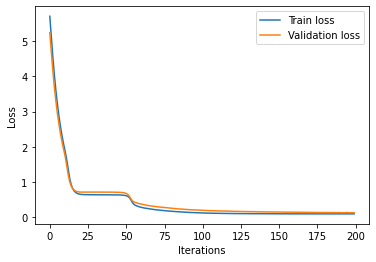

The loss on validation set is: 0.1328909546136856


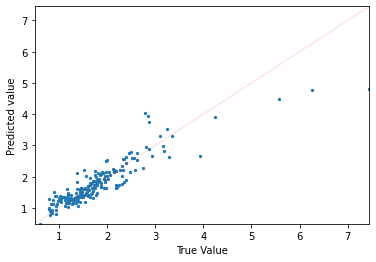

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


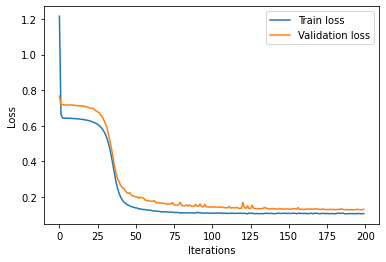

The loss on validation set is: 0.130334734916687


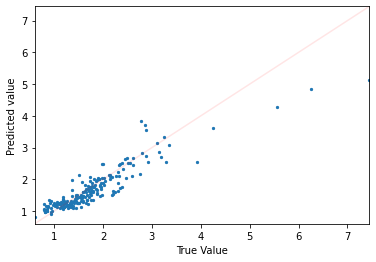

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


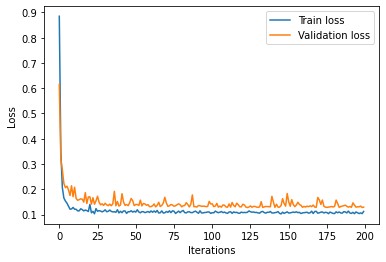

The loss on validation set is: 0.12922261655330658


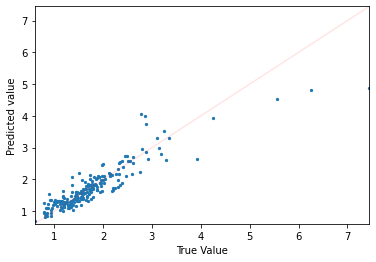

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


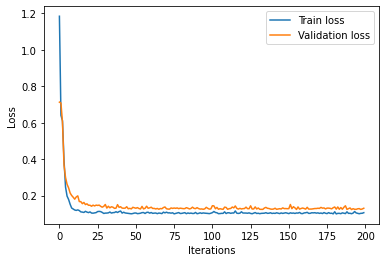

The loss on validation set is: 0.13027898967266083


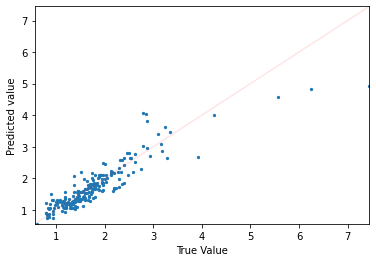

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


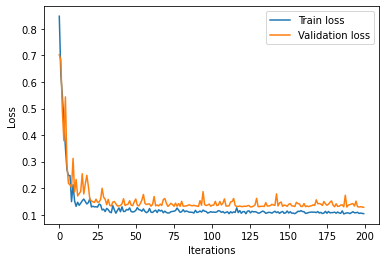

The loss on validation set is: 0.12804695963859558


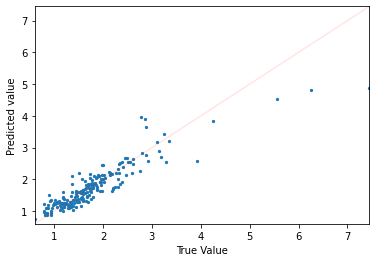

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


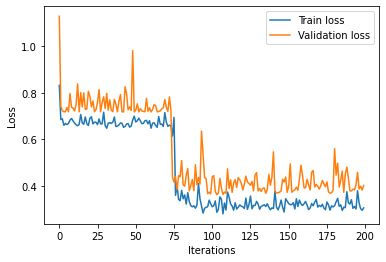

The loss on validation set is: 0.4012812376022339


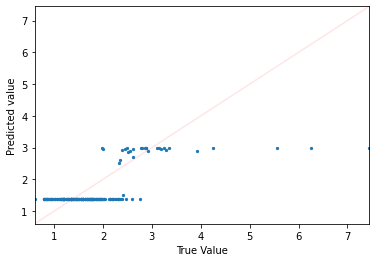

TRAINING WITH [4, 2, 2, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


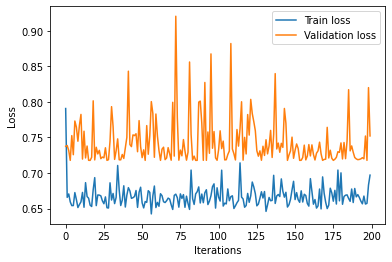

The loss on validation set is: 0.752193808555603


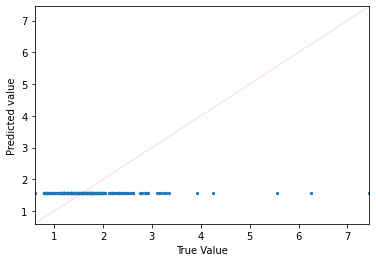

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


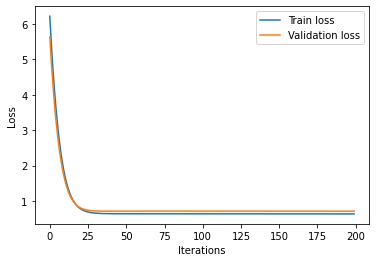

The loss on validation set is: 0.7114423513412476


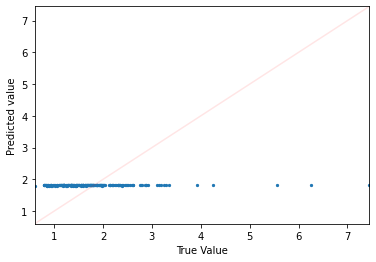

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


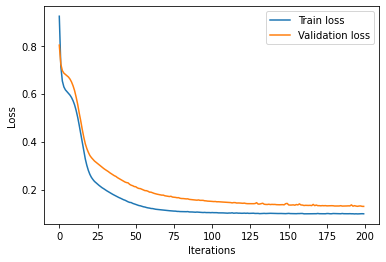

The loss on validation set is: 0.1295512169599533


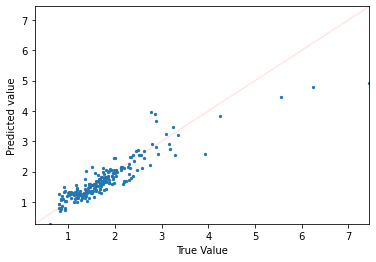

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


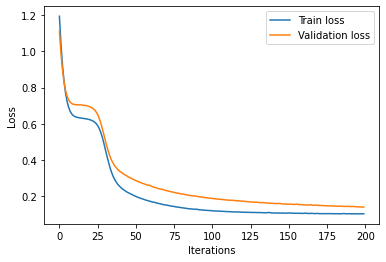

The loss on validation set is: 0.13911396265029907


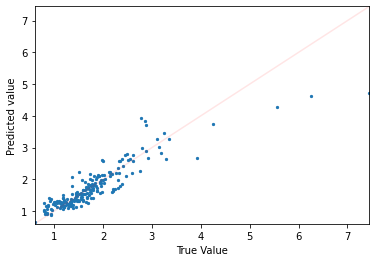

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


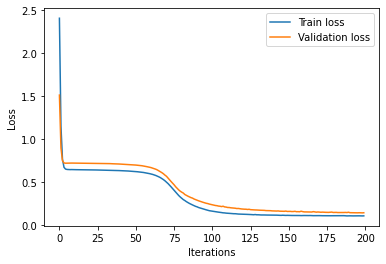

The loss on validation set is: 0.14119848608970642


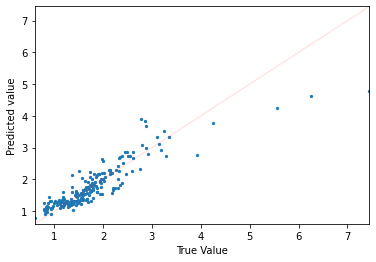

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


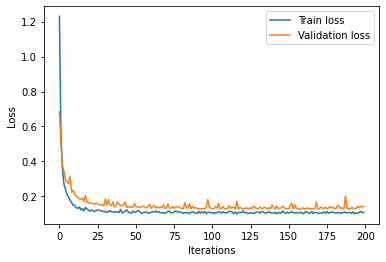

The loss on validation set is: 0.1422501504421234


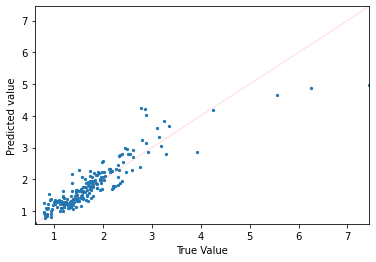

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


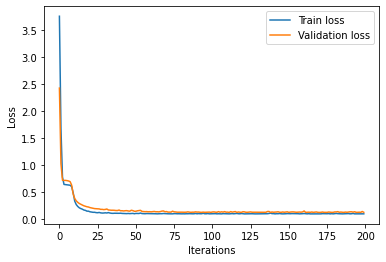

The loss on validation set is: 0.12727132439613342


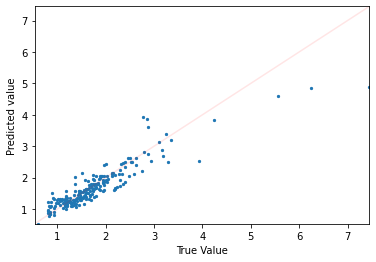

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


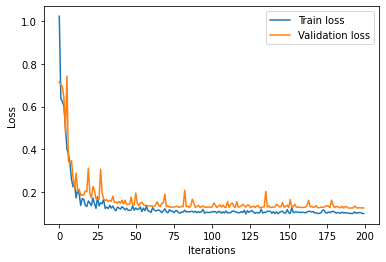

The loss on validation set is: 0.12769506871700287


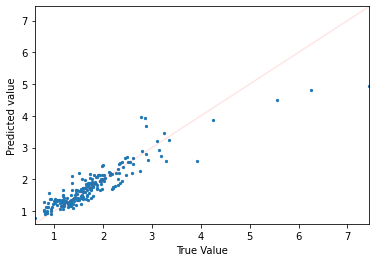

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


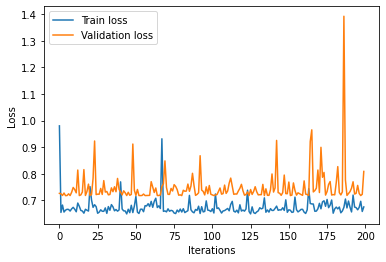

The loss on validation set is: 0.8086764812469482


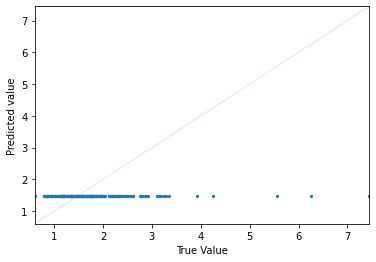

TRAINING WITH [4, 2, 2, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


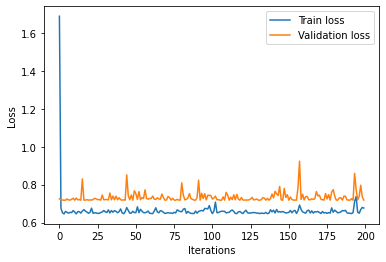

The loss on validation set is: 0.7184496521949768


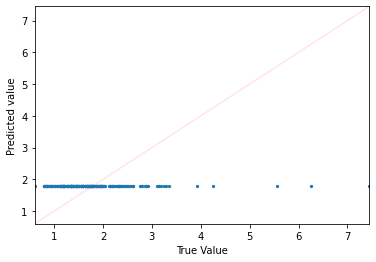

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


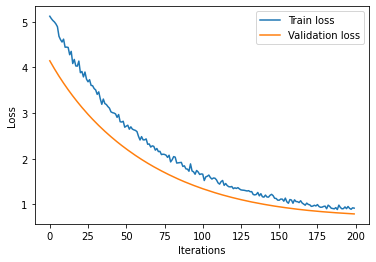

The loss on validation set is: 0.7903854250907898


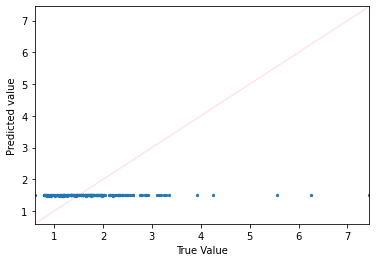

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


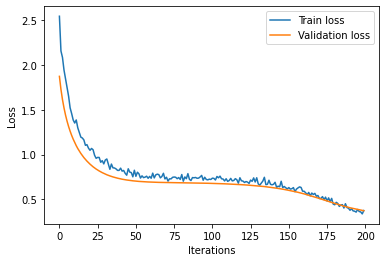

The loss on validation set is: 0.37466034293174744


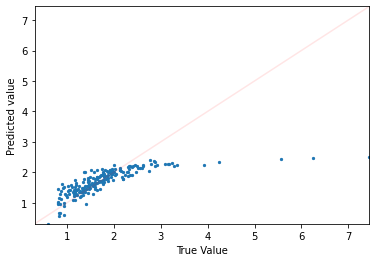

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


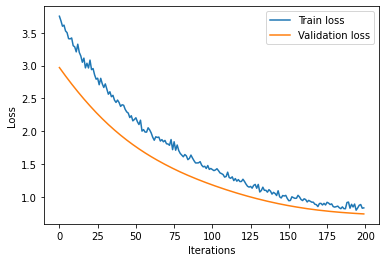

The loss on validation set is: 0.7419635057449341


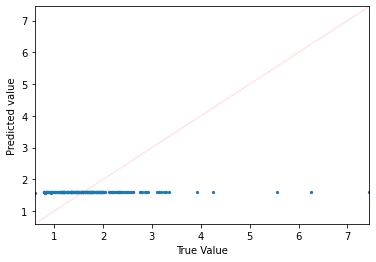

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


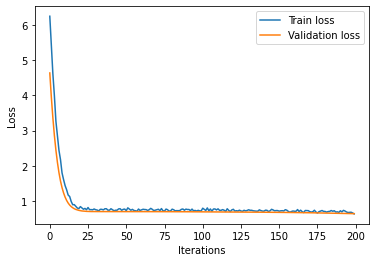

The loss on validation set is: 0.6448289752006531


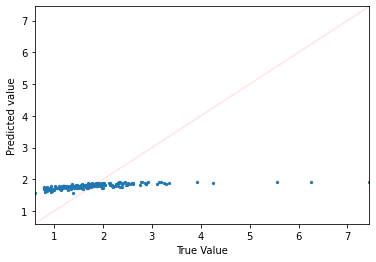

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


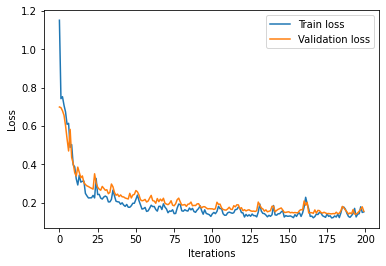

The loss on validation set is: 0.15577903389930725


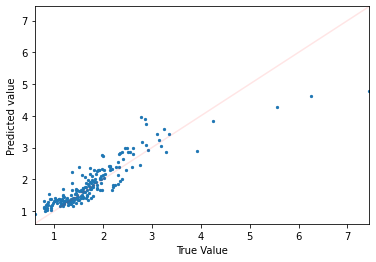

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


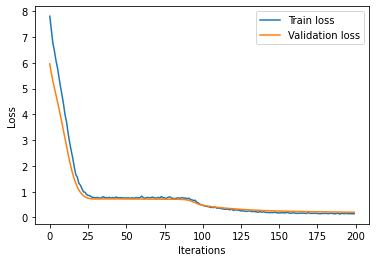

The loss on validation set is: 0.2017262578010559


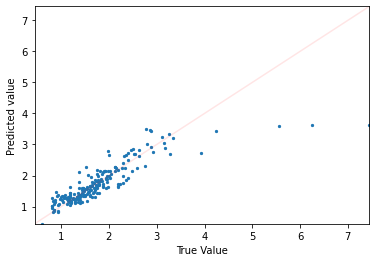

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


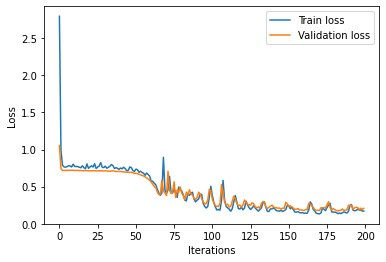

The loss on validation set is: 0.20809917151927948


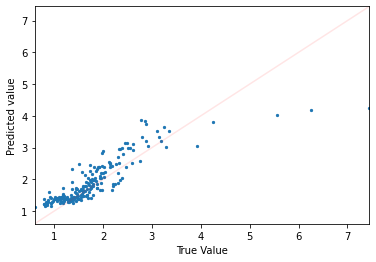

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


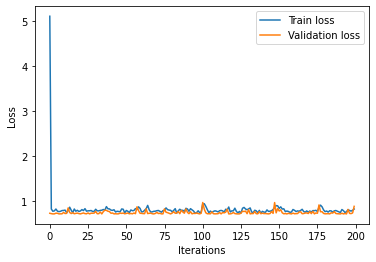

The loss on validation set is: 0.8857744336128235


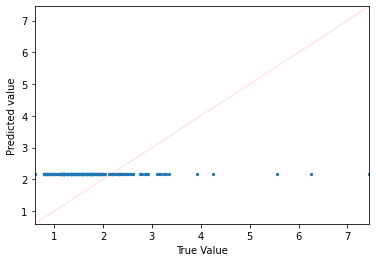

TRAINING WITH [4, 2, 2, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


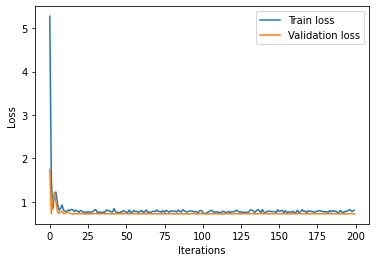

The loss on validation set is: 0.7195488810539246


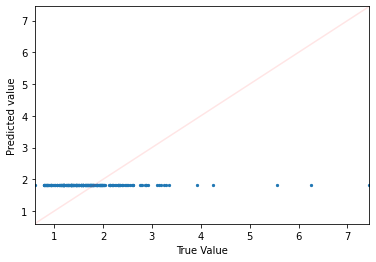

 46%|████▌     | 6/13 [29:24<36:35, 313.57s/it]

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


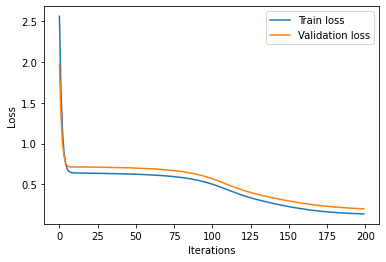

The loss on validation set is: 0.19971370697021484


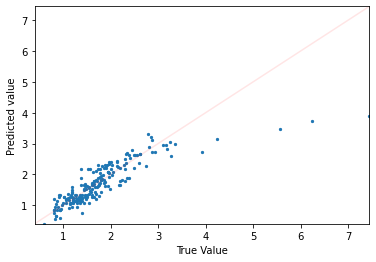

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


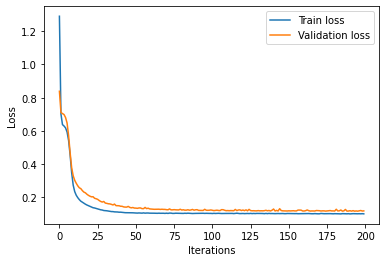

The loss on validation set is: 0.11811429262161255


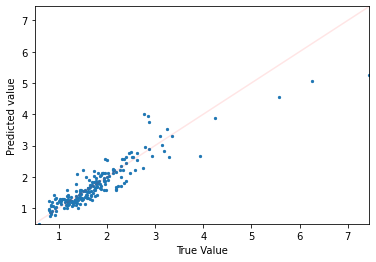

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


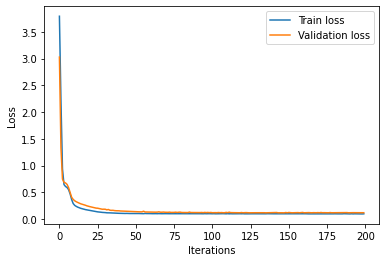

The loss on validation set is: 0.12038642168045044


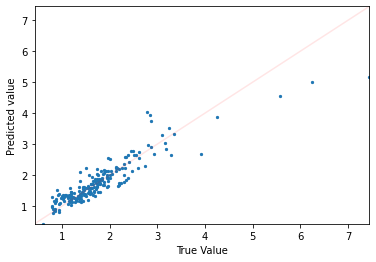

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


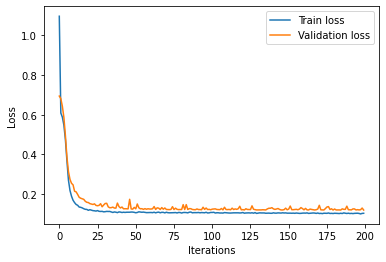

The loss on validation set is: 0.11960364133119583


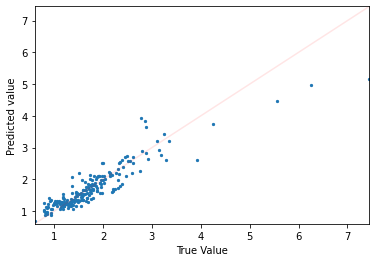

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


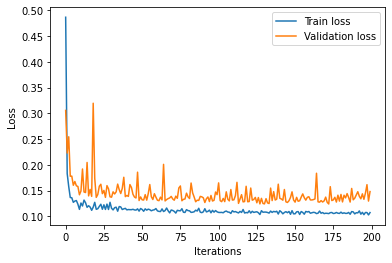

The loss on validation set is: 0.14818161725997925


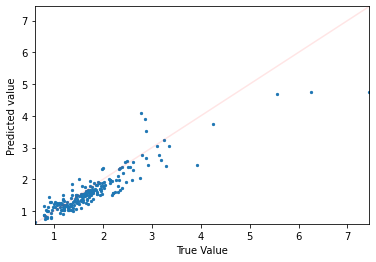

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


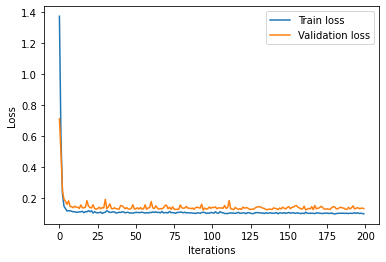

The loss on validation set is: 0.13237105309963226


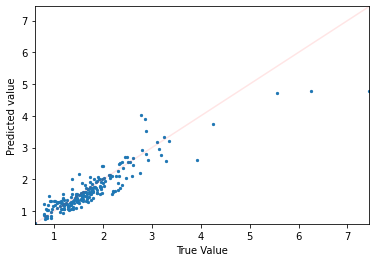

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


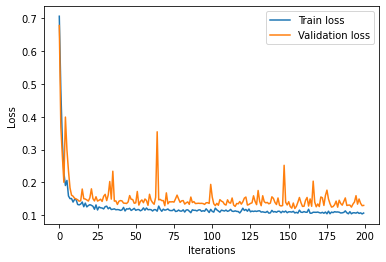

The loss on validation set is: 0.1302289515733719


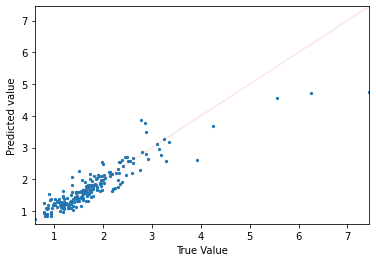

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


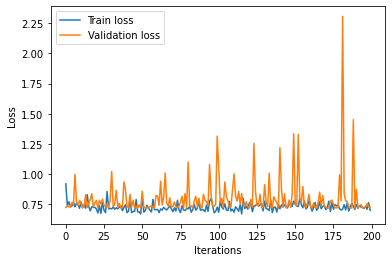

The loss on validation set is: 0.7287957072257996


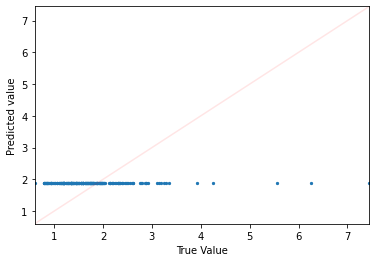

TRAINING WITH [4, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


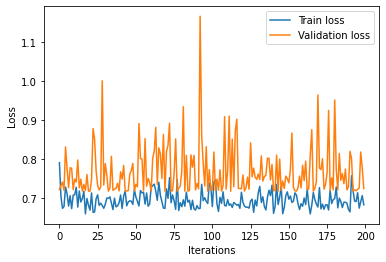

The loss on validation set is: 0.7245938777923584


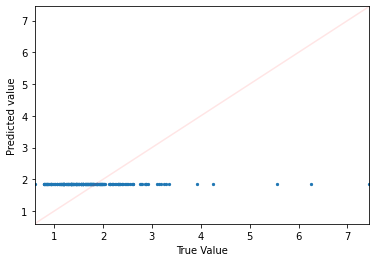

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


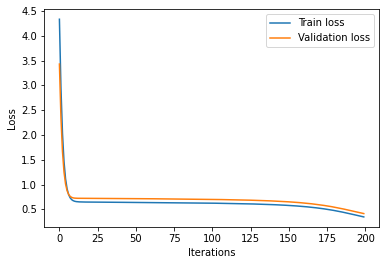

The loss on validation set is: 0.4134513735771179


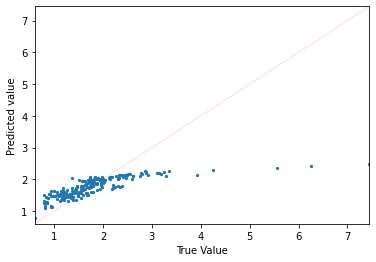

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


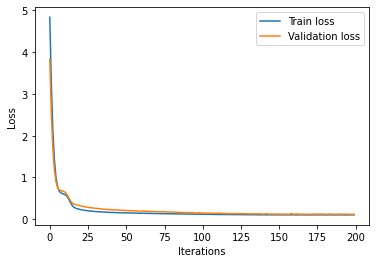

The loss on validation set is: 0.11631256341934204


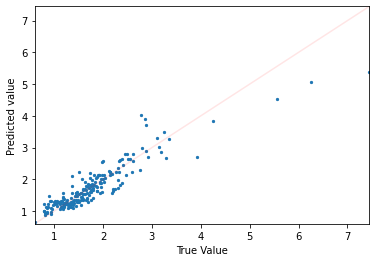

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


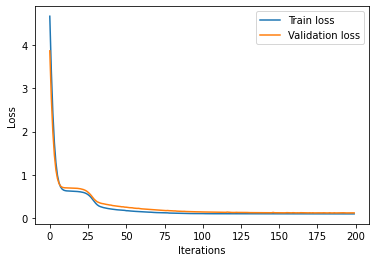

The loss on validation set is: 0.12346632033586502


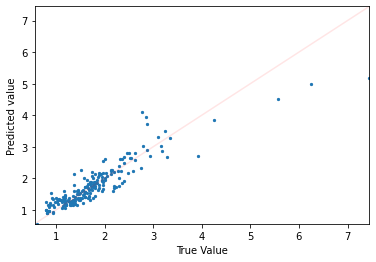

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


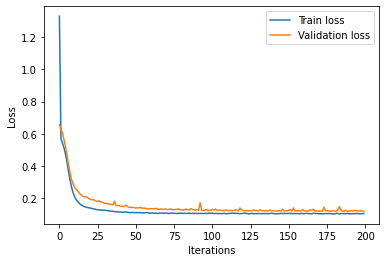

The loss on validation set is: 0.11798974126577377


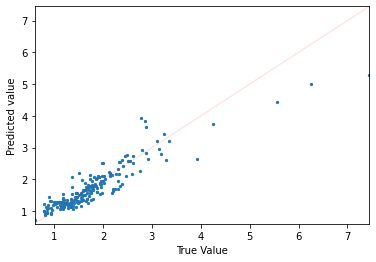

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


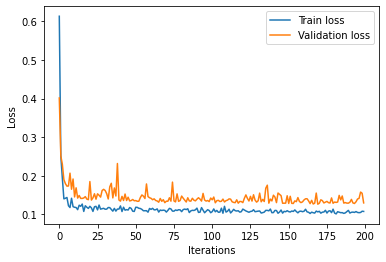

The loss on validation set is: 0.1298268735408783


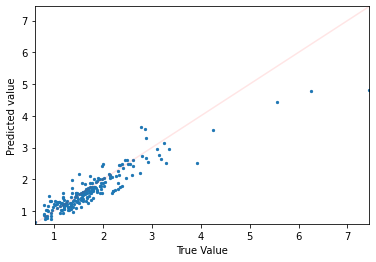

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


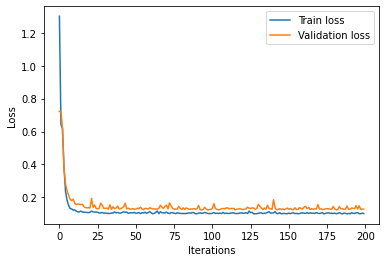

The loss on validation set is: 0.12860804796218872


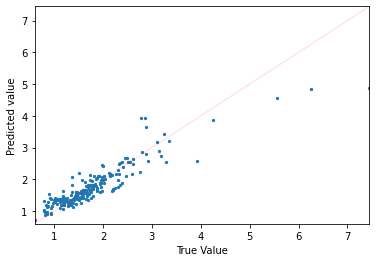

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


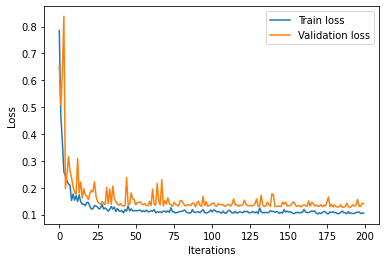

The loss on validation set is: 0.14078636467456818


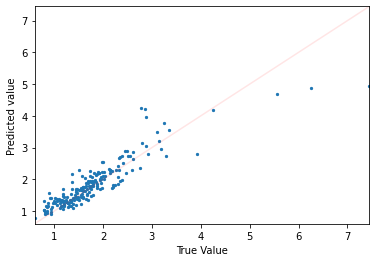

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


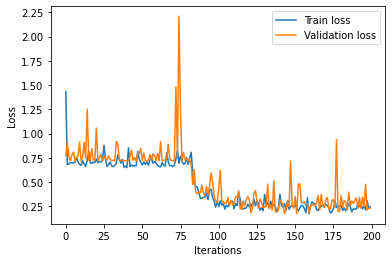

The loss on validation set is: 0.23116393387317657


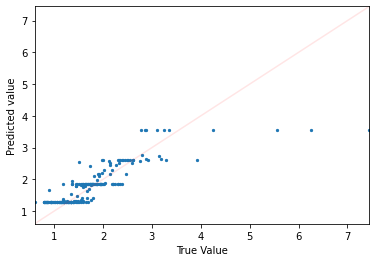

TRAINING WITH [4, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


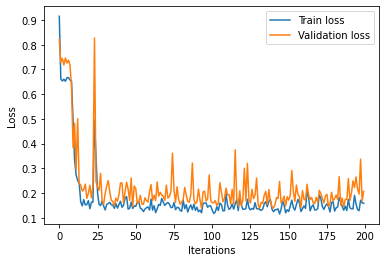

The loss on validation set is: 0.20697498321533203


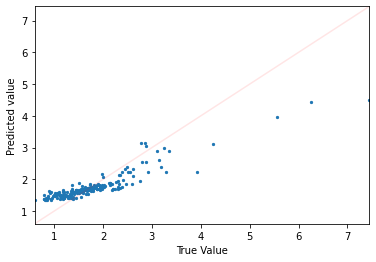

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


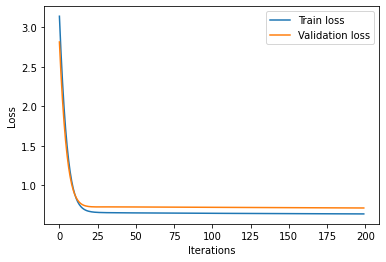

The loss on validation set is: 0.7104451060295105


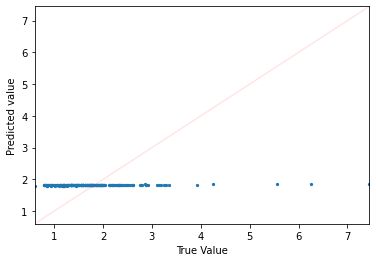

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


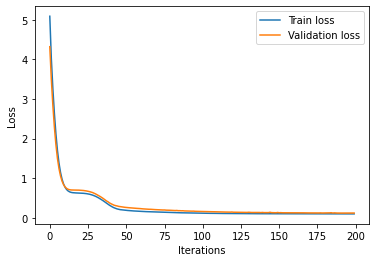

The loss on validation set is: 0.12256750464439392


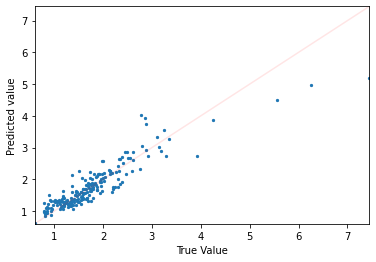

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


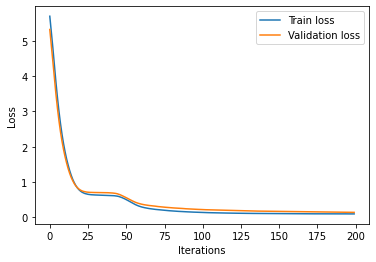

The loss on validation set is: 0.14395712316036224


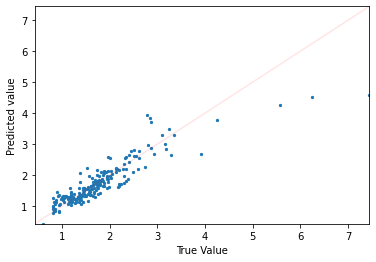

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


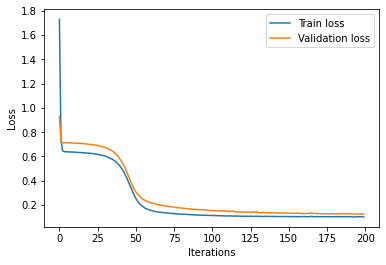

The loss on validation set is: 0.12554064393043518


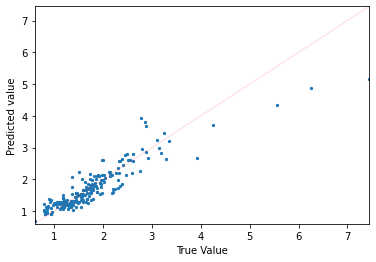

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


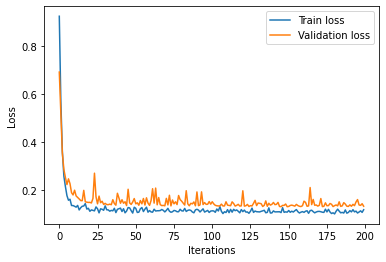

The loss on validation set is: 0.13122184574604034


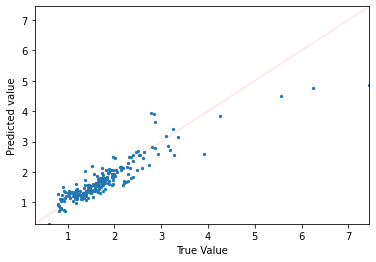

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


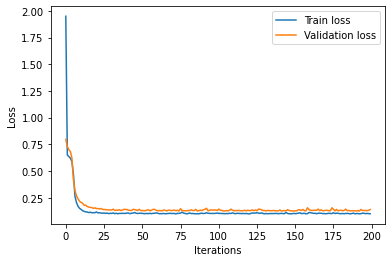

The loss on validation set is: 0.13957713544368744


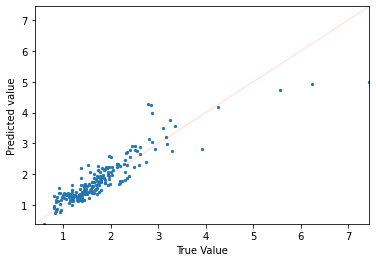

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


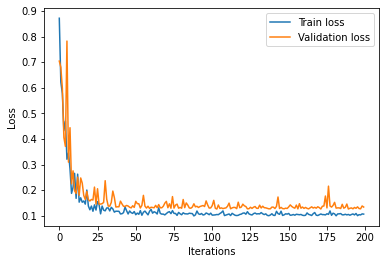

The loss on validation set is: 0.13445547223091125


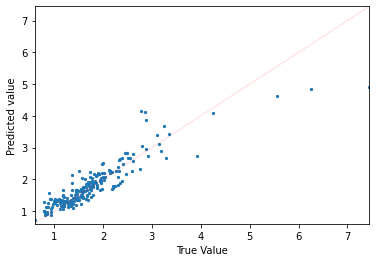

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


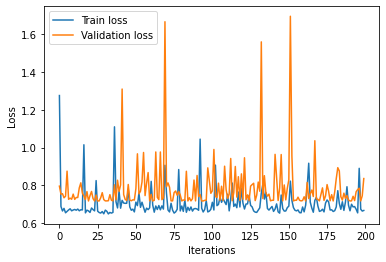

The loss on validation set is: 0.8361875414848328


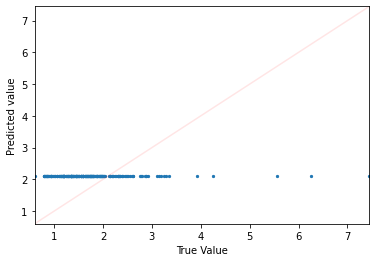

TRAINING WITH [4, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


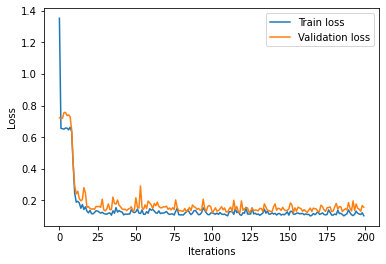

The loss on validation set is: 0.15735779702663422


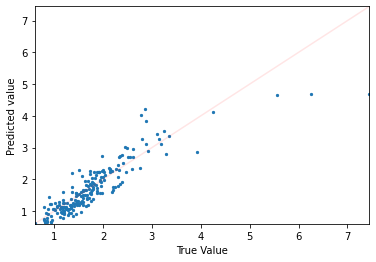

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


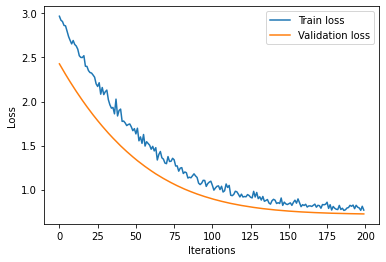

The loss on validation set is: 0.7244107127189636


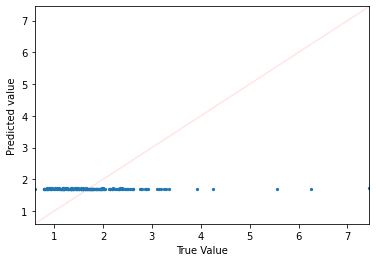

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


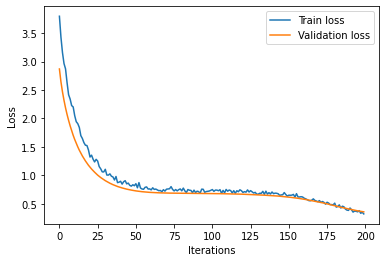

The loss on validation set is: 0.3604796528816223


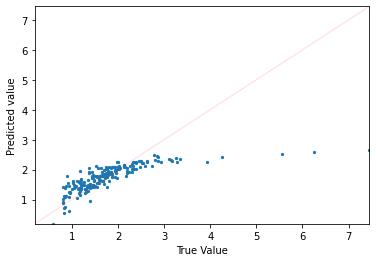

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


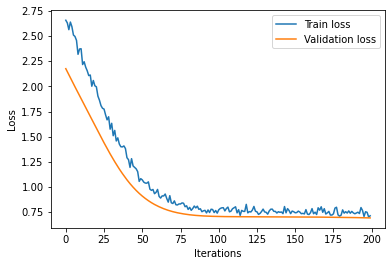

The loss on validation set is: 0.692314863204956


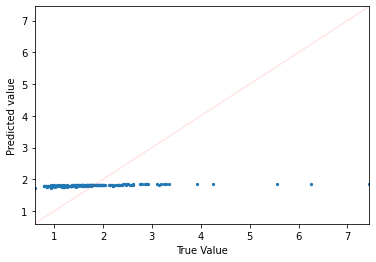

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


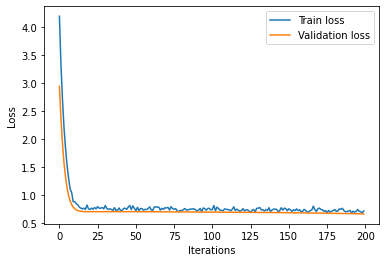

The loss on validation set is: 0.6680785417556763


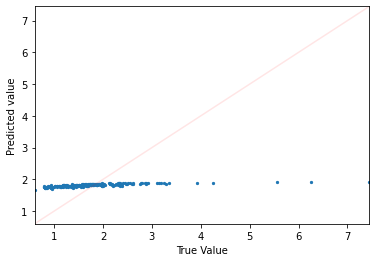

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


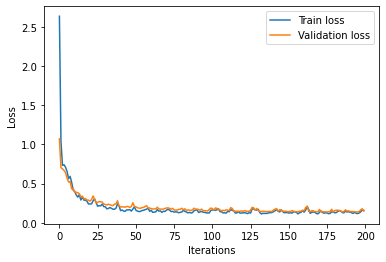

The loss on validation set is: 0.14740200340747833


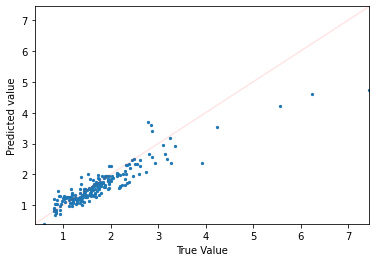

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


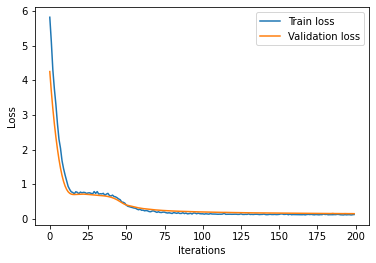

The loss on validation set is: 0.1481020301580429


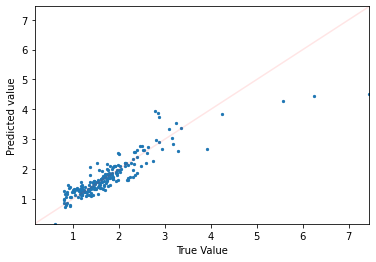

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


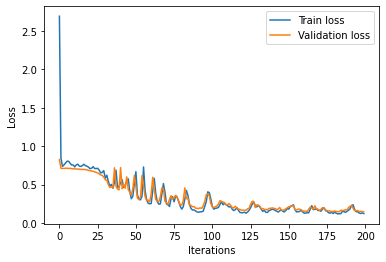

The loss on validation set is: 0.14421220123767853


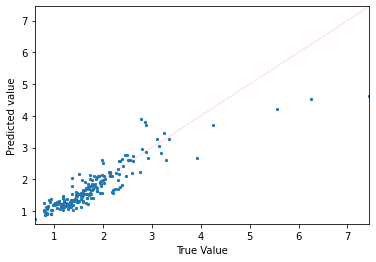

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


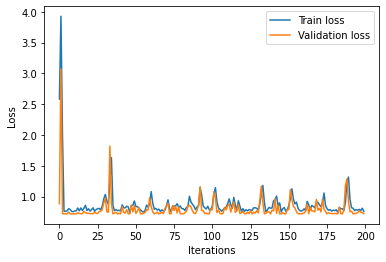

The loss on validation set is: 0.7239554524421692


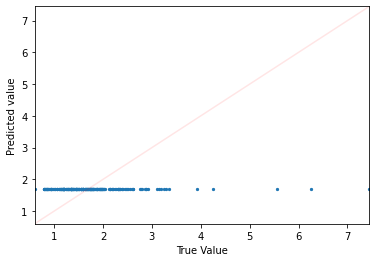

TRAINING WITH [4, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


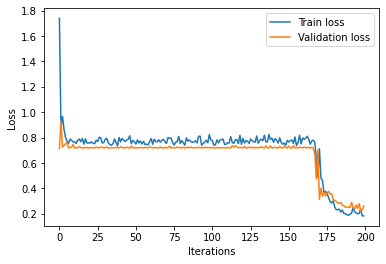

The loss on validation set is: 0.2609795033931732


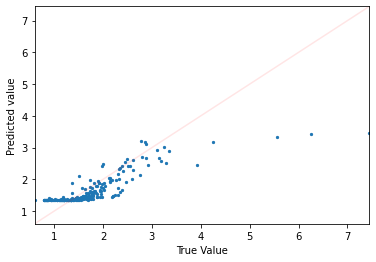

 54%|█████▍    | 7/13 [35:21<32:46, 327.77s/it]

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


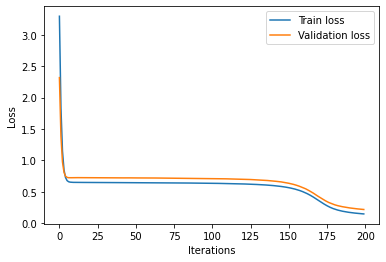

The loss on validation set is: 0.21591907739639282


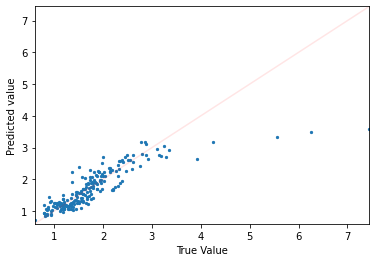

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


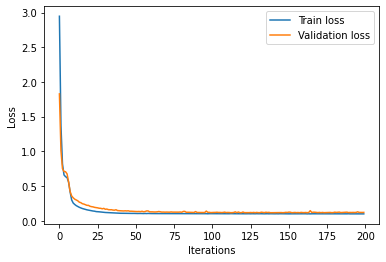

The loss on validation set is: 0.12097837775945663


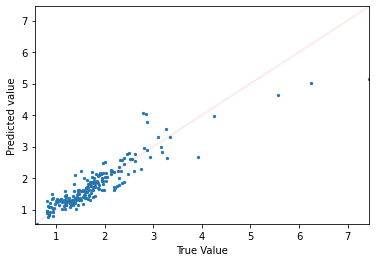

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


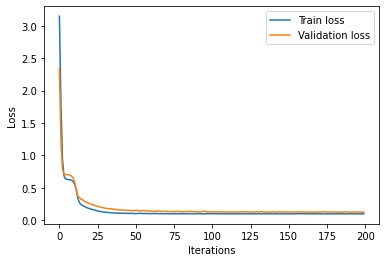

The loss on validation set is: 0.12611785531044006


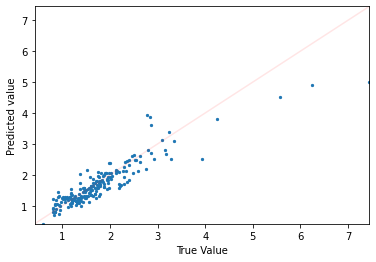

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


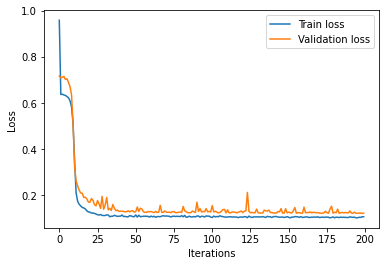

The loss on validation set is: 0.12333269417285919


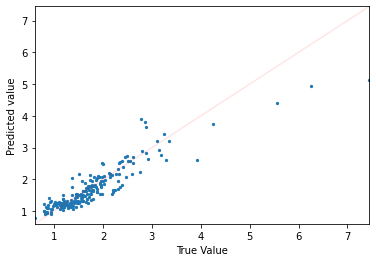

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


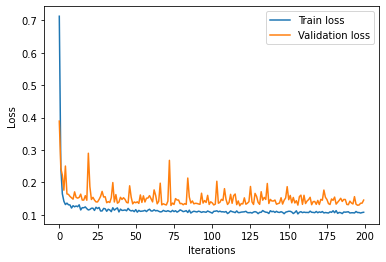

The loss on validation set is: 0.14527831971645355


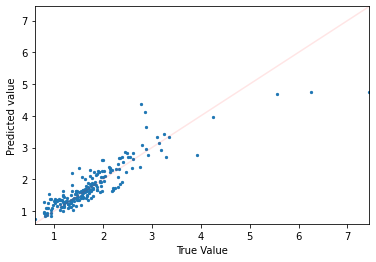

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


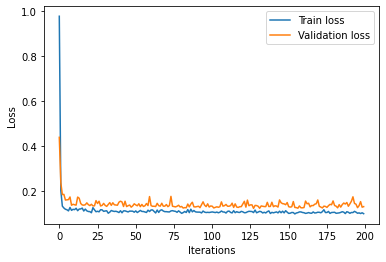

The loss on validation set is: 0.13167732954025269


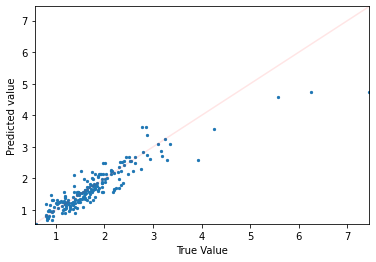

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


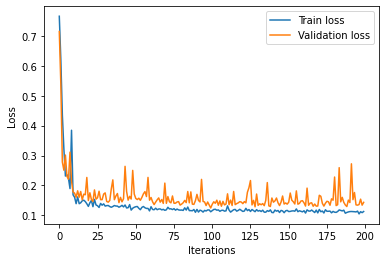

The loss on validation set is: 0.14325177669525146


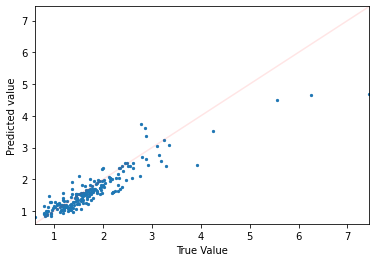

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


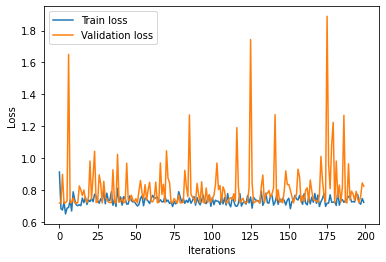

The loss on validation set is: 0.8235998749732971


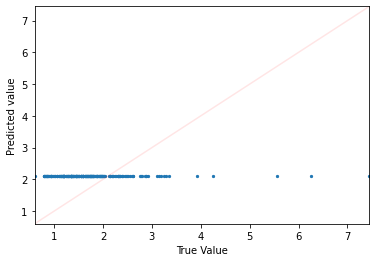

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


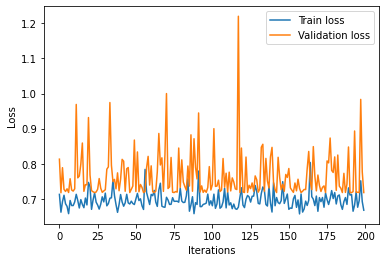

The loss on validation set is: 0.7178385853767395


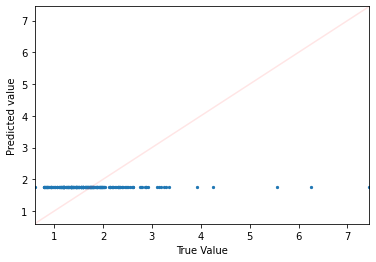

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


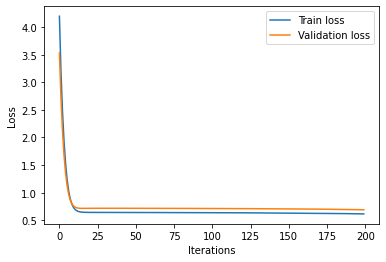

The loss on validation set is: 0.6897010207176208


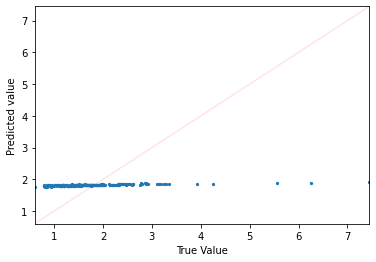

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


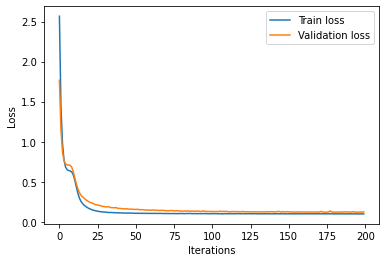

The loss on validation set is: 0.125056654214859


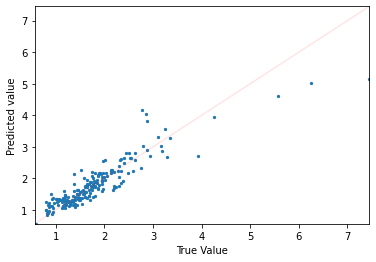

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


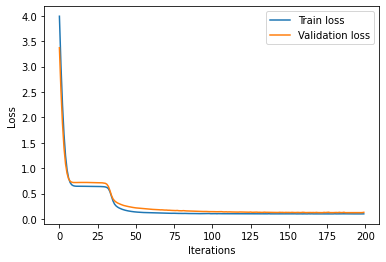

The loss on validation set is: 0.12953023612499237


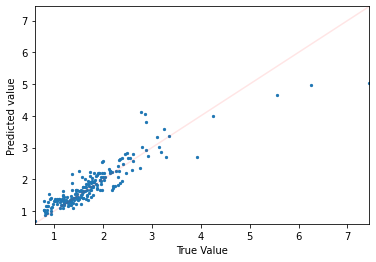

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


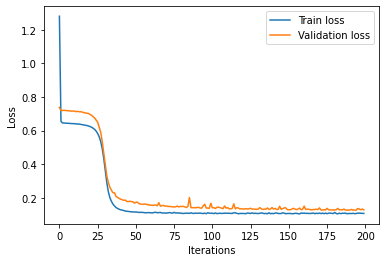

The loss on validation set is: 0.12878431379795074


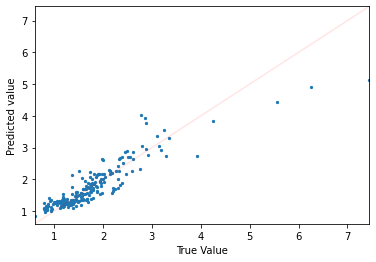

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


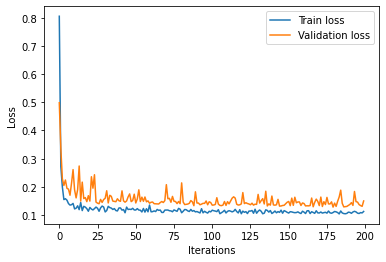

The loss on validation set is: 0.15011189877986908


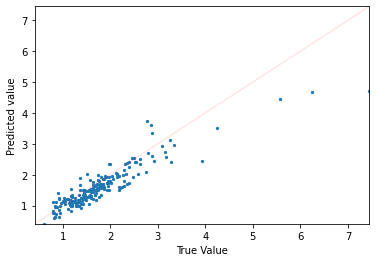

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


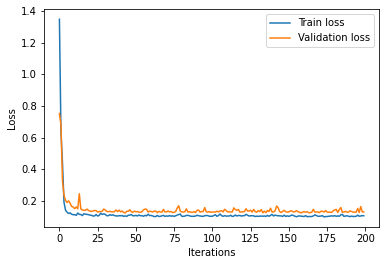

The loss on validation set is: 0.1304960399866104


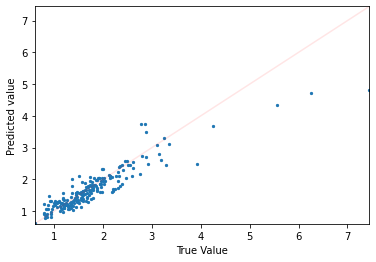

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


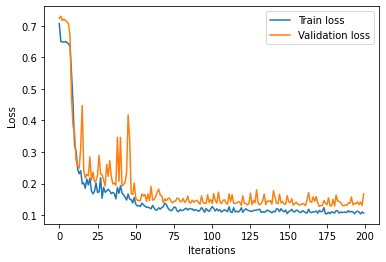

The loss on validation set is: 0.16776388883590698


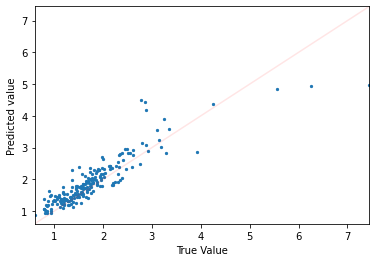

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


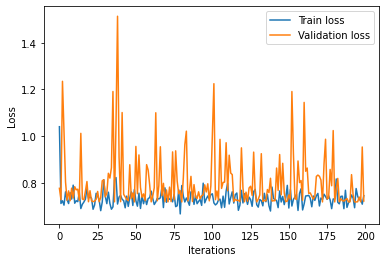

The loss on validation set is: 0.7216949462890625


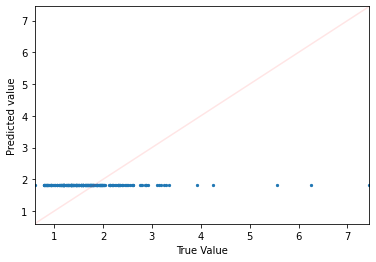

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


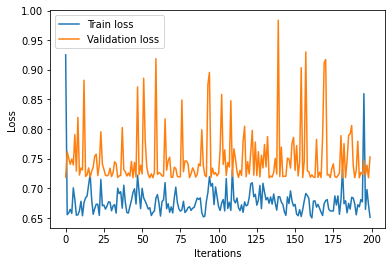

The loss on validation set is: 0.7528838515281677


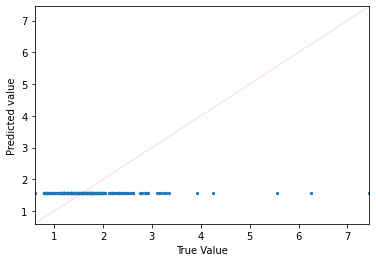

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


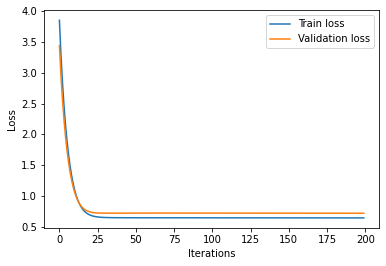

The loss on validation set is: 0.7199529409408569


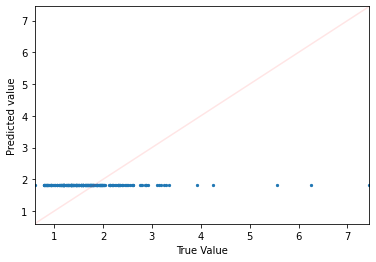

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


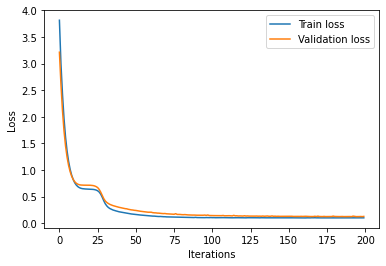

The loss on validation set is: 0.12713471055030823


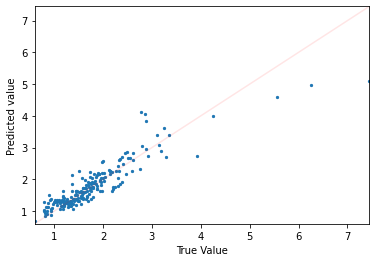

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


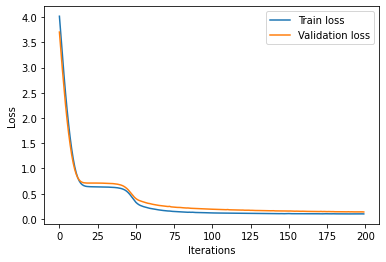

The loss on validation set is: 0.13784389197826385


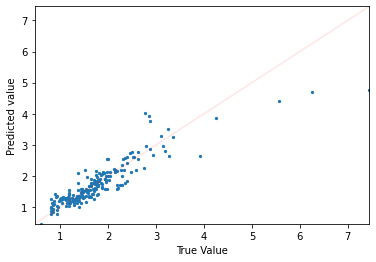

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


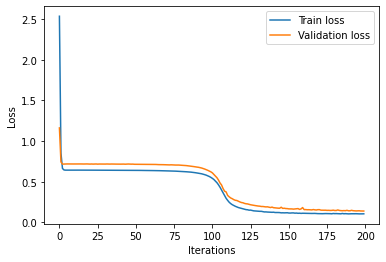

The loss on validation set is: 0.1407104730606079


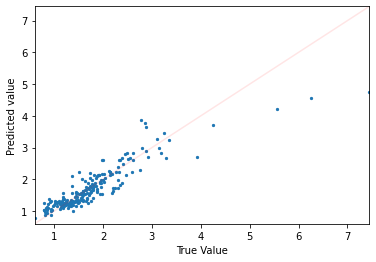

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


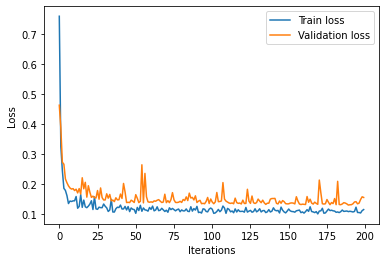

The loss on validation set is: 0.15450823307037354


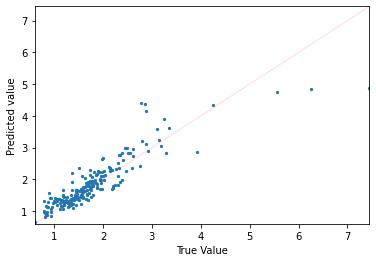

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


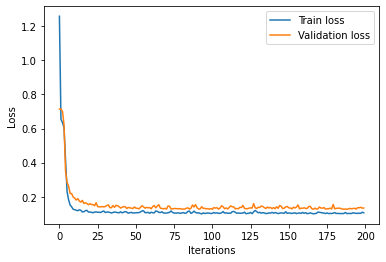

The loss on validation set is: 0.1337047964334488


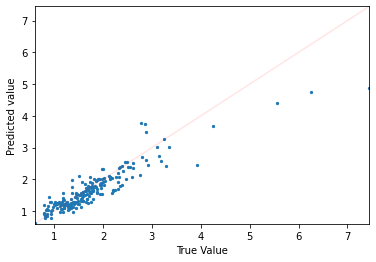

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


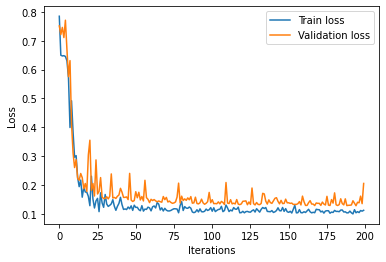

The loss on validation set is: 0.20525822043418884


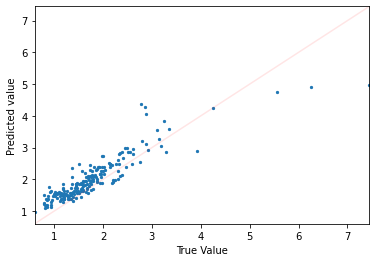

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


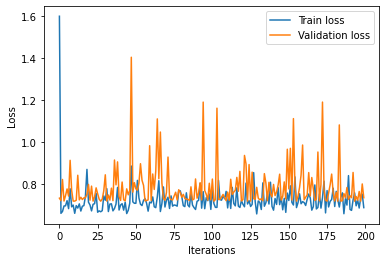

The loss on validation set is: 0.7344393134117126


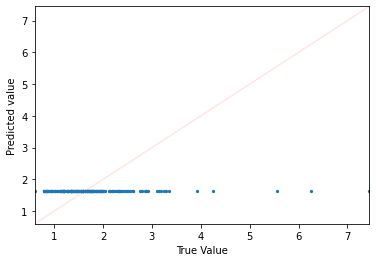

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


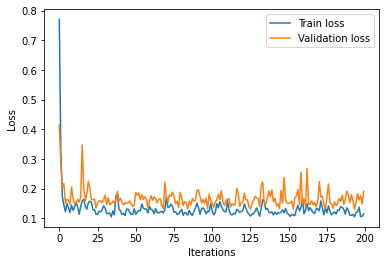

The loss on validation set is: 0.1910112053155899


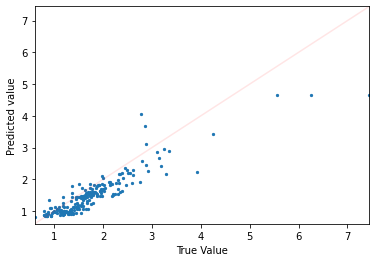

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


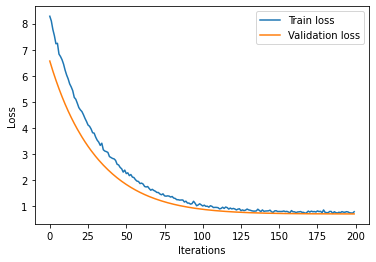

The loss on validation set is: 0.7146872878074646


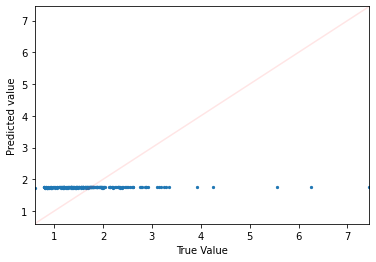

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


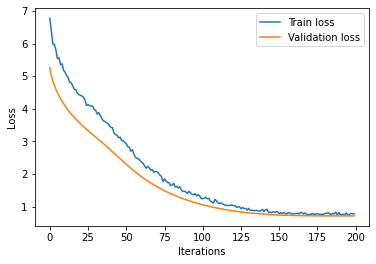

The loss on validation set is: 0.7170900702476501


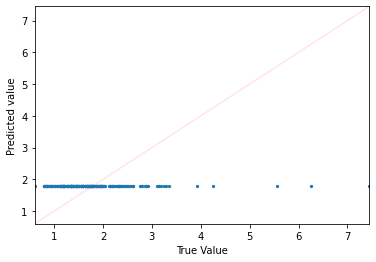

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


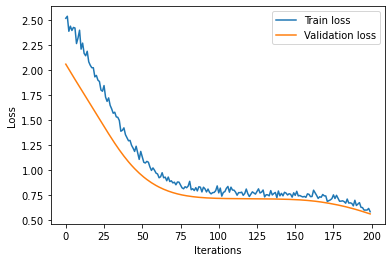

The loss on validation set is: 0.5593823790550232


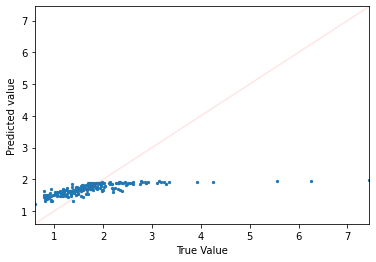

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


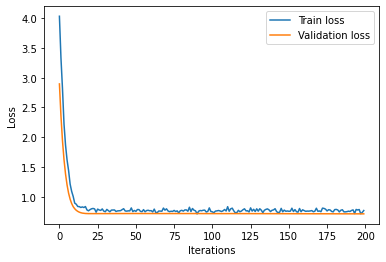

The loss on validation set is: 0.7116734385490417


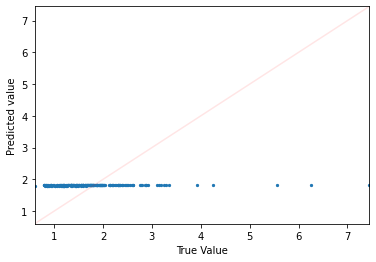

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


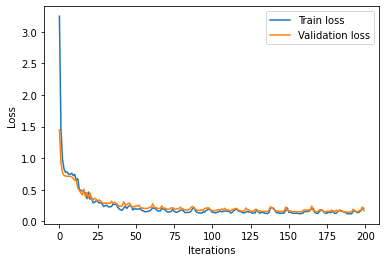

The loss on validation set is: 0.16571617126464844


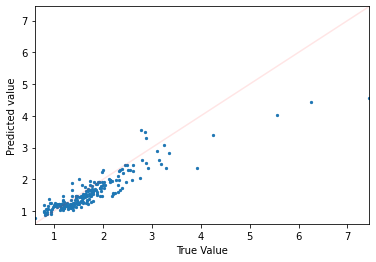

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


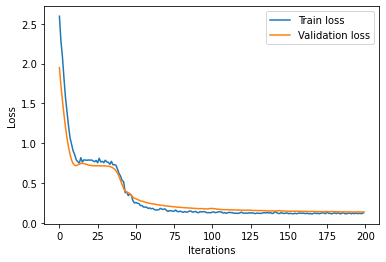

The loss on validation set is: 0.13411849737167358


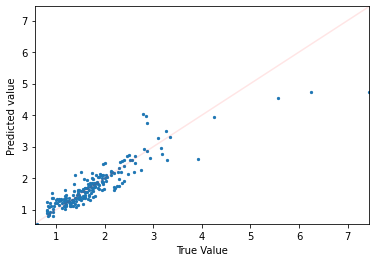

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


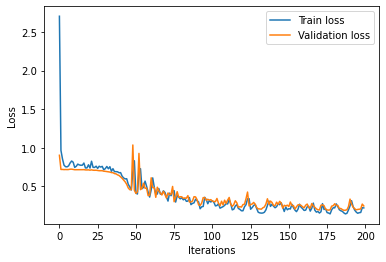

The loss on validation set is: 0.24612540006637573


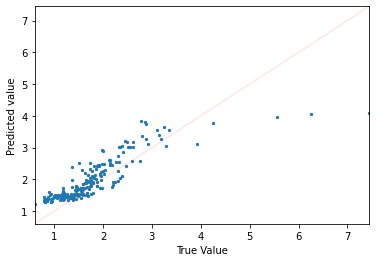

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


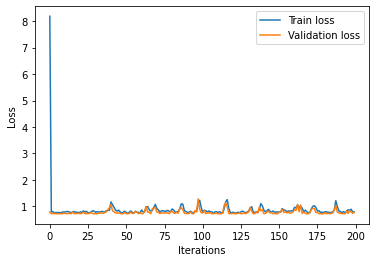

The loss on validation set is: 0.7756973505020142


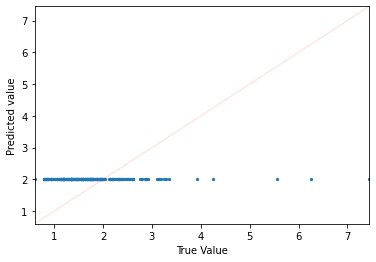

TRAINING WITH [4, 2, 2, 4, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


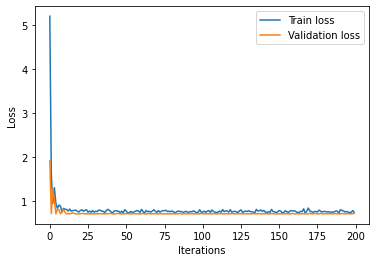

The loss on validation set is: 0.7249568104743958


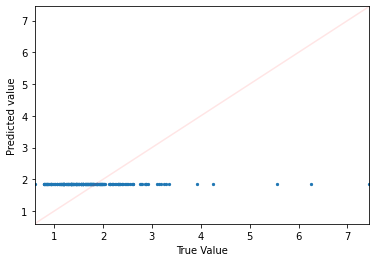

 62%|██████▏   | 8/13 [42:06<29:21, 352.35s/it]

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


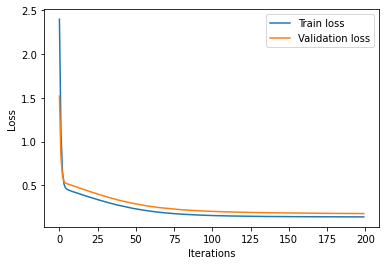

The loss on validation set is: 0.17575018107891083


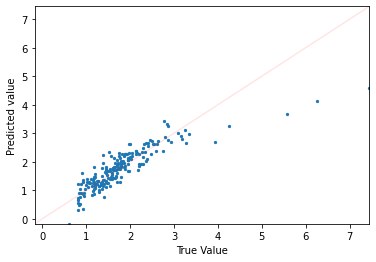

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


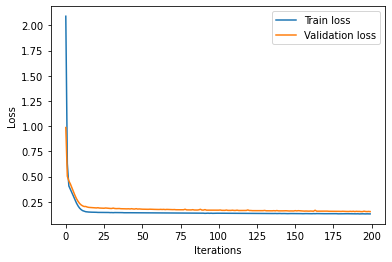

The loss on validation set is: 0.1539127230644226


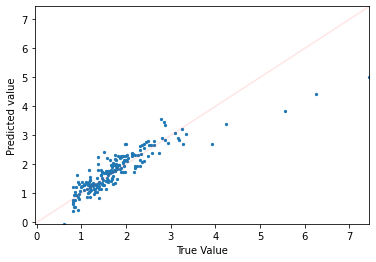

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


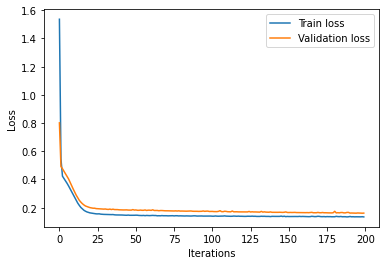

The loss on validation set is: 0.16151773929595947


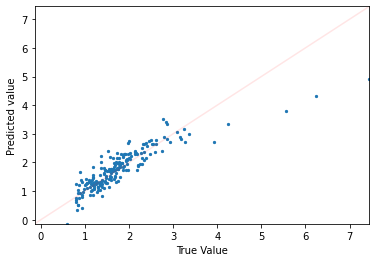

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


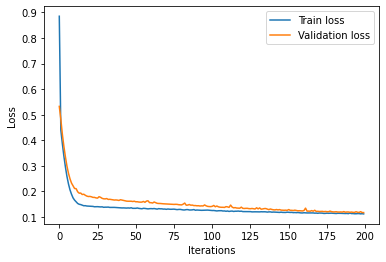

The loss on validation set is: 0.11670147627592087


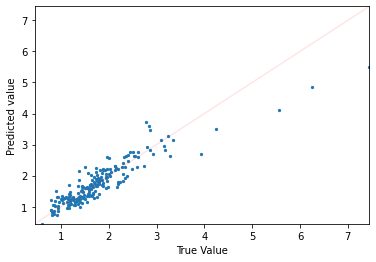

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


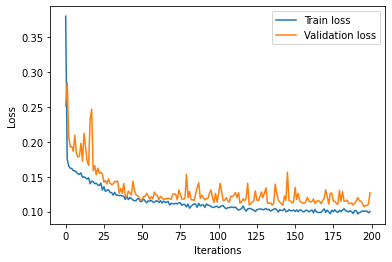

The loss on validation set is: 0.12695810198783875


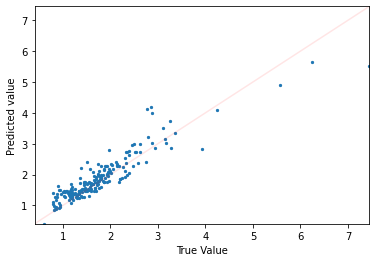

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


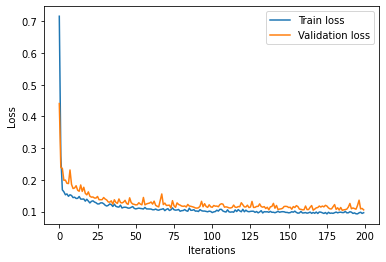

The loss on validation set is: 0.10541830211877823


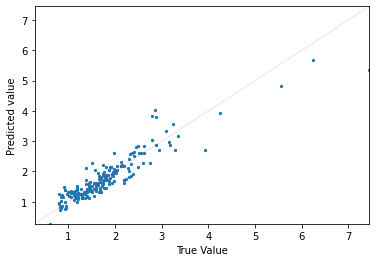

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


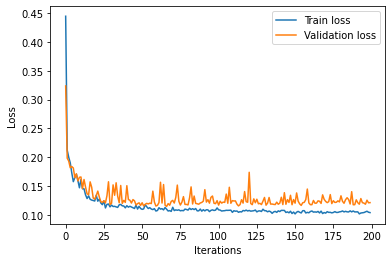

The loss on validation set is: 0.12109483033418655


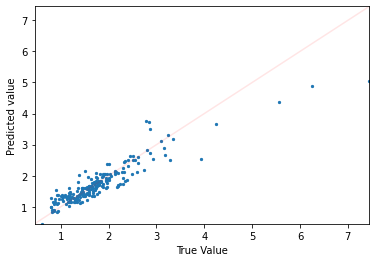

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


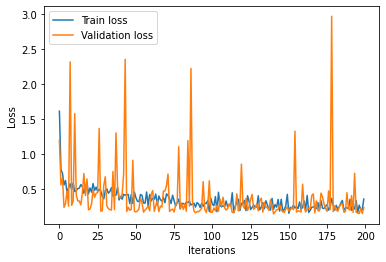

The loss on validation set is: 0.23238903284072876


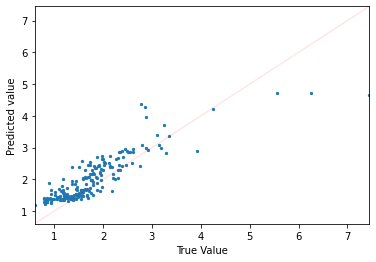

TRAINING WITH [10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


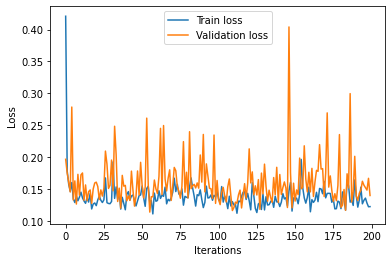

The loss on validation set is: 0.13988083600997925


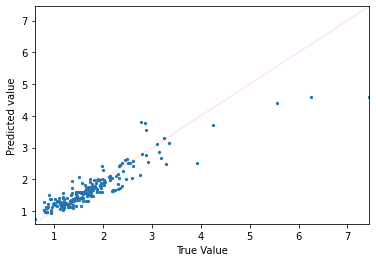

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


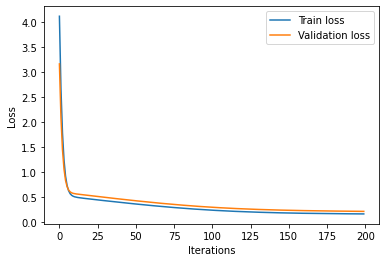

The loss on validation set is: 0.20889690518379211


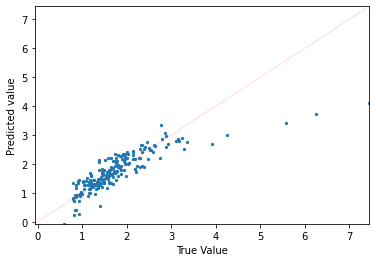

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


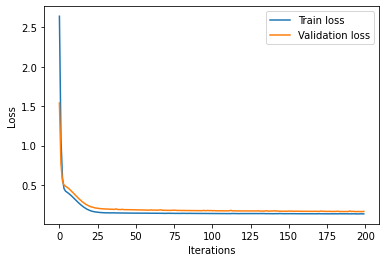

The loss on validation set is: 0.16691379249095917


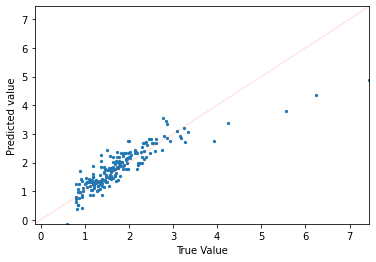

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


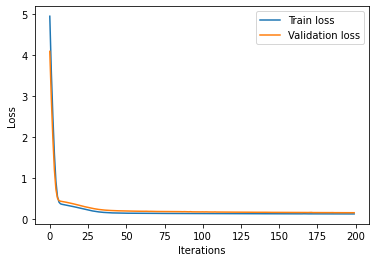

The loss on validation set is: 0.16356660425662994


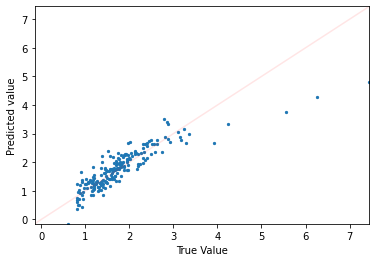

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


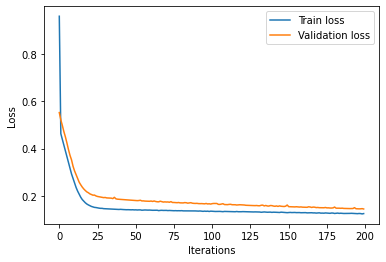

The loss on validation set is: 0.1450684666633606


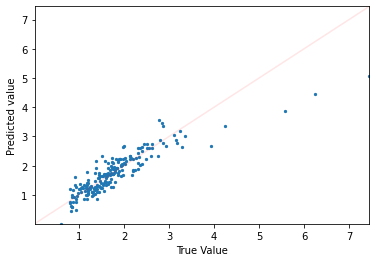

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


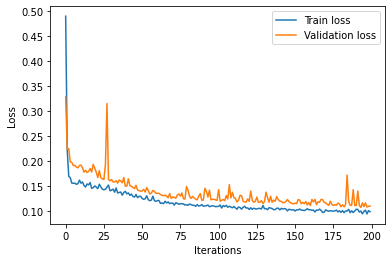

The loss on validation set is: 0.1105506643652916


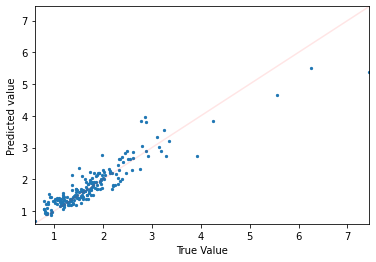

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


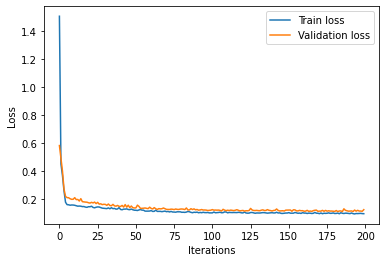

The loss on validation set is: 0.12354135513305664


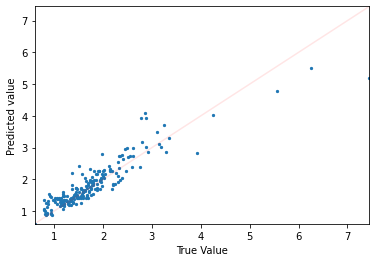

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


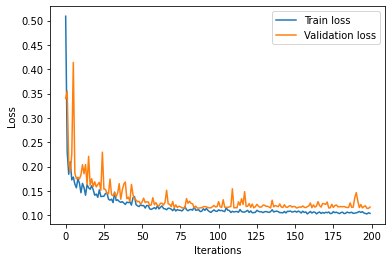

The loss on validation set is: 0.11685116589069366


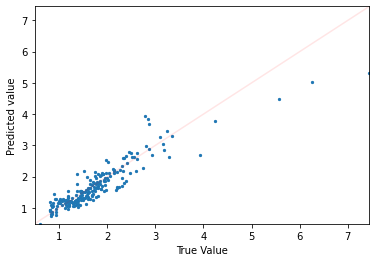

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


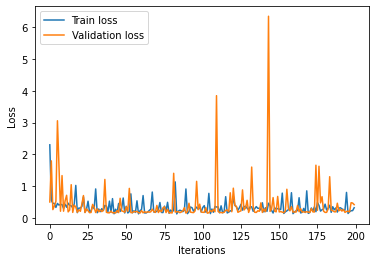

The loss on validation set is: 0.4130832552909851


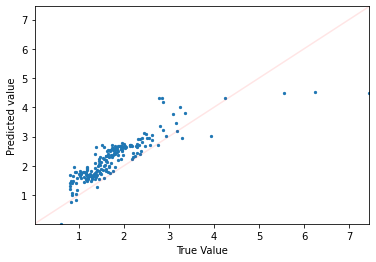

TRAINING WITH [10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


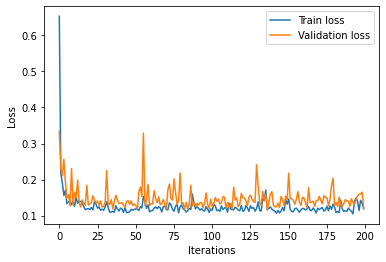

The loss on validation set is: 0.12069398164749146


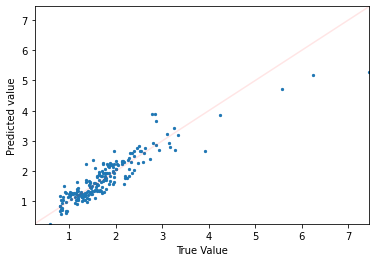

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


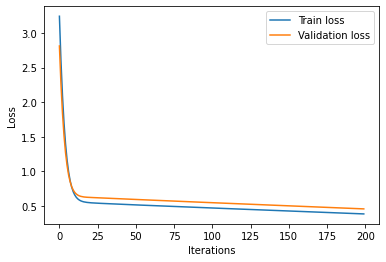

The loss on validation set is: 0.4582751393318176


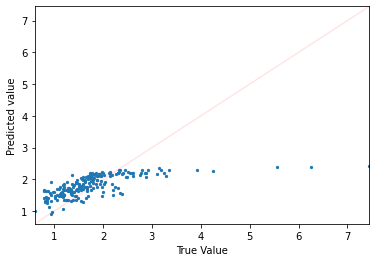

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


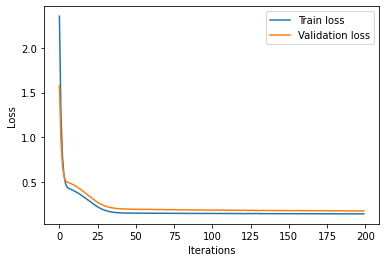

The loss on validation set is: 0.17143848538398743


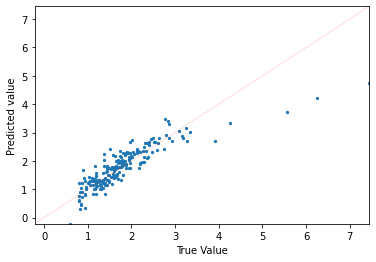

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


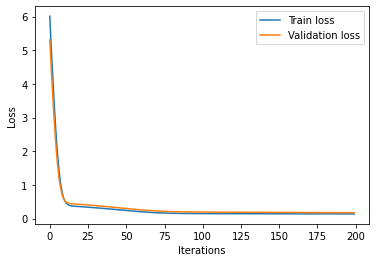

The loss on validation set is: 0.17629976570606232


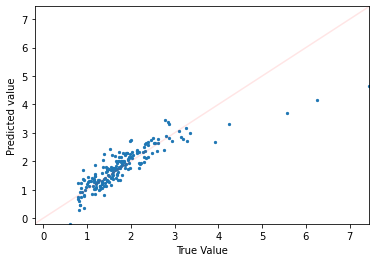

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


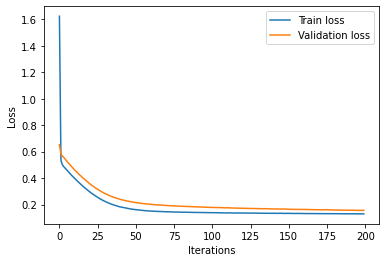

The loss on validation set is: 0.15583743155002594


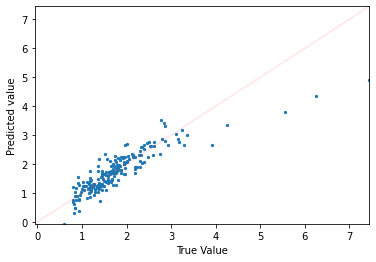

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


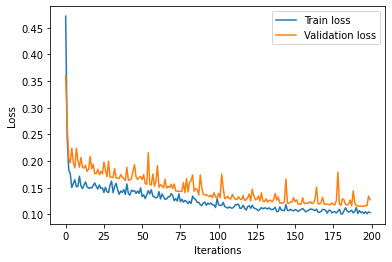

The loss on validation set is: 0.12755493819713593


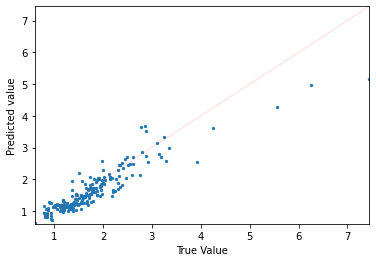

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


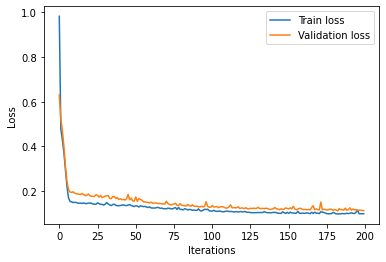

The loss on validation set is: 0.11236917227506638


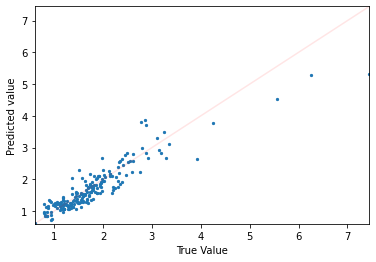

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


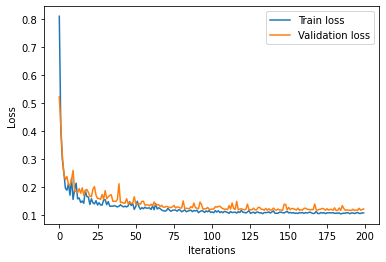

The loss on validation set is: 0.12090356647968292


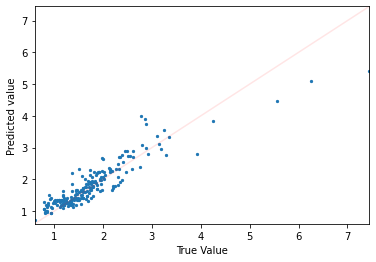

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


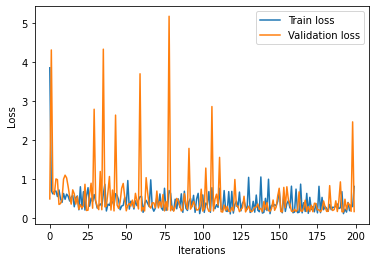

The loss on validation set is: 0.1681959182024002


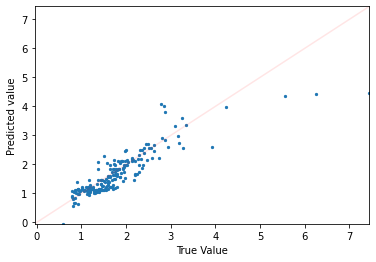

TRAINING WITH [10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


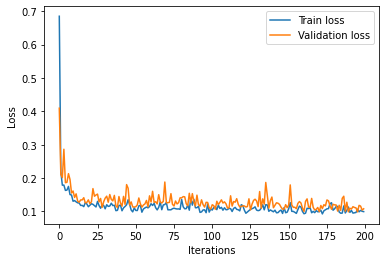

The loss on validation set is: 0.10786402970552444


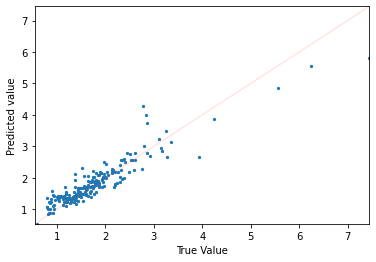

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


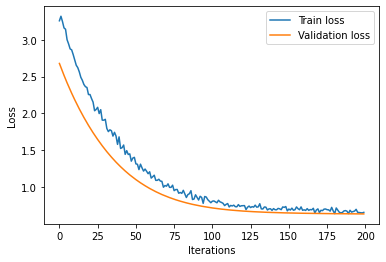

The loss on validation set is: 0.6355948448181152


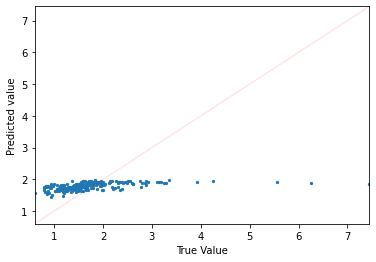

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


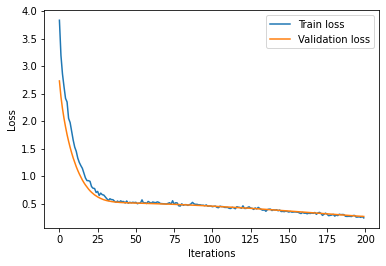

The loss on validation set is: 0.26597073674201965


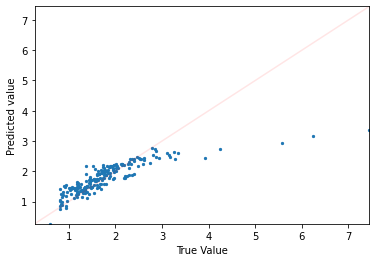

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


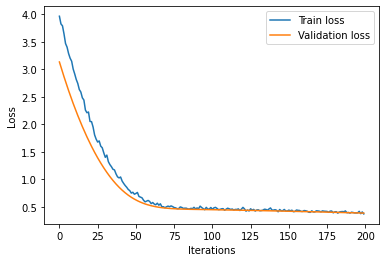

The loss on validation set is: 0.3833577632904053


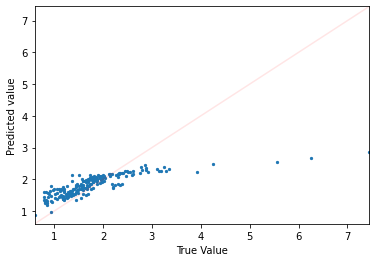

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


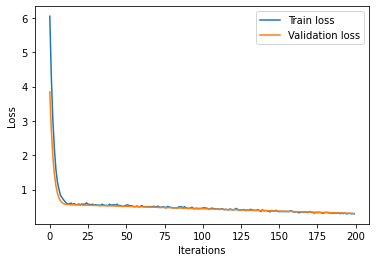

The loss on validation set is: 0.3060523271560669


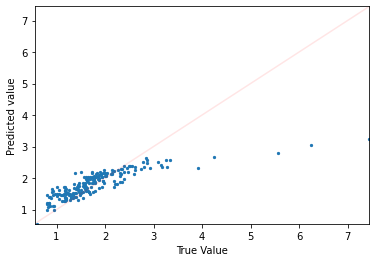

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


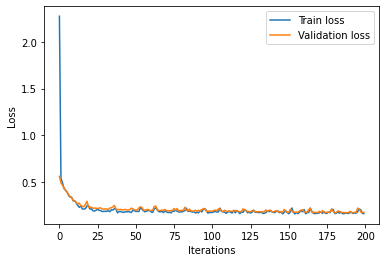

The loss on validation set is: 0.1723419725894928


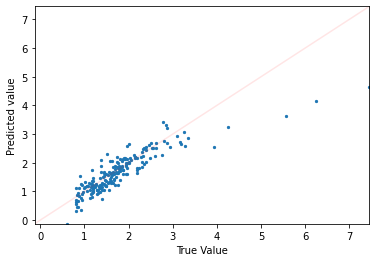

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


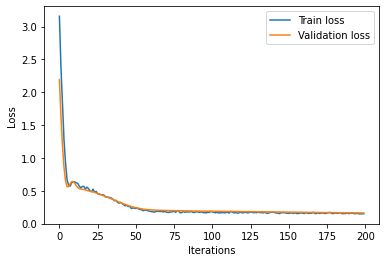

The loss on validation set is: 0.16004514694213867


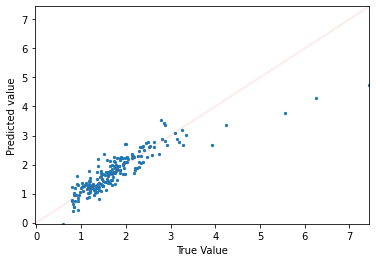

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


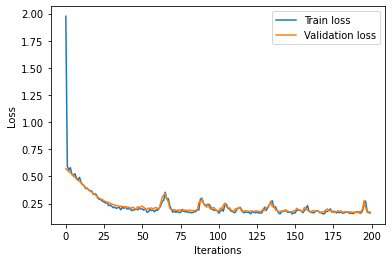

The loss on validation set is: 0.1722196638584137


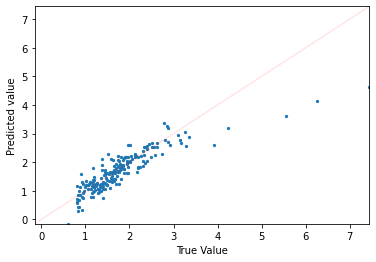

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


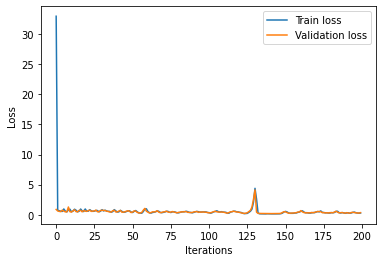

The loss on validation set is: 0.3394438922405243


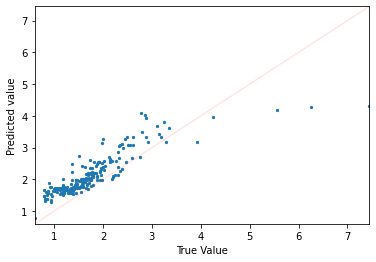

TRAINING WITH [10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


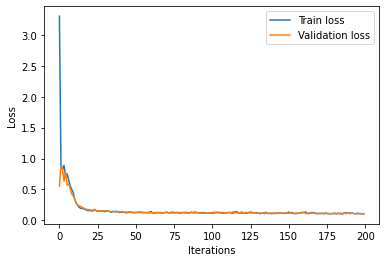

The loss on validation set is: 0.10919762402772903


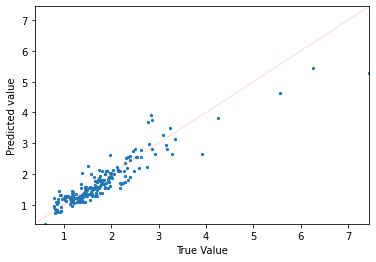

 69%|██████▉   | 9/13 [46:41<21:52, 328.20s/it]

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


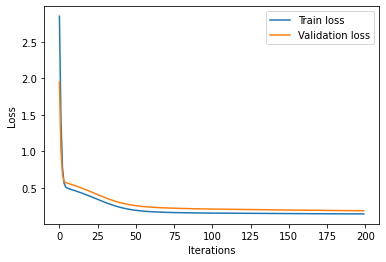

The loss on validation set is: 0.1840732991695404


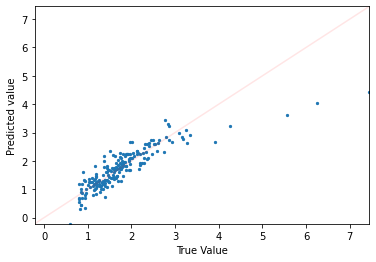

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


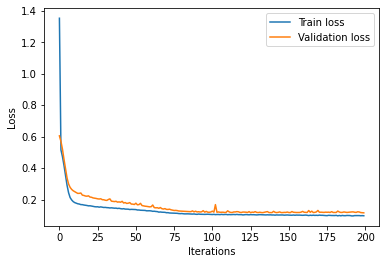

The loss on validation set is: 0.11559060961008072


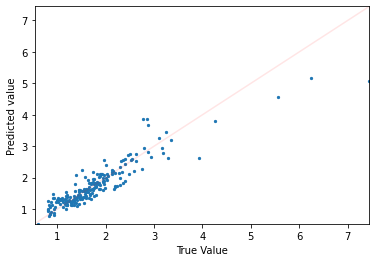

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


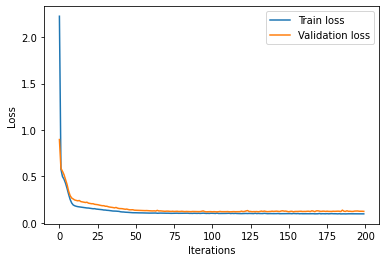

The loss on validation set is: 0.12470453977584839


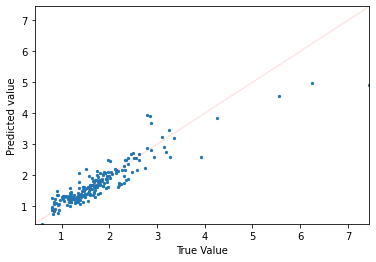

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


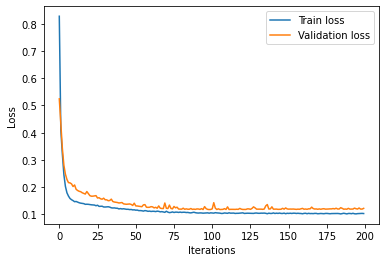

The loss on validation set is: 0.1223619282245636


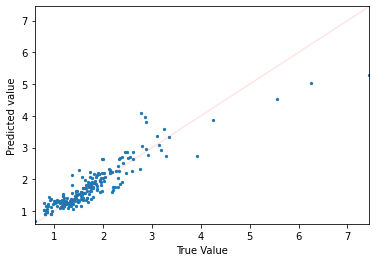

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


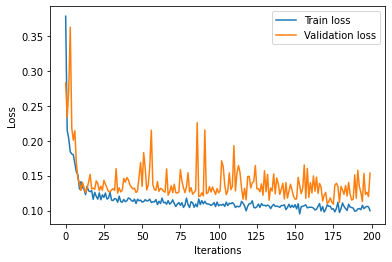

The loss on validation set is: 0.15358054637908936


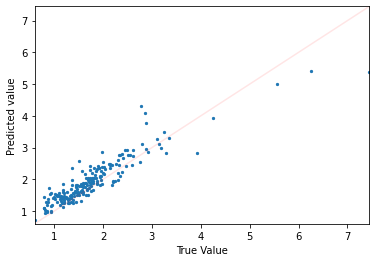

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


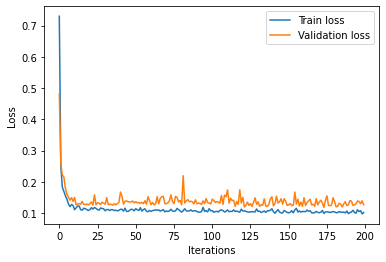

The loss on validation set is: 0.12647829949855804


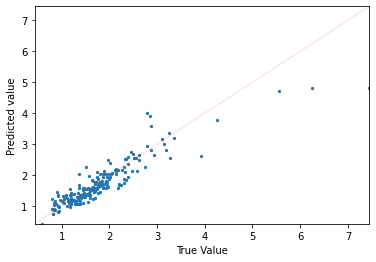

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


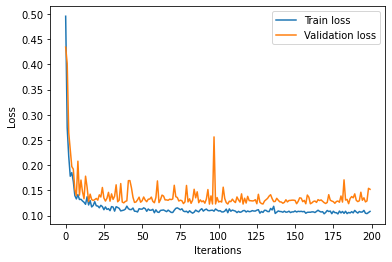

The loss on validation set is: 0.15202121436595917


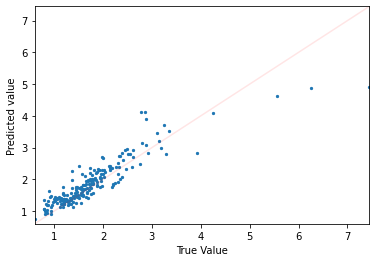

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


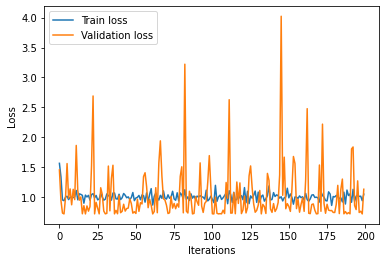

The loss on validation set is: 1.1303308010101318


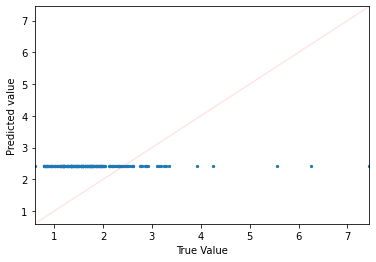

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


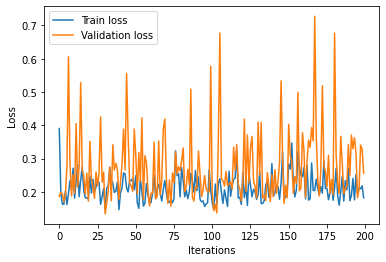

The loss on validation set is: 0.255926251411438


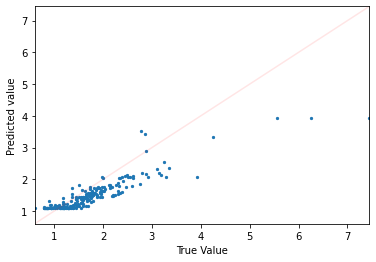

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


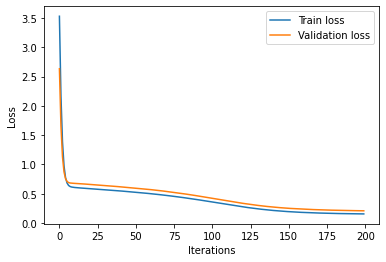

The loss on validation set is: 0.20980383455753326


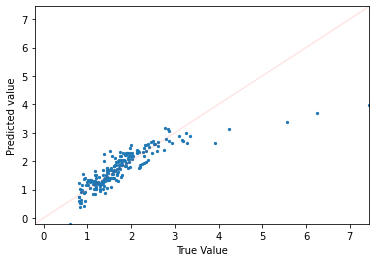

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


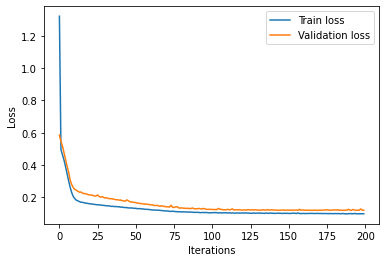

The loss on validation set is: 0.1203451082110405


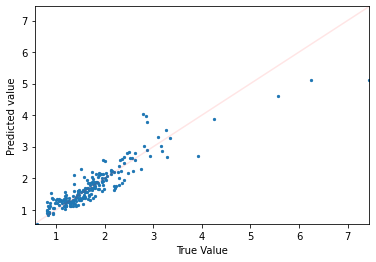

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


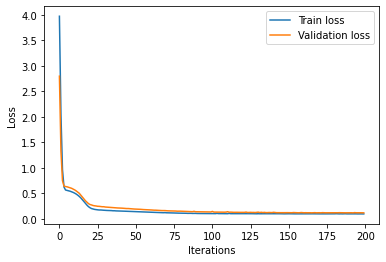

The loss on validation set is: 0.12080393731594086


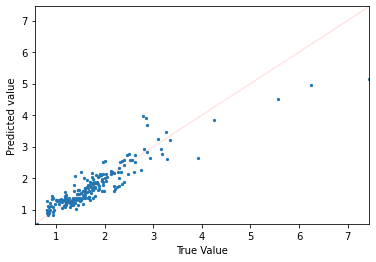

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


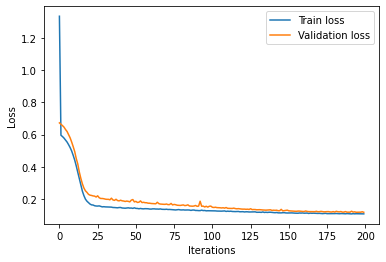

The loss on validation set is: 0.11630909144878387


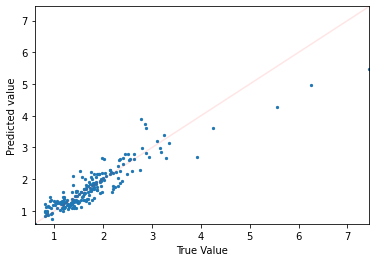

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


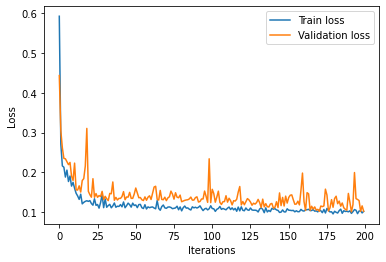

The loss on validation set is: 0.10213884711265564


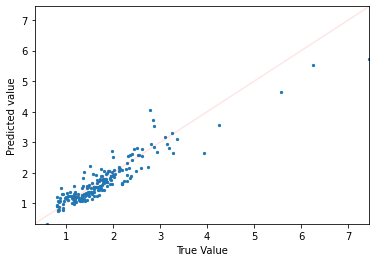

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


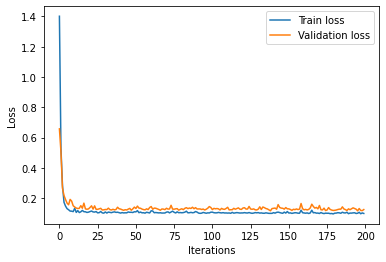

The loss on validation set is: 0.12470737099647522


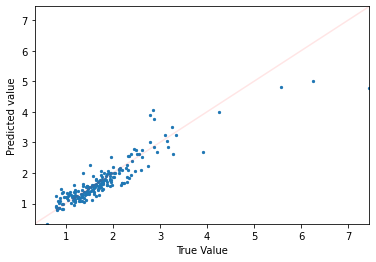

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


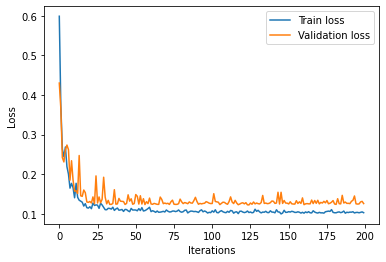

The loss on validation set is: 0.1259351372718811


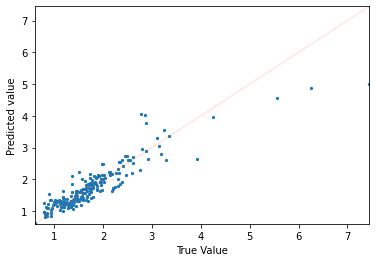

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


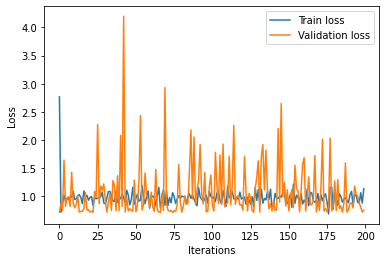

The loss on validation set is: 0.7540340423583984


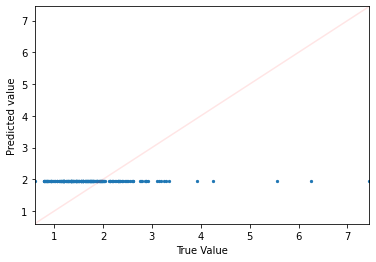

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


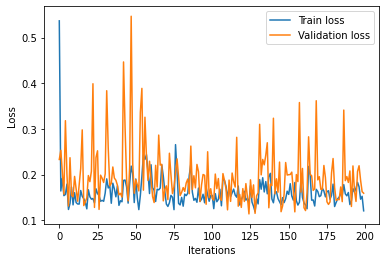

The loss on validation set is: 0.15911512076854706


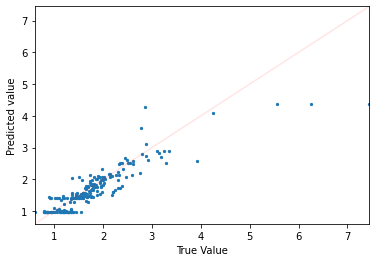

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


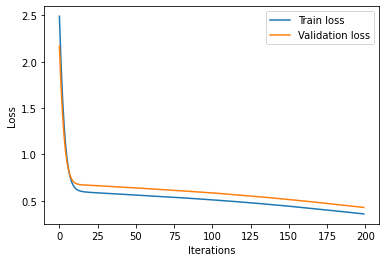

The loss on validation set is: 0.4285479784011841


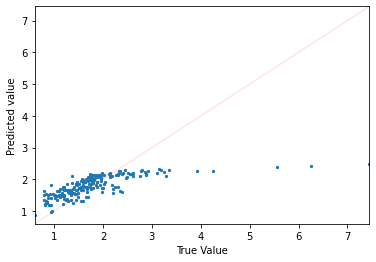

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


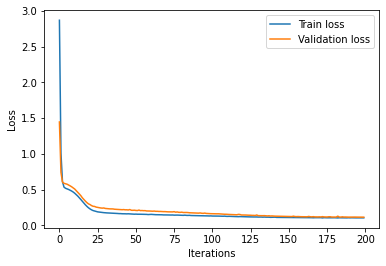

The loss on validation set is: 0.11391674727201462


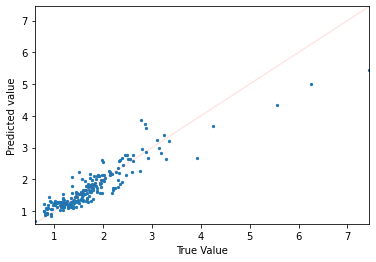

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


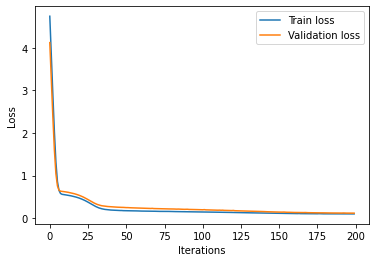

The loss on validation set is: 0.11912453919649124


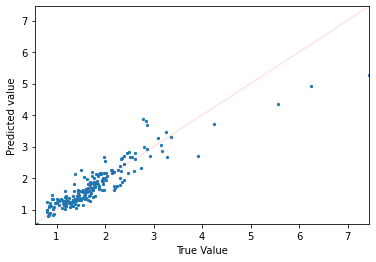

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


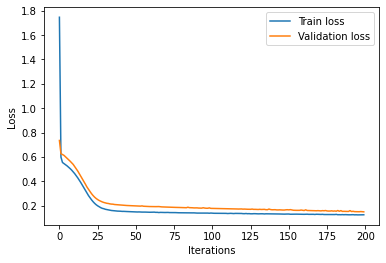

The loss on validation set is: 0.14955715835094452


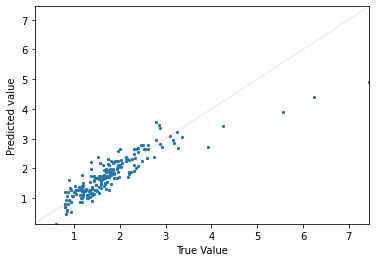

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


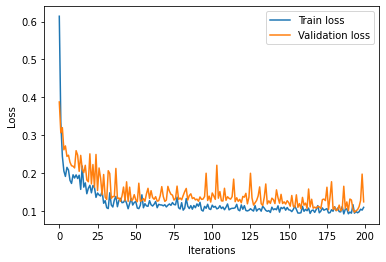

The loss on validation set is: 0.12473878264427185


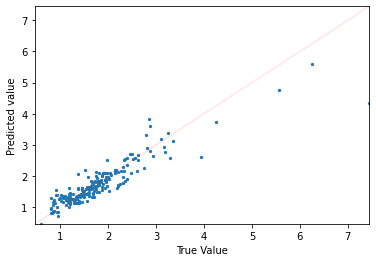

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


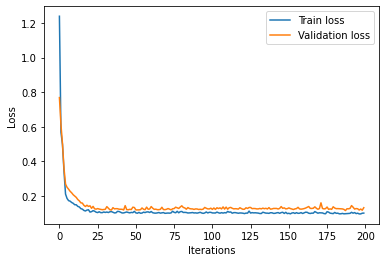

The loss on validation set is: 0.1314920037984848


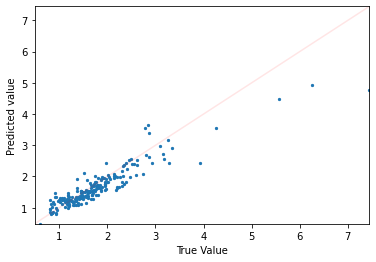

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


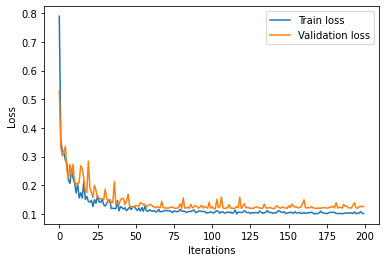

The loss on validation set is: 0.12556758522987366


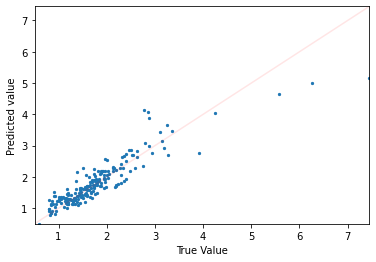

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


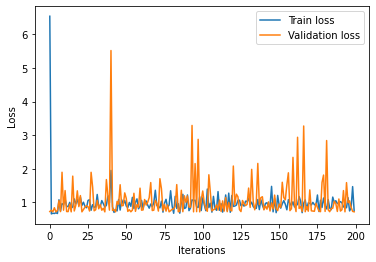

The loss on validation set is: 0.7192825078964233


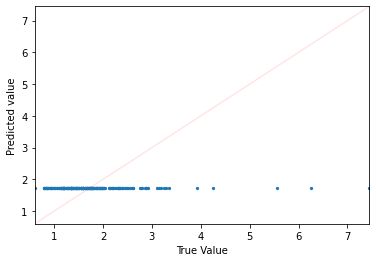

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


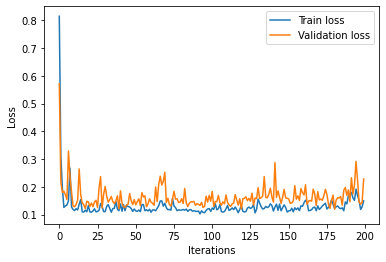

The loss on validation set is: 0.22816473245620728


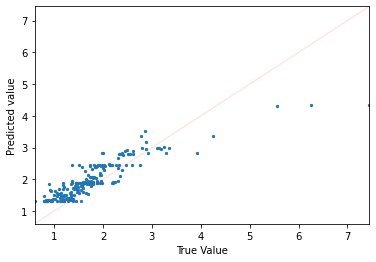

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


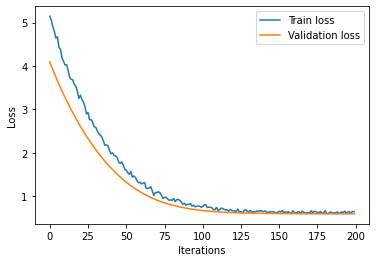

The loss on validation set is: 0.5898705124855042


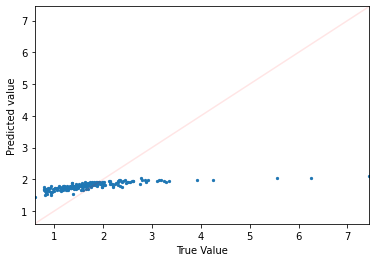

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


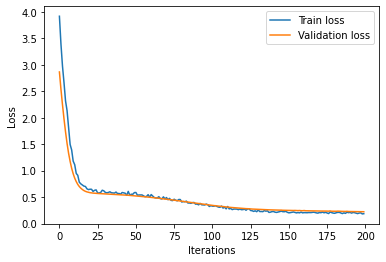

The loss on validation set is: 0.22319267690181732


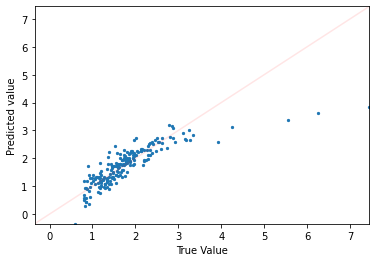

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


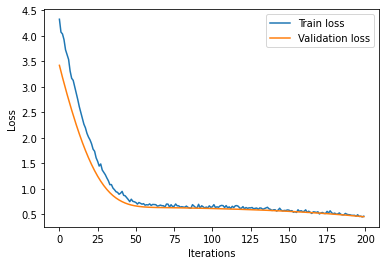

The loss on validation set is: 0.45035725831985474


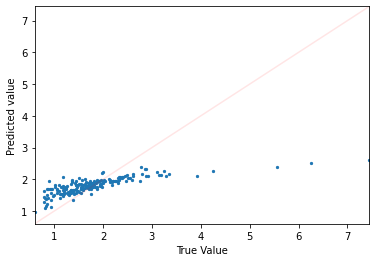

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


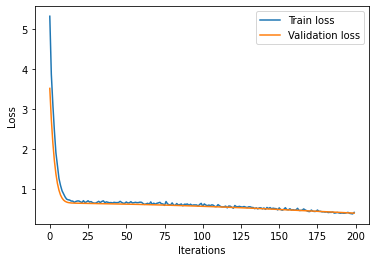

The loss on validation set is: 0.3976822793483734


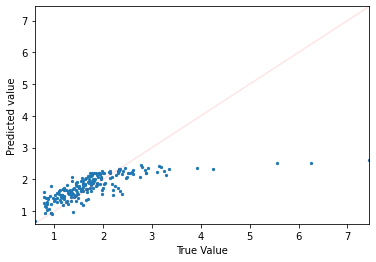

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


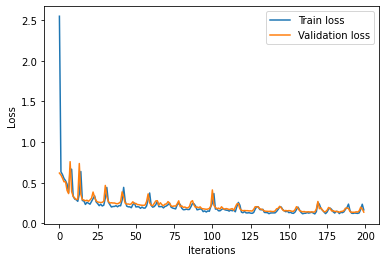

The loss on validation set is: 0.13714787364006042


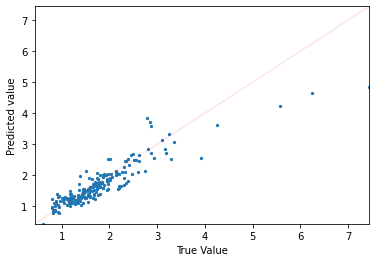

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


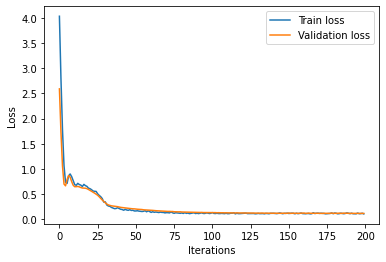

The loss on validation set is: 0.1207653060555458


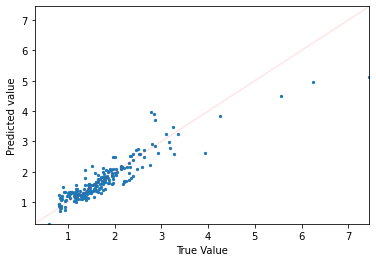

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


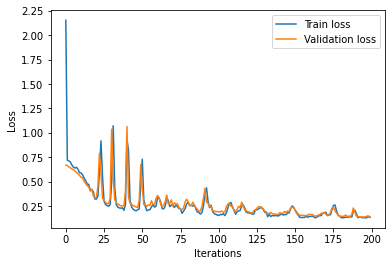

The loss on validation set is: 0.1386401504278183


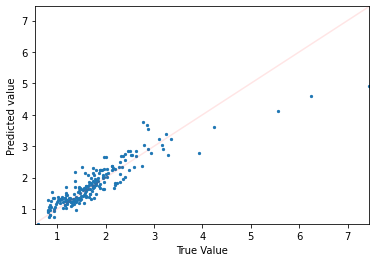

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


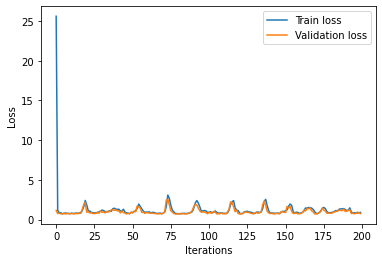

The loss on validation set is: 0.7563299536705017


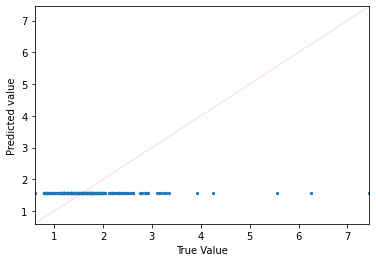

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


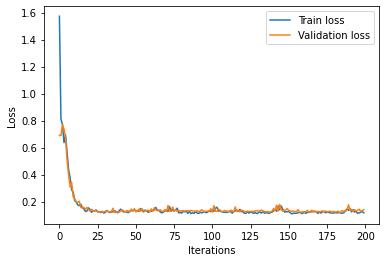

The loss on validation set is: 0.14003793895244598


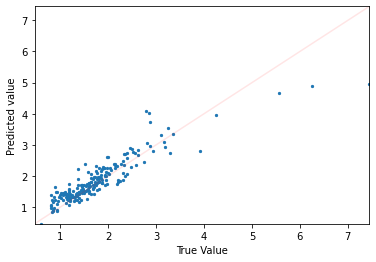

 77%|███████▋  | 10/13 [52:14<16:28, 329.63s/it]

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


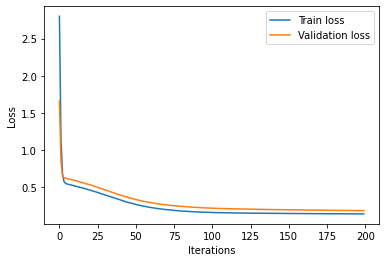

The loss on validation set is: 0.18355950713157654


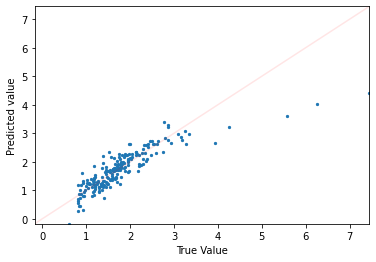

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


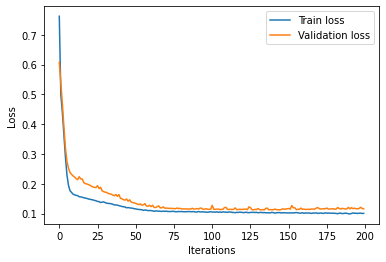

The loss on validation set is: 0.11596408486366272


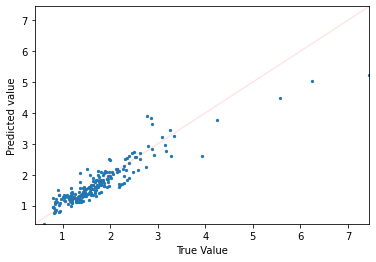

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


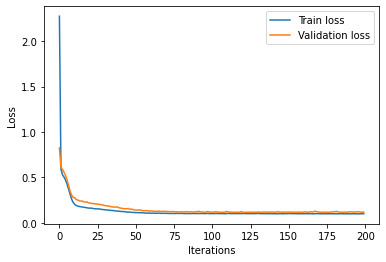

The loss on validation set is: 0.12025121599435806


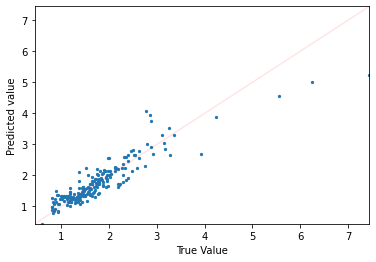

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


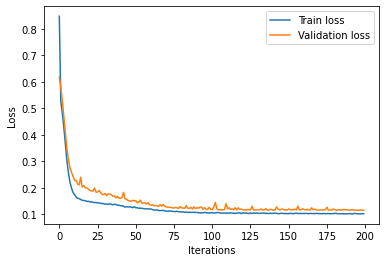

The loss on validation set is: 0.11524016410112381


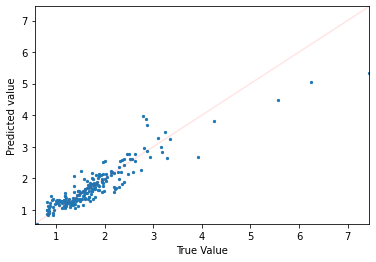

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


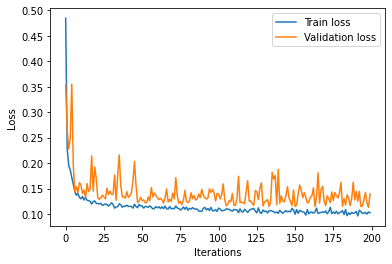

The loss on validation set is: 0.13934484124183655


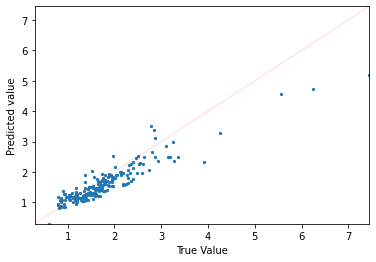

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


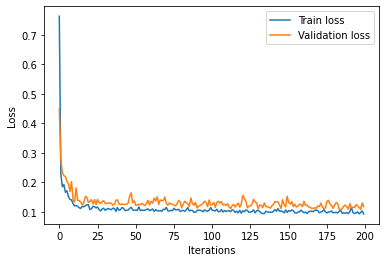

The loss on validation set is: 0.1181536465883255


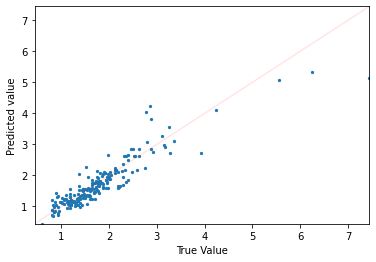

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


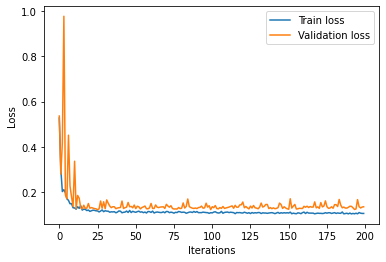

The loss on validation set is: 0.1340838074684143


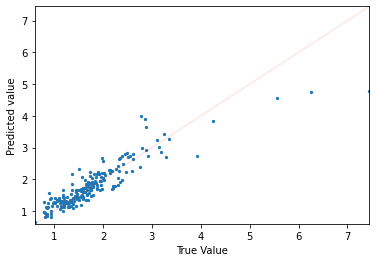

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


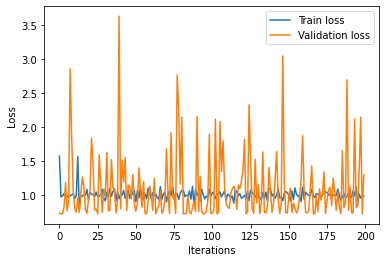

The loss on validation set is: 1.2945637702941895


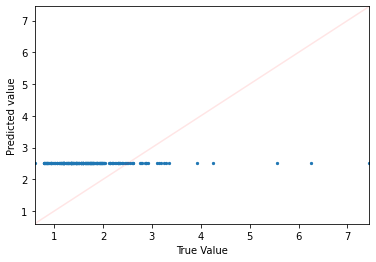

TRAINING WITH [10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


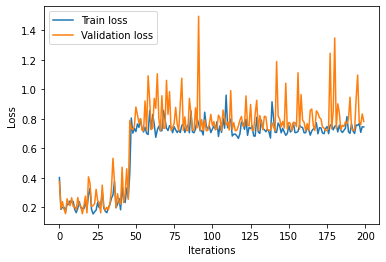

The loss on validation set is: 0.781583309173584


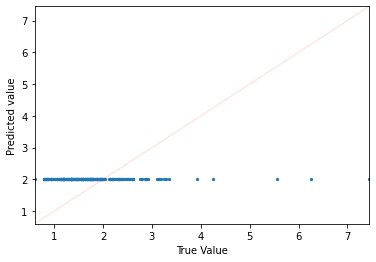

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


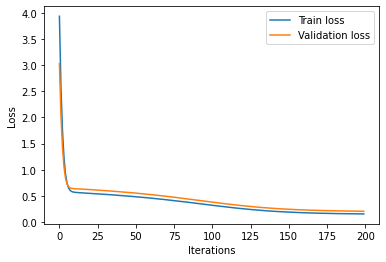

The loss on validation set is: 0.20330390334129333


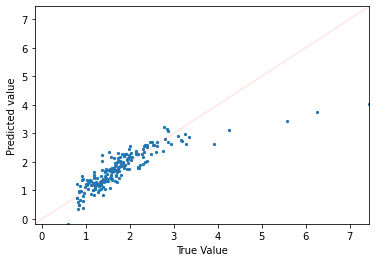

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


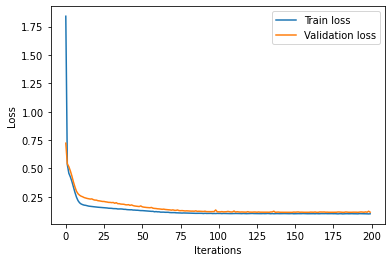

The loss on validation set is: 0.11449380964040756


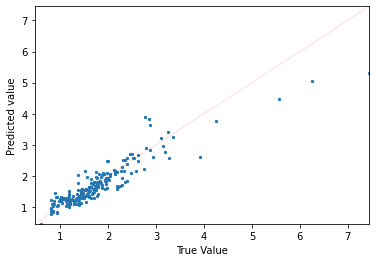

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


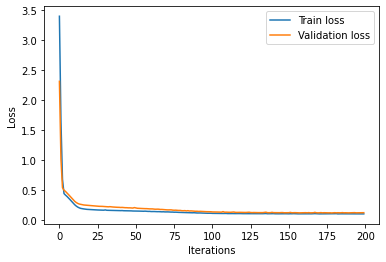

The loss on validation set is: 0.11891903728246689


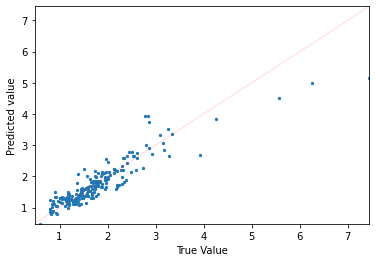

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


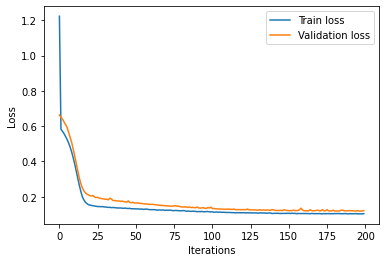

The loss on validation set is: 0.1215614527463913


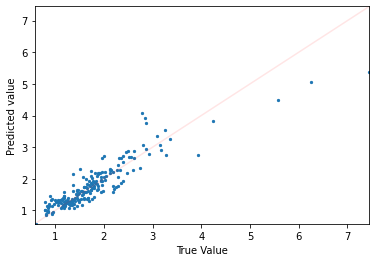

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


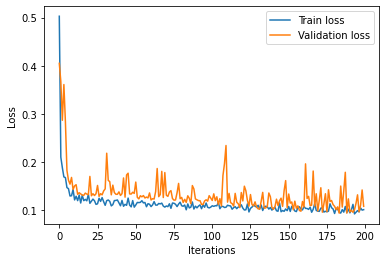

The loss on validation set is: 0.10715794563293457


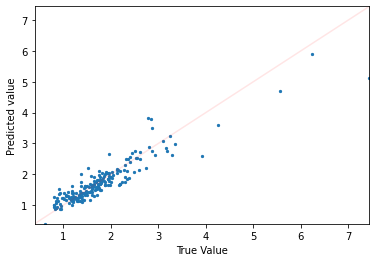

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


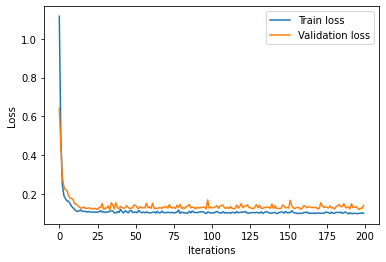

The loss on validation set is: 0.14160668849945068


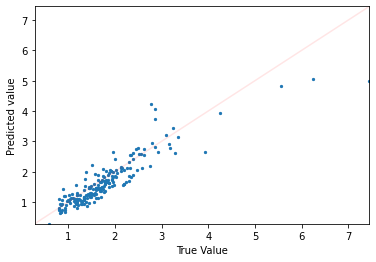

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


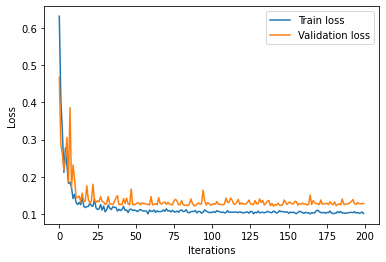

The loss on validation set is: 0.12788629531860352


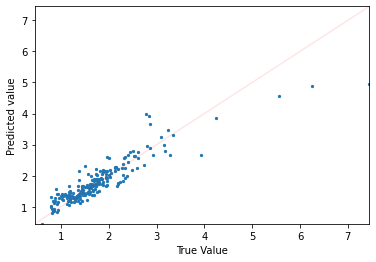

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


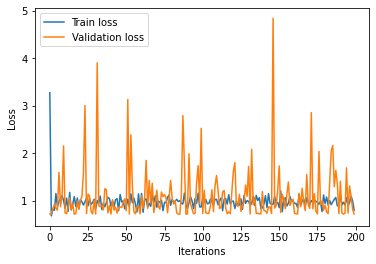

The loss on validation set is: 0.7217327356338501


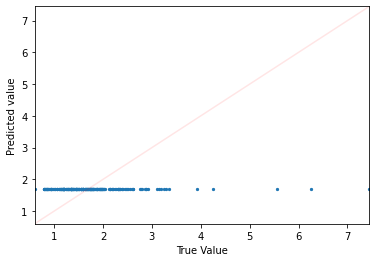

TRAINING WITH [10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


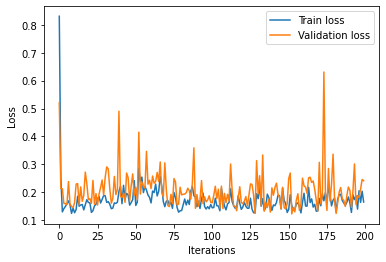

The loss on validation set is: 0.24099892377853394


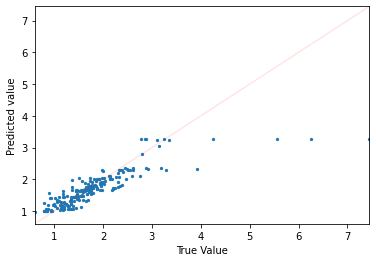

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


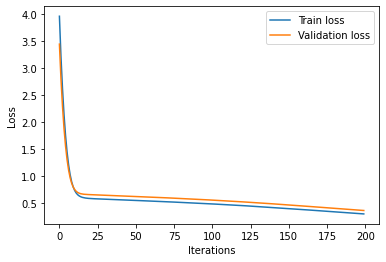

The loss on validation set is: 0.355925977230072


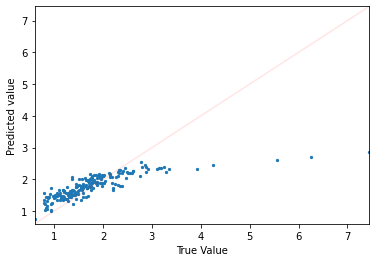

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


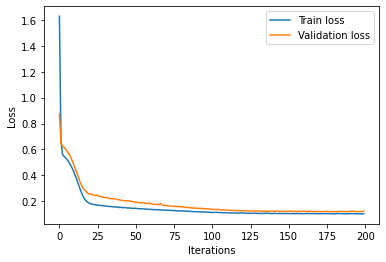

The loss on validation set is: 0.12268707156181335


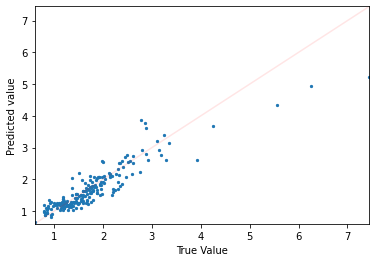

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


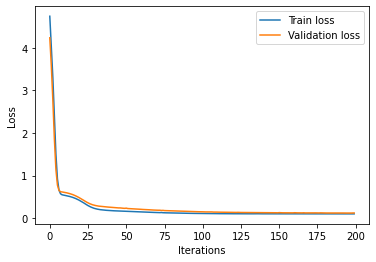

The loss on validation set is: 0.12168202549219131


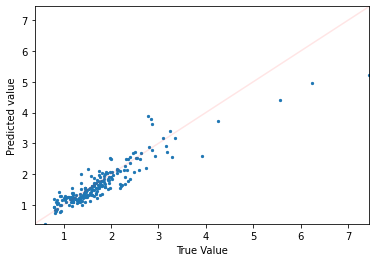

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


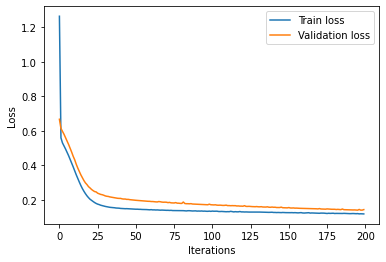

The loss on validation set is: 0.1429312825202942


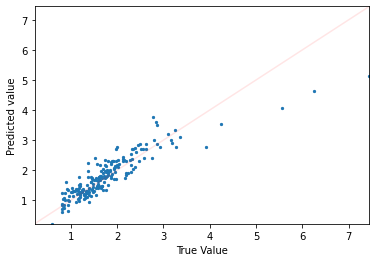

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


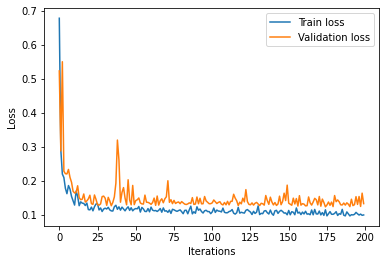

The loss on validation set is: 0.13316361606121063


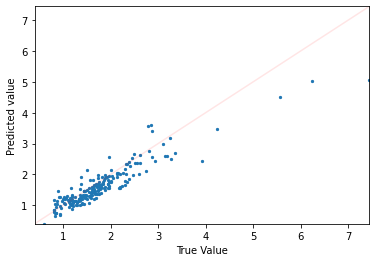

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


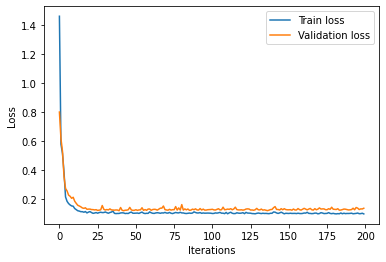

The loss on validation set is: 0.13655461370944977


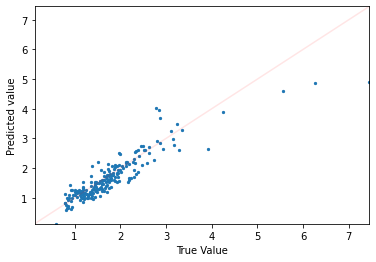

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


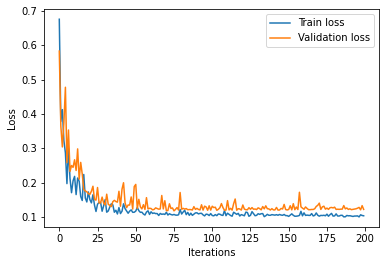

The loss on validation set is: 0.12153315544128418


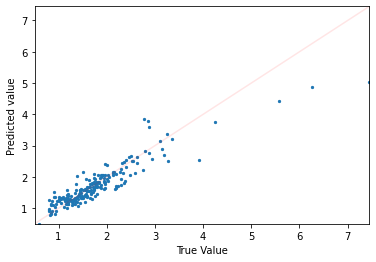

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


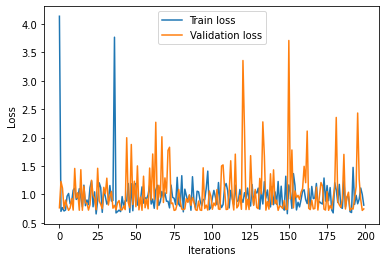

The loss on validation set is: 0.7443994283676147


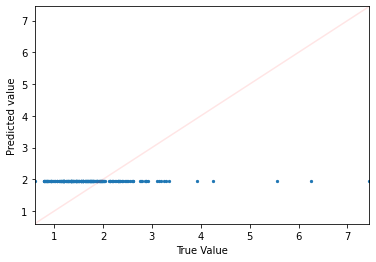

TRAINING WITH [10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


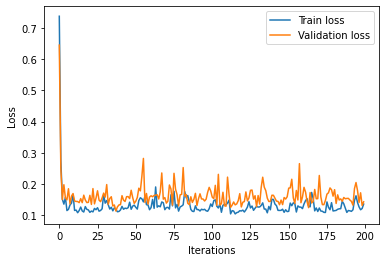

The loss on validation set is: 0.14209337532520294


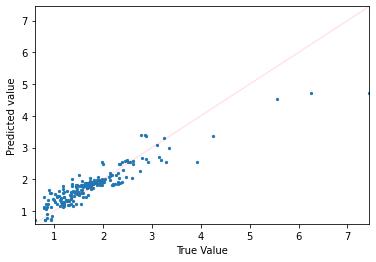

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


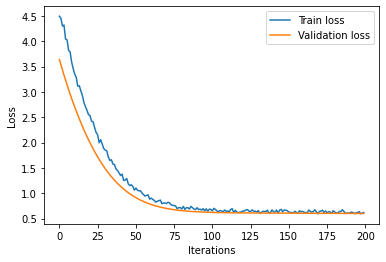

The loss on validation set is: 0.601040244102478


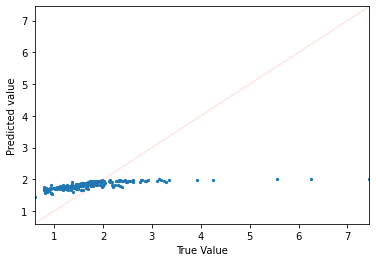

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


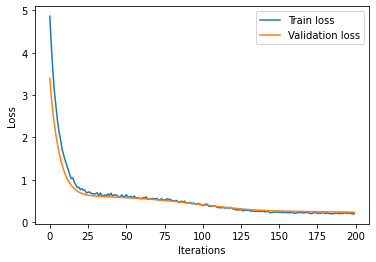

The loss on validation set is: 0.23024152219295502


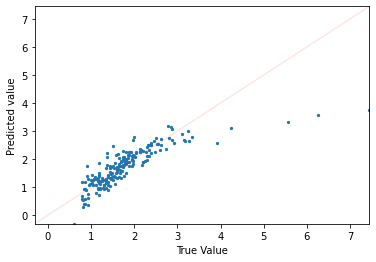

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


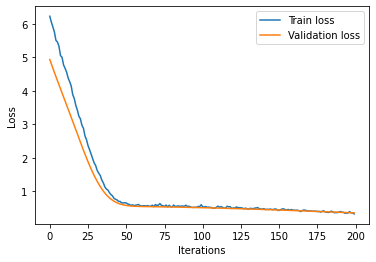

The loss on validation set is: 0.3539419174194336


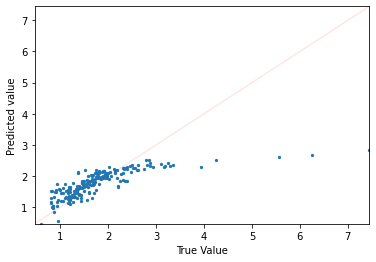

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


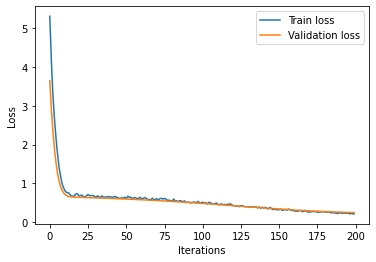

The loss on validation set is: 0.24164970219135284


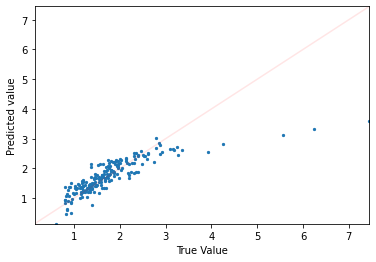

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


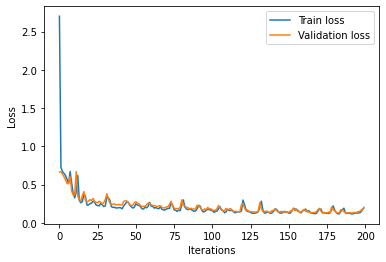

The loss on validation set is: 0.20296823978424072


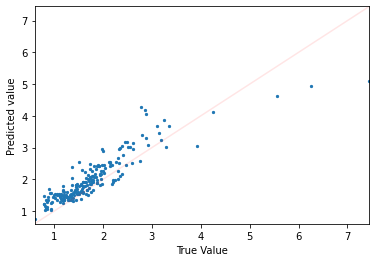

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


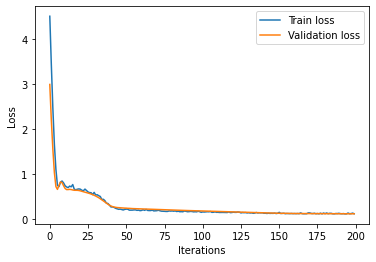

The loss on validation set is: 0.1187175065279007


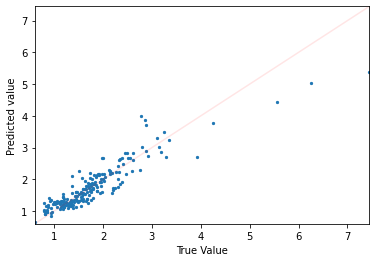

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


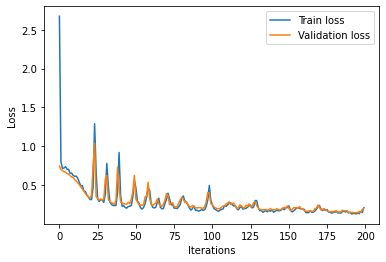

The loss on validation set is: 0.2022729516029358


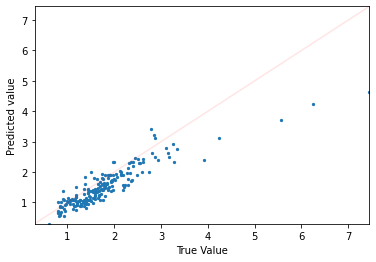

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


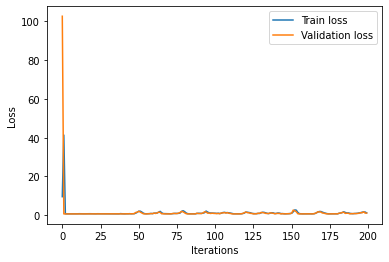

The loss on validation set is: 1.1590083837509155


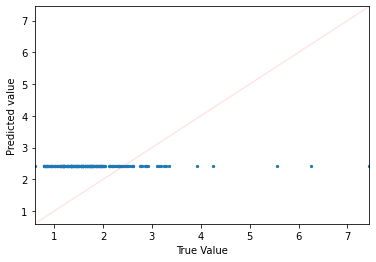

TRAINING WITH [10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


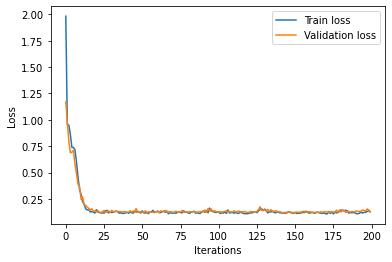

The loss on validation set is: 0.12880747020244598


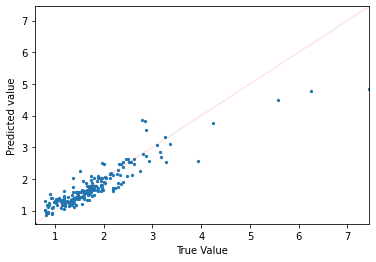

 85%|████████▍ | 11/13 [58:04<11:11, 335.78s/it]

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


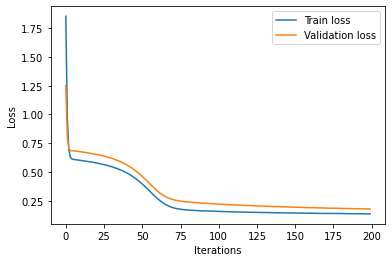

The loss on validation set is: 0.17788319289684296


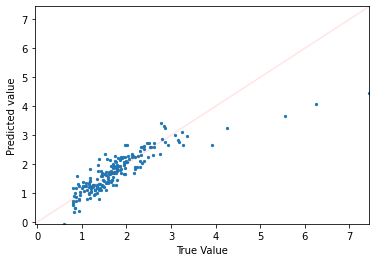

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


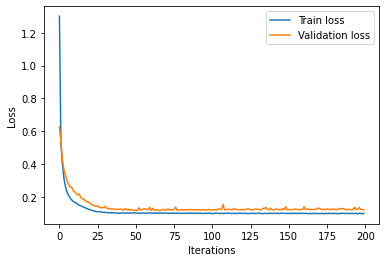

The loss on validation set is: 0.1222478449344635


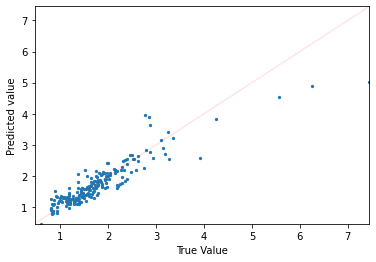

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


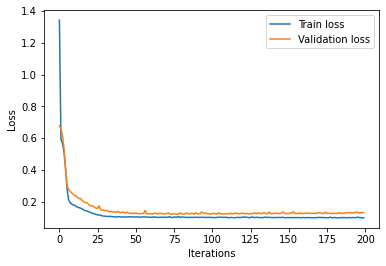

The loss on validation set is: 0.12975932657718658


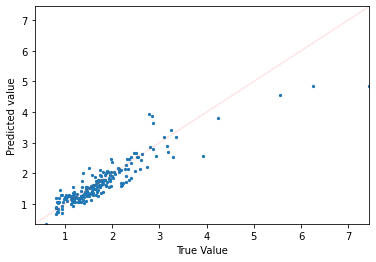

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


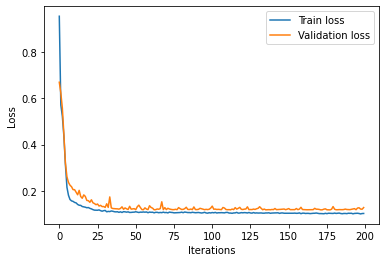

The loss on validation set is: 0.12787885963916779


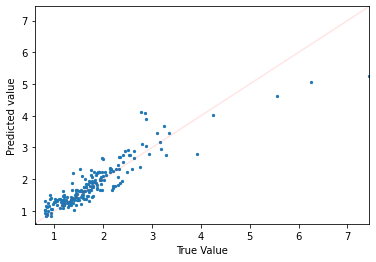

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


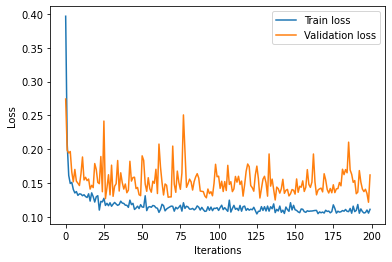

The loss on validation set is: 0.16183170676231384


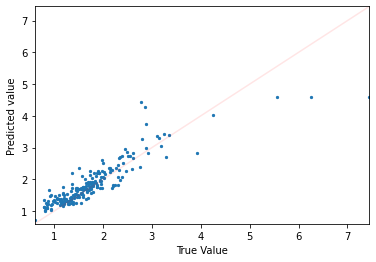

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


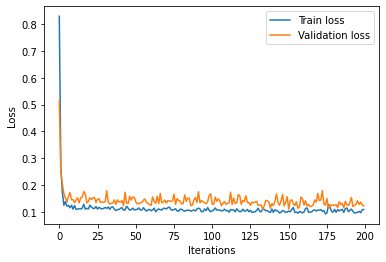

The loss on validation set is: 0.12328927218914032


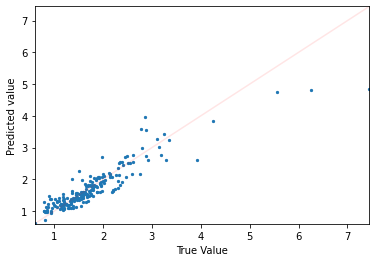

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


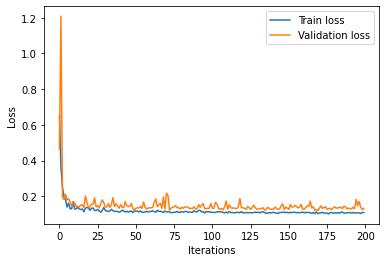

The loss on validation set is: 0.13231050968170166


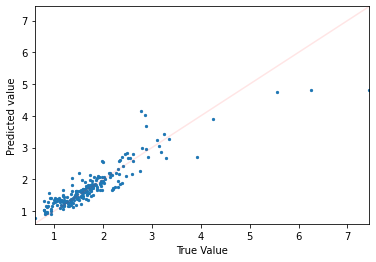

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


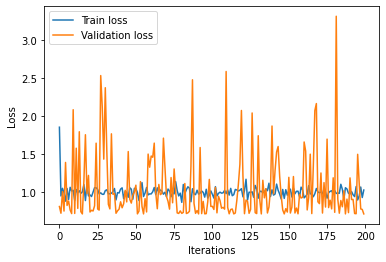

The loss on validation set is: 0.7181512713432312


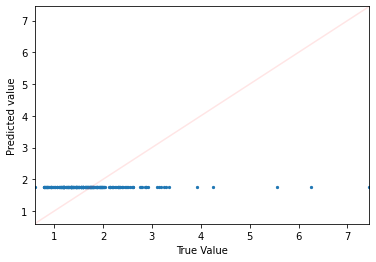

TRAINING WITH [10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


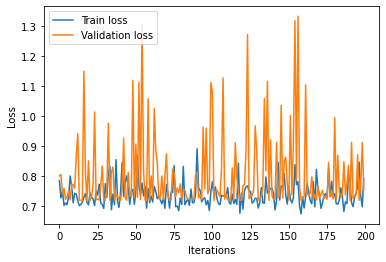

The loss on validation set is: 0.7524688839912415


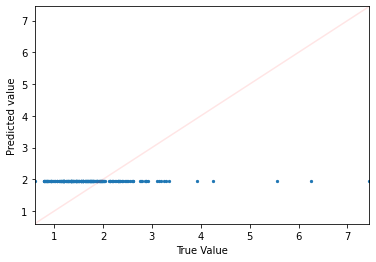

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


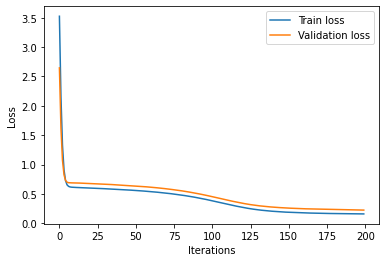

The loss on validation set is: 0.22604374587535858


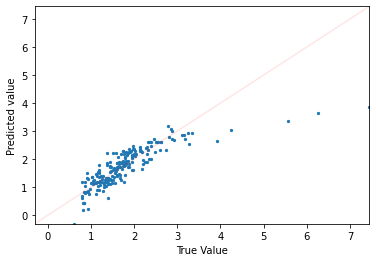

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


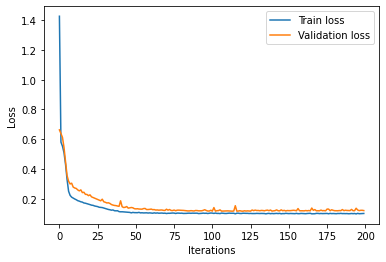

The loss on validation set is: 0.12019727379083633


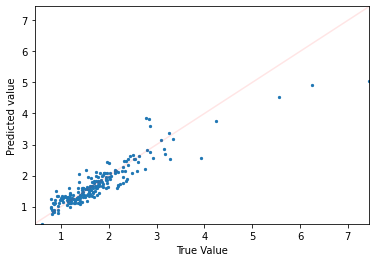

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


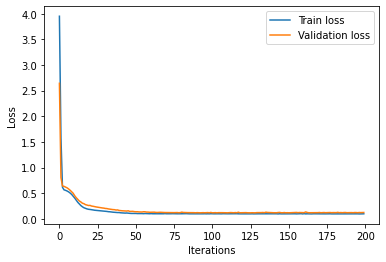

The loss on validation set is: 0.12585127353668213


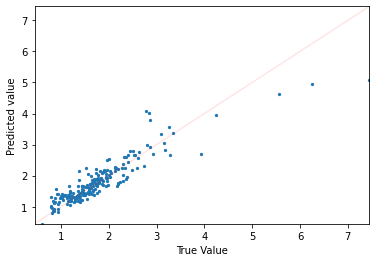

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


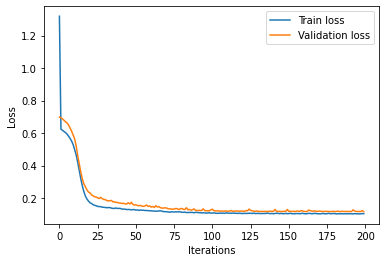

The loss on validation set is: 0.11664557456970215


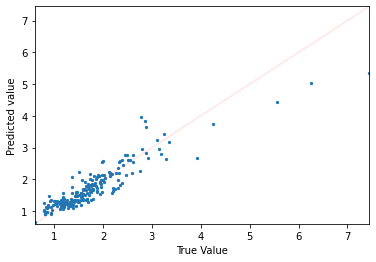

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


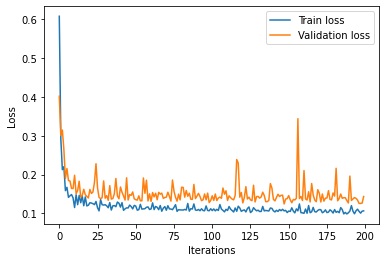

The loss on validation set is: 0.14363372325897217


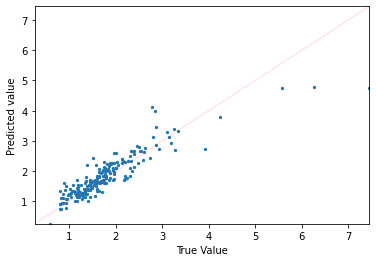

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


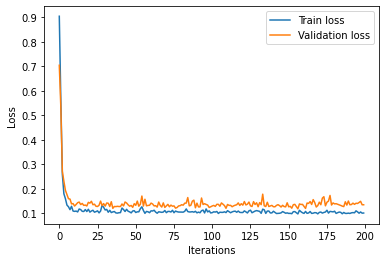

The loss on validation set is: 0.13514980673789978


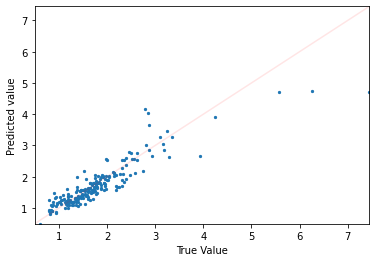

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


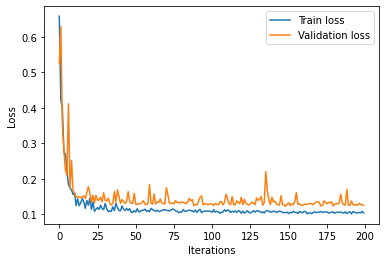

The loss on validation set is: 0.12490939348936081


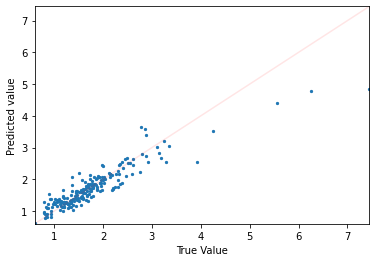

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


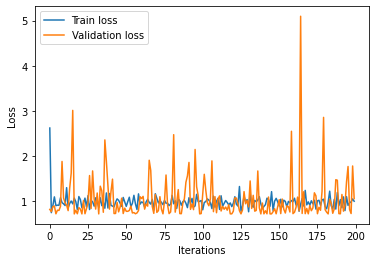

The loss on validation set is: 1.0568803548812866


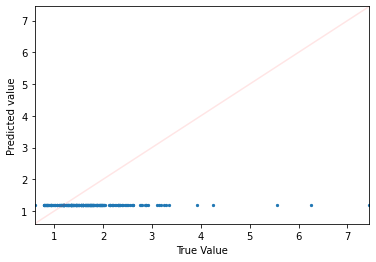

TRAINING WITH [10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


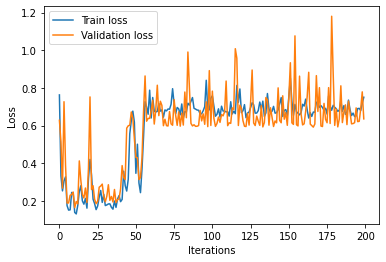

The loss on validation set is: 0.6357743740081787


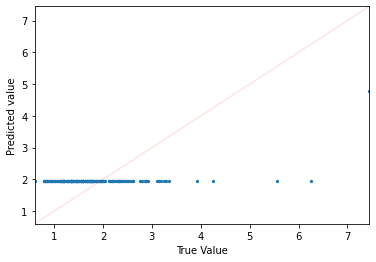

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


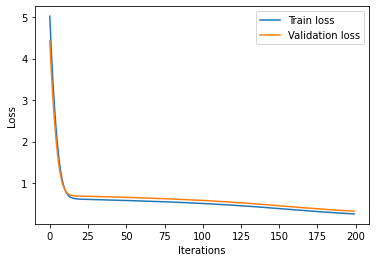

The loss on validation set is: 0.3208477795124054


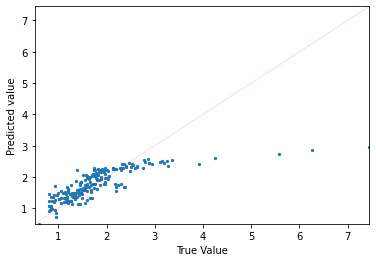

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


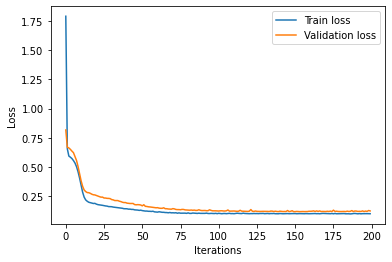

The loss on validation set is: 0.12385821342468262


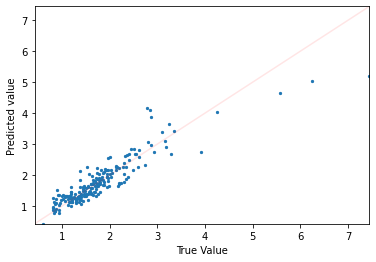

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


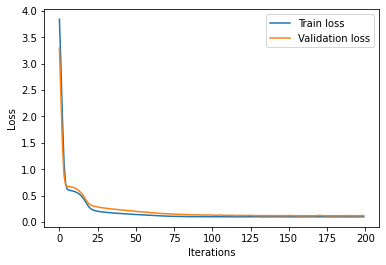

The loss on validation set is: 0.12289715558290482


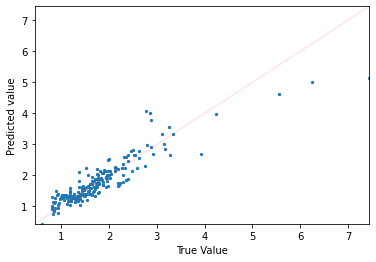

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


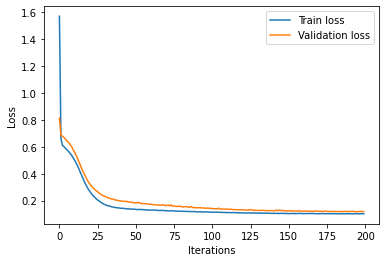

The loss on validation set is: 0.1192004606127739


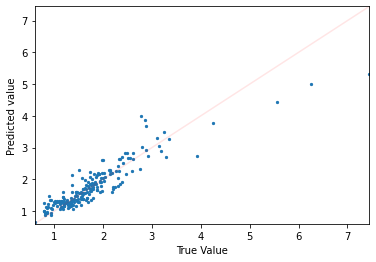

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


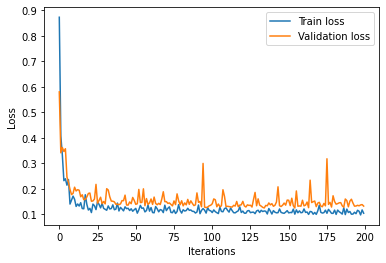

The loss on validation set is: 0.13192859292030334


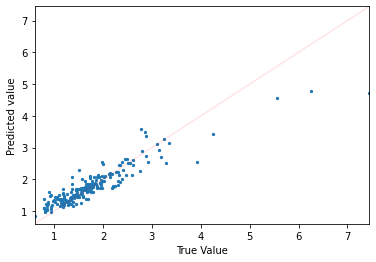

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


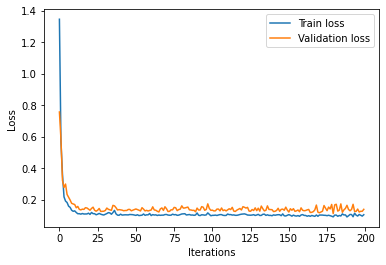

The loss on validation set is: 0.13801001012325287


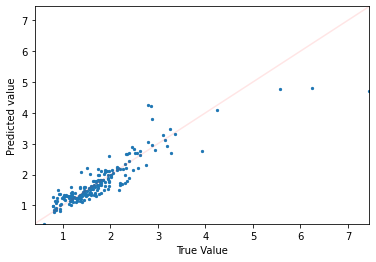

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


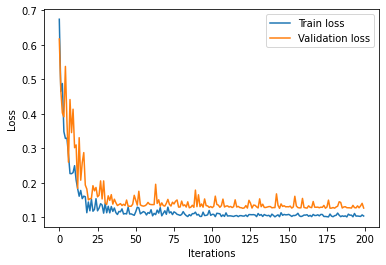

The loss on validation set is: 0.12722742557525635


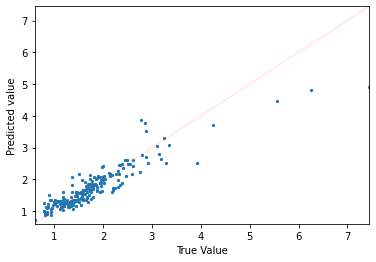

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


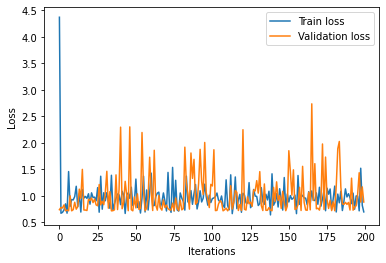

The loss on validation set is: 0.8837659955024719


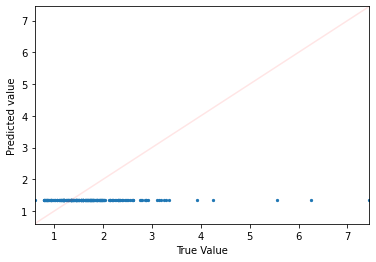

TRAINING WITH [10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


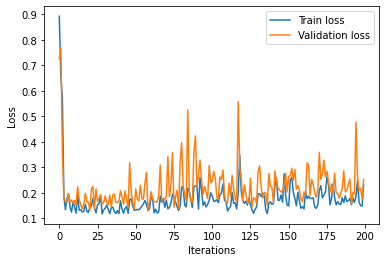

The loss on validation set is: 0.25208431482315063


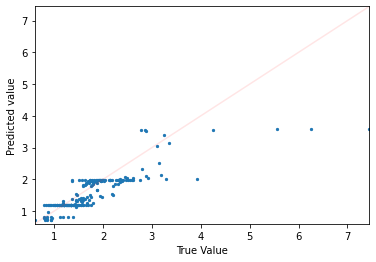

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


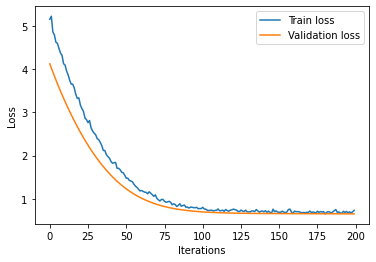

The loss on validation set is: 0.6489851474761963


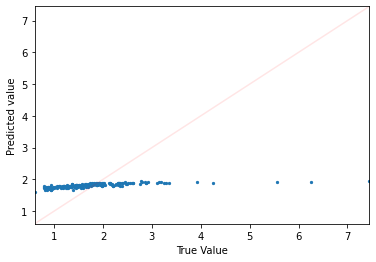

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


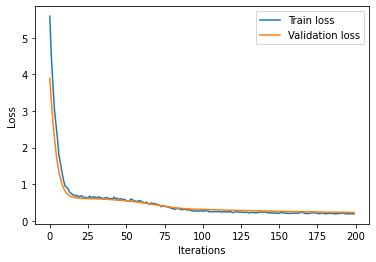

The loss on validation set is: 0.22657199203968048


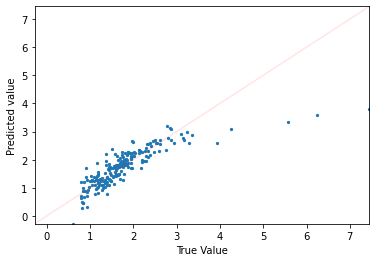

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


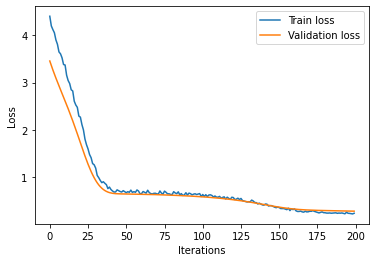

The loss on validation set is: 0.28860047459602356


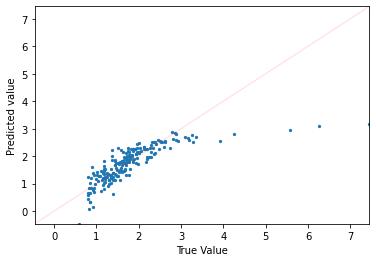

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


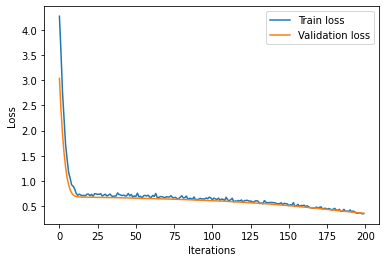

The loss on validation set is: 0.3614403009414673


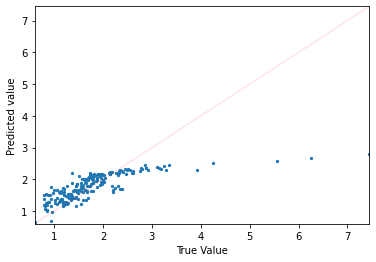

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


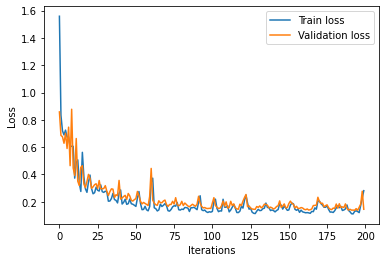

The loss on validation set is: 0.14540982246398926


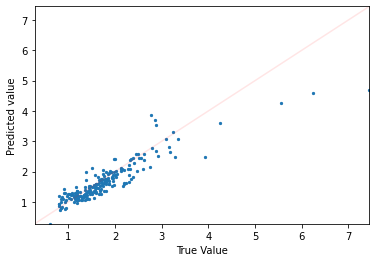

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


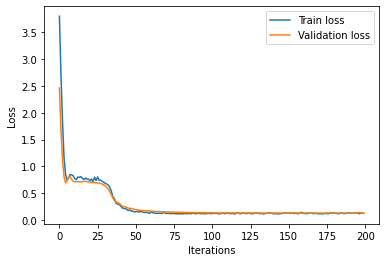

The loss on validation set is: 0.12421392649412155


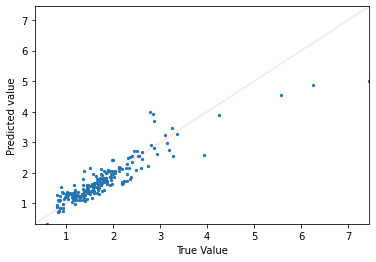

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


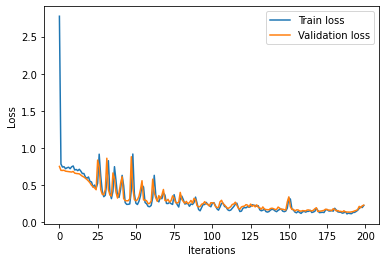

The loss on validation set is: 0.23251834511756897


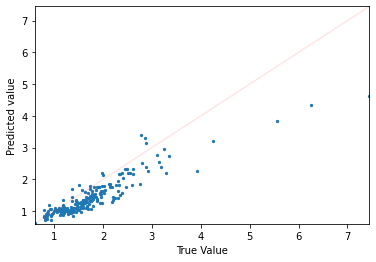

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


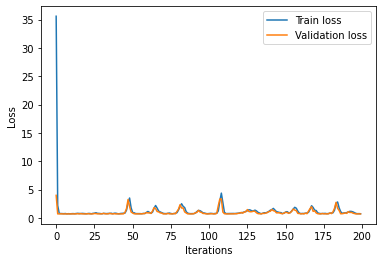

The loss on validation set is: 0.719912588596344


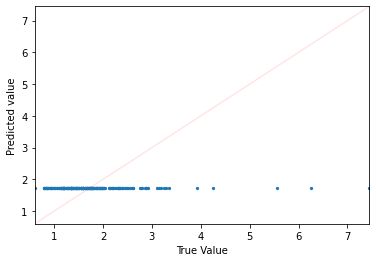

TRAINING WITH [10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


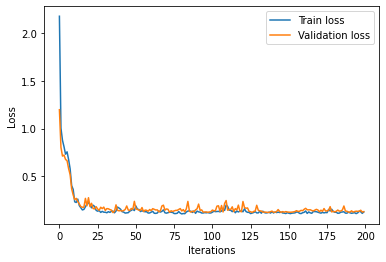

The loss on validation set is: 0.13102461397647858


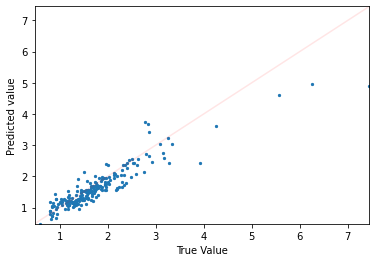

 92%|█████████▏| 12/13 [1:04:14<05:46, 346.38s/it]

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : SGD


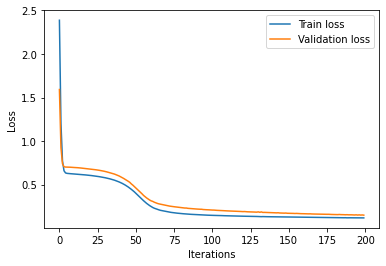

The loss on validation set is: 0.14906907081604004


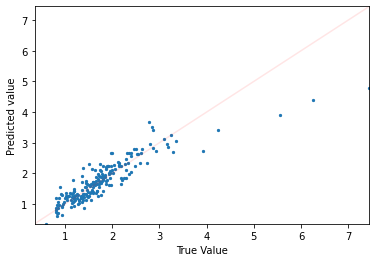

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


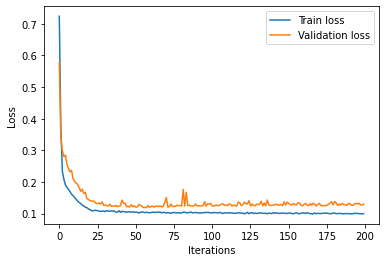

The loss on validation set is: 0.12926433980464935


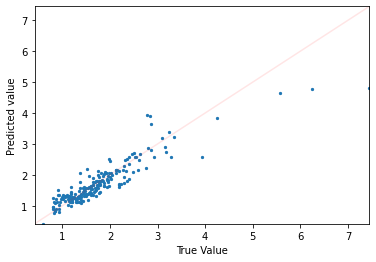

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


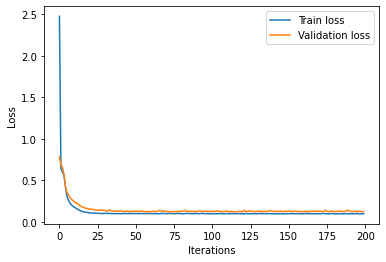

The loss on validation set is: 0.1270166039466858


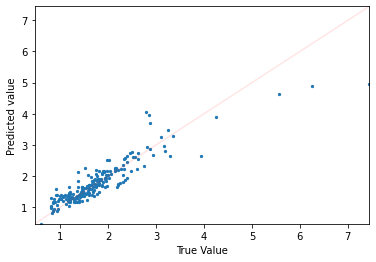

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : SGD


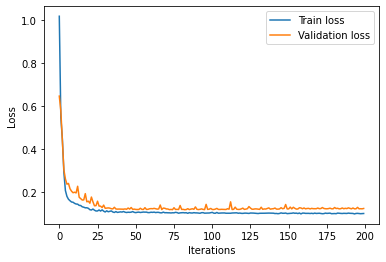

The loss on validation set is: 0.12405353784561157


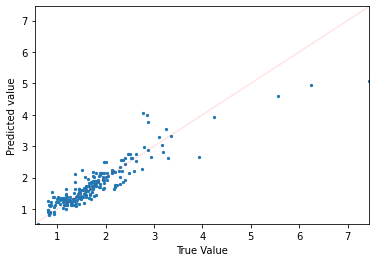

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


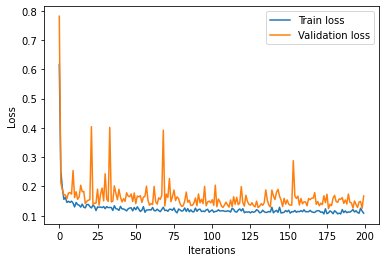

The loss on validation set is: 0.16716428101062775


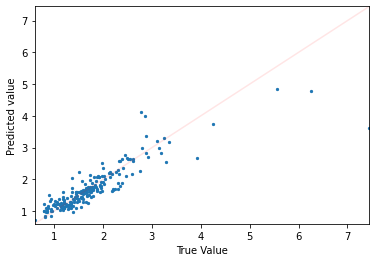

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


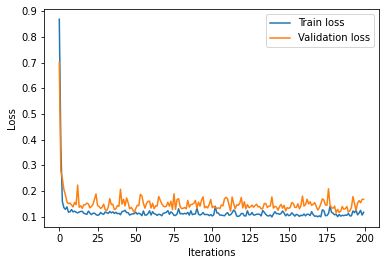

The loss on validation set is: 0.16797809302806854


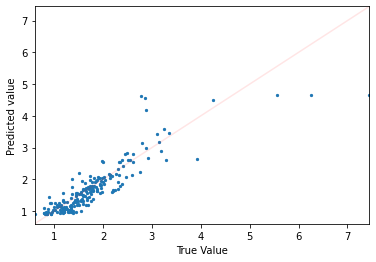

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : SGD


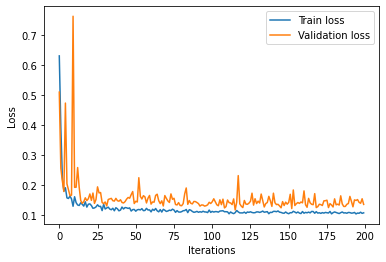

The loss on validation set is: 0.13600674271583557


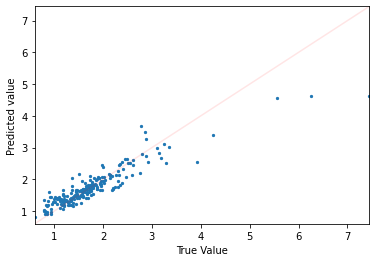

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : RMSprop


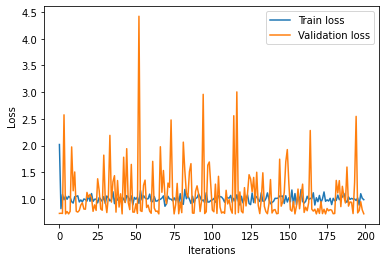

The loss on validation set is: 0.720643937587738


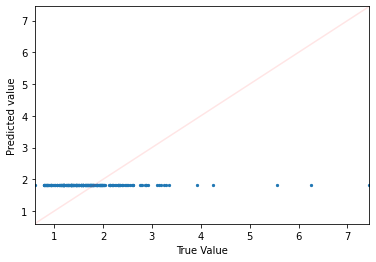

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 10, learning_rate : 0.1, optimizer : ADAM


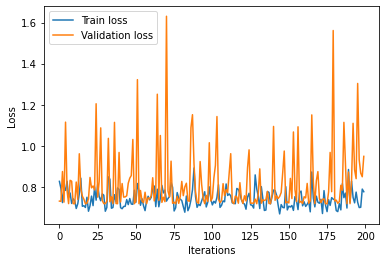

The loss on validation set is: 0.9483795762062073


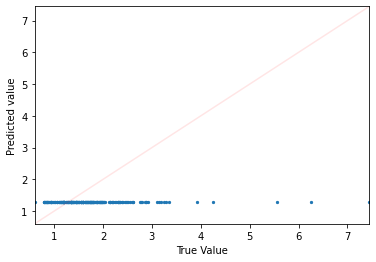

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : SGD


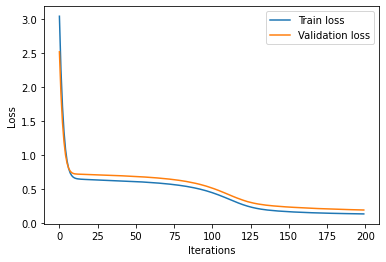

The loss on validation set is: 0.19073079526424408


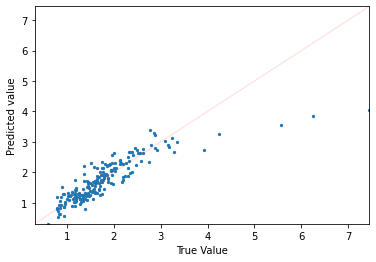

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


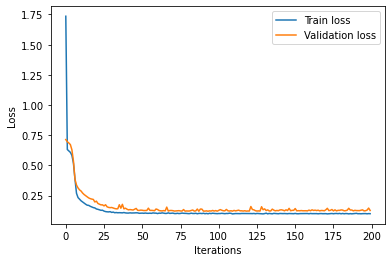

The loss on validation set is: 0.12709639966487885


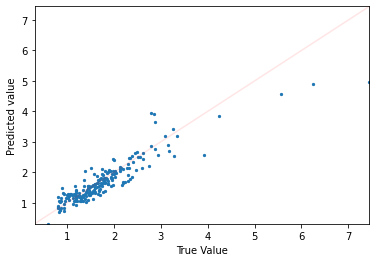

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


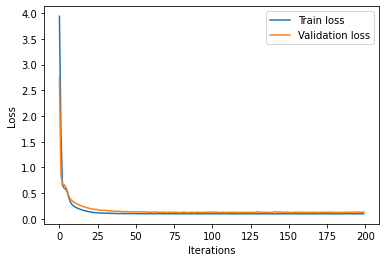

The loss on validation set is: 0.13441313803195953


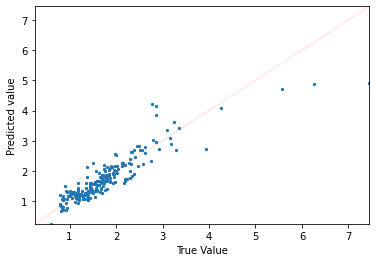

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : SGD


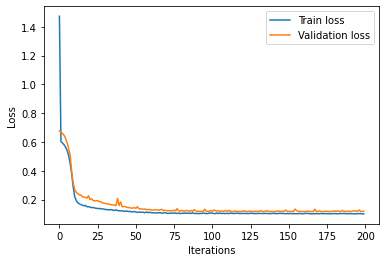

The loss on validation set is: 0.11971547454595566


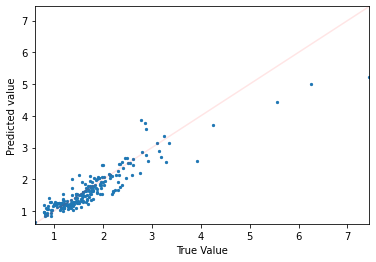

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


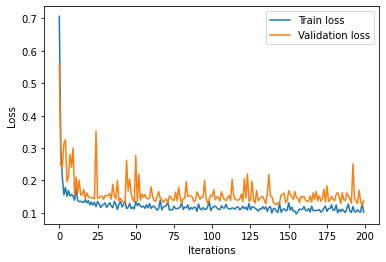

The loss on validation set is: 0.13852199912071228


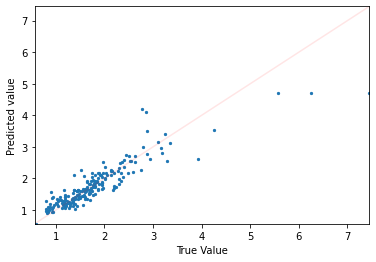

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


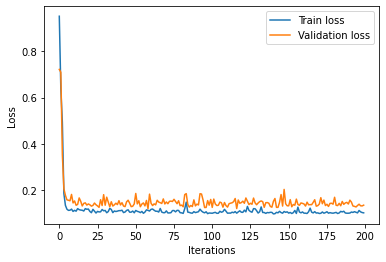

The loss on validation set is: 0.1350390762090683


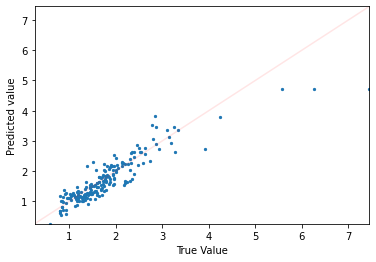

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : SGD


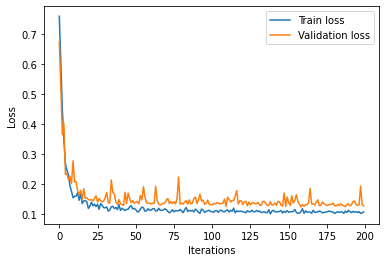

The loss on validation set is: 0.1285141110420227


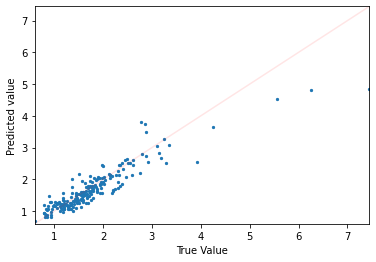

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : RMSprop


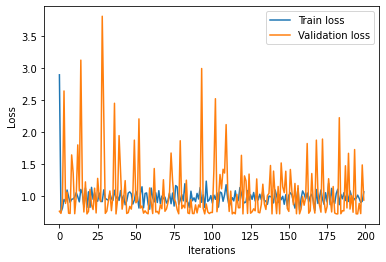

The loss on validation set is: 0.935361385345459


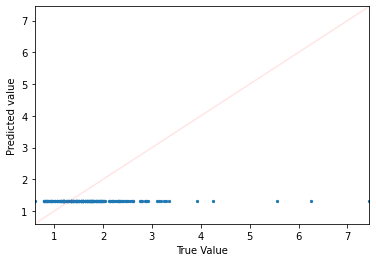

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 20, learning_rate : 0.1, optimizer : ADAM


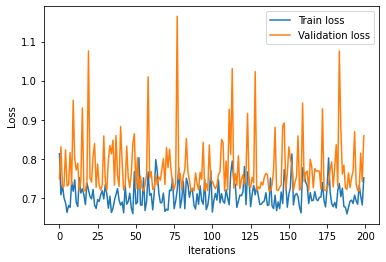

The loss on validation set is: 0.8591030836105347


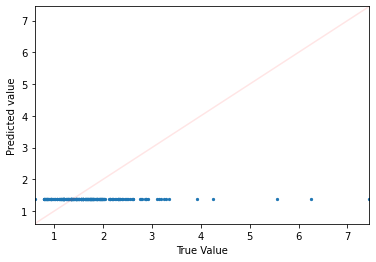

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : SGD


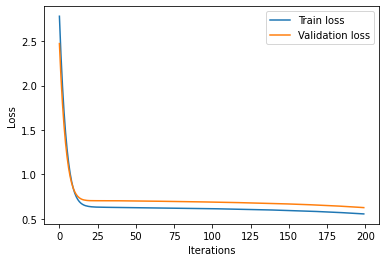

The loss on validation set is: 0.6257787942886353


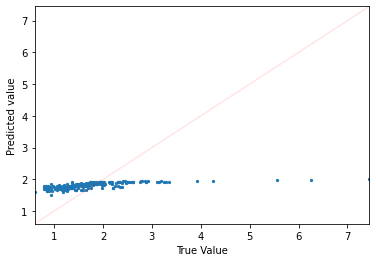

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : RMSprop


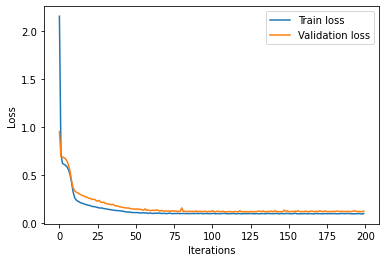

The loss on validation set is: 0.12643268704414368


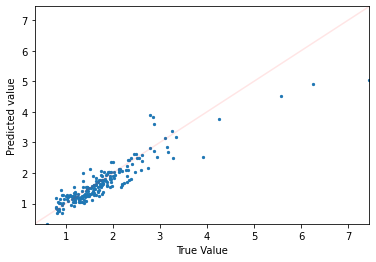

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.001, optimizer : ADAM


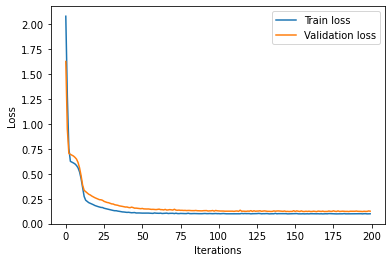

The loss on validation set is: 0.12444498389959335


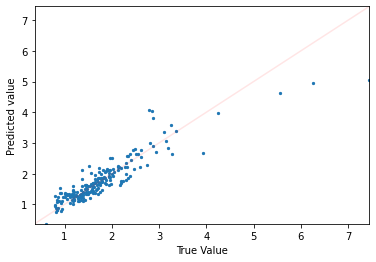

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : SGD


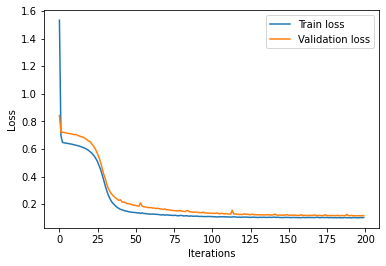

The loss on validation set is: 0.11686290800571442


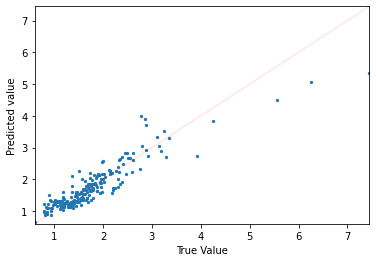

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : RMSprop


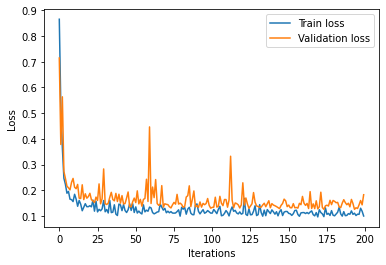

The loss on validation set is: 0.18272575736045837


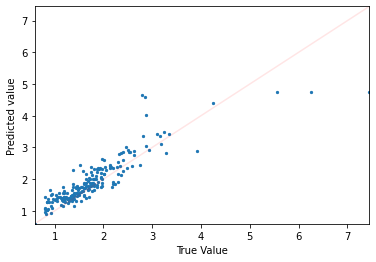

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.01, optimizer : ADAM


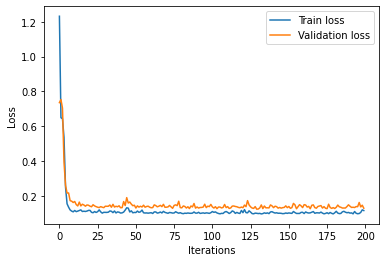

The loss on validation set is: 0.1279313713312149


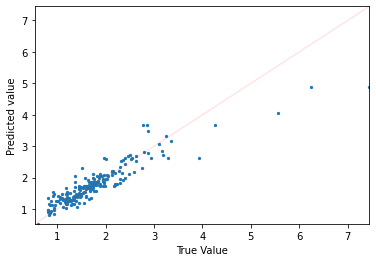

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : SGD


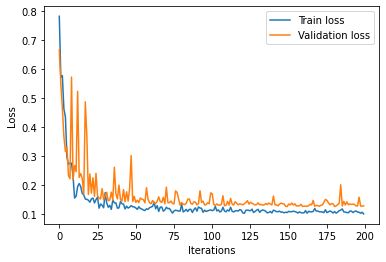

The loss on validation set is: 0.12718896567821503


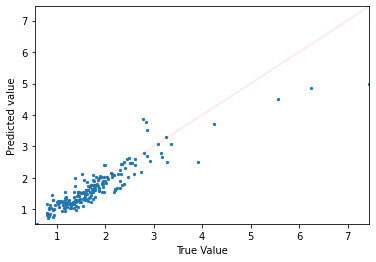

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : RMSprop


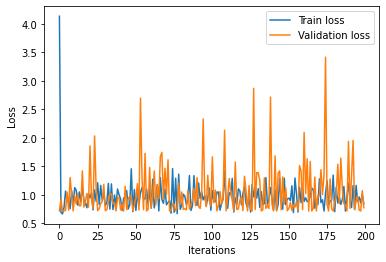

The loss on validation set is: 0.7755674123764038


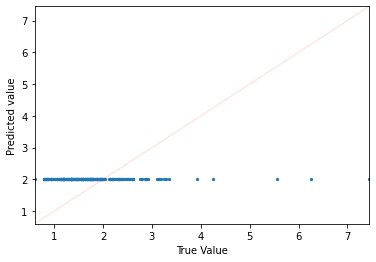

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 40, learning_rate : 0.1, optimizer : ADAM


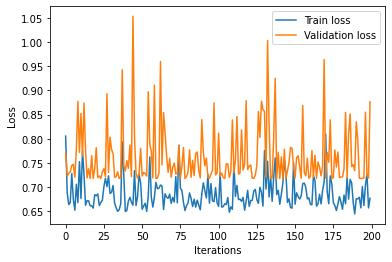

The loss on validation set is: 0.8761163949966431


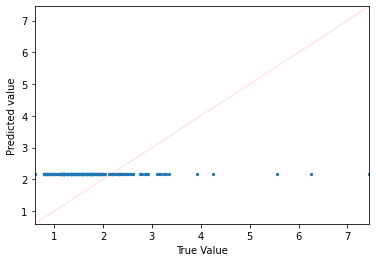

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : SGD


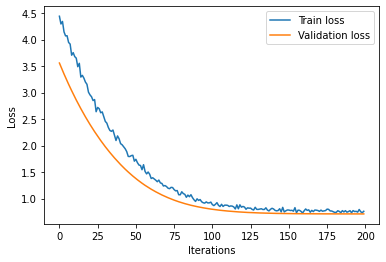

The loss on validation set is: 0.7115833163261414


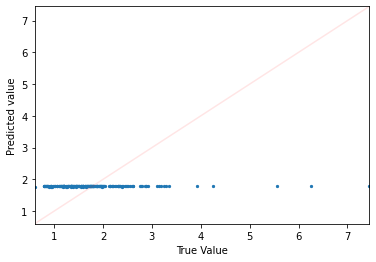

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : RMSprop


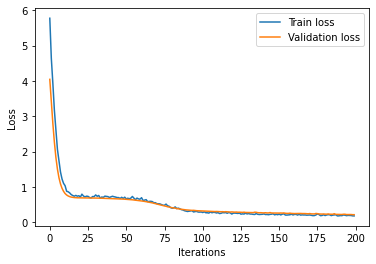

The loss on validation set is: 0.20857428014278412


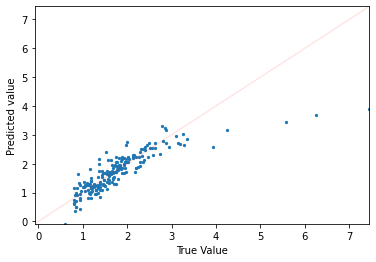

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.001, optimizer : ADAM


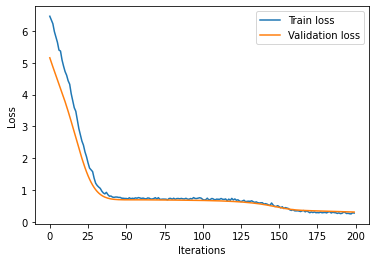

The loss on validation set is: 0.3123328685760498


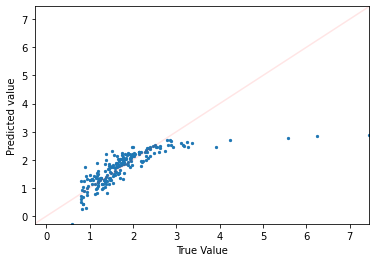

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : SGD


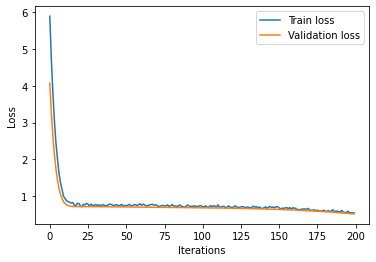

The loss on validation set is: 0.5165035724639893


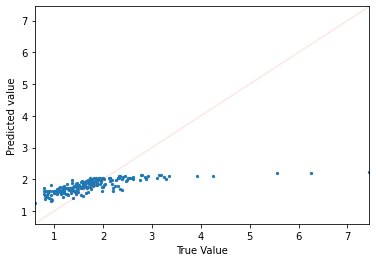

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : RMSprop


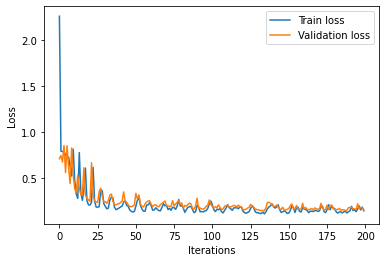

The loss on validation set is: 0.15844377875328064


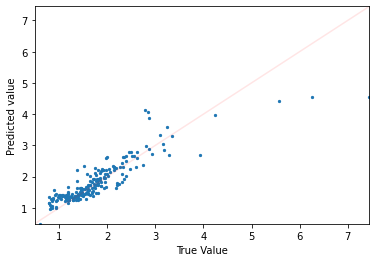

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.01, optimizer : ADAM


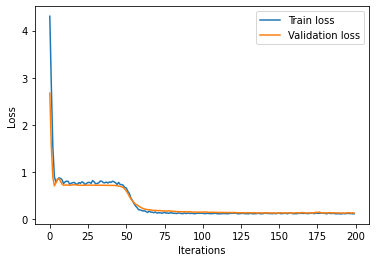

The loss on validation set is: 0.12585388123989105


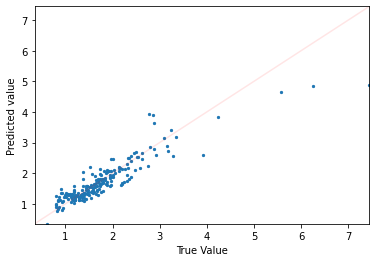

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : SGD


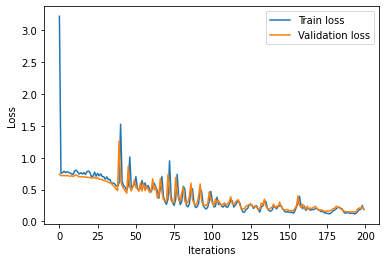

The loss on validation set is: 0.19227397441864014


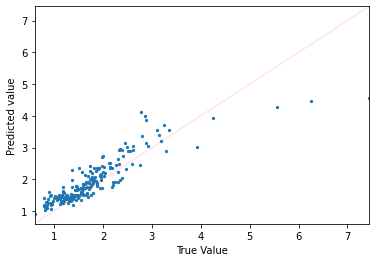

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : RMSprop


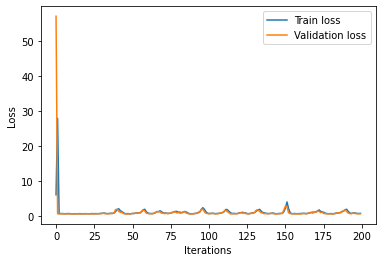

The loss on validation set is: 0.7750680446624756


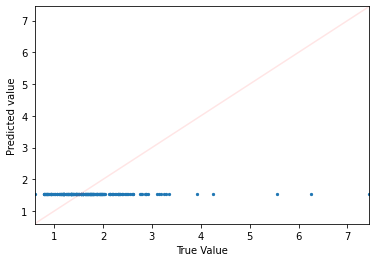

TRAINING WITH [10, 10, 10, 10, 1] and batchsize : 400, learning_rate : 0.1, optimizer : ADAM


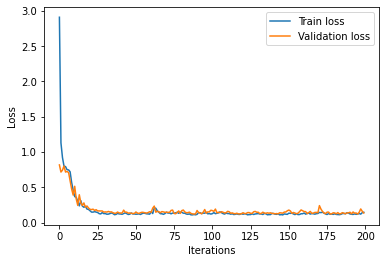

The loss on validation set is: 0.13532324135303497


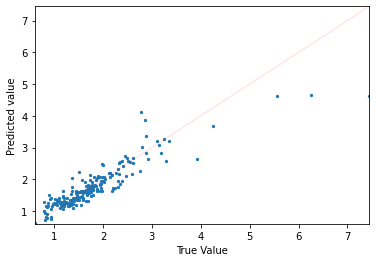

100%|██████████| 13/13 [1:11:06<00:00, 328.17s/it]


In [ ]:
# Define hyper-parameters:

batchsizes = [10,20,40,400]
lrs = [0.001,0.01,0.1]
opt = [torch.optim.SGD, torch.optim.RMSprop, torch.optim.Adam]
df = {
        'n_neurons': [],
        'batchsizes' : [],
        'learning_rate' : [],
        'optimizer' : [],
        'Val_loss': [],
        'activation': []
     }
from tqdm import tqdm

for n_neurons in tqdm(neurons_list):
  for bs in batchsizes:
    for lr in lrs:
      for o,n in zip(opt,['SGD', 'RMSprop', 'ADAM']):
        print(f'TRAINING WITH {str(n_neurons)} and batchsize : {bs}, learning_rate : {lr}, optimizer : {n}')
        model = Model(n_neurons, F.tanh)

        # Choose the hyperparameters for training: 
        num_epochs = 200
        batch_size = bs

        # Training criterion. This one is a mean squared error (MSE) loss between the output
        # of the network and the target label
        criterion = nn.MSELoss()

        # Use SGD optimizer with a learning rate of 0.01
        # It is initialized on our model
        optimizer = o(model.parameters(), lr=lr)

        train(num_epochs, batch_size, criterion, optimizer, model, train_set, verbose=0)

        e = eval(model, X_val, y_val)

        df['n_neurons'].append(str(n_neurons))
        df['batchsizes'].append(bs)
        df['learning_rate'].append(lr)
        df['optimizer'].append(n)
        df['Val_loss'].append(e)
        df['activation'].append('tanh')

In [1]:
# Define hyper-parameters:

batchsizes = [10,20,40,400]
lrs = [0.001,0.01,0.1]
opt = [torch.optim.SGD, torch.optim.RMSprop, torch.optim.Adam]

from tqdm import tqdm

for n_neurons in tqdm(neurons_list):
  for bs in batchsizes:
    for lr in lrs:
      for o,n in zip(opt,['SGD', 'RMSprop', 'ADAM']):
        print(f'TRAINING WITH {str(n_neurons)} and batchsize : {bs}, learning_rate : {lr}, optimizer : {n}')
        model = Model(n_neurons, F.relu)

        # Choose the hyperparameters for training: 
        num_epochs = 100
        batch_size = bs

        # Training criterion. This one is a mean squared error (MSE) loss between the output
        # of the network and the target label
        criterion = nn.MSELoss()

        # Use SGD optimizer with a learning rate of 0.01
        # It is initialized on our model
        optimizer = o(model.parameters(), lr=lr)

        train(num_epochs, batch_size, criterion, optimizer, model, train_set, verbose=0)

        e = eval(model, X_val, y_val)

        df['n_neurons'].append(str(n_neurons))
        df['batchsizes'].append(bs)
        df['learning_rate'].append(lr)
        df['optimizer'].append(n)
        df['Val_loss'].append(e)
        df['activation'].append('relu')

NameError: ignored

In [ ]:
df = pd.DataFrame(df)
df.sort_values(by = ['Val_loss'])
df['Val_loss'] = np.clip(df['Val_loss'],0,0.5)

df.sample(10)

,n_neurons,batchsizes,learning_rate,optimizer,Val_loss,activation
191,"[4, 2, 2, 1]",20,0.001,ADAM,0.132891,tanh
6,"[2, 1]",10,0.100,SGD,0.122784,tanh
934,"[10, 10, 10, 10, 1]",400,0.100,RMSprop,0.500000,relu
623,"[4, 2, 1]",20,0.001,ADAM,0.153694,relu
760,"[10, 1]",10,0.010,RMSprop,0.100556,relu
243,"[4, 2, 4, 1]",400,0.001,SGD,0.500000,tanh
308,"[10, 1]",40,0.001,ADAM,0.176300,tanh
213,"[4, 2, 2, 1]",400,0.100,SGD,0.208099,tanh
838,"[10, 10, 1]",20,0.001,RMSprop,0.121011,relu
32,"[2, 1]",400,0.010,ADAM,0.198506,tanh


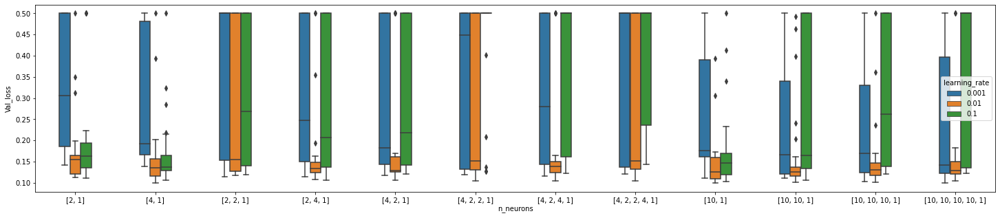

In [ ]:
fig = plt.figure(figsize=(25,5))

sns.boxplot(data = df, x='n_neurons',y='Val_loss', hue='learning_rate', width=.4)

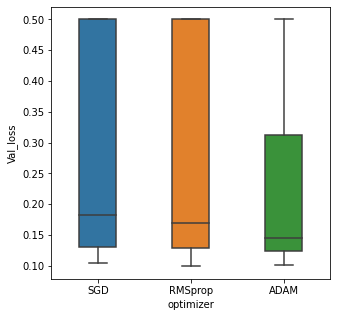

In [ ]:
fig = plt.figure(figsize=(5,5))

sns.boxplot(data = df[df.learning_rate <1], x='optimizer',y='Val_loss', width=.4)

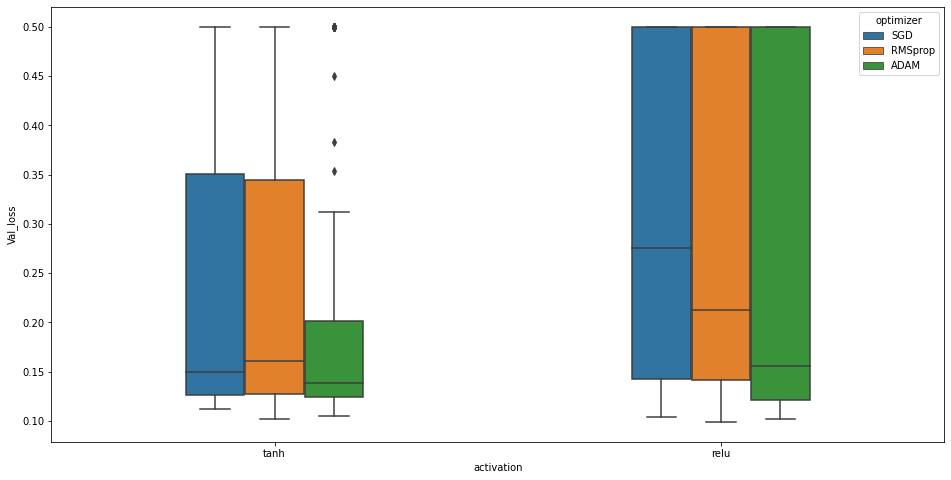

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df[df.learning_rate <1], x='activation',y='Val_loss', hue='optimizer', width=.4)

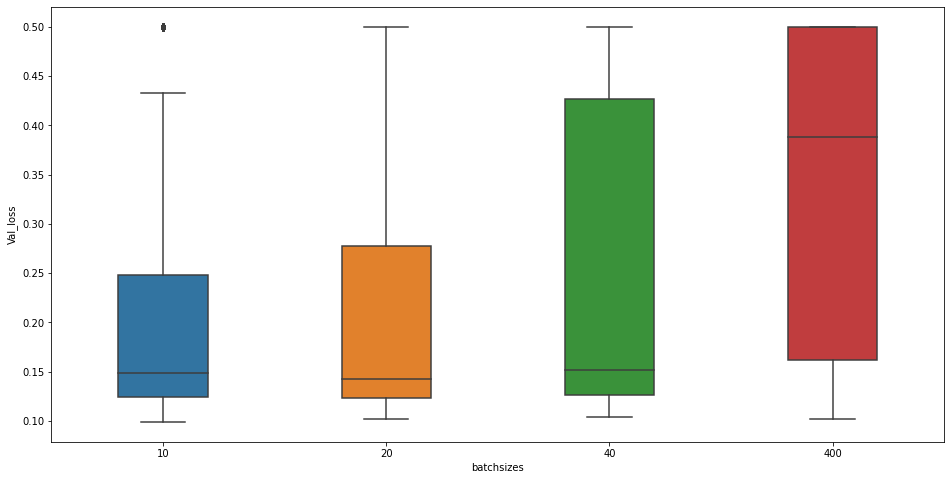

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df[df.learning_rate <1], x='batchsizes',y='Val_loss', width=.4)

In [ ]:
df[df.Val_loss <= np.min(df.Val_loss)*1.03]

,n_neurons,batchsizes,learning_rate,optimizer,Val_loss,activation
508,"[4, 1]",10,0.010,RMSprop,0.099623,relu
760,"[10, 1]",10,0.010,RMSprop,0.100556,relu
901,"[10, 10, 10, 10, 1]",10,0.001,RMSprop,0.099044,relu


### Exercise 3: Impact of the loss function
As mensioned before in the first problem (binary classification), one can minimize the negative of log-likelihood of the probability for all samples $x$: $$ \sum_{(x,y) \,\in\, \text{Dataset}} - \log p(y | x) $$ If we define $p(y_i | x_i) = \frac{1}{\sqrt{2\pi}}e^{-\frac{(y_i - f(x_i))^2}{2}}$, then the loss function becomes the mean squared error. 

There is another loss function worth to try: the Gaussian likelihood loss function. 
Rather than predicting a single value $y$ given $x$, we predict a probability distribution over possible answers, which helps dealing with ambiguous cases and expressing uncertainty. To do this, for each possible input $x$, the network will output the parameters of the distribution modeling $p(y|x)$. For instance in our case, we choose to model output distributions with Gaussian distributions $\mathcal{N}(\mu, \sigma)$, which are parameterized by their mean $\mu$ and their standard deviation $\sigma$. Therefore for each input $x$ we have to output two quantities: $\mu(x)$ and $\sigma(x)$. The probability becomes: $$p(y_i | x_i) = \frac{1}{\sqrt{2\pi \sigma(x_i)^2}}e^{-\frac{(y_i - \mu(x_i))^2}{2\sigma(x_i)^2}}$$ Then the loss function becomes: $$L =\sum\limits_{i=1}^{N}  \frac{1}{2} \log ( 2\pi\sigma_i^{2} ) + \frac{1}{2\sigma_i^{2}}  (y_{i} - \mu_i)^{2}$$ If we set $\sigma=1$, we obtain MSE the loss function. 

* Try to replace the loss function with this one, and compare the differences between the two losses.
 
* **Hints**: 
    * You need two outputs of your network, one represents the $\mu(x_i)$, another for $\log( \sigma(x_i)^2 )$ (better for optimization) 
    * Try deeper models, or you will not predict the variance $\sigma$ well. 


In [ ]:
class Model(nn.Module):
    
    def __init__(self,n_neurons, act=F.relu):
        super(Model, self).__init__()
        self.act = act
        self.linears = nn.ModuleList([nn.Linear(4, n_neurons[0])])
        self.linears.extend([nn.Linear(n_neurons[i-1], n_neurons[i]) for i in range(1,len(n_neurons))])
        
    def forward(self, inputs):
        h = inputs
        for i in range(len(self.linears)-1):
          h = self.act(self.linears[i](h))
        h = (self.linears[-1](h))
        return h



def train(num_epochs, batch_size, criterion, optimizer, model, dataset, verbose=1):
    dataloader = DataLoader(dataset, batch_size, shuffle=True)
    model.train()
    train_l = []
    val_l = []
    for epoch in range(num_epochs):
        epoch_average_loss = 0.0
        for (X, y) in (dataloader):
            #print(model(X))
            y_pre = model(X).view(-1,2)
            loss = criterion(y_pre[:,0], y, torch.exp(y_pre[:,1]))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            epoch_average_loss += loss.item() * batch_size / len(train_set)
            
        if ((epoch+1)%1 == 0):
                with torch.no_grad():
                    y_pre_val = model(torch.from_numpy(np.array(X_val)).float()).view(-1,2)
                error = criterion(y_pre_val[:,0], torch.tensor(np.array(y_val)).float(), torch.exp(y_pre_val[:,1])).item()
                train_l.append(epoch_average_loss)
                val_l.append(error)
                if verbose:
                  print('Epoch [{}/{}], Loss_error: {:.4f}, Val error : {}'
                        .format(epoch+1, num_epochs,  epoch_average_loss, error))
    plt.plot(train_l, label='Train loss')
    plt.plot(val_l, label='Validation loss')
    plt.legend()
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.show()


def eval(model, X_val, y_val,criterion):
  with torch.no_grad():
      y_pre_val = model(torch.from_numpy(np.array(X_val)).float()).view(-1,2)
  error = criterion(y_pre_val[:,0], torch.tensor(np.array(y_val)), torch.exp(y_pre_val[:,1])).float().item()

  var= y_pre_val.numpy()[:,1]
  y_pre_val = y_pre_val.numpy()[:,0]


  plt.scatter(y_val,y_pre_val, s=5)

  m =  min(np.min(y_val), np.min(y_pre_val))
  M = max(np.max(y_val), np.max(y_pre_val))

  for i in range(var.shape[0]):
      plt.plot(
          [y_val.iloc[i], y_val.iloc[i]],
          [y_pre_val[i] - np.exp(var[i]) * 2, y_pre_val[i] + np.exp(var[i]) * 2],
          color = 'b',
          alpha = 0.1
          )

  plt.plot(
      [m,M],
      [m,M],
      color = 'r',
      alpha=0.3
      )
  plt.xlim(m,M)
  plt.ylim(m,M)
  plt.xlabel('True Value')
  plt.ylabel('Predicted value')
  plt.show()


  print('The MSE on validation set is:', np.mean((y_pre_val-y_val)**2))
  print(f'The average variance on the validation set is : {np.mean(np.exp(var))}')

  return error

  0%|          | 0/9 [00:00<?, ?it/s]

TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


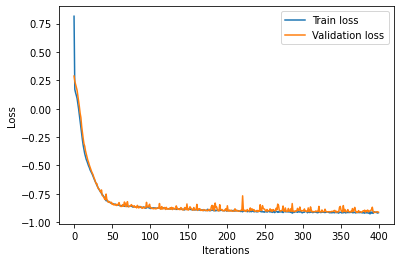

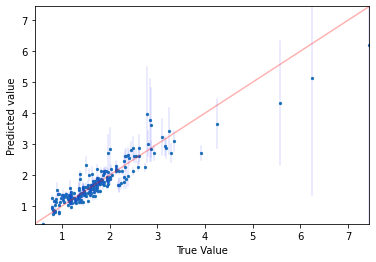

The MSE on validation set is: 0.10378959957651446
The average variance on the validation set is : 0.10850231349468231
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


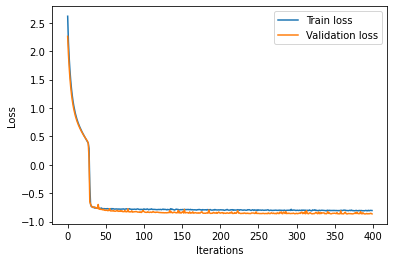

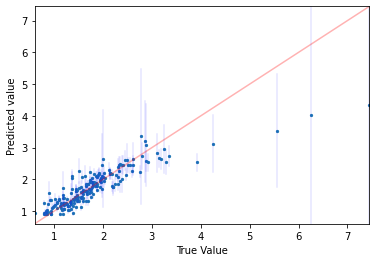

The MSE on validation set is: 0.17402507364694078
The average variance on the validation set is : 0.12360963970422745
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


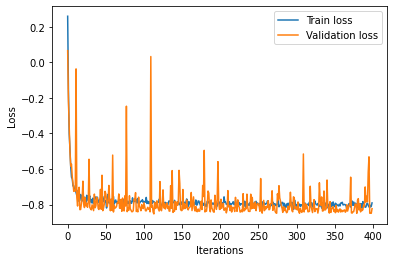

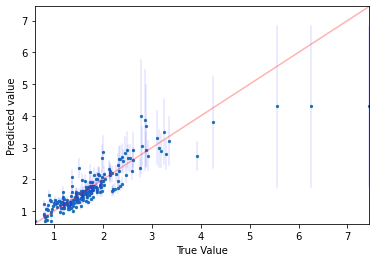

The MSE on validation set is: 0.16172202359492116
The average variance on the validation set is : 0.117149218916893
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


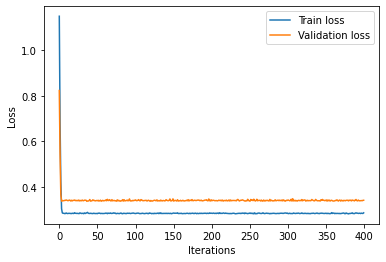

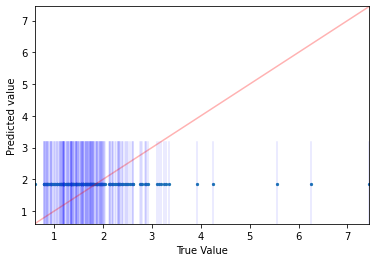

The MSE on validation set is: 0.7239861061259273
The average variance on the validation set is : 0.6617698073387146
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


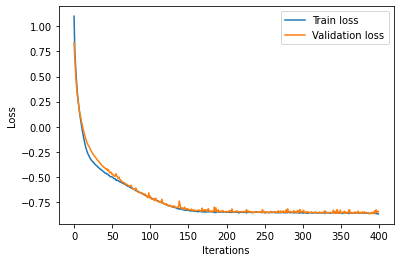

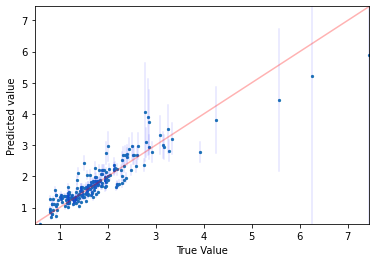

The MSE on validation set is: 0.11302647921196236
The average variance on the validation set is : 0.12654517590999603
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


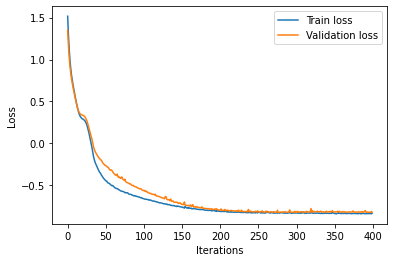

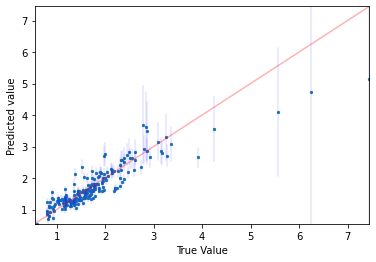

The MSE on validation set is: 0.12865160658527194
The average variance on the validation set is : 0.11421413719654083
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


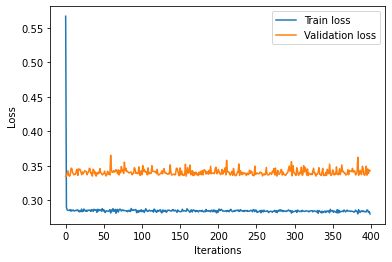

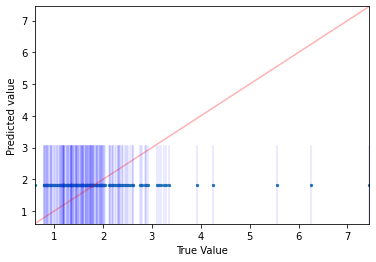

The MSE on validation set is: 0.720564453093375
The average variance on the validation set is : 0.6126747727394104
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


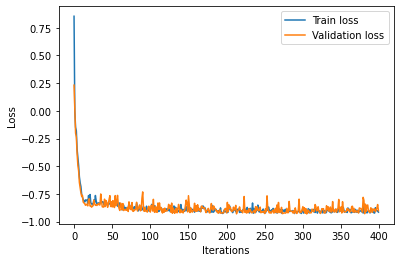

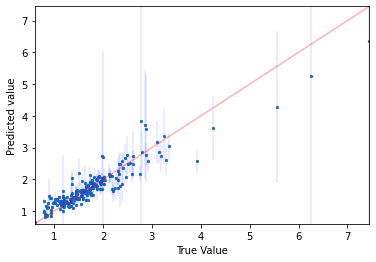

 11%|█         | 1/9 [05:09<41:18, 309.76s/it]

The MSE on validation set is: 0.10035354403673423
The average variance on the validation set is : 0.2042597532272339
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


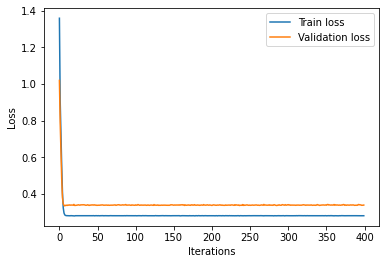

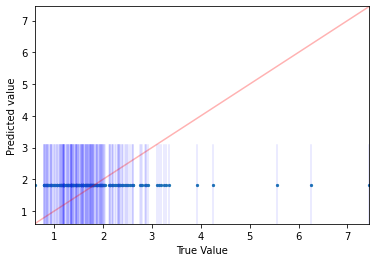

The MSE on validation set is: 0.7201514999819785
The average variance on the validation set is : 0.6358423829078674
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


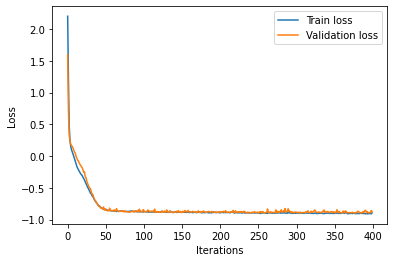

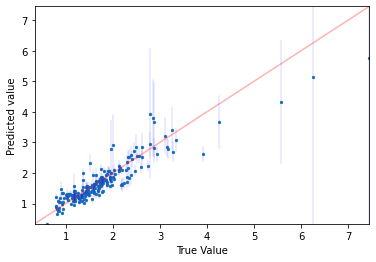

The MSE on validation set is: 0.11383191331430803
The average variance on the validation set is : 0.11454007774591446
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


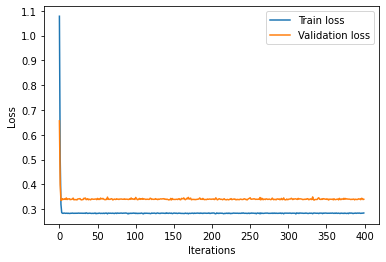

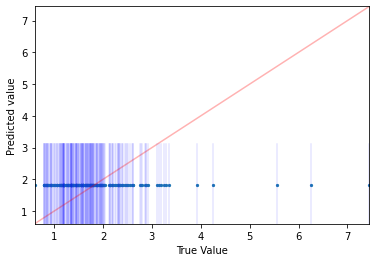

The MSE on validation set is: 0.7210022731616493
The average variance on the validation set is : 0.6471957564353943
TRAINING WITH [4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


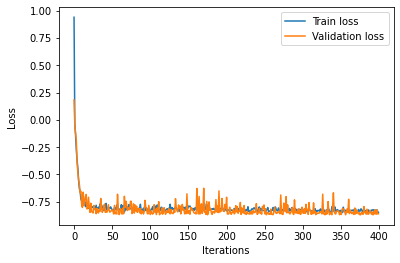

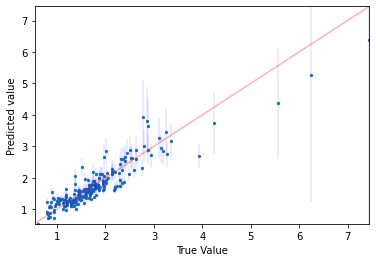

The MSE on validation set is: 0.10010783828879997
The average variance on the validation set is : 0.12704135477542877
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


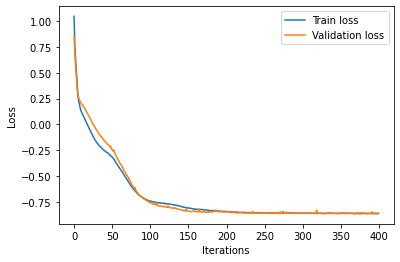

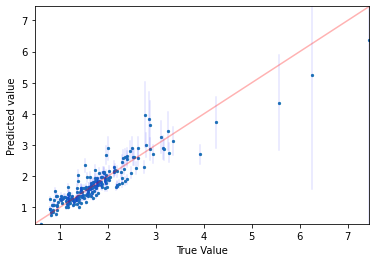

The MSE on validation set is: 0.10107274228012483
The average variance on the validation set is : 0.11318077147006989
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


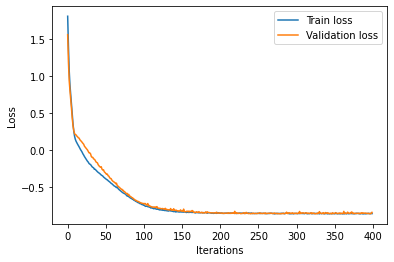

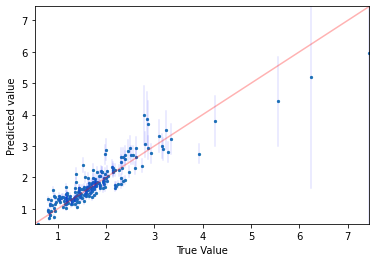

The MSE on validation set is: 0.1093678348282059
The average variance on the validation set is : 0.11758176982402802
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


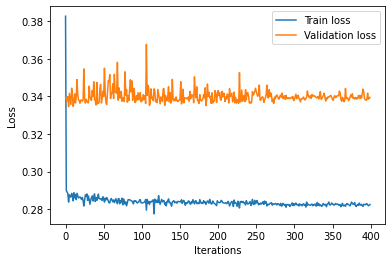

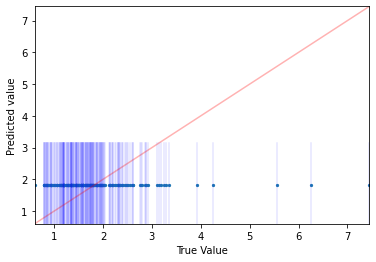

The MSE on validation set is: 0.7218803174913966
The average variance on the validation set is : 0.655417799949646
TRAINING WITH [4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


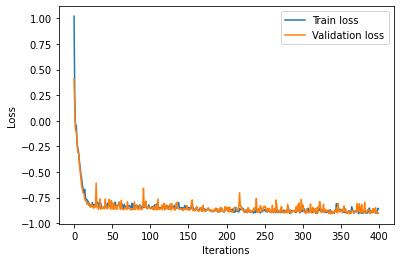

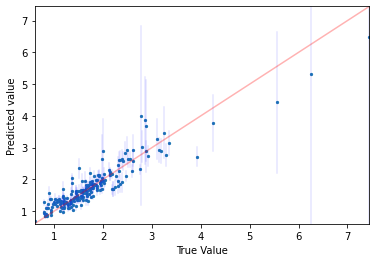

 22%|██▏       | 2/9 [10:23<36:23, 311.92s/it]

The MSE on validation set is: 0.09903238005745163
The average variance on the validation set is : 0.18058906495571136
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


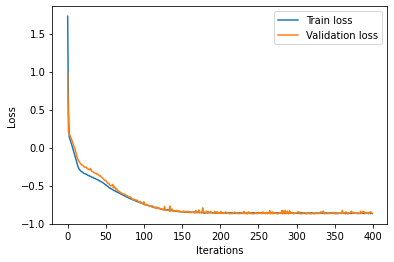

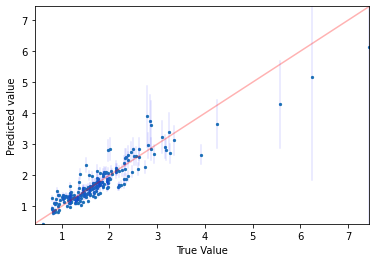

The MSE on validation set is: 0.10476711073609132
The average variance on the validation set is : 0.10481061041355133
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


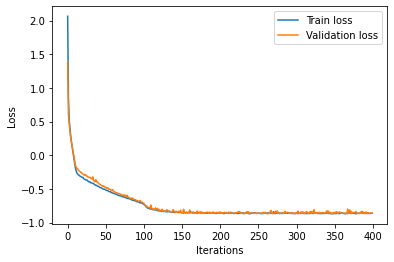

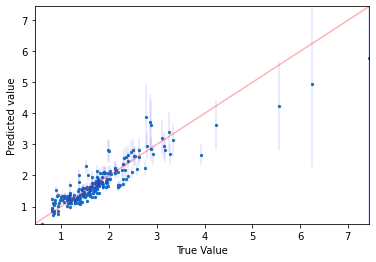

The MSE on validation set is: 0.11240297549626604
The average variance on the validation set is : 0.0964972972869873
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


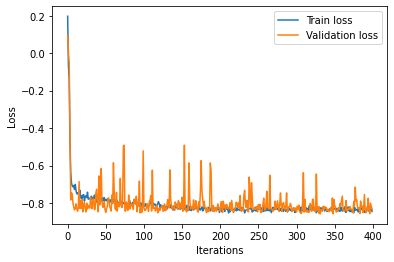

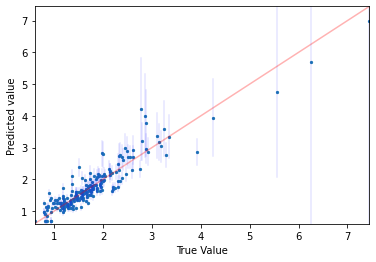

The MSE on validation set is: 0.09677190301750542
The average variance on the validation set is : 0.17591407895088196
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


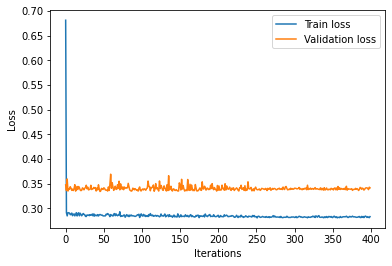

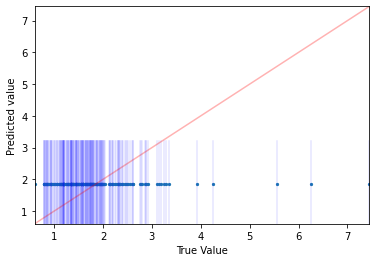

The MSE on validation set is: 0.7261597209331612
The average variance on the validation set is : 0.6690635681152344
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


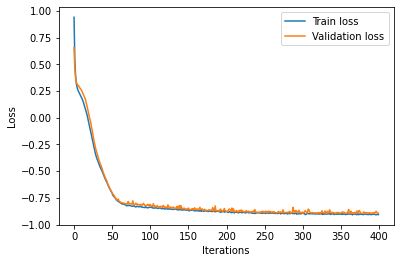

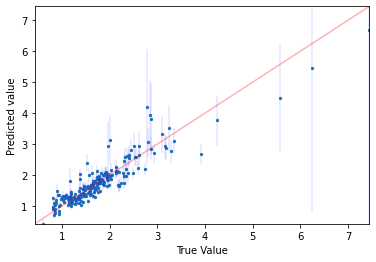

The MSE on validation set is: 0.10556874695249724
The average variance on the validation set is : 0.13399703800678253
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


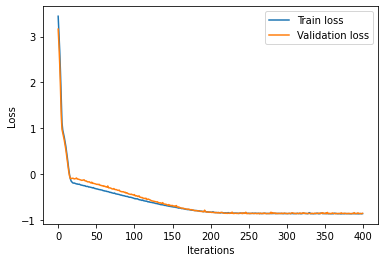

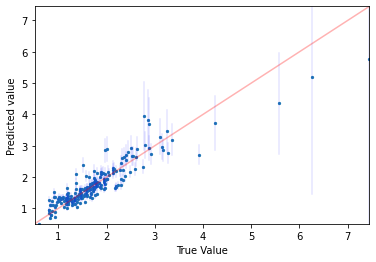

The MSE on validation set is: 0.11202282024665428
The average variance on the validation set is : 0.10438483953475952
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


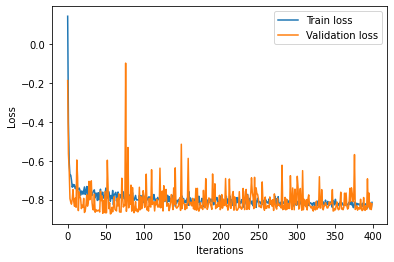

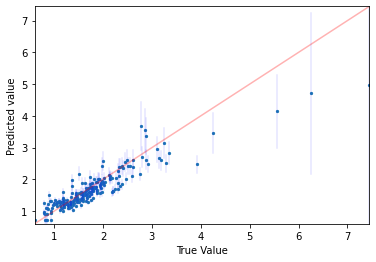

The MSE on validation set is: 0.13449555339351305
The average variance on the validation set is : 0.09387931227684021
TRAINING WITH [4, 4, 4, 4, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


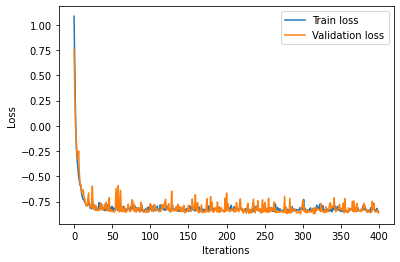

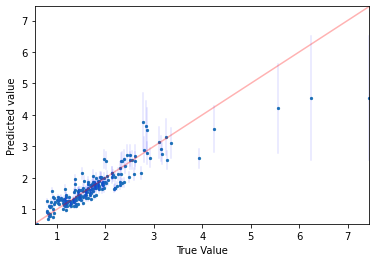

 33%|███▎      | 3/9 [16:11<32:49, 328.33s/it]

The MSE on validation set is: 0.14087382690768338
The average variance on the validation set is : 0.08414463698863983
TRAINING WITH [4, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


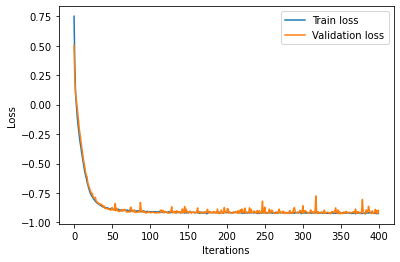

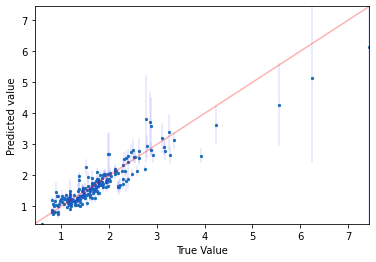

The MSE on validation set is: 0.1017804513562492
The average variance on the validation set is : 0.09650582075119019
TRAINING WITH [4, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


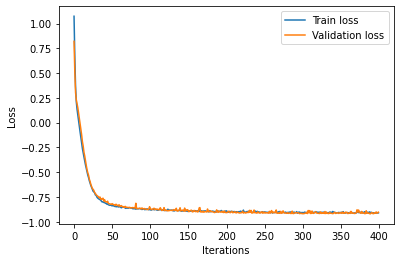

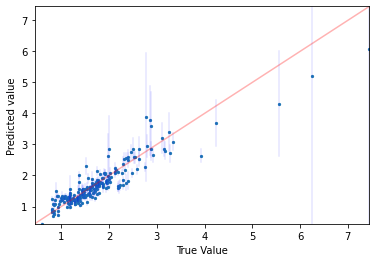

The MSE on validation set is: 0.10493685685025524
The average variance on the validation set is : 0.10893308371305466
TRAINING WITH [4, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


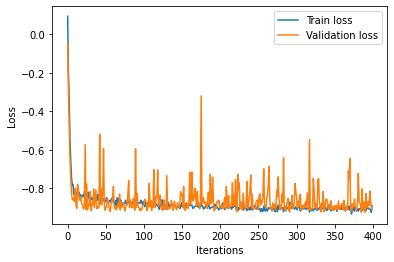

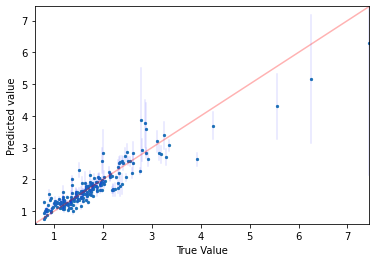

The MSE on validation set is: 0.09917666538270704
The average variance on the validation set is : 0.07940102368593216
TRAINING WITH [4, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


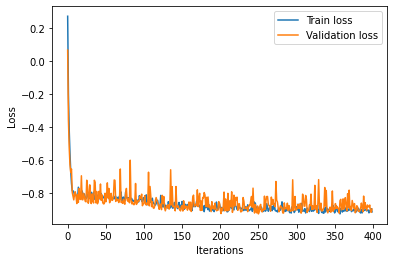

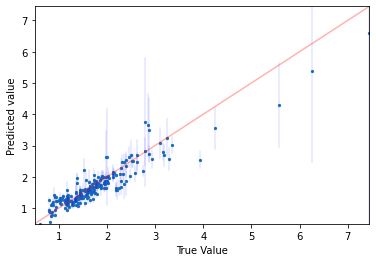

The MSE on validation set is: 0.09564051052365549
The average variance on the validation set is : 0.12121947109699249
TRAINING WITH [4, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


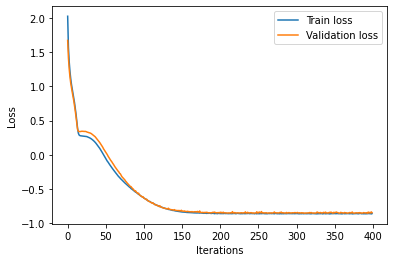

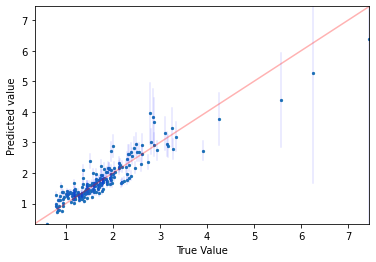

The MSE on validation set is: 0.10204124166837947
The average variance on the validation set is : 0.11457906663417816
TRAINING WITH [4, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


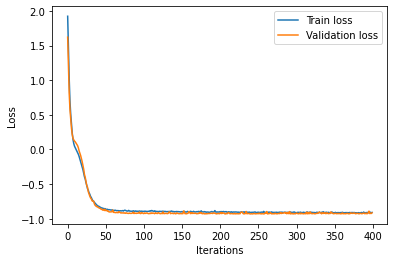

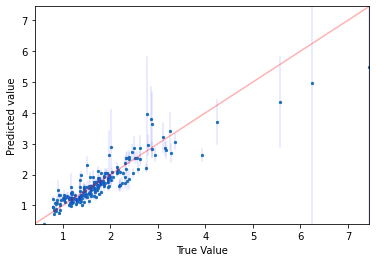

The MSE on validation set is: 0.1176753249645063
The average variance on the validation set is : 0.11376094818115234
TRAINING WITH [4, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


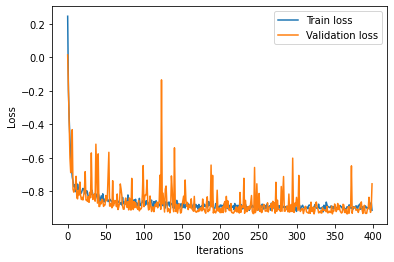

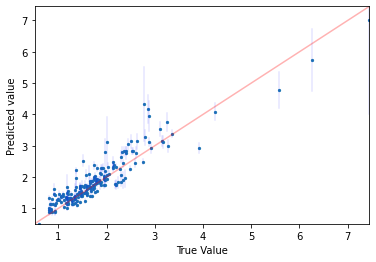

The MSE on validation set is: 0.11645836461892194
The average variance on the validation set is : 0.06403765827417374
TRAINING WITH [4, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


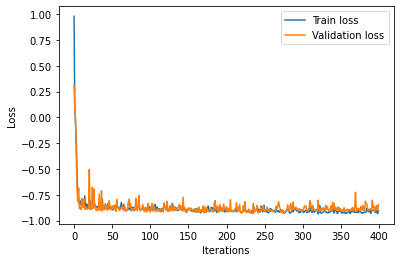

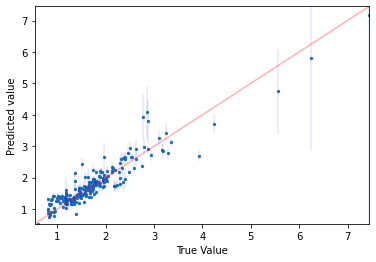

 44%|████▍     | 4/9 [20:49<25:43, 308.75s/it]

The MSE on validation set is: 0.08895349371669244
The average variance on the validation set is : 0.08007524162530899
TRAINING WITH [4, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


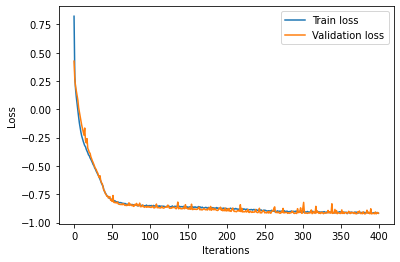

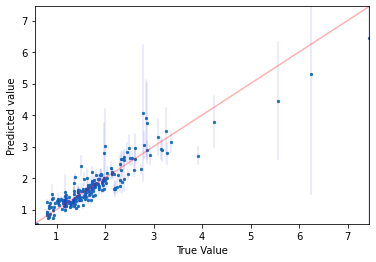

The MSE on validation set is: 0.10284050876504848
The average variance on the validation set is : 0.11919000744819641
TRAINING WITH [4, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


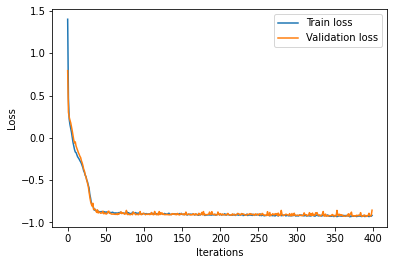

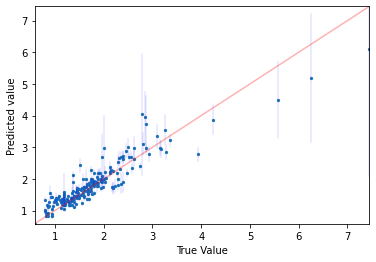

The MSE on validation set is: 0.110192547686281
The average variance on the validation set is : 0.08124158531427383
TRAINING WITH [4, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


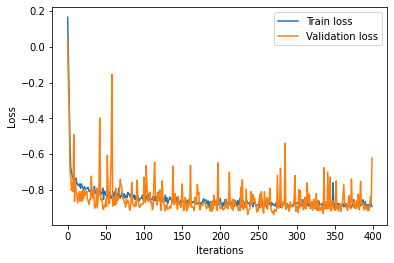

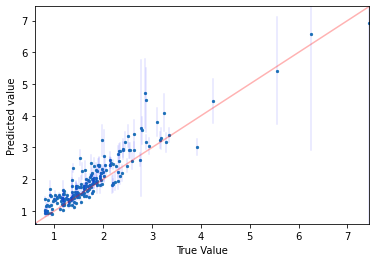

The MSE on validation set is: 0.15411334062626694
The average variance on the validation set is : 0.13070301711559296
TRAINING WITH [4, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


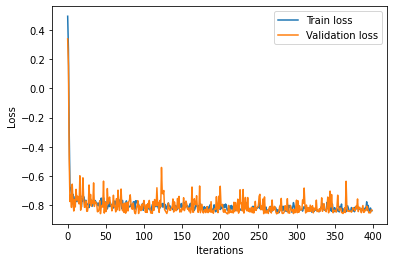

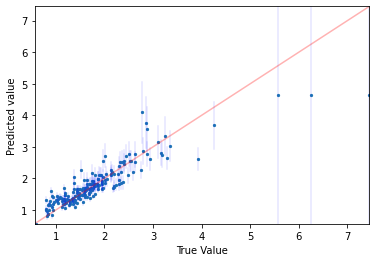

The MSE on validation set is: 0.13993002582618283
The average variance on the validation set is : 0.11708766222000122
TRAINING WITH [4, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


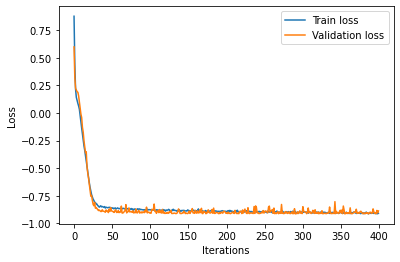

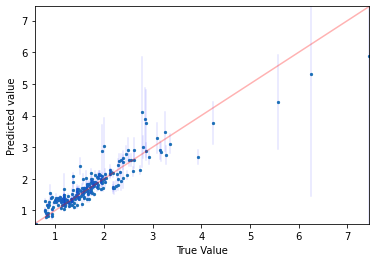

The MSE on validation set is: 0.11357234058055896
The average variance on the validation set is : 0.09767590463161469
TRAINING WITH [4, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


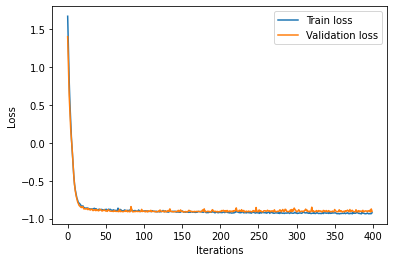

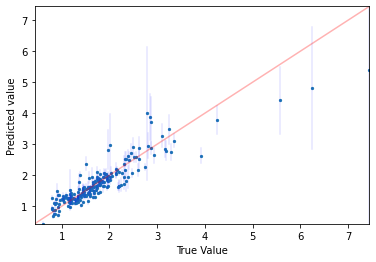

The MSE on validation set is: 0.12436924168620896
The average variance on the validation set is : 0.09138620644807816
TRAINING WITH [4, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


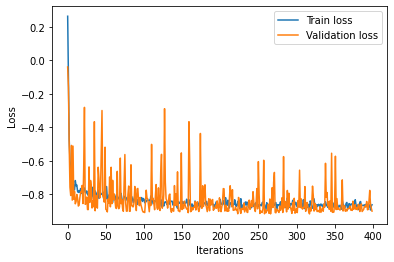

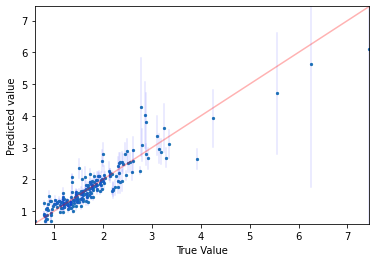

The MSE on validation set is: 0.10399176886546371
The average variance on the validation set is : 0.12634572386741638
TRAINING WITH [4, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


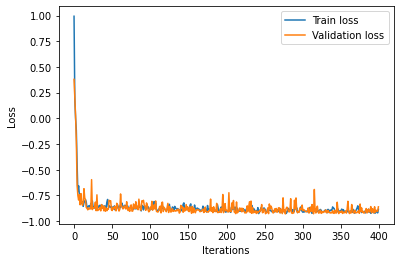

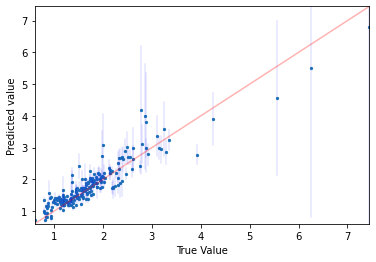

 56%|█████▌    | 5/9 [26:11<20:53, 313.32s/it]

The MSE on validation set is: 0.1052315357759257
The average variance on the validation set is : 0.1385193020105362
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


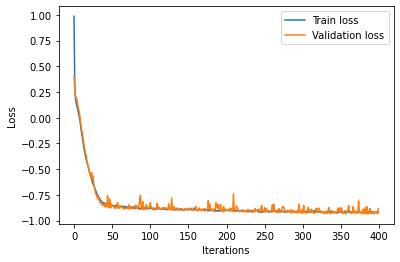

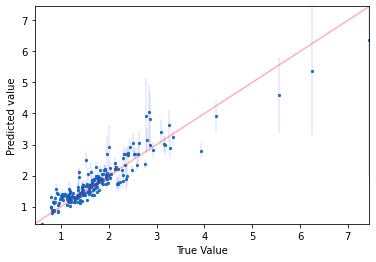

The MSE on validation set is: 0.10516780990126108
The average variance on the validation set is : 0.08211838454008102
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


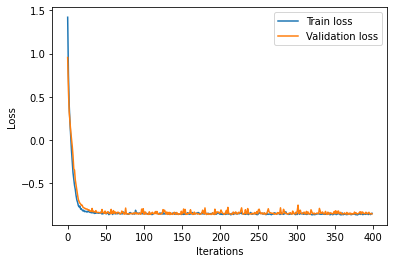

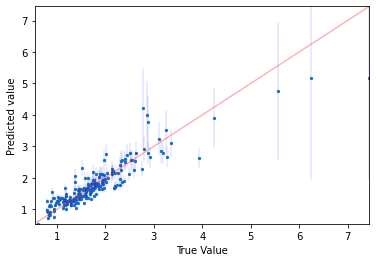

The MSE on validation set is: 0.12168483636092585
The average variance on the validation set is : 0.0976920798420906
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


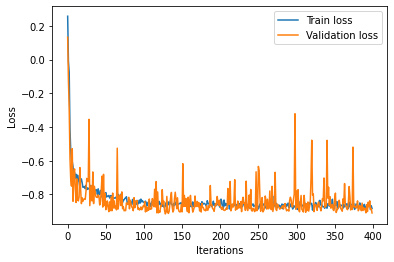

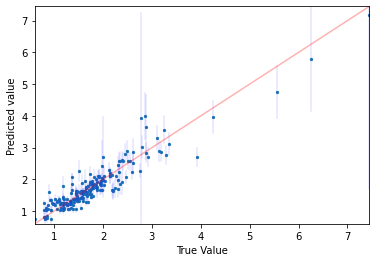

The MSE on validation set is: 0.087427609230116
The average variance on the validation set is : 0.10516912490129471
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


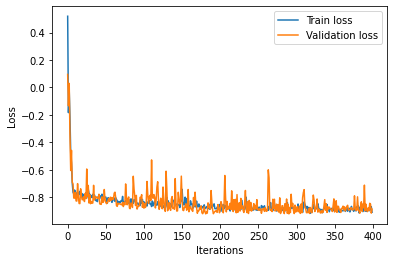

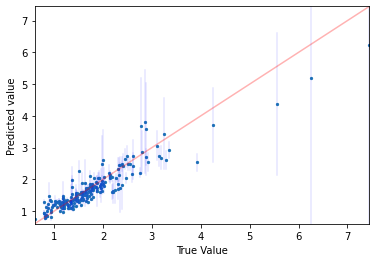

The MSE on validation set is: 0.09997424535664921
The average variance on the validation set is : 0.1505090743303299
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


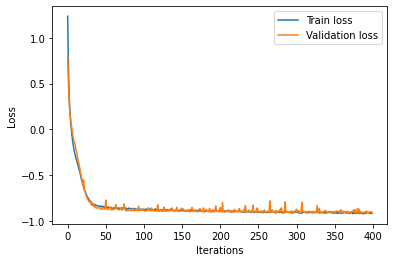

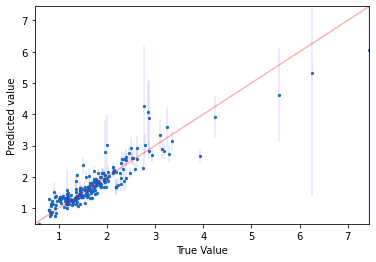

The MSE on validation set is: 0.11231239435079549
The average variance on the validation set is : 0.10054206103086472
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


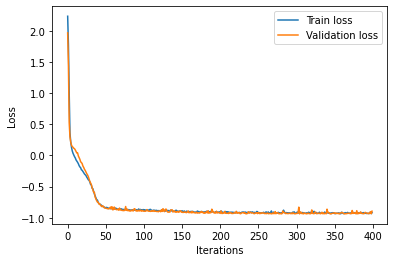

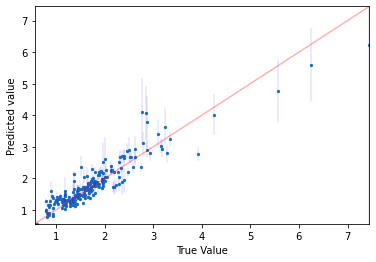

The MSE on validation set is: 0.10081874364511297
The average variance on the validation set is : 0.08593914657831192
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


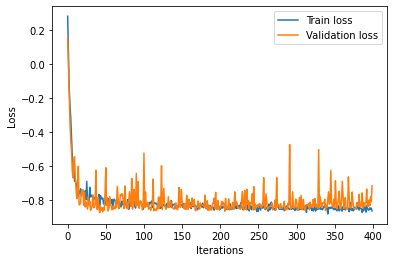

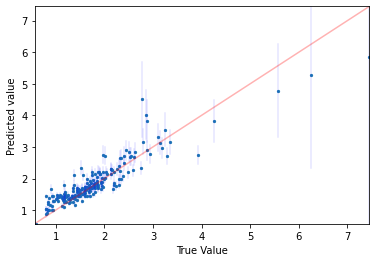

The MSE on validation set is: 0.12312677373697324
The average variance on the validation set is : 0.0983838438987732
TRAINING WITH [4, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


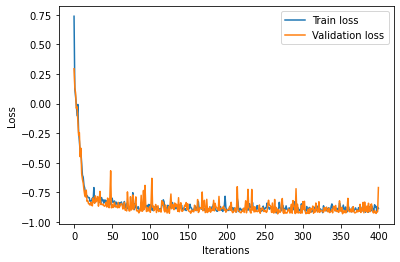

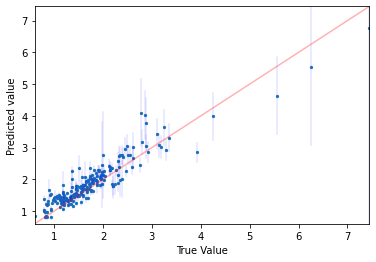

 67%|██████▋   | 6/9 [32:10<16:27, 329.07s/it]

The MSE on validation set is: 0.11364108329885383
The average variance on the validation set is : 0.10759792476892471
TRAINING WITH [10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


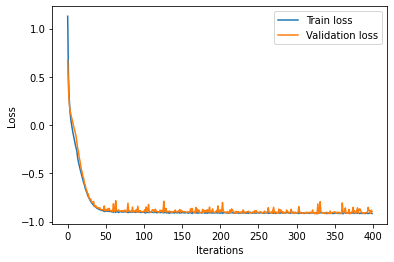

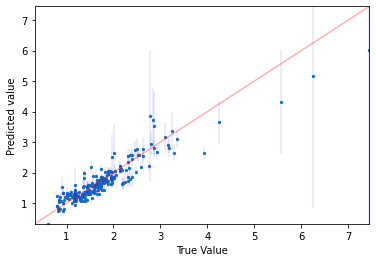

The MSE on validation set is: 0.10139070677268709
The average variance on the validation set is : 0.10067765414714813
TRAINING WITH [10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


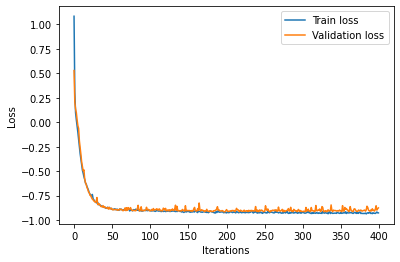

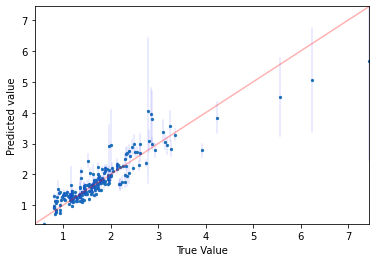

The MSE on validation set is: 0.12006059025373089
The average variance on the validation set is : 0.0824585035443306
TRAINING WITH [10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


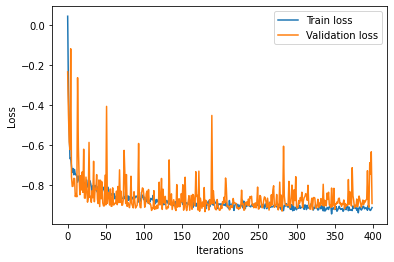

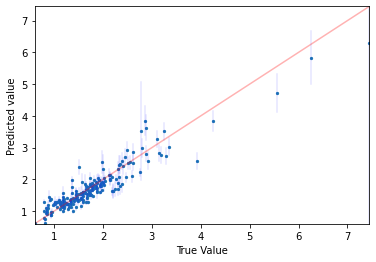

The MSE on validation set is: 0.08784432613375262
The average variance on the validation set is : 0.08132917433977127
TRAINING WITH [10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


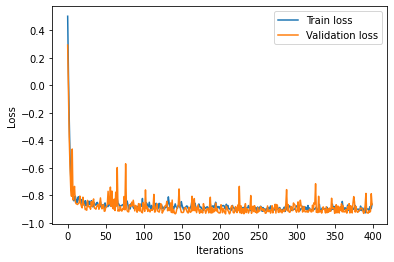

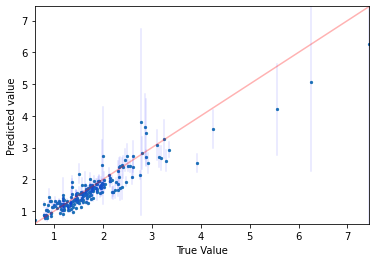

The MSE on validation set is: 0.10714714647719958
The average variance on the validation set is : 0.12218327820301056
TRAINING WITH [10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


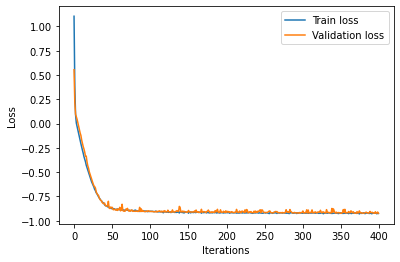

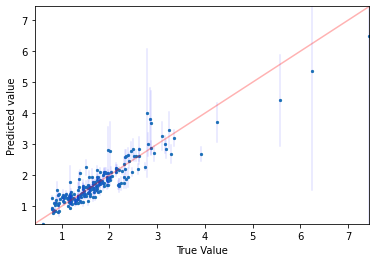

The MSE on validation set is: 0.09782380518863468
The average variance on the validation set is : 0.12245691567659378
TRAINING WITH [10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


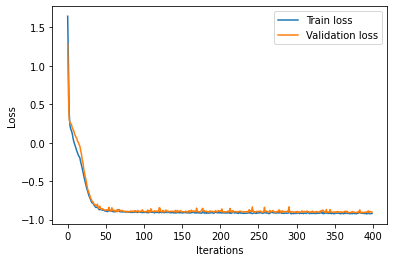

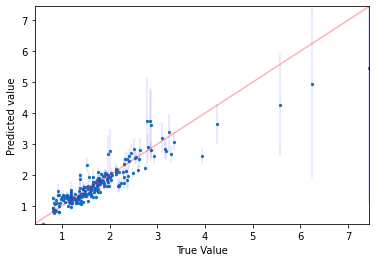

The MSE on validation set is: 0.11523628863308734
The average variance on the validation set is : 0.09009740501642227
TRAINING WITH [10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


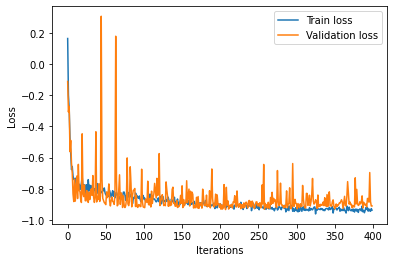

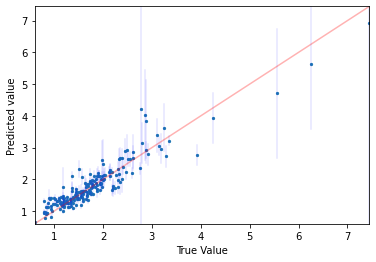

The MSE on validation set is: 0.09212834848562514
The average variance on the validation set is : 0.1334969699382782
TRAINING WITH [10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


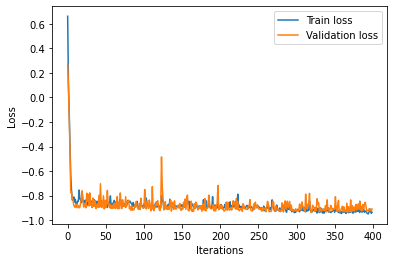

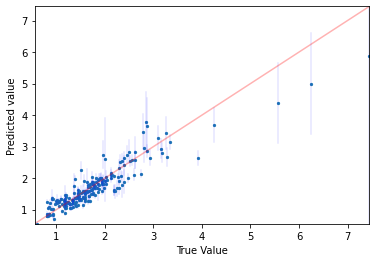

 78%|███████▊  | 7/9 [36:59<10:31, 315.69s/it]

The MSE on validation set is: 0.10442551914692196
The average variance on the validation set is : 0.09455814957618713
TRAINING WITH [10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


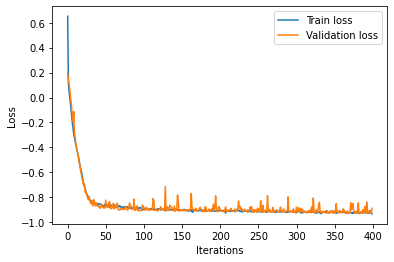

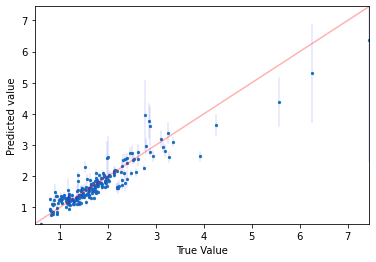

The MSE on validation set is: 0.09631784705967401
The average variance on the validation set is : 0.06626848131418228
TRAINING WITH [10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


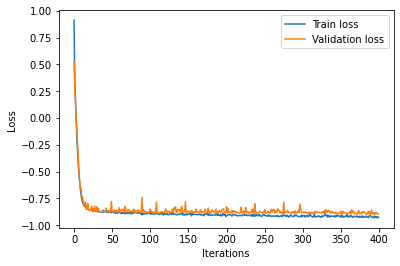

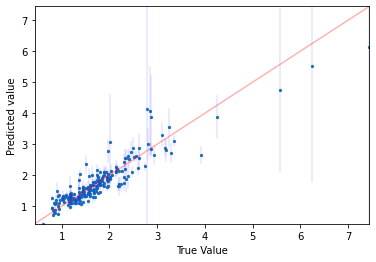

The MSE on validation set is: 0.10722354539177355
The average variance on the validation set is : 0.11691709607839584
TRAINING WITH [10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


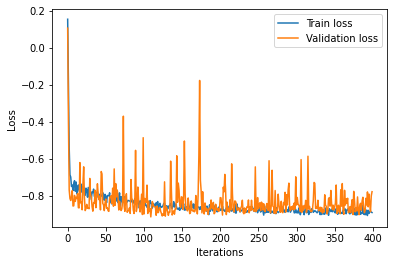

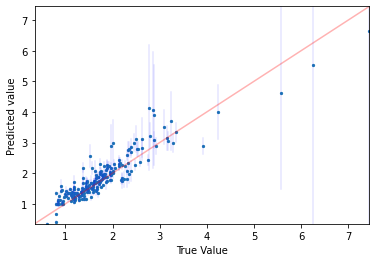

The MSE on validation set is: 0.11410696565604
The average variance on the validation set is : 0.15483476221561432
TRAINING WITH [10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


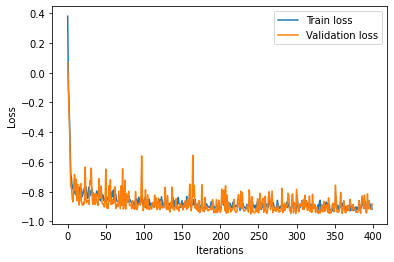

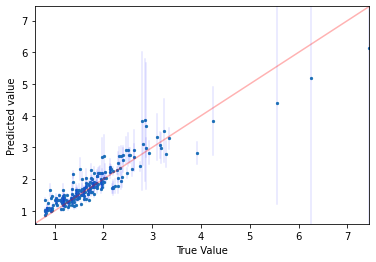

The MSE on validation set is: 0.10396233061733755
The average variance on the validation set is : 0.1675071120262146
TRAINING WITH [10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


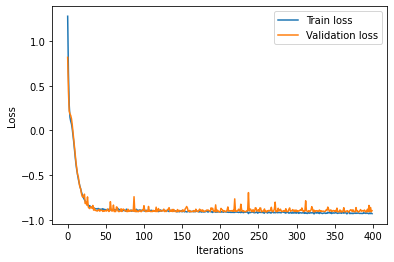

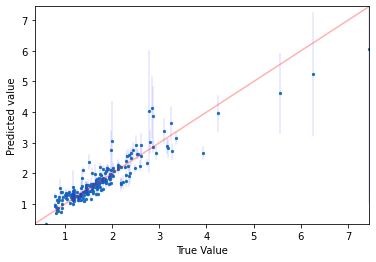

The MSE on validation set is: 0.11142015749865151
The average variance on the validation set is : 0.08920454233884811
TRAINING WITH [10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


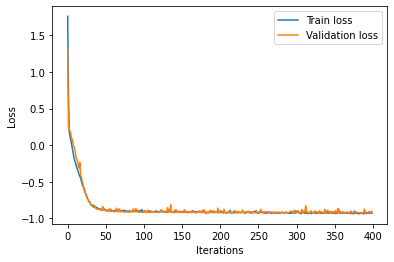

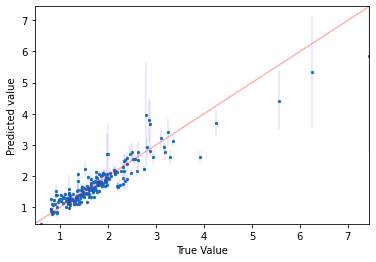

The MSE on validation set is: 0.1046311538496844
The average variance on the validation set is : 0.07250343263149261
TRAINING WITH [10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


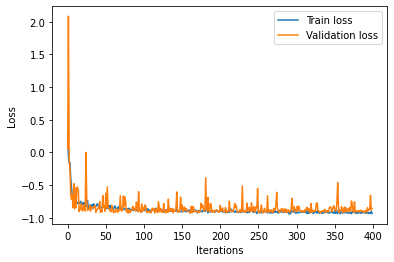

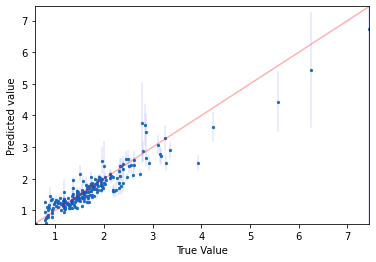

The MSE on validation set is: 0.09162320308698094
The average variance on the validation set is : 0.0834989920258522
TRAINING WITH [10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


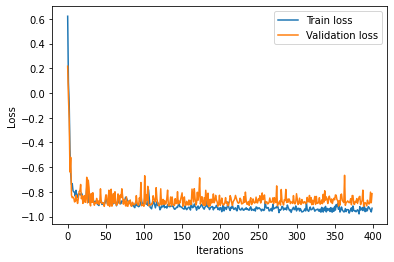

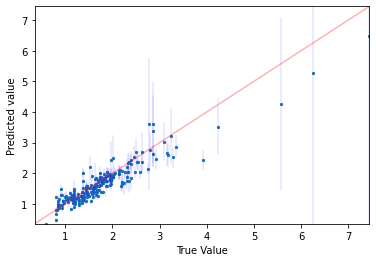

 89%|████████▉ | 8/9 [42:27<05:19, 319.87s/it]

The MSE on validation set is: 0.09975171247673396
The average variance on the validation set is : 0.16978850960731506
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : RMSprop


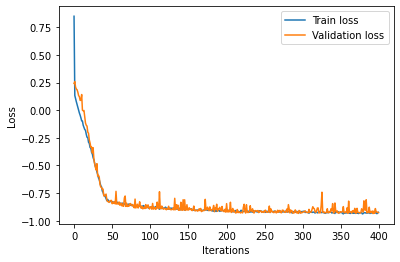

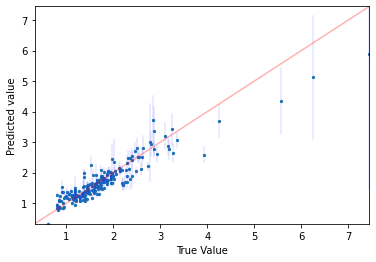

The MSE on validation set is: 0.09551030522433482
The average variance on the validation set is : 0.08476663380861282
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.001, optimizer : ADAM


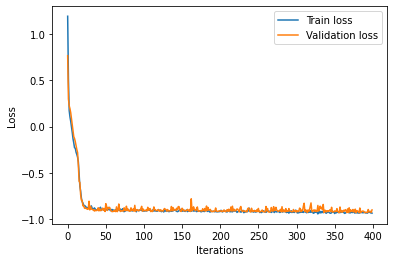

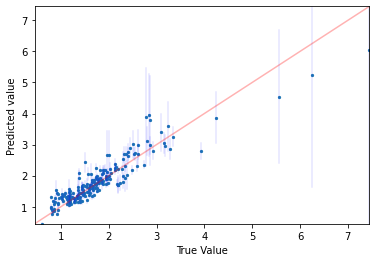

The MSE on validation set is: 0.10433961568256622
The average variance on the validation set is : 0.10929493606090546
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : RMSprop


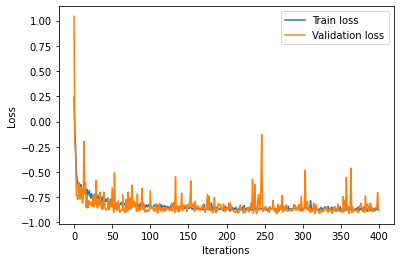

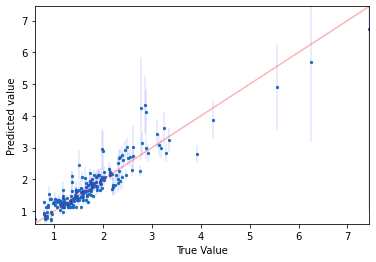

The MSE on validation set is: 0.10677341800867378
The average variance on the validation set is : 0.1008901596069336
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 10, learning_rate : 0.01, optimizer : ADAM


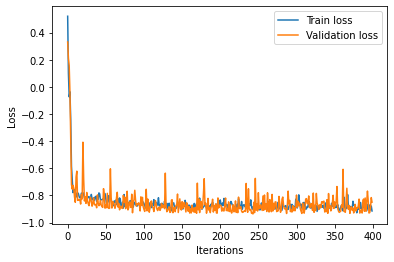

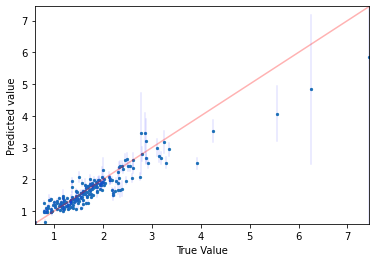

The MSE on validation set is: 0.108727729914825
The average variance on the validation set is : 0.08360666036605835
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : RMSprop


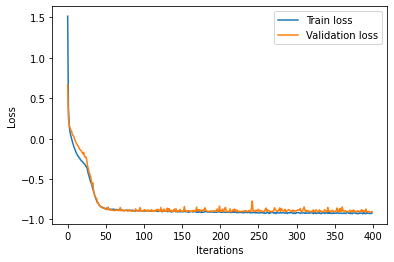

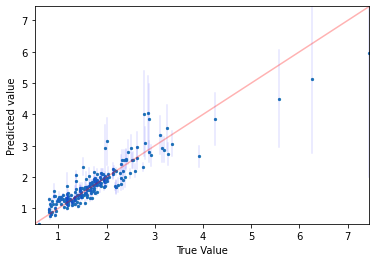

The MSE on validation set is: 0.11535726860240537
The average variance on the validation set is : 0.0988423153758049
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.001, optimizer : ADAM


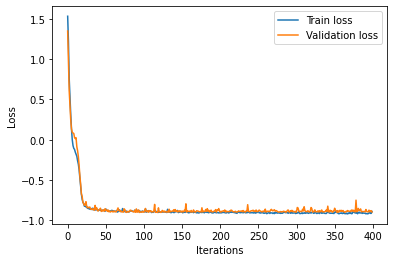

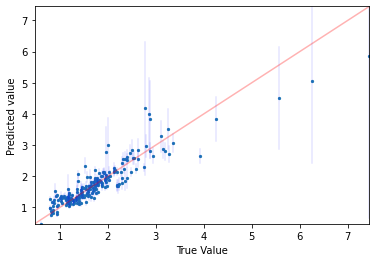

The MSE on validation set is: 0.11520132487024717
The average variance on the validation set is : 0.09857151657342911
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : RMSprop


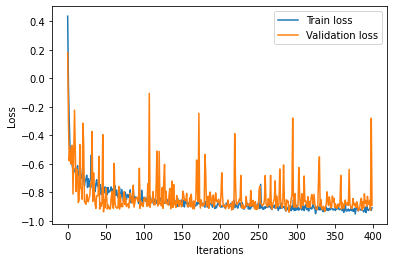

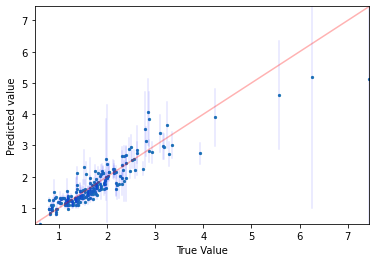

The MSE on validation set is: 0.11645775702759498
The average variance on the validation set is : 0.20971691608428955
TRAINING WITH [10, 10, 10, 10, 2] and batchsize : 20, learning_rate : 0.01, optimizer : ADAM


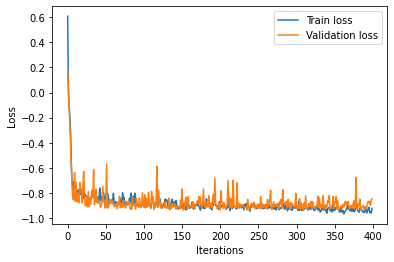

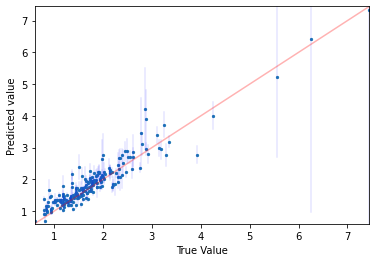

100%|██████████| 9/9 [48:33<00:00, 323.69s/it]

The MSE on validation set is: 0.08960324030476612
The average variance on the validation set is : 0.139292910695076


In [ ]:
#I try only RMSprop and ADAM with lr <1 and batchsize <=100

neurons_list = [
          [4,4,4,2],[4,4,4,2],[4,4,4,4,2],
          [4,10,2],[4,10,10,2],[4,10,10,10,2],
          [10,10,2],[10,10,10,2],[10,10,10,10,2],
        ]
models = {}


# Define hyper-parameters:

batchsizes = [10,20]
lrs = [0.001,0.01]
opt = [torch.optim.RMSprop,torch.optim.Adam]
df = {
        'n_neurons': [],
        'batchsizes' : [],
        'learning_rate' : [],
        'optimizer' : [],
        'Val_loss': []
     }

from tqdm import tqdm

emin = np.inf
best_model = None

for n_neurons in tqdm(neurons_list):
  for bs in batchsizes:
    for lr in lrs:
      for o,n in zip(opt,['RMSprop','ADAM']):
        print(f'TRAINING WITH {str(n_neurons)} and batchsize : {bs}, learning_rate : {lr}, optimizer : {n}')
        model = Model(n_neurons, F.relu)

        # Choose the hyperparameters for training: 
        num_epochs = 400
        batch_size = bs

        # Training criterion. This one is a mean squared error (MSE) loss between the output
        # of the network and the target label
        criterion = nn.GaussianNLLLoss()

        # Use SGD optimizer with a learning rate of 0.01
        # It is initialized on our model
        optimizer = o(model.parameters(), lr=lr)

        train(num_epochs, batch_size, criterion, optimizer, model, train_set, verbose=0)

        e = eval(model, X_val, y_val, criterion)

        df['n_neurons'].append(str(n_neurons))
        df['batchsizes'].append(bs)
        df['learning_rate'].append(lr)
        df['optimizer'].append(n)
        df['Val_loss'].append(e)
        if e<emin:
          emin = e
          best_model = model
        

In [ ]:
df = pd.DataFrame(df)
df.sort_values(by = ['Val_loss'])
df['Val_loss'] = np.clip(df['Val_loss'],-5,0.5)

df.sample(10)

,n_neurons,batchsizes,learning_rate,optimizer,Val_loss
71,"[10, 10, 10, 10, 2]",20,0.010,ADAM,-0.846383
55,"[10, 10, 2]",20,0.010,ADAM,-0.908489
48,"[10, 10, 2]",10,0.001,RMSprop,-0.897478
37,"[4, 10, 10, 2]",20,0.001,ADAM,-0.902827
33,"[4, 10, 10, 2]",10,0.001,ADAM,-0.854792
53,"[10, 10, 2]",20,0.001,ADAM,-0.903521
8,"[4, 4, 4, 2]",10,0.001,RMSprop,0.339895
69,"[10, 10, 10, 10, 2]",20,0.001,ADAM,-0.898089
30,"[4, 10, 2]",20,0.010,RMSprop,-0.754452
14,"[4, 4, 4, 2]",20,0.010,RMSprop,0.339461


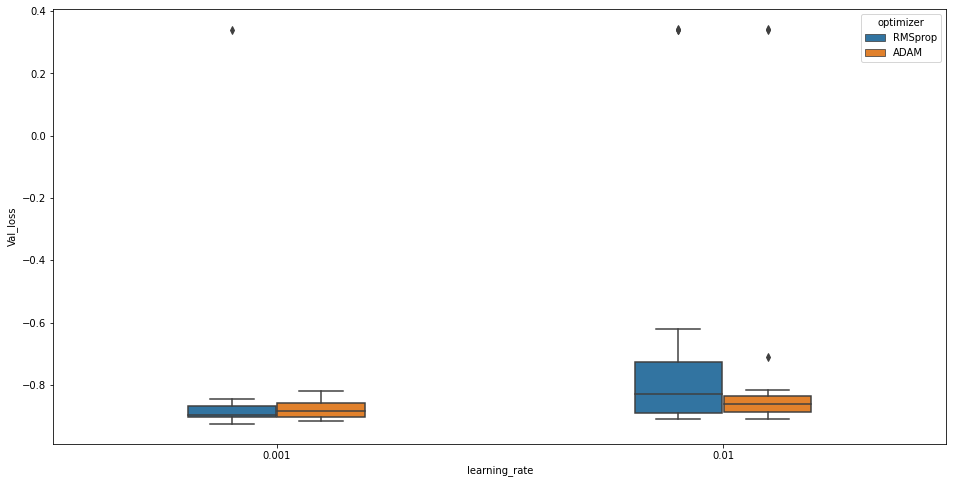

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df, x='learning_rate',y='Val_loss', hue='optimizer', width=.4)

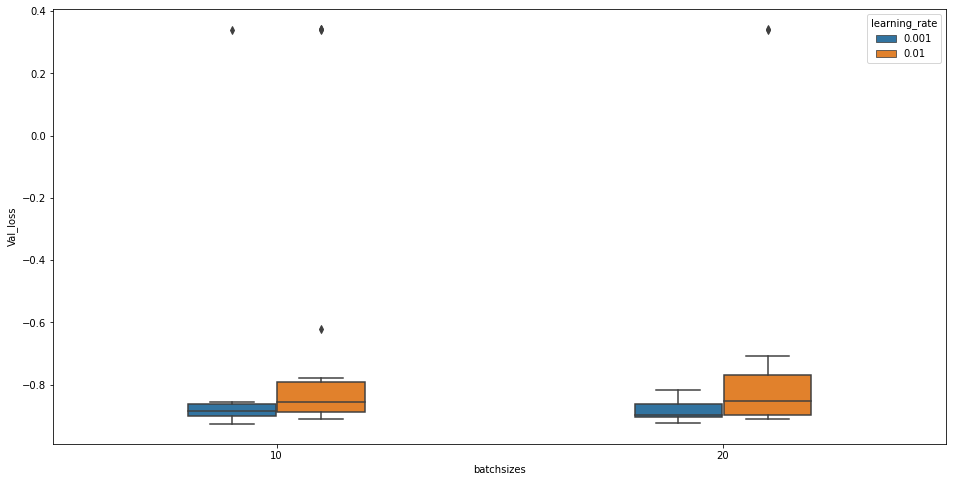

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df, x='batchsizes',y='Val_loss', hue='learning_rate', width=.4)

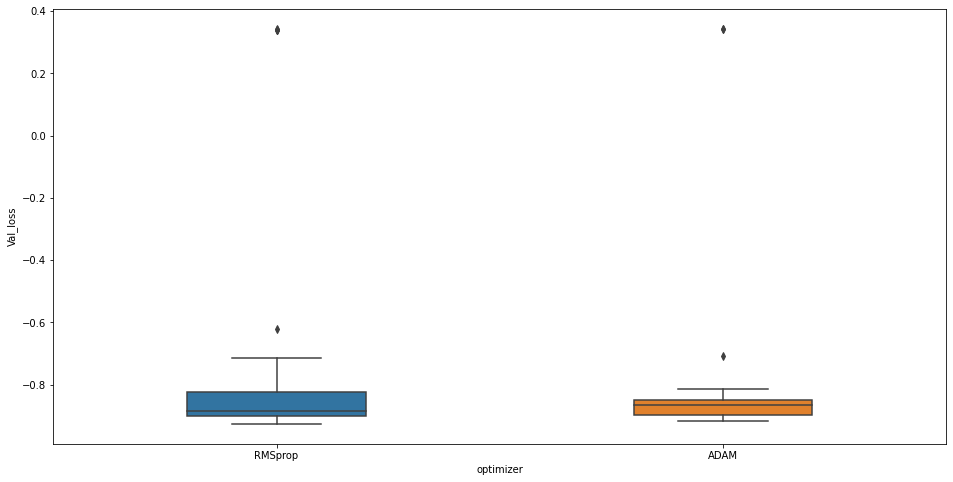

In [ ]:
fig = plt.figure(figsize=(16,8))

sns.boxplot(data = df, x='optimizer',y='Val_loss', width=.4)

In [ ]:
df[df.Val_loss < 0.99* np.min(df.Val_loss)]

,n_neurons,batchsizes,learning_rate,optimizer,Val_loss
32,"[4, 10, 10, 2]",10,0.001,RMSprop,-0.917377
52,"[10, 10, 2]",20,0.001,RMSprop,-0.923120
64,"[10, 10, 10, 10, 2]",10,0.001,RMSprop,-0.925924


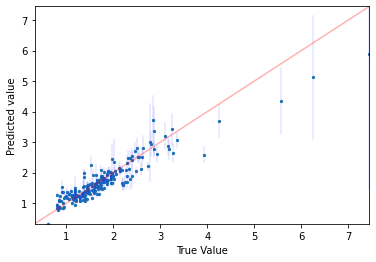

The MSE on validation set is: 0.09551030522433482
The average variance on the validation set is : 0.08476663380861282


In [ ]:
model = best_model

e = eval(model, X_val, y_val, criterion)


Text(0, 0.5, 'log(var)')

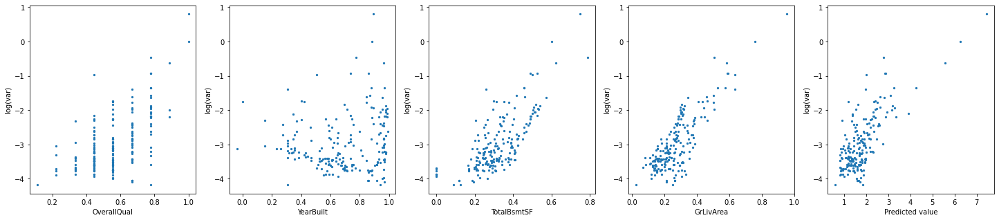

In [ ]:
with torch.no_grad():
    y_pre_val = model(torch.from_numpy(np.array(X_val)).float()).view(-1,2)
error = criterion(y_pre_val[:,0], torch.tensor(np.array(y_val)), torch.exp(y_pre_val[:,1])).float().item()

var= y_pre_val.numpy()[:,1]
y_pre_val = y_pre_val.numpy()[:,0]

fig,axes = plt.subplots(1,5,figsize = (5*5,5))


axes[0].scatter(X_val.OverallQual, var, s = 5)
axes[0].set_xlabel('OverallQual')
axes[0].set_ylabel('log(var)')

axes[1].scatter(X_val.YearBuilt, var, s = 5)
axes[1].set_xlabel('YearBuilt')
axes[1].set_ylabel('log(var)')

axes[2].scatter(X_val.TotalBsmtSF, var, s = 5)
axes[2].set_xlabel('TotalBsmtSF')
axes[2].set_ylabel('log(var)')

axes[3].scatter(X_val.GrLivArea, var, s = 5)
axes[3].set_xlabel('GrLivArea')
axes[3].set_ylabel('log(var)')

axes[4].scatter(y_val, var, s = 5)
axes[4].set_xlabel('Predicted value')
axes[4].set_ylabel('log(var)')


### Exercice 4: Prediction on test set

* Once you have a model that seems satisfying on the validation dataset, you SHOULD evaluate it on a test dataset that has never been used before, to obtain a final accuracy value.
* When using the Gaussian likelihood function, the confidence of the network in its prediction is reflected in the variance it outputs. It can be interesting to check how this uncertainty varies with the data. For example, the uncertainty will decrease when the feature `OverallQual` increases. Plot the variance $\sigma(x)$ w.r.t one of the three features, on test set, and describe what you observe.

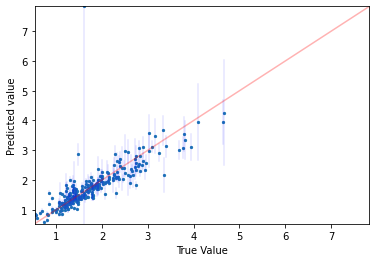

The MSE on validation set is: 0.23147179580364463
The average variance on the validation set is : 0.14849278330802917


In [ ]:
e = eval(model, X_test, y_test, criterion)